In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import math
from statannotations.Annotator import Annotator
import dtreeviz
from sklearn.model_selection import ParameterGrid
from sklearn.model_selection import GridSearchCV
%matplotlib inline
from sklearn.metrics import explained_variance_score,mean_squared_error,roc_auc_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import ExtraTreesRegressor,ExtraTreesClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve,RocCurveDisplay,auc,accuracy_score
from sklearn.linear_model import LinearRegression
from imblearn.over_sampling import SMOTE
from sklearn import svm
from sklearn.impute import SimpleImputer
import os

def zcoreScaler(data):
    x = data
    scaler = StandardScaler()
    x_std = pd.DataFrame(scaler.fit_transform(x.T)).T
    x_std.index = x.index
    x_std.columns = x.columns
    return x_std

def find_optimal_cutoff(tpr,fpr,threshold):
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = threshold[optimal_idx]
    return optimal_threshold

ModuleNotFoundError: No module named 'seaborn'

In [195]:
stage_report = pd.read_csv("./result/stage_report/stage_report.csv")

In [168]:
stage_report[stage_report.Tech == "RNA-seq"]

,Tech,Method,Cacner,Sample_num,MSI-H样本数,MSS样本数,AUC
0,RNA-seq,MSIsensor-RNA,CRCI,43,7,36,0.980
1,RNA-seq,MSIsensor-RNA,CRCII,109,34,75,0.997
2,RNA-seq,MSIsensor-RNA,CRCIII,79,12,67,0.999
3,RNA-seq,MSIsensor-RNA,CRCIV,34,1,33,1.000
4,RNA-seq,MSIsensor-RNA,STADI,12,1,11,1.000
5,RNA-seq,MSIsensor-RNA,STADII,35,3,32,1.000
6,RNA-seq,MSIsensor-RNA,STADIII,48,7,41,1.000
7,RNA-seq,MSIsensor-RNA,STADIV,14,3,11,1.000
8,RNA-seq,PreMSIm-single,CRCI,43,7,36,0.542
9,RNA-seq,PreMSIm-single,CRCII,109,34,75,0.513


In [160]:
stage_report.Cacner.unique()

array(['CRCI', 'CRCII', 'CRCIII', 'CRCIV', 'STADI', 'STADII', 'STADIII',
       'STADIV'], dtype=object)

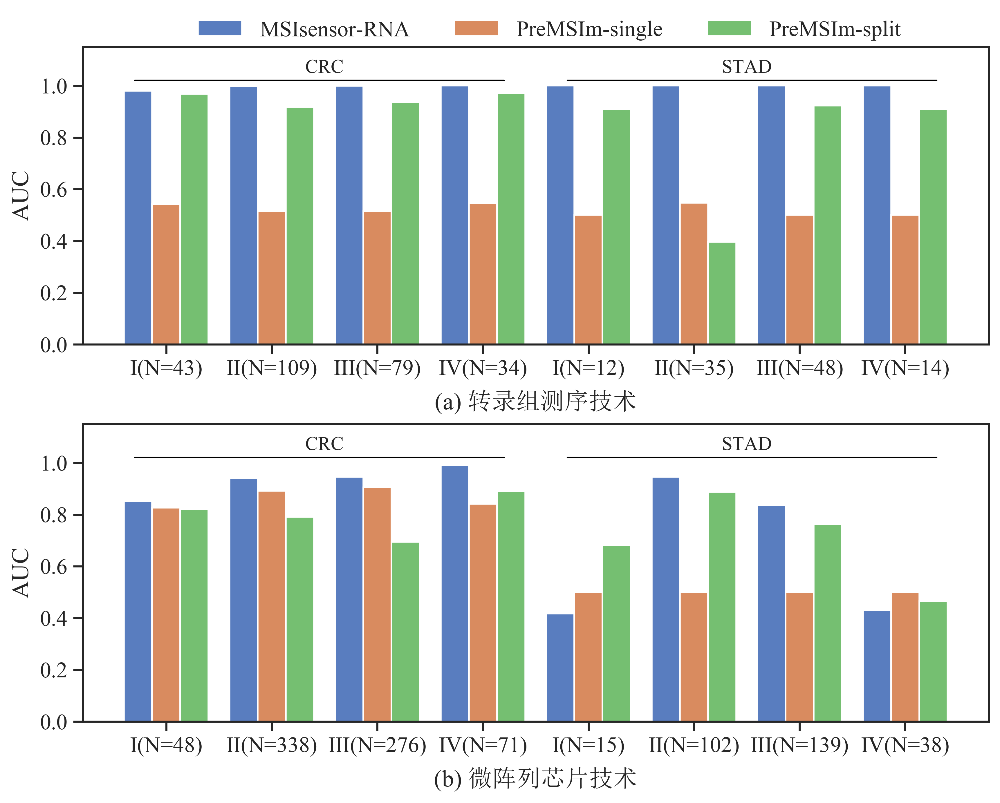

In [205]:
fig, ax =plt.subplots(2,1,constrained_layout=True,figsize=(8.5,6.5),dpi=400)

report = stage_report[stage_report.Tech == "RNA-seq"]
database = list(report.Cacner.unique())
xlabels = []
for name in database:
    xlabels.append(name.split("_")[1]+"(N="+str(list(report[report["Cacner"] == name].Sample_num)[0])+")")
    
fontdict = {'math_fontfamily':'custom', 'size':12}
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc,font_scale=1.25)
plt.subplot(2,1,1)
sub1 = sns.barplot(data=report, x="Cacner", y="AUC", hue="Method",palette="muted",order=list(report.Cacner.unique()))
sub1.set_ylim(0,1.15)

plt.plot([-0.3,3.2],[1.02,1.02],color="black",linewidth=0.8)
plt.text(1.5,1.05, r"CRC", ha="center",fontdict=fontdict)

sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_xticklabels(xlabels)
sub1.set_title("(a) 转录组测序技术",y=-0.25)
sub1.legend_.remove()
sub1.set_ylim(0,1.15)
plt.plot([3.8,7.3],[1.02,1.02],color="black",linewidth=0.8)
plt.text(5.5,1.05, r"STAD", ha="center",fontdict=fontdict)




plt.subplot(2,1,2)
report = stage_report[stage_report.Tech == "Microarray"]
database = list(report.Cacner.unique())
xlabels = []
for name in database:
    xlabels.append(name.split("_")[1]+"(N="+str(list(report[report["Cacner"] == name].Sample_num)[0])+")")
    
fontdict = {'math_fontfamily':'custom', 'size':12}
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc,font_scale=1.25)

sub1 = sns.barplot(data=report, x="Cacner", y="AUC", hue="Method",palette="muted",order=list(report.Cacner.unique()))
sub1.set_ylim(0,1.15)
plt.plot([-0.3,3.2],[1.02,1.02],color="black",linewidth=0.8)
plt.text(1.5,1.05, r"CRC", ha="center",fontdict=fontdict)

sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_xticklabels(xlabels)
sub1.legend_.remove()
sub1.set_ylim(0,1.15)
plt.plot([3.8,7.3],[1.02,1.02],color="black",linewidth=0.8)
plt.text(5.5,1.05, r"STAD", ha="center",fontdict=fontdict)


lines, labels = sub1.get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.55,1.055),ncol=4,frameon=False) 
sub1.set_title("(b) 微阵列芯片技术",y=-0.25)

fig.savefig("./result/stage_report/stage_report.svg",bbox_inches='tight')

In [81]:
ma_stage = pd.read_csv("./data/GPB/info/Microarray_pre_stage_info.csv",index_col=0)

In [85]:
ma = pd.read_csv("./result/result/merge/ma/GSE13067.GPL570.res.merge.csv",index_col=0)

In [86]:
ma_res = pd.DataFrame(columns=ma.columns)
path = "./result/result/merge/ma/"
for name in os.listdir(path):
    ma_res = ma_res.append(pd.read_csv(path+name,index_col=0))


In [90]:
ma_merge_res = pd.merge(ma_res,ma_stage.iloc[:,-2:],left_index=True,right_index=True)

In [95]:
ma_merge_res["database"] = "Microarray"

In [97]:
ma_merge_res

,sample_num,database,cancer,y_true,y_score,y_pre,single_label,single_score,split_label,split_score,all_label,all_score,stage,stage_full
GSM327282,74,Microarray,CRC,1,14.014857,1.0,1,1.0,1,1.0,1,1.0,not reported,not reported
GSM327283,74,Microarray,CRC,0,4.904714,0.0,1,1.0,1,1.0,1,0.6,not reported,not reported
GSM327284,74,Microarray,CRC,0,4.610571,0.0,1,1.0,0,0.2,0,0.0,not reported,not reported
GSM327285,74,Microarray,CRC,0,0.343286,0.0,1,0.8,0,0.0,0,0.0,not reported,not reported
GSM327286,74,Microarray,CRC,0,3.343000,0.0,1,1.0,0,0.4,0,0.2,not reported,not reported
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GSM2440432,58,Microarray,CRC,0,7.453000,1.0,0,0.4,0,0.0,0,0.4,III,3
GSM2440433,58,Microarray,CRC,1,9.743857,1.0,1,1.0,1,1.0,1,1.0,II,2
GSM2440434,58,Microarray,CRC,0,4.479143,0.0,0,0.2,1,1.0,0,0.0,II,2
GSM2440435,58,Microarray,CRC,0,2.489000,0.0,0,0.0,1,0.8,0,0.0,II,2


In [147]:
data_res = ma_merge_res
data_res = data_res[data_res.stage != "not reported"]
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(list(res_stage.y_true),res_stage.y_score,[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(list(res_stage.y_true),res_stage.y_score,res_stage.y_pre)
        metric[cancer+stage_num] = res

In [148]:
metric.T.to_csv("./result/stage_report.ma.csv")

In [144]:
data_res = ma_merge_res
data_res = data_res[data_res.stage != "not reported"]
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(list(res_stage.y_true),(res_stage.single_score),[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(list(res_stage.y_true),res_stage.single_score,list(res_stage.single_label))
        metric[cancer+stage_num] = res

In [145]:
metric.T.to_csv("./result/stage_report.ma.single.csv")

In [150]:
data_res = ma_merge_res
data_res = data_res[data_res.stage != "not reported"]
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(list(res_stage.y_true),(res_stage.split_score),[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(list(res_stage.y_true),res_stage.split_score,list(res_stage.split_label))
        metric[cancer+stage_num] = res

In [151]:
metric.T.to_csv("./result/stage_report.ma.split.csv")

In [ ]:
# 分期对比

In [3]:
TCGAstage = pd.read_csv("./data/GPB/info/TCGA_pre_stage_info.csv",index_col=0)

In [9]:
CPTACstage = pd.read_csv("./data/GPB/info/CPTAC_pre_stage_info.csv",index_col=0)

In [19]:
TCGAtest = pd.read_csv("./result/result/merge/bulk/TCGA_test.res.merge.csv",index_col=0)

In [22]:
TCGAtest

,sample_num,database,cancer,y_true,y_score,y_pre,single_label,single_score,split_label,split_score,all_label,all_score
TCGA-AX-A3FZ-01A,434,TCGA_test,UCEC,0,0.393714,0.0,1,1.0,0,0.0,0,0.0
TCGA-CI-6623-01B,434,TCGA_test,CRC,0,0.288266,0.0,1,1.0,0,0.0,0,0.2
TCGA-AX-A2HA-01A,434,TCGA_test,UCEC,1,13.900429,1.0,1,1.0,1,1.0,1,1.0
TCGA-D1-A176-01A,434,TCGA_test,UCEC,1,16.351286,1.0,1,1.0,1,1.0,1,1.0
TCGA-B5-A11W-01A,434,TCGA_test,UCEC,0,0.325286,0.0,1,1.0,0,0.0,1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-B5-A11V-01A,434,TCGA_test,UCEC,0,0.240924,0.0,1,1.0,0,0.0,1,1.0
TCGA-E6-A1M0-01A,434,TCGA_test,UCEC,0,1.485714,0.0,1,1.0,1,1.0,1,0.8
TCGA-G4-6297-01A,434,TCGA_test,CRC,0,0.151899,0.0,1,1.0,0,0.0,0,0.2
TCGA-CD-A4MH-01A,434,TCGA_test,STAD,0,0.145714,0.0,1,1.0,1,1.0,0,0.4


In [25]:
index = []
for name in TCGAstage.index:
    index.append(name[:16])

In [30]:
TCGAstage.index = index

In [34]:
TCGA_test_stage = pd.merge(TCGAtest,TCGAstage.iloc[:,-2:],left_index=True,right_index=True)

In [35]:
TCGA_test_stage.to_csv("./result/result/merge/bulk/TCGA_test_stage.res.merge.csv")

In [41]:
TCGA_test_stage[TCGA_test_stage.cancer == "CRC"].groupby("stage").count()

,sample_num,database,cancer,y_true,y_score,y_pre,single_label,single_score,split_label,split_score,all_label,all_score,stage_full
stage,,,,,,,,,,,,,
I,31,31,31,31,31,31,31,31,31,31,31,31,31
II,67,67,67,67,67,67,67,67,67,67,67,67,67
III,35,35,35,35,35,35,35,35,35,35,35,35,35
IV,27,27,27,27,27,27,27,27,27,27,27,27,27
not reported,10,10,10,10,10,10,10,10,10,10,10,10,10


In [42]:
TCGA_test_stage[TCGA_test_stage.cancer == "STAD"].groupby("stage").count()

,sample_num,database,cancer,y_true,y_score,y_pre,single_label,single_score,split_label,split_score,all_label,all_score,stage_full
stage,,,,,,,,,,,,,
I,12,12,12,12,12,12,12,12,12,12,12,12,12
II,35,35,35,35,35,35,35,35,35,35,35,35,35
III,48,48,48,48,48,48,48,48,48,48,48,48,48
IV,14,14,14,14,14,14,14,14,14,14,14,14,14
not reported,4,4,4,4,4,4,4,4,4,4,4,4,4


In [49]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support
def metricCalculate(y_true,y_score,y_pre):
    auc = roc_auc_score(y_true,y_score)
    tn, fp, fn, tp = confusion_matrix(y_true,y_pre).ravel()
    accuracy = (tp+tn)/(tn+fp+fn+tp)
#     precision = tp/(tp+fp)
#     recall = tp/(tp+fn)
    specificity = tn/(tn+fp)
#     f1 = 2*precision*recall/(precision+recall)
    precision,recall,f1,_ = precision_recall_fscore_support(y_true,y_pre,average="binary")
    return [auc,f1,accuracy,precision,recall,specificity]

In [66]:
data_res = TCGA_test_stage

In [119]:
data_res = data_res[data_res.stage != "not reported"]

In [120]:
# data_res = TCGA_test_stage
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(res_stage.y_true,res_stage.y_score,[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(res_stage.y_true,res_stage.y_score,res_stage.y_pre)
        metric[cancer+stage_num] = res

ValueError: unknown format is not supported

In [69]:
metric

,STADI,CRCI,STADIII,CRCIII,UCECnot reported
database,TCGAtest,TCGAtest,TCGAtest,TCGAtest,TCGAtest
cancerType,STAD,CRC,STAD,CRC,UCEC
stage,I,I,III,III,not reported
sampleNum,12,31,48,35,181
MSI_num,1,6,7,3,53
MSS_num,1,6,7,3,53
AUC,1,0.993333,1,1,0.975236
f1,1,0.909091,1,0.857143,0.924528
accuracy,1,0.967742,1,0.971429,0.955801
precision,1,1,1,0.75,0.924528


In [121]:
data_res = CPTACres.append(TCGA_test_stage)
data_res = data_res[data_res.stage != "not reported"]
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(res_stage.y_true,res_stage.y_score,[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(res_stage.y_true,res_stage.y_score,res_stage.y_pre)
        metric[cancer+stage_num] = res

In [123]:
metric.T.to_csv("./result/stage_report.bulk.csv")

In [124]:
metric

,CRCIII,STADIII,CRCII,STADII,CRCI,STADI,CRCIV,STADIV
database,TCGAtest,TCGAtest,TCGAtest,TCGAtest,TCGAtest,TCGAtest,TCGAtest,TCGAtest
cancerType,CRC,STAD,CRC,STAD,CRC,STAD,CRC,STAD
stage,III,III,II,II,I,I,IV,IV
sampleNum,79,48,109,35,43,12,34,14
MSI_num,12,7,34,3,7,1,1,3
MSS_num,67,41,75,32,36,11,33,11
AUC,0.998756,1,0.996863,1,0.980159,1,1,1
f1,0.8,1,0.957746,0.75,0.705882,1,1,1
accuracy,0.924051,1,0.972477,0.942857,0.883721,1,1,1
precision,0.666667,1,0.918919,0.6,0.6,1,1,1


In [129]:
data_res = CPTACres.append(TCGA_test_stage)
data_res = data_res[data_res.stage != "not reported"]
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(res_stage.y_true,res_stage.single_score,[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(res_stage.y_true,res_stage.single_score,res_stage.single_label)
        metric[cancer+stage_num] = res

In [130]:
metric.T.to_csv("./result/stage_report.bulk.single.csv")

In [132]:
data_res = CPTACres.append(TCGA_test_stage)
data_res = data_res[data_res.stage != "not reported"]
metric = pd.DataFrame(index=["database","cancerType","stage","sampleNum","MSI_num","MSS_num","AUC","f1","accuracy","precision","sensitivity","specificity"])
for stage_num in data_res.stage.unique():
    stage = data_res[data_res.stage == stage_num]

    for cancer in stage.cancer.unique():
        res = []
        res_stage = stage[stage.cancer == cancer]
#         display(res_stage)
        res.append("TCGAtest")
        res.append(cancer)
        res.append(stage_num)
        res.append(res_stage.shape[0])
        res.append(sum(res_stage.y_true == 1))
        res.append(sum(res_stage.y_true == 0))
        if sum(res_stage.y_pre) == res_stage.shape[0]:
            res = res + metricCalculate(res_stage.y_true,res_stage.split_score,[0]*res_stage.shape[0])
        else:
            res = res + metricCalculate(res_stage.y_true,res_stage.split_score,res_stage.split_label)
        metric[cancer+stage_num] = res

In [133]:
metric.T.to_csv("./result/stage_report.bulk.split.csv")

In [135]:
metric.T

,database,cancerType,stage,sampleNum,MSI_num,MSS_num,AUC,f1,accuracy,precision,sensitivity,specificity
CRCIII,TCGAtest,CRC,III,79,12,67,0.934701,0.55,0.772152,0.392857,0.916667,0.746269
STADIII,TCGAtest,STAD,III,48,7,41,0.923345,0.545455,0.791667,0.4,0.857143,0.780488
CRCII,TCGAtest,CRC,II,109,34,75,0.916667,0.785714,0.834862,0.66,0.970588,0.773333
STADII,TCGAtest,STAD,II,35,3,32,0.395833,0.1,0.485714,0.0588235,0.333333,0.5
CRCI,TCGAtest,CRC,I,43,7,36,0.968254,0.705882,0.883721,0.6,0.857143,0.888889
STADI,TCGAtest,STAD,I,12,1,11,0.909091,0.4,0.75,0.25,1,0.727273
CRCIV,TCGAtest,CRC,IV,34,1,33,0.969697,0.2,0.764706,0.111111,1,0.757576
STADIV,TCGAtest,STAD,IV,14,3,11,0.909091,0.6,0.714286,0.428571,1,0.636364


In [ ]:
# 数据统计

In [353]:
ma = pd.read_csv("./data/ma_count.csv",index_col=0)

,MSI,MSS
GSE13067,11,63
GSE13294,78,77
GSE18088,19,34
GSE24550,14,51
GSE27544,8,14
GSE35896,5,56
GSE39084,16,3
GSE39582,77,459
GSE75316,11,48
GSE92921,5,53


63
77
34
51
14
56
3
459
48
53
50
233
Rectangle(xy=(63, -0.45), width=11, height=0.9, angle=0)
Rectangle(xy=(77, 0.55), width=78, height=0.9, angle=0)
Rectangle(xy=(34, 1.55), width=19, height=0.9, angle=0)
Rectangle(xy=(51, 2.55), width=14, height=0.9, angle=0)
Rectangle(xy=(14, 3.55), width=8, height=0.9, angle=0)
Rectangle(xy=(56, 4.55), width=5, height=0.9, angle=0)
Rectangle(xy=(3, 5.55), width=16, height=0.9, angle=0)
Rectangle(xy=(459, 6.55), width=77, height=0.9, angle=0)
Rectangle(xy=(48, 7.55), width=11, height=0.9, angle=0)
Rectangle(xy=(53, 8.55), width=5, height=0.9, angle=0)
Rectangle(xy=(50, 9.55), width=19, height=0.9, angle=0)
Rectangle(xy=(233, 10.55), width=64, height=0.9, angle=0)


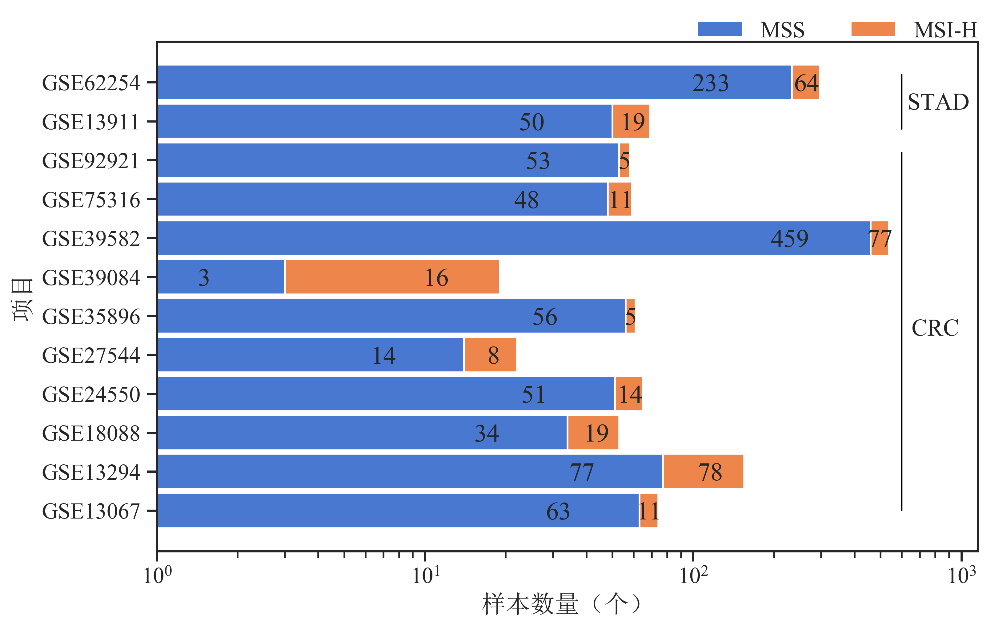

In [421]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(8,5),dpi=400)
width = 0.9
# [u'#ee854a',u'#4878d0']
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
plt.subplot(1,1,1)

sub1 = plt.barh(ma.index,ma.MSS,width,label="MSS",color=u'#4878d0')
ax.set_xscale("log",base=10)

for i in sub1:
    height=i.get_width()
    print(height)
    plt.text((height)/2,i.get_y()+width/4,str(height),fontsize=15,ha="center")
#     if height == 3:
#         plt.text((height)+0.2,i.get_y()+width/4,str(height),fontsize=15,ha="center")
#     else:
#         plt.text((height)/2,i.get_y()+width/4,str(height),fontsize=15,ha="center")
#     break

sub1 =ax.barh(ma.index,ma.MSI,width,left=ma.MSS,label="MSI-H",color=u'#ee854a')
for i in sub1:
    height=i.get_width()
    print(i)
    
    plt.text(height/2+i.get_x(),i.get_y()+width/4,str(height),fontsize=15,ha="center")
    
plt.plot([600,600],[0,9.2],color="black",linewidth=0.8)
plt.plot([600,600],[9.8,11.2],color="black",linewidth=0.8)

plt.text(800,4.5, r"CRC", ha="center",fontdict=fontdict)
plt.text(820,10.3, r"STAD", ha="center",fontdict=fontdict)

ax.set_xlabel("样本数量（个）")
ax.set_ylabel("项目")
ax.set_xlim(1,1150)

ax.legend(frameon=False,loc = 'upper right',bbox_to_anchor=(1.025,1.08),ncol=2)
plt.savefig("./result/data_preprocess/microarray_count.svg",bbox_inches='tight')

In [ ]:
# 挑选多个平台基因交集

In [279]:
# 单细胞
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))

In [96]:
len(genes)

16794

In [ ]:
# datapreprocessing
# 数据分布绘图

In [1586]:
# 单细胞
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))
TCGA = TCGA[genes].applymap(lambda x:np.log2(x+1))
ICGC = ICGC[genes].applymap(lambda x:np.log2(x+1))
CPTAC = CPTAC[genes].applymap(lambda x:np.log2(x+1))

In [1587]:
TCGA_UQ = pd.read_csv("./data/bulk/FPKM_UQ/TCGA.csv",index_col=0)[genes].applymap(lambda x:np.log2(x+1))
TCGA_counts = pd.read_csv("./data/bulk/counts/TCGA.csv",index_col=0)[genes].applymap(lambda x:np.log2(x+1))
TCGA_TPM = pd.read_csv("./data/bulk/TPM/TCGA.csv",index_col=0)[genes].applymap(lambda x:np.log2(x+1))

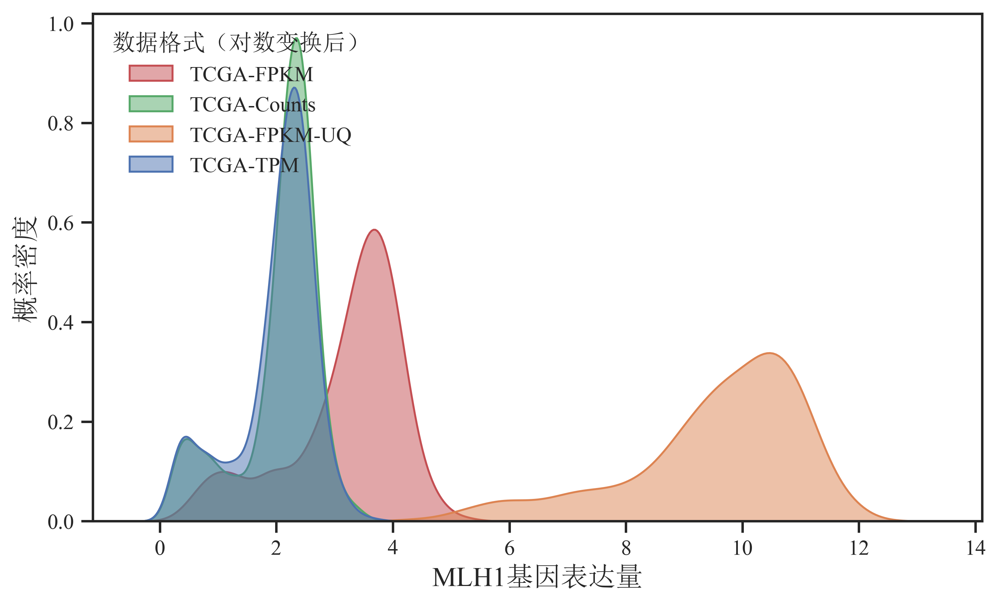

In [411]:
data_dis_gene(TCGA,TCGA_counts,TCGA_UQ,TCGA_TPM,"orgin")

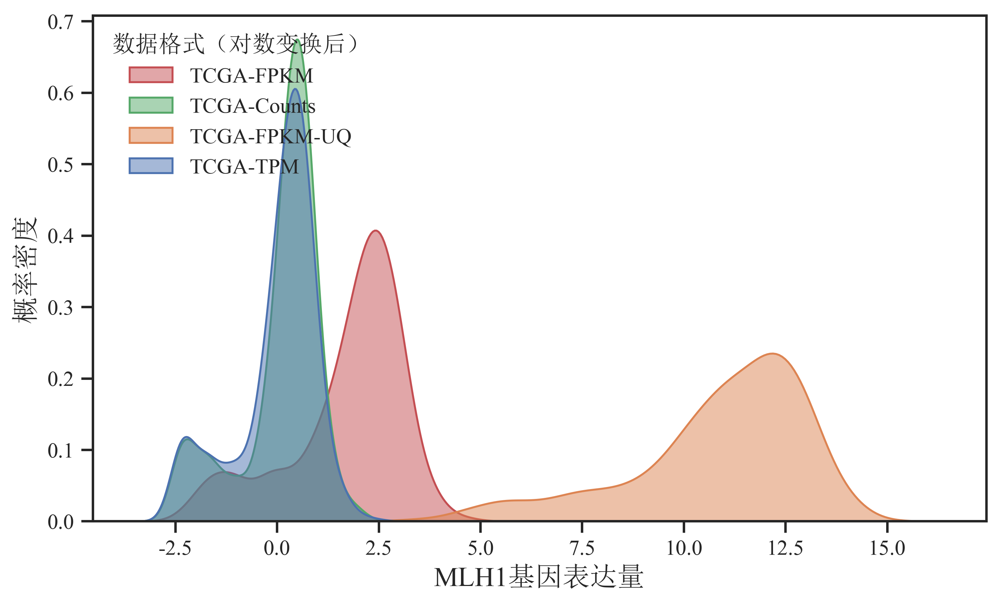

In [1588]:
scaler = StandardScaler()
scaler = scaler.fit(TCGA)
TCGA_scale = pd.DataFrame(scaler.transform(TCGA),index=TCGA.index,columns=TCGA.columns)
TCGA_counts_scale = pd.DataFrame(scaler.transform(TCGA_counts),index=TCGA_counts.index,columns=TCGA_counts.columns)
TCGA_UQ_scale = pd.DataFrame(scaler.transform(TCGA_UQ),index=TCGA_UQ.index,columns=TCGA_UQ.columns)
TCGA_TPM_scale = pd.DataFrame(scaler.transform(TCGA_TPM),index=TCGA_TPM.index,columns=TCGA_TPM.columns)

data_dis_gene(TCGA_scale,TCGA_counts_scale,TCGA_UQ_scale,TCGA_TPM_scale,"scaler_by_FPKM")

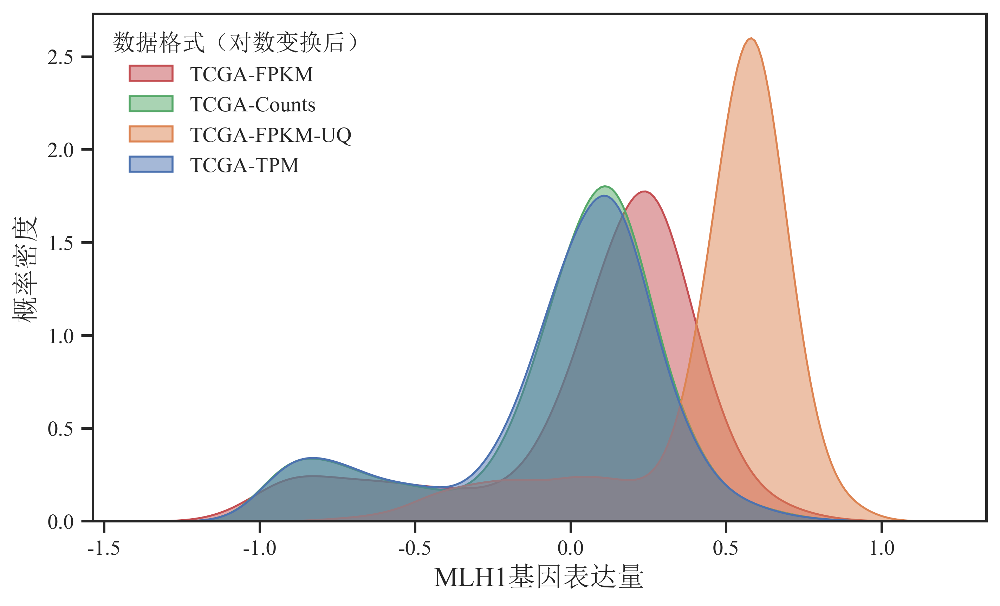

In [1453]:
data_dis_gene(zcoreScaler(TCGA),zcoreScaler(TCGA_counts),zcoreScaler(TCGA_UQ),zcoreScaler(TCGA_TPM),"scaler_by_sample")

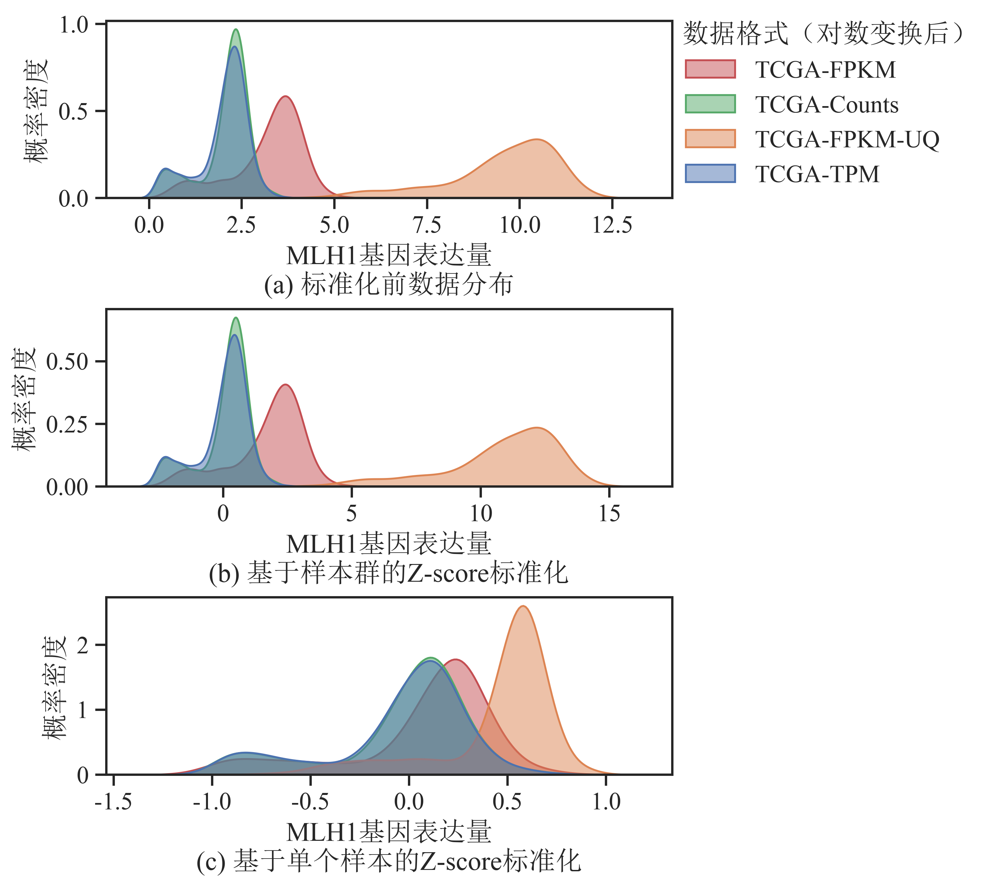

In [1690]:
fig, ax =plt.subplots(3,1,constrained_layout=True,figsize=(5,6.5),dpi=400)

database = list(report.Database.unique())
xlabels = []
for name in database:
    xlabels.append(name+"(N="+str(list(report[report["Database"] == name].Sample_num)[0])+")")
    

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
plt.subplot(3,1,1)
merge_MLH1 = get_dis_merge(TCGA,TCGA_counts,TCGA_UQ,TCGA_TPM,"orgin")

sub = sns.kdeplot(data=merge_MLH1.reset_index(), x="MLH1", hue="database",fill=True,common_norm=False,
   alpha=0.5, linewidth=1,hue_order=["TCGA-FPKM","TCGA-Counts","TCGA-FPKM-UQ","TCGA-TPM"])
sub.legend_.remove() 
plt.title("(a) 标准化前数据分布",y=-0.6)    
sub.set_ylabel("概率密度")
sub.set_xlabel("MLH1基因表达量")

plt.subplot(3,1,2)
merge_MLH1 = get_dis_merge(TCGA_scale,TCGA_counts_scale,TCGA_UQ_scale,TCGA_TPM_scale,"scaler_by_FPKM")

sub = sns.kdeplot(data=merge_MLH1.reset_index(), x="MLH1", hue="database",fill=True,common_norm=False,
   alpha=0.5, linewidth=1,hue_order=["TCGA-FPKM","TCGA-Counts","TCGA-FPKM-UQ","TCGA-TPM"])      
sub.set_ylabel("概率密度")
plt.title("(b) 基于样本群的Z-score标准化",y=-0.6)    
sub.set_xlabel("MLH1基因表达量")
sub.legend_.remove() 

plt.subplot(3,1,3)
merge_MLH1 = get_dis_merge(zcoreScaler(TCGA),zcoreScaler(TCGA_counts),zcoreScaler(TCGA_UQ),zcoreScaler(TCGA_TPM),"scaler_by_sample")

sub = sns.kdeplot(data=merge_MLH1.reset_index(), x="MLH1", hue="database",fill=True,common_norm=False,
   alpha=0.5, linewidth=1,hue_order=["TCGA-FPKM","TCGA-Counts","TCGA-FPKM-UQ","TCGA-TPM"])
      
sub.set_ylabel("概率密度")
sub.set_xlabel("MLH1基因表达量")
plt.title("(c) 基于单个样本的Z-score标准化",y=-0.6)
sub.legend_.remove() 

fig.legend(["TCGA-FPKM","TCGA-Counts","TCGA-FPKM-UQ","TCGA-TPM"],title="     数据格式（对数变换后）",frameon=False,loc = 'upper right',bbox_to_anchor=(1.48,1.01),ncol=1)

plt.savefig("./result/data_preprocess/compare_merge.svg",bbox_inches='tight')


In [401]:
def get_dis_merge(FPKM,Counts,UQ,TPM,name):
    FPKM_MLH1 = pd.DataFrame(FPKM["MLH1"])
    FPKM_MLH1["database"] = "TCGA-FPKM"
    Counts_MLH1 = pd.DataFrame(Counts["MLH1"])
    Counts_MLH1["database"] = "TCGA-Counts"
    UQ_MLH1 = pd.DataFrame(UQ["MLH1"])
    UQ_MLH1["database"] = "TCGA-FPKM-UQ"
    TPM_MLH1 = pd.DataFrame(TPM["MLH1"])
    TPM_MLH1["database"] = "TCGA-TPM"
    
    merge_MLH1 = FPKM_MLH1.append(Counts_MLH1).append(UQ_MLH1).append(TPM_MLH1)
    return  merge_MLH1

In [402]:
def data_dis_gene(FPKM,Counts,UQ,TPM,name):
    FPKM_MLH1 = pd.DataFrame(FPKM["MLH1"])
    FPKM_MLH1["database"] = "TCGA-FPKM"
    Counts_MLH1 = pd.DataFrame(Counts["MLH1"])
    Counts_MLH1["database"] = "TCGA-Counts"
    UQ_MLH1 = pd.DataFrame(UQ["MLH1"])
    UQ_MLH1["database"] = "TCGA-FPKM-UQ"
    TPM_MLH1 = pd.DataFrame(TPM["MLH1"])
    TPM_MLH1["database"] = "TCGA-TPM"
    
    merge_MLH1 = FPKM_MLH1.append(Counts_MLH1).append(UQ_MLH1).append(TPM_MLH1)
    
    fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7, 4.2),dpi=400)
    rc = {'font.sans-serif': ['SongTimes'],
          'axes.unicode_minus': False}
    sns.set(context='notebook', style='ticks', rc=rc)
    
    sub = sns.kdeplot(data=merge_MLH1.reset_index(), x="MLH1", hue="database",fill=True,common_norm=False,
   alpha=0.5, linewidth=1,hue_order=["TCGA-FPKM","TCGA-Counts","TCGA-FPKM-UQ","TCGA-TPM"])
    plt.legend(["TCGA-FPKM","TCGA-Counts","TCGA-FPKM-UQ","TCGA-TPM"], title = "数据格式（对数变换后）",frameon=False,loc = 'upper left')
    
    
    sub.set_ylabel("概率密度",fontsize=14)
#     sub.set_ylim(0,0.75)
    sub.set_xlabel("MLH1基因表达量",fontsize=14)
    
    plt.savefig("./result/data_preprocess/"+name+".svg")

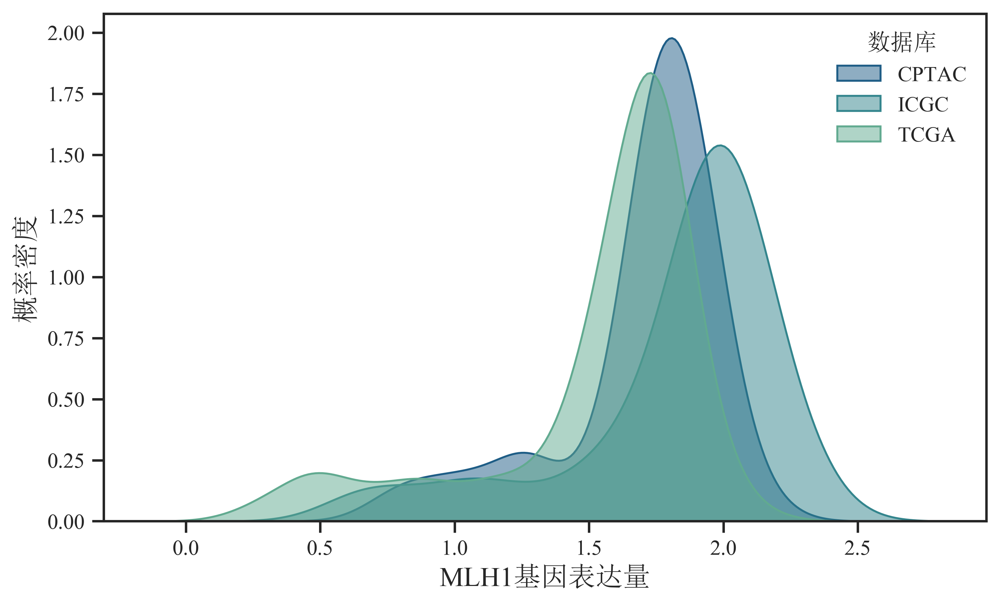

In [226]:
data_dis_gene(TCGA,ICGC,CPTAC,"orgin")

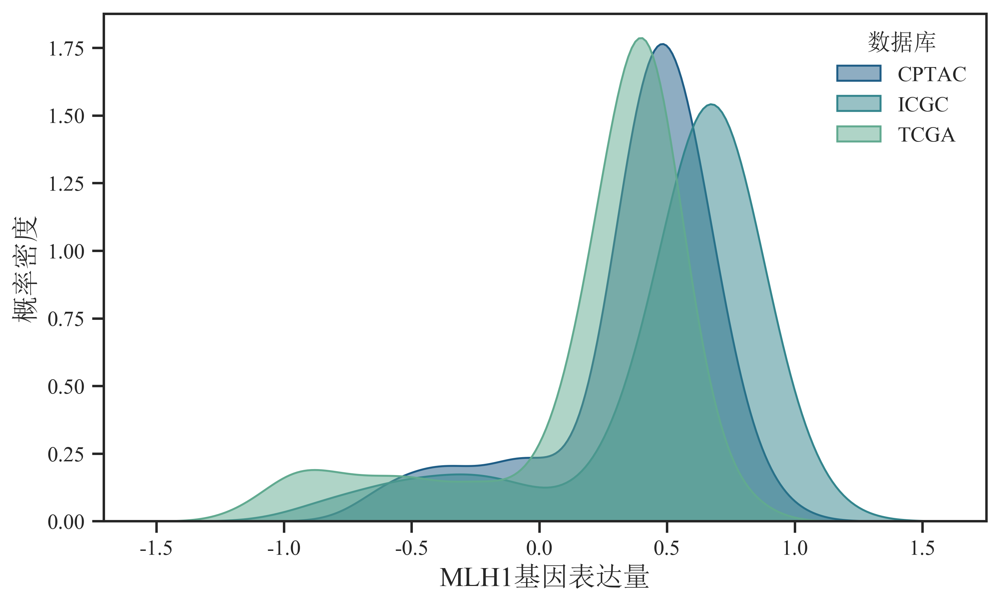

In [227]:
data_dis_gene(zcoreScaler(TCGA),zcoreScaler(ICGC),zcoreScaler(CPTAC),"scaler_by_sample")

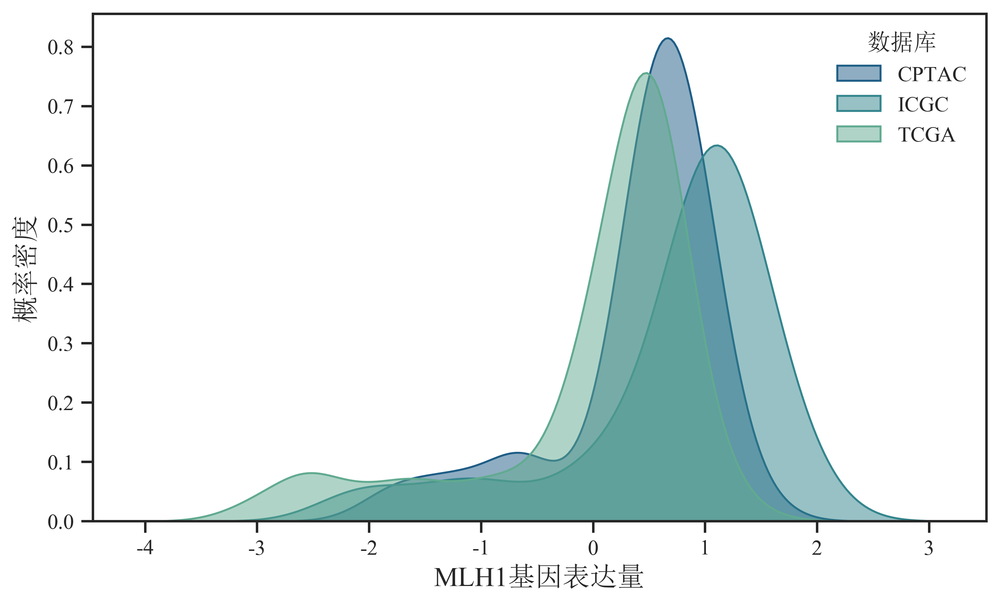

In [228]:
scaler = StandardScaler()
scaler = scaler.fit(TCGA)
TCGA_scale = pd.DataFrame(scaler.transform(TCGA),index=TCGA.index,columns=TCGA.columns)
ICGC_scale = pd.DataFrame(scaler.transform(ICGC),index=ICGC.index,columns=TCGA.columns)
CPTAC_scale = pd.DataFrame(scaler.transform(CPTAC),index=CPTAC.index,columns=TCGA.columns)

data_dis_gene(TCGA_scale,ICGC_scale,CPTAC_scale,"scaler_by_TCGA")

In [ ]:
# genesort

# 第一次过滤，过滤掉pearson_p>0.05和spearman>0.05的基因

In [503]:
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))

In [506]:
print(len(genes))

16794


In [504]:
# RANDOM_STATE = 42
RANDOM_STATE = 0
features = TCGA[genes].applymap(lambda x:np.log2(x+1))
# target = TCGA["msi"]
target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)

In [507]:
# 样本z-score
X_train_scale = zcoreScaler(X_train)

In [508]:
sort_table = pd.DataFrame(index=X_train_scale.columns)

import scipy.stats as stats
spearman = []
spearman_p = []
pearson = []
pearson_p = []
for column_index, exp in X_train_scale.iteritems():
    spearman.append(abs(stats.spearmanr(exp,y_train)[0]))
    spearman_p.append(stats.spearmanr(exp,y_train)[1])

sort_table["spearman"] = spearman
sort_table["spearman_p"] = spearman_p
genes_p = list(sort_table[sort_table["spearman_p"] <= 0.01].index)
print(len(genes_p))

10501


In [509]:
sort_table.to_csv("./result/gene_sort/sort_table_cor.csv")

In [102]:
# genesort

# 第二次过滤，基因按不同重要度指标排序

In [899]:
sort_table = pd.read_csv("./result/gene_sort/sort_table_cor.csv",index_col=0)

In [900]:
sort_table = sort_table.loc[genes_p,:]
X_train = X_train[genes_p]

In [901]:
X_train_scale = zcoreScaler(X_train)

In [902]:
sort_table = pd.DataFrame(index = genes_p)

In [903]:

from sklearn.model_selection import StratifiedKFold, KFold
kf = KFold(n_splits=5)
y = pd.get_dummies(TCGA.msi)["MSI-H"]
sort_table = pd.DataFrame(index = genes_p)

i = 1
fold = pd.DataFrame(index = genes_p)
for train, test in kf.split(X_train_scale, y_train): 
    X = X_train_scale.iloc[train,:]
    y = y_train[train]
    model = linear_model.Lasso(random_state=6,alpha=0.01)
    model.fit(X,y)
    fold["Loop"+str(i)] = abs(model.coef_)
    display(fold)
    i += 1
sort_table["lasso_coef"] = fold.T.mean()
display(sort_table)

fold = pd.DataFrame(index = genes_p)
for train, test in kf.split(X_train_scale, y_train):
    X = X_train_scale.iloc[train,:]
    y = y_train[train]
    model = svm.SVR(kernel="linear")
    model.fit(X,y)
    fold["Loop"+str(i)] = abs(model.coef_[0])
    display(fold)
    i += 1
sort_table["svm_coef"] = fold.T.mean()
display(sort_table)

for train, test in kf.split(X_train_scale, y_train):
    fold = pd.DataFrame(index = genes_p)
    X = X_train_scale.iloc[train,:]
    y = y_train[train]
    model = ensemble.RandomForestRegressor(random_state=6)
    model.fit(X,y)
    fold["Loop"+str(i)] = abs(model.feature_importances_)
    i += 1
sort_table["RandomForest_importance"] = fold.T.mean()
display(sort_table)

fold = pd.DataFrame(index = genes_p)
for train, test in kf.split(X_train_scale, y_train):
    X = X_train_scale.iloc[train,:]
    y = y_train[train]
    model = ensemble.AdaBoostRegressor(random_state=6)
    model.fit(X,y)
    fold["Loop"+str(i)] = abs(model.feature_importances_)
    display(fold)
    i += 1
sort_table["AdaBoost_importance"] = fold.T.mean()
display(sort_table)
    
fold = pd.DataFrame(index = genes_p)
for train, test in kf.split(X_train_scale, y_train):
    X = X_train_scale.iloc[train,:]
    y = y_train[train]
    model = ensemble.GradientBoostingRegressor(random_state=6) 
    model.fit(X,y)
    fold["Loop"+str(i)] = abs(model.feature_importances_)
    display(fold)
    i += 1
sort_table["GradientBoost_importance"] = fold.T.mean()
display(sort_table)

fold = pd.DataFrame(index = genes_p)
for train, test in kf.split(X_train_scale, y_train):
    X = X_train_scale.iloc[train,:]
    y = y_train[train]
    model = ensemble.ExtraTreesRegressor(random_state=6)
    model.fit(X,y)
    fold["Loop"+str(i)] = abs(model.feature_importances_)
    display(fold)
    i += 1
sort_table["ExtraTrees_importance"] = fold.T.mean()
display(sort_table)

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.521e+02, tolerance: 6.076e+00


,Loop1
C6orf118,0.0
C8B,0.0
MRPL40,0.0
SLC22A6,0.0
CCNB1IP1,0.0
...,...
LYVE1,0.0
HRH2,0.0
SLC2A10,0.0
TAF5,0.0


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.335e+02, tolerance: 5.850e+00


,Loop1,Loop2
C6orf118,0.0,0.0
C8B,0.0,0.0
MRPL40,0.0,0.0
SLC22A6,0.0,0.0
CCNB1IP1,0.0,0.0
...,...,...
LYVE1,0.0,0.0
HRH2,0.0,0.0
SLC2A10,0.0,0.0
TAF5,0.0,0.0


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.996e+02, tolerance: 5.424e+00


,Loop1,Loop2,Loop3
C6orf118,0.0,0.0,0.0
C8B,0.0,0.0,0.0
MRPL40,0.0,0.0,0.0
SLC22A6,0.0,0.0,0.0
CCNB1IP1,0.0,0.0,0.0
...,...,...,...
LYVE1,0.0,0.0,0.0
HRH2,0.0,0.0,0.0
SLC2A10,0.0,0.0,0.0
TAF5,0.0,0.0,0.0


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.924e+02, tolerance: 5.783e+00


,Loop1,Loop2,Loop3,Loop4
C6orf118,0.0,0.0,0.0,0.0
C8B,0.0,0.0,0.0,0.0
MRPL40,0.0,0.0,0.0,0.0
SLC22A6,0.0,0.0,0.0,0.0
CCNB1IP1,0.0,0.0,0.0,0.0
...,...,...,...,...
LYVE1,0.0,0.0,0.0,0.0
HRH2,0.0,0.0,0.0,0.0
SLC2A10,0.0,0.0,0.0,0.0
TAF5,0.0,0.0,0.0,0.0


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.591e+02, tolerance: 5.895e+00


,Loop1,Loop2,Loop3,Loop4,Loop5
C6orf118,0.0,0.0,0.0,0.0,0.0
C8B,0.0,0.0,0.0,0.0,0.0
MRPL40,0.0,0.0,0.0,0.0,0.0
SLC22A6,0.0,0.0,0.0,0.0,0.0
CCNB1IP1,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...
LYVE1,0.0,0.0,0.0,0.0,0.0
HRH2,0.0,0.0,0.0,0.0,0.0
SLC2A10,0.0,0.0,0.0,0.0,0.0
TAF5,0.0,0.0,0.0,0.0,0.0


,lasso_coef
C6orf118,0.0
C8B,0.0
MRPL40,0.0
SLC22A6,0.0
CCNB1IP1,0.0
...,...
LYVE1,0.0
HRH2,0.0
SLC2A10,0.0
TAF5,0.0


,Loop6
C6orf118,0.077586
C8B,0.039714
MRPL40,0.002725
SLC22A6,0.021666
CCNB1IP1,0.041736
...,...
LYVE1,0.022110
HRH2,0.051775
SLC2A10,0.060903
TAF5,0.031797


,Loop6,Loop7
C6orf118,0.077586,0.031836
C8B,0.039714,0.042207
MRPL40,0.002725,0.037813
SLC22A6,0.021666,0.013846
CCNB1IP1,0.041736,0.111185
...,...,...
LYVE1,0.022110,0.101044
HRH2,0.051775,0.011135
SLC2A10,0.060903,0.022708
TAF5,0.031797,0.043709


,Loop6,Loop7,Loop8
C6orf118,0.077586,0.031836,0.054731
C8B,0.039714,0.042207,0.016562
MRPL40,0.002725,0.037813,0.038068
SLC22A6,0.021666,0.013846,0.007440
CCNB1IP1,0.041736,0.111185,0.078724
...,...,...,...
LYVE1,0.022110,0.101044,0.019783
HRH2,0.051775,0.011135,0.000839
SLC2A10,0.060903,0.022708,0.015020
TAF5,0.031797,0.043709,0.033690


,Loop6,Loop7,Loop8,Loop9
C6orf118,0.077586,0.031836,0.054731,0.087493
C8B,0.039714,0.042207,0.016562,0.039594
MRPL40,0.002725,0.037813,0.038068,0.031992
SLC22A6,0.021666,0.013846,0.007440,0.009868
CCNB1IP1,0.041736,0.111185,0.078724,0.051512
...,...,...,...,...
LYVE1,0.022110,0.101044,0.019783,0.016258
HRH2,0.051775,0.011135,0.000839,0.066122
SLC2A10,0.060903,0.022708,0.015020,0.041440
TAF5,0.031797,0.043709,0.033690,0.019631


,Loop6,Loop7,Loop8,Loop9,Loop10
C6orf118,0.077586,0.031836,0.054731,0.087493,0.072727
C8B,0.039714,0.042207,0.016562,0.039594,0.032417
MRPL40,0.002725,0.037813,0.038068,0.031992,0.005896
SLC22A6,0.021666,0.013846,0.007440,0.009868,0.028763
CCNB1IP1,0.041736,0.111185,0.078724,0.051512,0.036566
...,...,...,...,...,...
LYVE1,0.022110,0.101044,0.019783,0.016258,0.015004
HRH2,0.051775,0.011135,0.000839,0.066122,0.091137
SLC2A10,0.060903,0.022708,0.015020,0.041440,0.075164
TAF5,0.031797,0.043709,0.033690,0.019631,0.003233


,lasso_coef,svm_coef
C6orf118,0.0,0.064875
C8B,0.0,0.034099
MRPL40,0.0,0.023299
SLC22A6,0.0,0.016317
CCNB1IP1,0.0,0.063944
...,...,...
LYVE1,0.0,0.034840
HRH2,0.0,0.044201
SLC2A10,0.0,0.043047
TAF5,0.0,0.026412


,lasso_coef,svm_coef,RandomForest_importance
C6orf118,0.0,0.064875,3.170314e-08
C8B,0.0,0.034099,1.022077e-08
MRPL40,0.0,0.023299,6.410779e-11
SLC22A6,0.0,0.016317,5.190421e-10
CCNB1IP1,0.0,0.063944,2.479827e-05
...,...,...,...
LYVE1,0.0,0.034840,2.272372e-05
HRH2,0.0,0.044201,9.674639e-07
SLC2A10,0.0,0.043047,5.083220e-08
TAF5,0.0,0.026412,0.000000e+00


,Loop16
C6orf118,0.000000
C8B,0.000000
MRPL40,0.000000
SLC22A6,0.000000
CCNB1IP1,0.000000
...,...
LYVE1,0.000000
HRH2,0.000000
SLC2A10,0.000000
TAF5,0.000000


,Loop16,Loop17
C6orf118,0.000000,0.0
C8B,0.000000,0.0
MRPL40,0.000000,0.0
SLC22A6,0.000000,0.0
CCNB1IP1,0.000000,0.0
...,...,...
LYVE1,0.000000,0.0
HRH2,0.000000,0.0
SLC2A10,0.000000,0.0
TAF5,0.000000,0.0


,Loop16,Loop17,Loop18
C6orf118,0.000000,0.0,0.0
C8B,0.000000,0.0,0.0
MRPL40,0.000000,0.0,0.0
SLC22A6,0.000000,0.0,0.0
CCNB1IP1,0.000000,0.0,0.0
...,...,...,...
LYVE1,0.000000,0.0,0.0
HRH2,0.000000,0.0,0.0
SLC2A10,0.000000,0.0,0.0
TAF5,0.000000,0.0,0.0


,Loop16,Loop17,Loop18,Loop19
C6orf118,0.000000,0.0,0.0,0.0
C8B,0.000000,0.0,0.0,0.0
MRPL40,0.000000,0.0,0.0,0.0
SLC22A6,0.000000,0.0,0.0,0.0
CCNB1IP1,0.000000,0.0,0.0,0.0
...,...,...,...,...
LYVE1,0.000000,0.0,0.0,0.0
HRH2,0.000000,0.0,0.0,0.0
SLC2A10,0.000000,0.0,0.0,0.0
TAF5,0.000000,0.0,0.0,0.0


,Loop16,Loop17,Loop18,Loop19,Loop20
C6orf118,0.000000,0.0,0.0,0.0,0.0
C8B,0.000000,0.0,0.0,0.0,0.0
MRPL40,0.000000,0.0,0.0,0.0,0.0
SLC22A6,0.000000,0.0,0.0,0.0,0.0
CCNB1IP1,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...
LYVE1,0.000000,0.0,0.0,0.0,0.0
HRH2,0.000000,0.0,0.0,0.0,0.0
SLC2A10,0.000000,0.0,0.0,0.0,0.0
TAF5,0.000000,0.0,0.0,0.0,0.0


,lasso_coef,svm_coef,RandomForest_importance,AdaBoost_importance
C6orf118,0.0,0.064875,3.170314e-08,0.000000
C8B,0.0,0.034099,1.022077e-08,0.000000
MRPL40,0.0,0.023299,6.410779e-11,0.000000
SLC22A6,0.0,0.016317,5.190421e-10,0.000000
CCNB1IP1,0.0,0.063944,2.479827e-05,0.000000
...,...,...,...,...
LYVE1,0.0,0.034840,2.272372e-05,0.000000
HRH2,0.0,0.044201,9.674639e-07,0.000000
SLC2A10,0.0,0.043047,5.083220e-08,0.000000
TAF5,0.0,0.026412,0.000000e+00,0.000000


,Loop21
C6orf118,0.000000
C8B,0.000000
MRPL40,0.000000
SLC22A6,0.000000
CCNB1IP1,0.000000
...,...
LYVE1,0.000000
HRH2,0.000096
SLC2A10,0.000000
TAF5,0.000000


,Loop21,Loop22
C6orf118,0.000000,0.000000
C8B,0.000000,0.000000
MRPL40,0.000000,0.000000
SLC22A6,0.000000,0.000000
CCNB1IP1,0.000000,0.000000
...,...,...
LYVE1,0.000000,0.000000
HRH2,0.000096,0.000000
SLC2A10,0.000000,0.000000
TAF5,0.000000,0.000000


,Loop21,Loop22,Loop23
C6orf118,0.000000,0.000000,0.0
C8B,0.000000,0.000000,0.0
MRPL40,0.000000,0.000000,0.0
SLC22A6,0.000000,0.000000,0.0
CCNB1IP1,0.000000,0.000000,0.0
...,...,...,...
LYVE1,0.000000,0.000000,0.0
HRH2,0.000096,0.000000,0.0
SLC2A10,0.000000,0.000000,0.0
TAF5,0.000000,0.000000,0.0


,Loop21,Loop22,Loop23,Loop24
C6orf118,0.000000,0.000000,0.0,0.0
C8B,0.000000,0.000000,0.0,0.0
MRPL40,0.000000,0.000000,0.0,0.0
SLC22A6,0.000000,0.000000,0.0,0.0
CCNB1IP1,0.000000,0.000000,0.0,0.0
...,...,...,...,...
LYVE1,0.000000,0.000000,0.0,0.0
HRH2,0.000096,0.000000,0.0,0.0
SLC2A10,0.000000,0.000000,0.0,0.0
TAF5,0.000000,0.000000,0.0,0.0


,Loop21,Loop22,Loop23,Loop24,Loop25
C6orf118,0.000000,0.000000,0.0,0.0,0.0
C8B,0.000000,0.000000,0.0,0.0,0.0
MRPL40,0.000000,0.000000,0.0,0.0,0.0
SLC22A6,0.000000,0.000000,0.0,0.0,0.0
CCNB1IP1,0.000000,0.000000,0.0,0.0,0.0
...,...,...,...,...,...
LYVE1,0.000000,0.000000,0.0,0.0,0.0
HRH2,0.000096,0.000000,0.0,0.0,0.0
SLC2A10,0.000000,0.000000,0.0,0.0,0.0
TAF5,0.000000,0.000000,0.0,0.0,0.0


,lasso_coef,svm_coef,RandomForest_importance,AdaBoost_importance,GradientBoost_importance
C6orf118,0.0,0.064875,3.170314e-08,0.000000,0.000000
C8B,0.0,0.034099,1.022077e-08,0.000000,0.000000
MRPL40,0.0,0.023299,6.410779e-11,0.000000,0.000000
SLC22A6,0.0,0.016317,5.190421e-10,0.000000,0.000000
CCNB1IP1,0.0,0.063944,2.479827e-05,0.000000,0.000000
...,...,...,...,...,...
LYVE1,0.0,0.034840,2.272372e-05,0.000000,0.000000
HRH2,0.0,0.044201,9.674639e-07,0.000000,0.000019
SLC2A10,0.0,0.043047,5.083220e-08,0.000000,0.000000
TAF5,0.0,0.026412,0.000000e+00,0.000000,0.000000


,Loop26
C6orf118,1.057671e-04
C8B,9.262827e-10
MRPL40,3.891183e-05
SLC22A6,6.322567e-08
CCNB1IP1,1.188888e-04
...,...
LYVE1,4.463244e-06
HRH2,1.027112e-05
SLC2A10,1.309285e-09
TAF5,3.268941e-08


,Loop26,Loop27
C6orf118,1.057671e-04,3.139211e-08
C8B,9.262827e-10,5.422041e-09
MRPL40,3.891183e-05,1.294797e-05
SLC22A6,6.322567e-08,3.920496e-08
CCNB1IP1,1.188888e-04,2.487814e-05
...,...,...
LYVE1,4.463244e-06,1.503824e-04
HRH2,1.027112e-05,2.701165e-07
SLC2A10,1.309285e-09,7.203499e-06
TAF5,3.268941e-08,3.327362e-08


,Loop26,Loop27,Loop28
C6orf118,1.057671e-04,3.139211e-08,7.142851e-08
C8B,9.262827e-10,5.422041e-09,7.449755e-06
MRPL40,3.891183e-05,1.294797e-05,2.290407e-08
SLC22A6,6.322567e-08,3.920496e-08,3.893920e-08
CCNB1IP1,1.188888e-04,2.487814e-05,1.007050e-04
...,...,...,...
LYVE1,4.463244e-06,1.503824e-04,7.749733e-05
HRH2,1.027112e-05,2.701165e-07,1.996120e-07
SLC2A10,1.309285e-09,7.203499e-06,3.959183e-06
TAF5,3.268941e-08,3.327362e-08,2.094793e-06


,Loop26,Loop27,Loop28,Loop29
C6orf118,1.057671e-04,3.139211e-08,7.142851e-08,6.406592e-05
C8B,9.262827e-10,5.422041e-09,7.449755e-06,1.355104e-05
MRPL40,3.891183e-05,1.294797e-05,2.290407e-08,1.513080e-08
SLC22A6,6.322567e-08,3.920496e-08,3.893920e-08,1.038404e-06
CCNB1IP1,1.188888e-04,2.487814e-05,1.007050e-04,1.611447e-07
...,...,...,...,...
LYVE1,4.463244e-06,1.503824e-04,7.749733e-05,2.001064e-05
HRH2,1.027112e-05,2.701165e-07,1.996120e-07,3.044940e-07
SLC2A10,1.309285e-09,7.203499e-06,3.959183e-06,3.007345e-09
TAF5,3.268941e-08,3.327362e-08,2.094793e-06,4.161977e-06


,Loop26,Loop27,Loop28,Loop29,Loop30
C6orf118,1.057671e-04,3.139211e-08,7.142851e-08,6.406592e-05,7.221257e-09
C8B,9.262827e-10,5.422041e-09,7.449755e-06,1.355104e-05,1.166242e-08
MRPL40,3.891183e-05,1.294797e-05,2.290407e-08,1.513080e-08,3.067124e-05
SLC22A6,6.322567e-08,3.920496e-08,3.893920e-08,1.038404e-06,1.112417e-06
CCNB1IP1,1.188888e-04,2.487814e-05,1.007050e-04,1.611447e-07,1.756916e-06
...,...,...,...,...,...
LYVE1,4.463244e-06,1.503824e-04,7.749733e-05,2.001064e-05,7.078462e-05
HRH2,1.027112e-05,2.701165e-07,1.996120e-07,3.044940e-07,8.852684e-09
SLC2A10,1.309285e-09,7.203499e-06,3.959183e-06,3.007345e-09,3.042105e-05
TAF5,3.268941e-08,3.327362e-08,2.094793e-06,4.161977e-06,5.826752e-05


,lasso_coef,svm_coef,RandomForest_importance,AdaBoost_importance,GradientBoost_importance,ExtraTrees_importance
C6orf118,0.0,0.064875,3.170314e-08,0.000000,0.000000,3.398860e-05
C8B,0.0,0.034099,1.022077e-08,0.000000,0.000000,4.203762e-06
MRPL40,0.0,0.023299,6.410779e-11,0.000000,0.000000,1.651382e-05
SLC22A6,0.0,0.016317,5.190421e-10,0.000000,0.000000,4.584381e-07
CCNB1IP1,0.0,0.063944,2.479827e-05,0.000000,0.000000,4.927799e-05
...,...,...,...,...,...,...
LYVE1,0.0,0.034840,2.272372e-05,0.000000,0.000000,6.462765e-05
HRH2,0.0,0.044201,9.674639e-07,0.000000,0.000019,2.210838e-06
SLC2A10,0.0,0.043047,5.083220e-08,0.000000,0.000000,8.317610e-06
TAF5,0.0,0.026412,0.000000e+00,0.000000,0.000000,1.291805e-05


In [897]:
fold

,Loop30
C6orf118,7.221257e-09
C8B,1.166242e-08
MRPL40,3.067124e-05
SLC22A6,1.112417e-06
CCNB1IP1,1.756916e-06
...,...
LYVE1,7.078462e-05
HRH2,8.852684e-09
SLC2A10,3.042105e-05
TAF5,5.826752e-05


In [ ]:
def importance_cv(model,train,test):
    model.fit(X_train_scale,y_train)

In [515]:
from sklearn import linear_model
model = linear_model.Lasso(random_state=6,alpha=0.01)
model.fit(X_train_scale,y_train)
sort_table["lasso_coef"] = abs(model.coef_)

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.434e+02, tolerance: 7.260e+00


In [516]:
from sklearn import svm
model = svm.SVR(kernel="linear")
model.fit(X_train_scale,y_train)
sort_table["svm_coef"] = abs(model.coef_[0])

In [517]:
from sklearn import ensemble
model = ensemble.RandomForestRegressor(random_state=6)
model.fit(X_train_scale,y_train)
sort_table["RandomForest_importance"] = abs(model.feature_importances_)

In [518]:
from sklearn import ensemble
model = ensemble.AdaBoostRegressor(random_state=6) 
model.fit(X_train_scale,y_train)
sort_table["AdaBoost_importance"] = abs(model.feature_importances_)

In [519]:
from sklearn import ensemble
model = ensemble.GradientBoostingRegressor(random_state=6) 
model.fit(X_train_scale,y_train)
sort_table["GradientBoost_importance"] = abs(model.feature_importances_)

In [520]:
from sklearn import ensemble
model = ensemble.ExtraTreesRegressor(random_state=6)
model.fit(X_train_scale,y_train)
sort_table["ExtraTrees_importance"] = abs(model.feature_importances_)

In [904]:
sort_table.to_csv("./result/gene_sort/sort_table.csv")

In [837]:
sort_table.sort_values(by="spearman",ascending=False)

KeyError: 'spearman'

In [ ]:
# model compare

In [523]:
# 1.lasso回归
from sklearn import linear_model
model_lasso_regressor = linear_model.Lasso(random_state=6)
 
# 2.SVM回归
from sklearn import svm
model_svm_regressor = svm.SVR(kernel="linear")

# 3.决策树回归
from sklearn.tree import DecisionTreeRegressor
model_decision_tree_regressor = DecisionTreeRegressor(random_state=6)

# 4.随机森林回归
from sklearn import ensemble
model_random_forest_regressor = ensemble.RandomForestRegressor(random_state=6)

# 5.Adaboost回归
from sklearn import ensemble
model_adaboost_regressor = ensemble.AdaBoostRegressor(random_state=6)  
 
# 6.GBRT回归
from sklearn import ensemble
model_gradient_boosting_regressor = ensemble.GradientBoostingRegressor(random_state=6,loss="huber") 

# 7.Bagging回归
from sklearn import ensemble
model_bagging_regressor = ensemble.BaggingRegressor(random_state=6)

# 8.极度随机树
from sklearn import ensemble
model_extraTrees_regressor = ensemble.ExtraTreesRegressor(random_state=6)

In [905]:
selection = sort_table
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)

In [906]:
X_train = X_train[genes_p]

In [526]:
selection = selection.drop(columns=["spearman_p","spearman"])

lasso_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time
linear,-33.330421,0.534429,0.003590,0.001796
lasso,-45.046966,0.382056,0.002593,0.001596
svm,-45.575399,0.428898,0.029920,0.005386
decision_tree,-47.034998,0.358915,0.012168,0.002194
random_forest,-23.888516,0.669183,1.249260,0.011569
adaboost,-46.111781,0.572453,0.116290,0.006781
gradient_boost,-26.444868,0.635552,0.630514,0.001995
bagging,-25.065901,0.653400,0.126062,0.003591
extra_trees,-22.899329,0.683745,0.286434,0.012367


svm_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time
linear,-33.330421,0.534429,0.003590,0.001796,-34.159337,0.525893,0.002992,0.001795
lasso,-45.046966,0.382056,0.002593,0.001596,-44.209010,0.394358,0.002593,0.001994
svm,-45.575399,0.428898,0.029920,0.005386,-50.967493,0.379860,0.032512,0.004988
decision_tree,-47.034998,0.358915,0.012168,0.002194,-48.280516,0.323618,0.010771,0.001796
random_forest,-23.888516,0.669183,1.249260,0.011569,-25.671657,0.643106,1.141348,0.011569
adaboost,-46.111781,0.572453,0.116290,0.006781,-42.434392,0.570189,0.099533,0.005585
gradient_boost,-26.444868,0.635552,0.630514,0.001995,-29.180562,0.602687,0.625727,0.002194
bagging,-25.065901,0.653400,0.126062,0.003591,-28.207954,0.609603,0.124666,0.004189
extra_trees,-22.899329,0.683745,0.286434,0.012367,-24.167099,0.666499,0.286633,0.012168


RandomForest_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time
linear,-33.330421,0.534429,0.003590,0.001796,-34.159337,0.525893,0.002992,0.001795,-25.947341,0.639049,0.002593,0.002194
lasso,-45.046966,0.382056,0.002593,0.001596,-44.209010,0.394358,0.002593,0.001994,-41.198050,0.435588,0.002593,0.001596
svm,-45.575399,0.428898,0.029920,0.005386,-50.967493,0.379860,0.032512,0.004988,-29.400904,0.609373,0.030917,0.004388
decision_tree,-47.034998,0.358915,0.012168,0.002194,-48.280516,0.323618,0.010771,0.001796,-35.519861,0.509198,0.012965,0.001995
random_forest,-23.888516,0.669183,1.249260,0.011569,-25.671657,0.643106,1.141348,0.011569,-20.376783,0.717766,1.402052,0.011370
adaboost,-46.111781,0.572453,0.116290,0.006781,-42.434392,0.570189,0.099533,0.005585,-48.905778,0.613024,0.117686,0.006383
gradient_boost,-26.444868,0.635552,0.630514,0.001995,-29.180562,0.602687,0.625727,0.002194,-21.012345,0.711325,0.616951,0.001995
bagging,-25.065901,0.653400,0.126062,0.003591,-28.207954,0.609603,0.124666,0.004189,-23.668448,0.672615,0.145411,0.003391
extra_trees,-22.899329,0.683745,0.286434,0.012367,-24.167099,0.666499,0.286633,0.012168,-20.075076,0.719523,0.291221,0.011968


AdaBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time
linear,-33.330421,0.534429,0.003590,0.001796,-34.159337,0.525893,0.002992,0.001795,-25.947341,0.639049,0.002593,0.002194,-24.061201,0.663079,0.003391,0.002194
lasso,-45.046966,0.382056,0.002593,0.001596,-44.209010,0.394358,0.002593,0.001994,-41.198050,0.435588,0.002593,0.001596,-34.305267,0.527736,0.002593,0.001795
svm,-45.575399,0.428898,0.029920,0.005386,-50.967493,0.379860,0.032512,0.004988,-29.400904,0.609373,0.030917,0.004388,-27.652483,0.628715,0.030718,0.004787
decision_tree,-47.034998,0.358915,0.012168,0.002194,-48.280516,0.323618,0.010771,0.001796,-35.519861,0.509198,0.012965,0.001995,-43.138573,0.393820,0.012167,0.002195
random_forest,-23.888516,0.669183,1.249260,0.011569,-25.671657,0.643106,1.141348,0.011569,-20.376783,0.717766,1.402052,0.011370,-21.955087,0.692399,1.267411,0.011170
adaboost,-46.111781,0.572453,0.116290,0.006781,-42.434392,0.570189,0.099533,0.005585,-48.905778,0.613024,0.117686,0.006383,-33.985003,0.659032,0.112499,0.005785
gradient_boost,-26.444868,0.635552,0.630514,0.001995,-29.180562,0.602687,0.625727,0.002194,-21.012345,0.711325,0.616951,0.001995,-23.091007,0.676535,0.611564,0.002594
bagging,-25.065901,0.653400,0.126062,0.003591,-28.207954,0.609603,0.124666,0.004189,-23.668448,0.672615,0.145411,0.003391,-23.699355,0.670833,0.129454,0.003391
extra_trees,-22.899329,0.683745,0.286434,0.012367,-24.167099,0.666499,0.286633,0.012168,-20.075076,0.719523,0.291221,0.011968,-20.909518,0.708197,0.287232,0.011768


GradientBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time
linear,-33.330421,0.534429,0.003590,0.001796,-34.159337,0.525893,0.002992,0.001795,-25.947341,0.639049,0.002593,0.002194,-24.061201,0.663079,0.003391,0.002194,-27.928850,0.610969,0.002793,0.002593
lasso,-45.046966,0.382056,0.002593,0.001596,-44.209010,0.394358,0.002593,0.001994,-41.198050,0.435588,0.002593,0.001596,-34.305267,0.527736,0.002593,0.001795,-42.465232,0.418345,0.002792,0.001595
svm,-45.575399,0.428898,0.029920,0.005386,-50.967493,0.379860,0.032512,0.004988,-29.400904,0.609373,0.030917,0.004388,-27.652483,0.628715,0.030718,0.004787,-33.105968,0.564389,0.031316,0.004787
decision_tree,-47.034998,0.358915,0.012168,0.002194,-48.280516,0.323618,0.010771,0.001796,-35.519861,0.509198,0.012965,0.001995,-43.138573,0.393820,0.012167,0.002195,-41.915221,0.402251,0.011968,0.001397
random_forest,-23.888516,0.669183,1.249260,0.011569,-25.671657,0.643106,1.141348,0.011569,-20.376783,0.717766,1.402052,0.011370,-21.955087,0.692399,1.267411,0.011170,-21.503388,0.698468,1.293741,0.012168
adaboost,-46.111781,0.572453,0.116290,0.006781,-42.434392,0.570189,0.099533,0.005585,-48.905778,0.613024,0.117686,0.006383,-33.985003,0.659032,0.112499,0.005785,-39.409379,0.639010,0.113696,0.005984
gradient_boost,-26.444868,0.635552,0.630514,0.001995,-29.180562,0.602687,0.625727,0.002194,-21.012345,0.711325,0.616951,0.001995,-23.091007,0.676535,0.611564,0.002594,-22.880595,0.683399,0.613559,0.002195
bagging,-25.065901,0.653400,0.126062,0.003591,-28.207954,0.609603,0.124666,0.004189,-23.668448,0.672615,0.145411,0.003391,-23.699355,0.670833,0.129454,0.003391,-23.223877,0.674805,0.132246,0.003391
extra_trees,-22.899329,0.683745,0.286434,0.012367,-24.167099,0.666499,0.286633,0.012168,-20.075076,0.719523,0.291221,0.011968,-20.909518,0.708197,0.287232,0.011768,-20.297838,0.718075,0.290224,0.012766


ExtraTrees_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,...,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time,ExtraTrees_importance_erro,ExtraTrees_importance_var,ExtraTrees_importance_fit_time,ExtraTrees_importance_score_time
linear,-33.330421,0.534429,0.003590,0.001796,-34.159337,0.525893,0.002992,0.001795,-25.947341,0.639049,...,0.003391,0.002194,-27.928850,0.610969,0.002793,0.002593,-23.309548,0.676182,0.002792,0.002194
lasso,-45.046966,0.382056,0.002593,0.001596,-44.209010,0.394358,0.002593,0.001994,-41.198050,0.435588,...,0.002593,0.001795,-42.465232,0.418345,0.002792,0.001595,-41.926093,0.425937,0.002195,0.001794
svm,-45.575399,0.428898,0.029920,0.005386,-50.967493,0.379860,0.032512,0.004988,-29.400904,0.609373,...,0.030718,0.004787,-33.105968,0.564389,0.031316,0.004787,-26.284229,0.647009,0.029321,0.004788
decision_tree,-47.034998,0.358915,0.012168,0.002194,-48.280516,0.323618,0.010771,0.001796,-35.519861,0.509198,...,0.012167,0.002195,-41.915221,0.402251,0.011968,0.001397,-40.521063,0.439023,0.012765,0.001995
random_forest,-23.888516,0.669183,1.249260,0.011569,-25.671657,0.643106,1.141348,0.011569,-20.376783,0.717766,...,1.267411,0.011170,-21.503388,0.698468,1.293741,0.012168,-20.708303,0.714240,1.387690,0.011968
adaboost,-46.111781,0.572453,0.116290,0.006781,-42.434392,0.570189,0.099533,0.005585,-48.905778,0.613024,...,0.112499,0.005785,-39.409379,0.639010,0.113696,0.005984,-30.370905,0.688205,0.111502,0.005984
gradient_boost,-26.444868,0.635552,0.630514,0.001995,-29.180562,0.602687,0.625727,0.002194,-21.012345,0.711325,...,0.611564,0.002594,-22.880595,0.683399,0.613559,0.002195,-19.822798,0.727314,0.614756,0.001995
bagging,-25.065901,0.653400,0.126062,0.003591,-28.207954,0.609603,0.124666,0.004189,-23.668448,0.672615,...,0.129454,0.003391,-23.223877,0.674805,0.132246,0.003391,-23.110181,0.681579,0.144613,0.003791
extra_trees,-22.899329,0.683745,0.286434,0.012367,-24.167099,0.666499,0.286633,0.012168,-20.075076,0.719523,...,0.287232,0.011768,-20.297838,0.718075,0.290224,0.012766,-19.477646,0.731163,0.289824,0.012367


lasso_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time
linear,-28.455171,0.603214,0.003191,0.001596
lasso,-41.833080,0.425863,0.002393,0.001596
svm,-34.479956,0.548473,0.035105,0.005386
decision_tree,-39.665291,0.448672,0.020345,0.001995
random_forest,-21.865266,0.695692,2.320795,0.011969
adaboost,-29.669689,0.697450,0.163762,0.005984
gradient_boost,-22.051952,0.699641,0.986961,0.002194
bagging,-24.755647,0.656240,0.235969,0.003391
extra_trees,-19.487862,0.730509,0.416287,0.012168


svm_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time
linear,-28.455171,0.603214,0.003191,0.001596,-27.790889,0.614483,0.003391,0.002194
lasso,-41.833080,0.425863,0.002393,0.001596,-42.277421,0.419707,0.002792,0.001795
svm,-34.479956,0.548473,0.035105,0.005386,-34.822408,0.547139,0.038696,0.005386
decision_tree,-39.665291,0.448672,0.020345,0.001995,-33.971511,0.517000,0.021941,0.001995
random_forest,-21.865266,0.695692,2.320795,0.011969,-21.596201,0.700326,2.394398,0.012168
adaboost,-29.669689,0.697450,0.163762,0.005984,-25.358935,0.723156,0.168150,0.006184
gradient_boost,-22.051952,0.699641,0.986961,0.002194,-24.993259,0.656978,0.977188,0.002194
bagging,-24.755647,0.656240,0.235969,0.003391,-23.363069,0.674708,0.245344,0.003391
extra_trees,-19.487862,0.730509,0.416287,0.012168,-18.642089,0.742352,0.416287,0.011968


RandomForest_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time
linear,-28.455171,0.603214,0.003191,0.001596,-27.790889,0.614483,0.003391,0.002194,-24.296305,0.662335,0.003191,0.001995
lasso,-41.833080,0.425863,0.002393,0.001596,-42.277421,0.419707,0.002792,0.001795,-44.214252,0.393697,0.002792,0.001995
svm,-34.479956,0.548473,0.035105,0.005386,-34.822408,0.547139,0.038696,0.005386,-27.637648,0.633116,0.035505,0.007380
decision_tree,-39.665291,0.448672,0.020345,0.001995,-33.971511,0.517000,0.021941,0.001995,-40.842167,0.422486,0.028323,0.002195
random_forest,-21.865266,0.695692,2.320795,0.011969,-21.596201,0.700326,2.394398,0.012168,-21.419502,0.698578,3.061415,0.011370
adaboost,-29.669689,0.697450,0.163762,0.005984,-25.358935,0.723156,0.168150,0.006184,-38.423691,0.660111,0.170943,0.005785
gradient_boost,-22.051952,0.699641,0.986961,0.002194,-24.993259,0.656978,0.977188,0.002194,-19.985739,0.720143,0.980380,0.002194
bagging,-24.755647,0.656240,0.235969,0.003391,-23.363069,0.674708,0.245344,0.003391,-24.543612,0.654382,0.308774,0.003590
extra_trees,-19.487862,0.730509,0.416287,0.012168,-18.642089,0.742352,0.416287,0.011968,-19.965932,0.722009,0.440622,0.012167


AdaBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time
linear,-28.455171,0.603214,0.003191,0.001596,-27.790889,0.614483,0.003391,0.002194,-24.296305,0.662335,0.003191,0.001995,-21.190202,0.703881,0.003191,0.001995
lasso,-41.833080,0.425863,0.002393,0.001596,-42.277421,0.419707,0.002792,0.001795,-44.214252,0.393697,0.002792,0.001995,-33.736687,0.536396,0.002393,0.001596
svm,-34.479956,0.548473,0.035105,0.005386,-34.822408,0.547139,0.038696,0.005386,-27.637648,0.633116,0.035505,0.007380,-23.499238,0.683966,0.033909,0.005785
decision_tree,-39.665291,0.448672,0.020345,0.001995,-33.971511,0.517000,0.021941,0.001995,-40.842167,0.422486,0.028323,0.002195,-35.464422,0.510558,0.023537,0.002195
random_forest,-21.865266,0.695692,2.320795,0.011969,-21.596201,0.700326,2.394398,0.012168,-21.419502,0.698578,3.061415,0.011370,-18.537721,0.742450,2.687016,0.011968
adaboost,-29.669689,0.697450,0.163762,0.005984,-25.358935,0.723156,0.168150,0.006184,-38.423691,0.660111,0.170943,0.005785,-24.769767,0.737120,0.161967,0.006383
gradient_boost,-22.051952,0.699641,0.986961,0.002194,-24.993259,0.656978,0.977188,0.002194,-19.985739,0.720143,0.980380,0.002194,-18.939499,0.735401,0.981376,0.002194
bagging,-24.755647,0.656240,0.235969,0.003391,-23.363069,0.674708,0.245344,0.003391,-24.543612,0.654382,0.308774,0.003590,-19.855233,0.724199,0.270674,0.003392
extra_trees,-19.487862,0.730509,0.416287,0.012168,-18.642089,0.742352,0.416287,0.011968,-19.965932,0.722009,0.440622,0.012167,-16.815289,0.767295,0.425462,0.012766


GradientBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time
linear,-28.455171,0.603214,0.003191,0.001596,-27.790889,0.614483,0.003391,0.002194,-24.296305,0.662335,0.003191,0.001995,-21.190202,0.703881,0.003191,0.001995,-25.056216,0.650865,0.003192,0.001995
lasso,-41.833080,0.425863,0.002393,0.001596,-42.277421,0.419707,0.002792,0.001795,-44.214252,0.393697,0.002792,0.001995,-33.736687,0.536396,0.002393,0.001596,-38.737957,0.467993,0.002593,0.001795
svm,-34.479956,0.548473,0.035105,0.005386,-34.822408,0.547139,0.038696,0.005386,-27.637648,0.633116,0.035505,0.007380,-23.499238,0.683966,0.033909,0.005785,-28.428634,0.623169,0.036901,0.005585
decision_tree,-39.665291,0.448672,0.020345,0.001995,-33.971511,0.517000,0.021941,0.001995,-40.842167,0.422486,0.028323,0.002195,-35.464422,0.510558,0.023537,0.002195,-35.307120,0.506933,0.022939,0.002193
random_forest,-21.865266,0.695692,2.320795,0.011969,-21.596201,0.700326,2.394398,0.012168,-21.419502,0.698578,3.061415,0.011370,-18.537721,0.742450,2.687016,0.011968,-19.994445,0.720922,2.686817,0.012567
adaboost,-29.669689,0.697450,0.163762,0.005984,-25.358935,0.723156,0.168150,0.006184,-38.423691,0.660111,0.170943,0.005785,-24.769767,0.737120,0.161967,0.006383,-30.681276,0.700718,0.165358,0.006383
gradient_boost,-22.051952,0.699641,0.986961,0.002194,-24.993259,0.656978,0.977188,0.002194,-19.985739,0.720143,0.980380,0.002194,-18.939499,0.735401,0.981376,0.002194,-21.745196,0.699353,0.987360,0.002194
bagging,-24.755647,0.656240,0.235969,0.003391,-23.363069,0.674708,0.245344,0.003391,-24.543612,0.654382,0.308774,0.003590,-19.855233,0.724199,0.270674,0.003392,-20.540657,0.712399,0.269878,0.003192
extra_trees,-19.487862,0.730509,0.416287,0.012168,-18.642089,0.742352,0.416287,0.011968,-19.965932,0.722009,0.440622,0.012167,-16.815289,0.767295,0.425462,0.012766,-18.567622,0.742659,0.425861,0.012168


ExtraTrees_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,...,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time,ExtraTrees_importance_erro,ExtraTrees_importance_var,ExtraTrees_importance_fit_time,ExtraTrees_importance_score_time
linear,-28.455171,0.603214,0.003191,0.001596,-27.790889,0.614483,0.003391,0.002194,-24.296305,0.662335,...,0.003191,0.001995,-25.056216,0.650865,0.003192,0.001995,-21.038513,0.709906,0.003590,0.001796
lasso,-41.833080,0.425863,0.002393,0.001596,-42.277421,0.419707,0.002792,0.001795,-44.214252,0.393697,...,0.002393,0.001596,-38.737957,0.467993,0.002593,0.001795,-39.294926,0.461546,0.002393,0.001795
svm,-34.479956,0.548473,0.035105,0.005386,-34.822408,0.547139,0.038696,0.005386,-27.637648,0.633116,...,0.033909,0.005785,-28.428634,0.623169,0.036901,0.005585,-23.435515,0.684971,0.033311,0.005785
decision_tree,-39.665291,0.448672,0.020345,0.001995,-33.971511,0.517000,0.021941,0.001995,-40.842167,0.422486,...,0.023537,0.002195,-35.307120,0.506933,0.022939,0.002193,-34.523267,0.528203,0.029720,0.002195
random_forest,-21.865266,0.695692,2.320795,0.011969,-21.596201,0.700326,2.394398,0.012168,-21.419502,0.698578,...,2.687016,0.011968,-19.994445,0.720922,2.686817,0.012567,-19.579165,0.730094,3.051242,0.012566
adaboost,-29.669689,0.697450,0.163762,0.005984,-25.358935,0.723156,0.168150,0.006184,-38.423691,0.660111,...,0.161967,0.006383,-30.681276,0.700718,0.165358,0.006383,-31.283357,0.707467,0.161767,0.005984
gradient_boost,-22.051952,0.699641,0.986961,0.002194,-24.993259,0.656978,0.977188,0.002194,-19.985739,0.720143,...,0.981376,0.002194,-21.745196,0.699353,0.987360,0.002194,-19.866434,0.726497,0.984169,0.002593
bagging,-24.755647,0.656240,0.235969,0.003391,-23.363069,0.674708,0.245344,0.003391,-24.543612,0.654382,...,0.270674,0.003392,-20.540657,0.712399,0.269878,0.003192,-21.861795,0.696489,0.320942,0.003591
extra_trees,-19.487862,0.730509,0.416287,0.012168,-18.642089,0.742352,0.416287,0.011968,-19.965932,0.722009,...,0.425462,0.012766,-18.567622,0.742659,0.425861,0.012168,-18.167983,0.750560,0.442218,0.012566


lasso_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time
linear,-19.895012,0.724657,0.003590,0.001995
lasso,-44.104709,0.395763,0.002393,0.001795
svm,-22.004001,0.703597,0.045278,0.006982
decision_tree,-44.473366,0.384920,0.031515,0.002195
random_forest,-21.729161,0.700201,3.532954,0.012167
adaboost,-24.535314,0.737399,0.220411,0.005984
gradient_boost,-21.861377,0.700267,1.351985,0.002394
bagging,-23.215251,0.679161,0.357444,0.003591
extra_trees,-16.637332,0.769571,0.544544,0.011968


svm_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time
linear,-19.895012,0.724657,0.003590,0.001995,-22.730073,0.684229,0.004988,0.002392
lasso,-44.104709,0.395763,0.002393,0.001795,-40.591688,0.443626,0.002593,0.001596
svm,-22.004001,0.703597,0.045278,0.006982,-27.064473,0.638795,0.053856,0.007580
decision_tree,-44.473366,0.384920,0.031515,0.002195,-33.850704,0.525027,0.029321,0.002394
random_forest,-21.729161,0.700201,3.532954,0.012167,-19.453290,0.729562,3.630892,0.011370
adaboost,-24.535314,0.737399,0.220411,0.005984,-24.661460,0.735048,0.221008,0.006184
gradient_boost,-21.861377,0.700267,1.351985,0.002394,-20.290599,0.722939,1.359964,0.002393
bagging,-23.215251,0.679161,0.357444,0.003591,-18.700050,0.739647,0.371407,0.003591
extra_trees,-16.637332,0.769571,0.544544,0.011968,-16.639855,0.770051,0.546140,0.011968


RandomForest_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time
linear,-19.895012,0.724657,0.003590,0.001995,-22.730073,0.684229,0.004988,0.002392,-23.805097,0.670057,0.007779,0.001995
lasso,-44.104709,0.395763,0.002393,0.001795,-40.591688,0.443626,0.002593,0.001596,-43.843358,0.397951,0.002792,0.001995
svm,-22.004001,0.703597,0.045278,0.006982,-27.064473,0.638795,0.053856,0.007580,-27.087840,0.640512,0.047074,0.007779
decision_tree,-44.473366,0.384920,0.031515,0.002195,-33.850704,0.525027,0.029321,0.002394,-34.666882,0.516070,0.044681,0.001995
random_forest,-21.729161,0.700201,3.532954,0.012167,-19.453290,0.729562,3.630892,0.011370,-19.879744,0.719672,4.515727,0.011968
adaboost,-24.535314,0.737399,0.220411,0.005984,-24.661460,0.735048,0.221008,0.006184,-35.564759,0.679843,0.222804,0.006982
gradient_boost,-21.861377,0.700267,1.351985,0.002394,-20.290599,0.722939,1.359964,0.002393,-20.763713,0.710578,1.347797,0.002593
bagging,-23.215251,0.679161,0.357444,0.003591,-18.700050,0.739647,0.371407,0.003591,-20.922386,0.704672,0.461366,0.003791
extra_trees,-16.637332,0.769571,0.544544,0.011968,-16.639855,0.770051,0.546140,0.011968,-18.017148,0.749441,0.590820,0.012167


AdaBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time
linear,-19.895012,0.724657,0.003590,0.001995,-22.730073,0.684229,0.004988,0.002392,-23.805097,0.670057,0.007779,0.001995,-21.144774,0.706205,0.003791,0.002194
lasso,-44.104709,0.395763,0.002393,0.001795,-40.591688,0.443626,0.002593,0.001596,-43.843358,0.397951,0.002792,0.001995,-32.664415,0.551182,0.002793,0.001795
svm,-22.004001,0.703597,0.045278,0.006982,-27.064473,0.638795,0.053856,0.007580,-27.087840,0.640512,0.047074,0.007779,-22.961895,0.688588,0.045478,0.007181
decision_tree,-44.473366,0.384920,0.031515,0.002195,-33.850704,0.525027,0.029321,0.002394,-34.666882,0.516070,0.044681,0.001995,-30.284470,0.571450,0.035704,0.002394
random_forest,-21.729161,0.700201,3.532954,0.012167,-19.453290,0.729562,3.630892,0.011370,-19.879744,0.719672,4.515727,0.011968,-17.829981,0.752018,4.055358,0.011770
adaboost,-24.535314,0.737399,0.220411,0.005984,-24.661460,0.735048,0.221008,0.006184,-35.564759,0.679843,0.222804,0.006982,-22.538927,0.755428,0.215424,0.007181
gradient_boost,-21.861377,0.700267,1.351985,0.002394,-20.290599,0.722939,1.359964,0.002393,-20.763713,0.710578,1.347797,0.002593,-18.279616,0.746927,1.352783,0.002793
bagging,-23.215251,0.679161,0.357444,0.003591,-18.700050,0.739647,0.371407,0.003591,-20.922386,0.704672,0.461366,0.003791,-19.455918,0.730696,0.427058,0.003192
extra_trees,-16.637332,0.769571,0.544544,0.011968,-16.639855,0.770051,0.546140,0.011968,-18.017148,0.749441,0.590820,0.012167,-15.647622,0.784117,0.564491,0.012170


GradientBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time
linear,-19.895012,0.724657,0.003590,0.001995,-22.730073,0.684229,0.004988,0.002392,-23.805097,0.670057,0.007779,0.001995,-21.144774,0.706205,0.003791,0.002194,-22.391970,0.687741,0.003989,0.001994
lasso,-44.104709,0.395763,0.002393,0.001795,-40.591688,0.443626,0.002593,0.001596,-43.843358,0.397951,0.002792,0.001995,-32.664415,0.551182,0.002793,0.001795,-38.172069,0.476038,0.002593,0.001995
svm,-22.004001,0.703597,0.045278,0.006982,-27.064473,0.638795,0.053856,0.007580,-27.087840,0.640512,0.047074,0.007779,-22.961895,0.688588,0.045478,0.007181,-25.540216,0.658345,0.047273,0.008178
decision_tree,-44.473366,0.384920,0.031515,0.002195,-33.850704,0.525027,0.029321,0.002394,-34.666882,0.516070,0.044681,0.001995,-30.284470,0.571450,0.035704,0.002394,-35.062125,0.516197,0.046276,0.002194
random_forest,-21.729161,0.700201,3.532954,0.012167,-19.453290,0.729562,3.630892,0.011370,-19.879744,0.719672,4.515727,0.011968,-17.829981,0.752018,4.055358,0.011770,-19.741731,0.724403,4.435741,0.012367
adaboost,-24.535314,0.737399,0.220411,0.005984,-24.661460,0.735048,0.221008,0.006184,-35.564759,0.679843,0.222804,0.006982,-22.538927,0.755428,0.215424,0.007181,-27.602133,0.733819,0.218815,0.006782
gradient_boost,-21.861377,0.700267,1.351985,0.002394,-20.290599,0.722939,1.359964,0.002393,-20.763713,0.710578,1.347797,0.002593,-18.279616,0.746927,1.352783,0.002793,-20.791880,0.712004,1.339818,0.002793
bagging,-23.215251,0.679161,0.357444,0.003591,-18.700050,0.739647,0.371407,0.003591,-20.922386,0.704672,0.461366,0.003791,-19.455918,0.730696,0.427058,0.003192,-21.478754,0.700778,0.444611,0.003591
extra_trees,-16.637332,0.769571,0.544544,0.011968,-16.639855,0.770051,0.546140,0.011968,-18.017148,0.749441,0.590820,0.012167,-15.647622,0.784117,0.564491,0.012170,-17.317095,0.758986,0.570075,0.012766


ExtraTrees_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,...,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time,ExtraTrees_importance_erro,ExtraTrees_importance_var,ExtraTrees_importance_fit_time,ExtraTrees_importance_score_time
linear,-19.895012,0.724657,0.003590,0.001995,-22.730073,0.684229,0.004988,0.002392,-23.805097,0.670057,...,0.003791,0.002194,-22.391970,0.687741,0.003989,0.001994,-22.118211,0.693805,0.003791,0.002193
lasso,-44.104709,0.395763,0.002393,0.001795,-40.591688,0.443626,0.002593,0.001596,-43.843358,0.397951,...,0.002793,0.001795,-38.172069,0.476038,0.002593,0.001995,-34.105828,0.532387,0.002992,0.001596
svm,-22.004001,0.703597,0.045278,0.006982,-27.064473,0.638795,0.053856,0.007580,-27.087840,0.640512,...,0.045478,0.007181,-25.540216,0.658345,0.047273,0.008178,-24.178019,0.673086,0.043683,0.007380
decision_tree,-44.473366,0.384920,0.031515,0.002195,-33.850704,0.525027,0.029321,0.002394,-34.666882,0.516070,...,0.035704,0.002394,-35.062125,0.516197,0.046276,0.002194,-36.240117,0.492914,0.040691,0.002194
random_forest,-21.729161,0.700201,3.532954,0.012167,-19.453290,0.729562,3.630892,0.011370,-19.879744,0.719672,...,4.055358,0.011770,-19.741731,0.724403,4.435741,0.012367,-18.979224,0.736286,4.357550,0.012167
adaboost,-24.535314,0.737399,0.220411,0.005984,-24.661460,0.735048,0.221008,0.006184,-35.564759,0.679843,...,0.215424,0.007181,-27.602133,0.733819,0.218815,0.006782,-26.773193,0.730095,0.215623,0.006782
gradient_boost,-21.861377,0.700267,1.351985,0.002394,-20.290599,0.722939,1.359964,0.002393,-20.763713,0.710578,...,1.352783,0.002793,-20.791880,0.712004,1.339818,0.002793,-19.152419,0.733044,1.348594,0.002394
bagging,-23.215251,0.679161,0.357444,0.003591,-18.700050,0.739647,0.371407,0.003591,-20.922386,0.704672,...,0.427058,0.003192,-21.478754,0.700778,0.444611,0.003591,-21.463372,0.701143,0.435834,0.003391
extra_trees,-16.637332,0.769571,0.544544,0.011968,-16.639855,0.770051,0.546140,0.011968,-18.017148,0.749441,...,0.564491,0.012170,-17.317095,0.758986,0.570075,0.012766,-17.176453,0.762598,0.585634,0.012168


lasso_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time
linear,-18.114366,0.750055,0.004188,0.001796
lasso,-45.289523,0.379696,0.002793,0.001794
svm,-19.511294,0.735700,0.046875,0.006383
decision_tree,-45.445723,0.373290,0.040691,0.001995
random_forest,-21.235083,0.705854,4.741125,0.011768
adaboost,-23.696060,0.750276,0.276461,0.007181
gradient_boost,-19.384265,0.734985,1.719403,0.002593
bagging,-23.883123,0.670594,0.477922,0.003591
extra_trees,-16.272637,0.776238,0.682176,0.012168


svm_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time
linear,-18.114366,0.750055,0.004188,0.001796,-21.305409,0.704682,0.004388,0.003192
lasso,-45.289523,0.379696,0.002793,0.001794,-41.104052,0.437810,0.002993,0.001994
svm,-19.511294,0.735700,0.046875,0.006383,-23.902973,0.681445,0.064428,0.006782
decision_tree,-45.445723,0.373290,0.040691,0.001995,-36.844691,0.486337,0.044082,0.002194
random_forest,-21.235083,0.705854,4.741125,0.011768,-19.173182,0.733231,5.265124,0.011170
adaboost,-23.696060,0.750276,0.276461,0.007181,-23.711103,0.741400,0.275264,0.007580
gradient_boost,-19.384265,0.734985,1.719403,0.002593,-19.267916,0.731268,1.719603,0.002593
bagging,-23.883123,0.670594,0.477922,0.003591,-21.324799,0.701277,0.533573,0.003790
extra_trees,-16.272637,0.776238,0.682176,0.012168,-16.088960,0.777871,0.691750,0.011968


RandomForest_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time
linear,-18.114366,0.750055,0.004188,0.001796,-21.305409,0.704682,0.004388,0.003192,-22.593598,0.687059,0.004588,0.002394
lasso,-45.289523,0.379696,0.002793,0.001794,-41.104052,0.437810,0.002993,0.001994,-39.598649,0.457240,0.002992,0.001994
svm,-19.511294,0.735700,0.046875,0.006383,-23.902973,0.681445,0.064428,0.006782,-24.826213,0.668289,0.048471,0.006582
decision_tree,-45.445723,0.373290,0.040691,0.001995,-36.844691,0.486337,0.044082,0.002194,-36.102918,0.494972,0.055053,0.002594
random_forest,-21.235083,0.705854,4.741125,0.011768,-19.173182,0.733231,5.265124,0.011170,-19.587530,0.725817,6.050224,0.012966
adaboost,-23.696060,0.750276,0.276461,0.007181,-23.711103,0.741400,0.275264,0.007580,-32.250142,0.679472,0.273070,0.006781
gradient_boost,-19.384265,0.734985,1.719403,0.002593,-19.267916,0.731268,1.719603,0.002593,-21.433309,0.703191,1.720999,0.002394
bagging,-23.883123,0.670594,0.477922,0.003591,-21.324799,0.701277,0.533573,0.003790,-21.579746,0.699242,0.612562,0.003791
extra_trees,-16.272637,0.776238,0.682176,0.012168,-16.088960,0.777871,0.691750,0.011968,-18.365984,0.744952,0.724662,0.012367


AdaBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time
linear,-18.114366,0.750055,0.004188,0.001796,-21.305409,0.704682,0.004388,0.003192,-22.593598,0.687059,0.004588,0.002394,-18.559559,0.743292,0.004187,0.001995
lasso,-45.289523,0.379696,0.002793,0.001794,-41.104052,0.437810,0.002993,0.001994,-39.598649,0.457240,0.002992,0.001994,-32.395852,0.555324,0.002992,0.001795
svm,-19.511294,0.735700,0.046875,0.006383,-23.902973,0.681445,0.064428,0.006782,-24.826213,0.668289,0.048471,0.006582,-19.997735,0.727933,0.051662,0.006981
decision_tree,-45.445723,0.373290,0.040691,0.001995,-36.844691,0.486337,0.044082,0.002194,-36.102918,0.494972,0.055053,0.002594,-35.142341,0.515386,0.051263,0.002593
random_forest,-21.235083,0.705854,4.741125,0.011768,-19.173182,0.733231,5.265124,0.011170,-19.587530,0.725817,6.050224,0.012966,-17.157013,0.761113,5.710732,0.013165
adaboost,-23.696060,0.750276,0.276461,0.007181,-23.711103,0.741400,0.275264,0.007580,-32.250142,0.679472,0.273070,0.006781,-21.280319,0.774184,0.268083,0.006782
gradient_boost,-19.384265,0.734985,1.719403,0.002593,-19.267916,0.731268,1.719603,0.002593,-21.433309,0.703191,1.720999,0.002394,-18.003470,0.751593,1.715214,0.002394
bagging,-23.883123,0.670594,0.477922,0.003591,-21.324799,0.701277,0.533573,0.003790,-21.579746,0.699242,0.612562,0.003791,-18.753652,0.737240,0.566485,0.003790
extra_trees,-16.272637,0.776238,0.682176,0.012168,-16.088960,0.777871,0.691750,0.011968,-18.365984,0.744952,0.724662,0.012367,-14.779085,0.795597,0.715088,0.012367


GradientBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time
linear,-18.114366,0.750055,0.004188,0.001796,-21.305409,0.704682,0.004388,0.003192,-22.593598,0.687059,0.004588,0.002394,-18.559559,0.743292,0.004187,0.001995,-21.644877,0.699989,0.004189,0.002394
lasso,-45.289523,0.379696,0.002793,0.001794,-41.104052,0.437810,0.002993,0.001994,-39.598649,0.457240,0.002992,0.001994,-32.395852,0.555324,0.002992,0.001795,-37.614476,0.484068,0.003590,0.002593
svm,-19.511294,0.735700,0.046875,0.006383,-23.902973,0.681445,0.064428,0.006782,-24.826213,0.668289,0.048471,0.006582,-19.997735,0.727933,0.051662,0.006981,-24.365556,0.673863,0.055253,0.006582
decision_tree,-45.445723,0.373290,0.040691,0.001995,-36.844691,0.486337,0.044082,0.002194,-36.102918,0.494972,0.055053,0.002594,-35.142341,0.515386,0.051263,0.002593,-36.579962,0.487604,0.053657,0.001995
random_forest,-21.235083,0.705854,4.741125,0.011768,-19.173182,0.733231,5.265124,0.011170,-19.587530,0.725817,6.050224,0.012966,-17.157013,0.761113,5.710732,0.013165,-20.043954,0.720652,5.947300,0.011968
adaboost,-23.696060,0.750276,0.276461,0.007181,-23.711103,0.741400,0.275264,0.007580,-32.250142,0.679472,0.273070,0.006781,-21.280319,0.774184,0.268083,0.006782,-27.132753,0.724104,0.275064,0.006982
gradient_boost,-19.384265,0.734985,1.719403,0.002593,-19.267916,0.731268,1.719603,0.002593,-21.433309,0.703191,1.720999,0.002394,-18.003470,0.751593,1.715214,0.002394,-20.818989,0.714704,1.714417,0.002792
bagging,-23.883123,0.670594,0.477922,0.003591,-21.324799,0.701277,0.533573,0.003790,-21.579746,0.699242,0.612562,0.003791,-18.753652,0.737240,0.566485,0.003790,-21.351433,0.701894,0.594011,0.003990
extra_trees,-16.272637,0.776238,0.682176,0.012168,-16.088960,0.777871,0.691750,0.011968,-18.365984,0.744952,0.724662,0.012367,-14.779085,0.795597,0.715088,0.012367,-17.324110,0.760623,0.722668,0.012367


ExtraTrees_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,...,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time,ExtraTrees_importance_erro,ExtraTrees_importance_var,ExtraTrees_importance_fit_time,ExtraTrees_importance_score_time
linear,-18.114366,0.750055,0.004188,0.001796,-21.305409,0.704682,0.004388,0.003192,-22.593598,0.687059,...,0.004187,0.001995,-21.644877,0.699989,0.004189,0.002394,-20.914515,0.711449,0.004986,0.002593
lasso,-45.289523,0.379696,0.002793,0.001794,-41.104052,0.437810,0.002993,0.001994,-39.598649,0.457240,...,0.002992,0.001795,-37.614476,0.484068,0.003590,0.002593,-33.838525,0.536186,0.002992,0.001995
svm,-19.511294,0.735700,0.046875,0.006383,-23.902973,0.681445,0.064428,0.006782,-24.826213,0.668289,...,0.051662,0.006981,-24.365556,0.673863,0.055253,0.006582,-23.128122,0.688981,0.049264,0.006786
decision_tree,-45.445723,0.373290,0.040691,0.001995,-36.844691,0.486337,0.044082,0.002194,-36.102918,0.494972,...,0.051263,0.002593,-36.579962,0.487604,0.053657,0.001995,-30.804059,0.575727,0.057645,0.002394
random_forest,-21.235083,0.705854,4.741125,0.011768,-19.173182,0.733231,5.265124,0.011170,-19.587530,0.725817,...,5.710732,0.013165,-20.043954,0.720652,5.947300,0.011968,-18.330445,0.746486,6.022898,0.012367
adaboost,-23.696060,0.750276,0.276461,0.007181,-23.711103,0.741400,0.275264,0.007580,-32.250142,0.679472,...,0.268083,0.006782,-27.132753,0.724104,0.275064,0.006982,-23.109888,0.755622,0.267884,0.006782
gradient_boost,-19.384265,0.734985,1.719403,0.002593,-19.267916,0.731268,1.719603,0.002593,-21.433309,0.703191,...,1.715214,0.002394,-20.818989,0.714704,1.714417,0.002792,-19.294387,0.734034,1.712023,0.002394
bagging,-23.883123,0.670594,0.477922,0.003591,-21.324799,0.701277,0.533573,0.003790,-21.579746,0.699242,...,0.566485,0.003790,-21.351433,0.701894,0.594011,0.003990,-19.409000,0.730260,0.595408,0.003990
extra_trees,-16.272637,0.776238,0.682176,0.012168,-16.088960,0.777871,0.691750,0.011968,-18.365984,0.744952,...,0.715088,0.012367,-17.324110,0.760623,0.722668,0.012367,-16.370385,0.774697,0.735234,0.012965


lasso_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time
linear,-17.033451,0.764662,0.005186,0.001995
lasso,-45.558447,0.376007,0.002992,0.002194
svm,-18.555469,0.748993,0.056049,0.006582
decision_tree,-45.232037,0.375410,0.051063,0.002194
random_forest,-21.828874,0.699087,6.168708,0.012168
adaboost,-24.560599,0.742303,0.333109,0.006583
gradient_boost,-21.366940,0.710254,2.080239,0.002194
bagging,-23.758302,0.671468,0.620341,0.003591
extra_trees,-17.248405,0.763472,0.814422,0.012567


svm_coef
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time
linear,-17.033451,0.764662,0.005186,0.001995,-20.694324,0.713361,0.006183,0.005386
lasso,-45.558447,0.376007,0.002992,0.002194,-41.321075,0.434339,0.002992,0.002195
svm,-18.555469,0.748993,0.056049,0.006582,-22.702775,0.694381,0.073403,0.006184
decision_tree,-45.232037,0.375410,0.051063,0.002194,-35.908132,0.500573,0.054654,0.002793
random_forest,-21.828874,0.699087,6.168708,0.012168,-19.947472,0.721389,6.868238,0.011769
adaboost,-24.560599,0.742303,0.333109,0.006583,-24.557897,0.735684,0.332312,0.007380
gradient_boost,-21.366940,0.710254,2.080239,0.002194,-19.901353,0.723887,2.083031,0.002593
bagging,-23.758302,0.671468,0.620341,0.003591,-21.910665,0.693552,0.695540,0.003990
extra_trees,-17.248405,0.763472,0.814422,0.012567,-16.860110,0.766785,0.837560,0.012567


RandomForest_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time
linear,-17.033451,0.764662,0.005186,0.001995,-20.694324,0.713361,0.006183,0.005386,-22.411097,0.689587,0.005585,0.002194
lasso,-45.558447,0.376007,0.002992,0.002194,-41.321075,0.434339,0.002992,0.002195,-39.927720,0.452712,0.002992,0.001995
svm,-18.555469,0.748993,0.056049,0.006582,-22.702775,0.694381,0.073403,0.006184,-23.812600,0.679737,0.053457,0.006383
decision_tree,-45.232037,0.375410,0.051063,0.002194,-35.908132,0.500573,0.054654,0.002793,-33.586650,0.529001,0.070212,0.002593
random_forest,-21.828874,0.699087,6.168708,0.012168,-19.947472,0.721389,6.868238,0.011769,-19.434602,0.726284,7.429138,0.012766
adaboost,-24.560599,0.742303,0.333109,0.006583,-24.557897,0.735684,0.332312,0.007380,-30.195426,0.707484,0.327724,0.007181
gradient_boost,-21.366940,0.710254,2.080239,0.002194,-19.901353,0.723887,2.083031,0.002593,-19.777905,0.725110,2.086422,0.002194
bagging,-23.758302,0.671468,0.620341,0.003591,-21.910665,0.693552,0.695540,0.003990,-21.761769,0.694835,0.765553,0.003790
extra_trees,-17.248405,0.763472,0.814422,0.012567,-16.860110,0.766785,0.837560,0.012567,-17.915817,0.751992,0.875459,0.013165


AdaBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time
linear,-17.033451,0.764662,0.005186,0.001995,-20.694324,0.713361,0.006183,0.005386,-22.411097,0.689587,0.005585,0.002194,-17.526032,0.757985,0.005784,0.002793
lasso,-45.558447,0.376007,0.002992,0.002194,-41.321075,0.434339,0.002992,0.002195,-39.927720,0.452712,0.002992,0.001995,-32.942387,0.548248,0.002992,0.001994
svm,-18.555469,0.748993,0.056049,0.006582,-22.702775,0.694381,0.073403,0.006184,-23.812600,0.679737,0.053457,0.006383,-18.832575,0.744742,0.058045,0.006782
decision_tree,-45.232037,0.375410,0.051063,0.002194,-35.908132,0.500573,0.054654,0.002793,-33.586650,0.529001,0.070212,0.002593,-35.617822,0.502877,0.069216,0.001993
random_forest,-21.828874,0.699087,6.168708,0.012168,-19.947472,0.721389,6.868238,0.011769,-19.434602,0.726284,7.429138,0.012766,-17.946290,0.750248,7.454071,0.012367
adaboost,-24.560599,0.742303,0.333109,0.006583,-24.557897,0.735684,0.332312,0.007380,-30.195426,0.707484,0.327724,0.007181,-19.598916,0.783657,0.323136,0.007181
gradient_boost,-21.366940,0.710254,2.080239,0.002194,-19.901353,0.723887,2.083031,0.002593,-19.777905,0.725110,2.086422,0.002194,-17.756107,0.755122,2.090810,0.002394
bagging,-23.758302,0.671468,0.620341,0.003591,-21.910665,0.693552,0.695540,0.003990,-21.761769,0.694835,0.765553,0.003790,-20.169731,0.719814,0.749994,0.003790
extra_trees,-17.248405,0.763472,0.814422,0.012567,-16.860110,0.766785,0.837560,0.012567,-17.915817,0.751992,0.875459,0.013165,-15.282365,0.788613,0.874462,0.012367


GradientBoost_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,RandomForest_importance_fit_time,RandomForest_importance_score_time,AdaBoost_importance_erro,AdaBoost_importance_var,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time
linear,-17.033451,0.764662,0.005186,0.001995,-20.694324,0.713361,0.006183,0.005386,-22.411097,0.689587,0.005585,0.002194,-17.526032,0.757985,0.005784,0.002793,-19.593268,0.730238,0.005984,0.002194
lasso,-45.558447,0.376007,0.002992,0.002194,-41.321075,0.434339,0.002992,0.002195,-39.927720,0.452712,0.002992,0.001995,-32.942387,0.548248,0.002992,0.001994,-36.003302,0.506407,0.002992,0.002194
svm,-18.555469,0.748993,0.056049,0.006582,-22.702775,0.694381,0.073403,0.006184,-23.812600,0.679737,0.053457,0.006383,-18.832575,0.744742,0.058045,0.006782,-21.483762,0.711621,0.056249,0.006583
decision_tree,-45.232037,0.375410,0.051063,0.002194,-35.908132,0.500573,0.054654,0.002793,-33.586650,0.529001,0.070212,0.002593,-35.617822,0.502877,0.069216,0.001993,-34.536427,0.528100,0.068816,0.002394
random_forest,-21.828874,0.699087,6.168708,0.012168,-19.947472,0.721389,6.868238,0.011769,-19.434602,0.726284,7.429138,0.012766,-17.946290,0.750248,7.454071,0.012367,-19.529804,0.726501,7.376678,0.012367
adaboost,-24.560599,0.742303,0.333109,0.006583,-24.557897,0.735684,0.332312,0.007380,-30.195426,0.707484,0.327724,0.007181,-19.598916,0.783657,0.323136,0.007181,-23.311726,0.748957,0.318947,0.006782
gradient_boost,-21.366940,0.710254,2.080239,0.002194,-19.901353,0.723887,2.083031,0.002593,-19.777905,0.725110,2.086422,0.002194,-17.756107,0.755122,2.090810,0.002394,-19.720541,0.726831,2.083828,0.002394
bagging,-23.758302,0.671468,0.620341,0.003591,-21.910665,0.693552,0.695540,0.003990,-21.761769,0.694835,0.765553,0.003790,-20.169731,0.719814,0.749994,0.003790,-20.653505,0.710716,0.744409,0.003790
extra_trees,-17.248405,0.763472,0.814422,0.012567,-16.860110,0.766785,0.837560,0.012567,-17.915817,0.751992,0.875459,0.013165,-15.282365,0.788613,0.874462,0.012367,-16.929815,0.764970,0.870273,0.012766


ExtraTrees_importance
LinearRegression()
Lasso(random_state=6)
SVR(kernel='linear')
DecisionTreeRegressor(random_state=6)
RandomForestRegressor(random_state=6)
AdaBoostRegressor(random_state=6)
GradientBoostingRegressor(loss='huber', random_state=6)
BaggingRegressor(random_state=6)
ExtraTreesRegressor(random_state=6)


,lasso_coef_erro,lasso_coef_var,lasso_coef_fit_time,lasso_coef_score_time,svm_coef_erro,svm_coef_var,svm_coef_fit_time,svm_coef_score_time,RandomForest_importance_erro,RandomForest_importance_var,...,AdaBoost_importance_fit_time,AdaBoost_importance_score_time,GradientBoost_importance_erro,GradientBoost_importance_var,GradientBoost_importance_fit_time,GradientBoost_importance_score_time,ExtraTrees_importance_erro,ExtraTrees_importance_var,ExtraTrees_importance_fit_time,ExtraTrees_importance_score_time
linear,-17.033451,0.764662,0.005186,0.001995,-20.694324,0.713361,0.006183,0.005386,-22.411097,0.689587,...,0.005784,0.002793,-19.593268,0.730238,0.005984,0.002194,-20.127850,0.721769,0.005784,0.002194
lasso,-45.558447,0.376007,0.002992,0.002194,-41.321075,0.434339,0.002992,0.002195,-39.927720,0.452712,...,0.002992,0.001994,-36.003302,0.506407,0.002992,0.002194,-35.653504,0.510955,0.003191,0.002194
svm,-18.555469,0.748993,0.056049,0.006582,-22.702775,0.694381,0.073403,0.006184,-23.812600,0.679737,...,0.058045,0.006782,-21.483762,0.711621,0.056249,0.006583,-21.338485,0.711490,0.055052,0.006383
decision_tree,-45.232037,0.375410,0.051063,0.002194,-35.908132,0.500573,0.054654,0.002793,-33.586650,0.529001,...,0.069216,0.001993,-34.536427,0.528100,0.068816,0.002394,-29.931052,0.584109,0.071608,0.001995
random_forest,-21.828874,0.699087,6.168708,0.012168,-19.947472,0.721389,6.868238,0.011769,-19.434602,0.726284,...,7.454071,0.012367,-19.529804,0.726501,7.376678,0.012367,-16.994938,0.762962,7.464045,0.012367
adaboost,-24.560599,0.742303,0.333109,0.006583,-24.557897,0.735684,0.332312,0.007380,-30.195426,0.707484,...,0.323136,0.007181,-23.311726,0.748957,0.318947,0.006782,-21.178612,0.770733,0.315955,0.006782
gradient_boost,-21.366940,0.710254,2.080239,0.002194,-19.901353,0.723887,2.083031,0.002593,-19.777905,0.725110,...,2.090810,0.002394,-19.720541,0.726831,2.083828,0.002394,-16.303996,0.773150,2.100584,0.002394
bagging,-23.758302,0.671468,0.620341,0.003591,-21.910665,0.693552,0.695540,0.003990,-21.761769,0.694835,...,0.749994,0.003790,-20.653505,0.710716,0.744409,0.003790,-16.490395,0.771668,0.735035,0.003790
extra_trees,-17.248405,0.763472,0.814422,0.012567,-16.860110,0.766785,0.837560,0.012567,-17.915817,0.751992,...,0.874462,0.012367,-16.929815,0.764970,0.870273,0.012766,-15.463321,0.786136,0.893212,0.013365


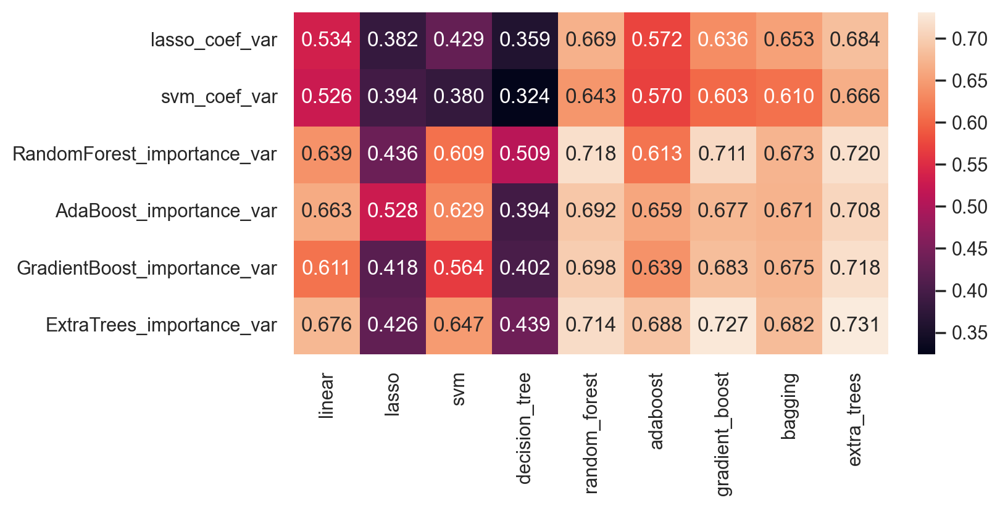

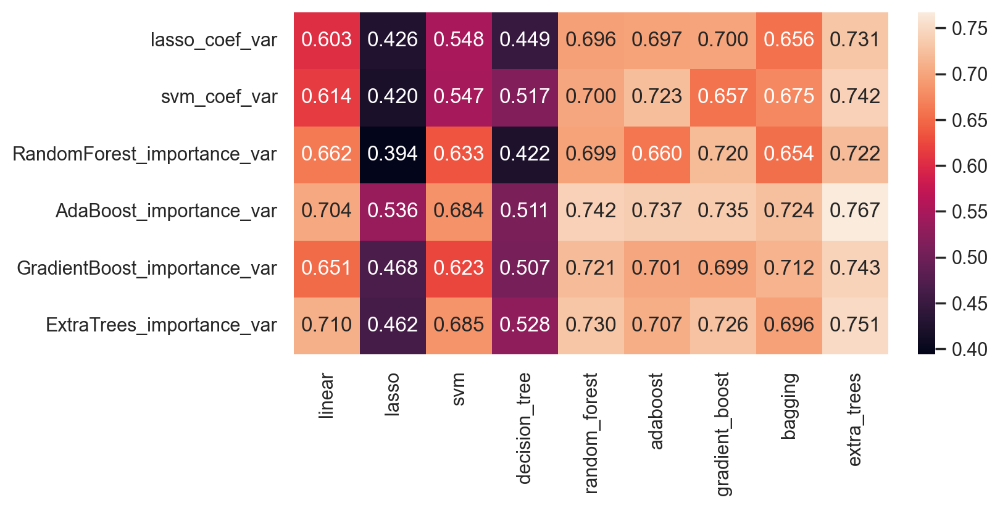

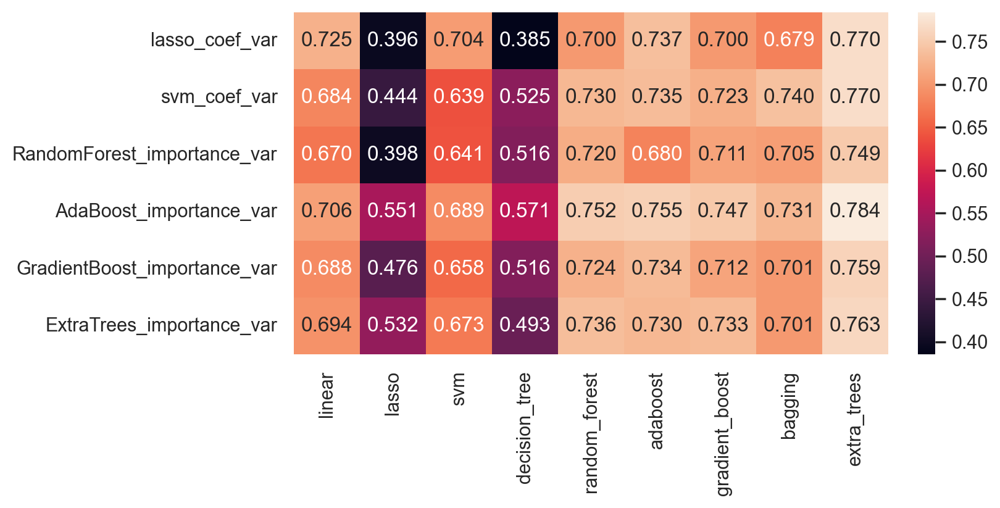

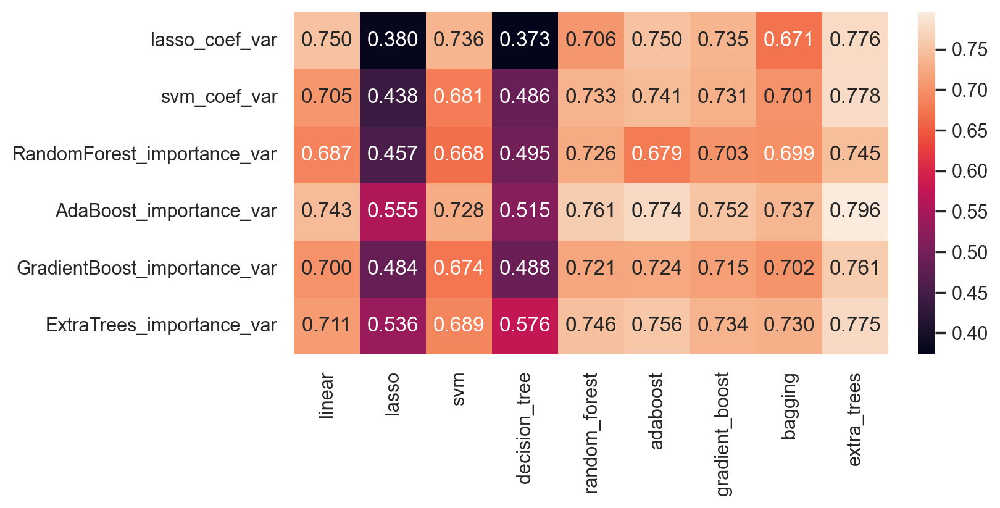

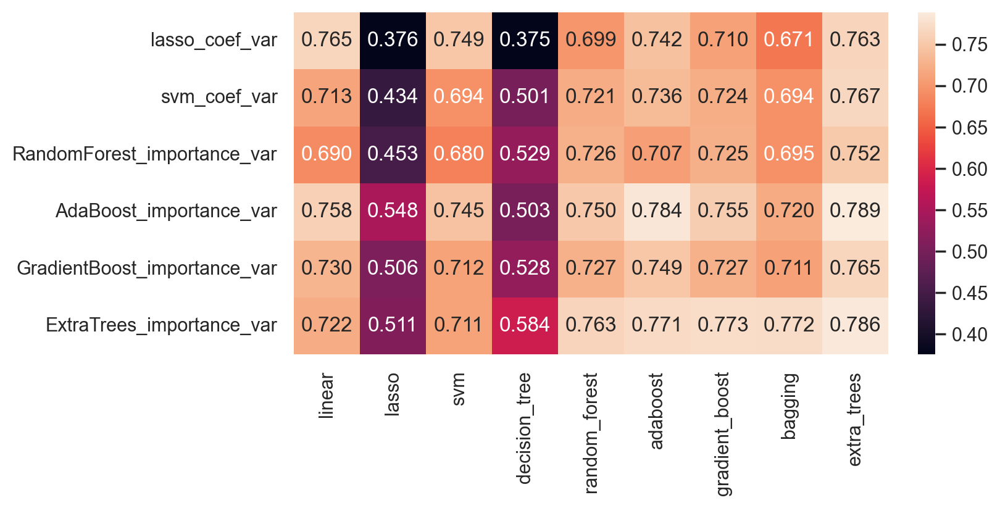

In [907]:
from sklearn.model_selection import cross_validate
# nums = [10,20,30,40,50,100,150,200,300]
nums = [10,20,30,40,50]
for num in nums:
    scoreTable = pd.DataFrame(index=["linear","lasso","svm","decision_tree","random_forest","adaboost","gradient_boost","bagging","extra_trees"])
    models = [model_linear_regressor,model_lasso_regressor,model_svm_regressor,model_decision_tree_regressor,model_random_forest_regressor,model_adaboost_regressor,model_gradient_boosting_regressor,model_bagging_regressor,model_extraTrees_regressor]
    for indicator in selection.columns:
        print(indicator)
        genes = list(selection.sort_values(by=indicator,ascending=False).index[:num])
        score_erro = []
        score_var = []
        fit_time = []
        score_time = []
        for model in models:
            print(model)
            X_train_scale = zcoreScaler(X_train[genes])
            scores = cross_validate(model, X_train_scale, y_train, cv=5, scoring=('explained_variance','neg_mean_squared_error'),return_train_score=False)
            score_erro.append(scores["test_neg_mean_squared_error"].mean())
            score_var.append(scores["test_explained_variance"].mean())
            fit_time.append(scores["fit_time"].mean())
            score_time.append(scores["score_time"].mean())
        scoreTable[indicator+"_erro"] = score_erro
        scoreTable[indicator+"_var"] = score_var
        scoreTable[indicator+"_fit_time"] = fit_time
        scoreTable[indicator+"_score_time"] = score_time
        display(scoreTable)
    
    scoreTable.to_csv("./result/model_compare/score_table_"+str(num)+".csv")

    fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(8, 4),dpi=200)

    rc = {'font.sans-serif': ['Times New Roman'],
          'axes.unicode_minus': False}
    sns.set(context='notebook', style='ticks', rc=rc)
    sns.set_theme(style="white")

    xlabel = []
    for x in scoreTable.columns:
        if "_var" in x:
            xlabel.append(x)
    sub = sns.heatmap(scoreTable[xlabel].T, annot=True, fmt=".3f")
    fig.savefig("./result/model_compare/score_heatmap_"+str(num)+".svg")

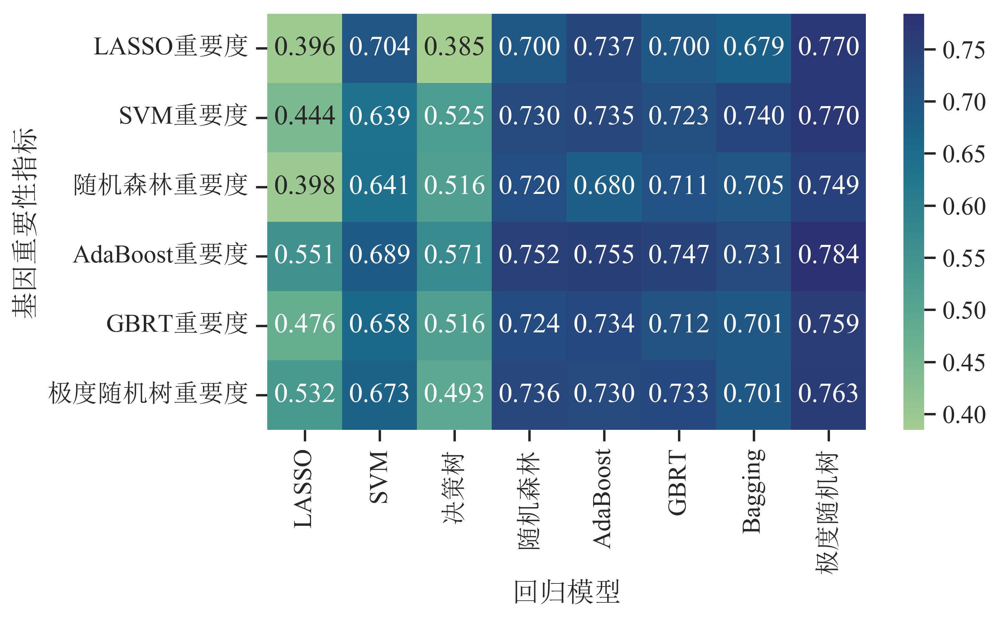

In [1664]:
scoreTable = pd.read_csv("./result/model_compare/score_table_30.csv",index_col=0)

plt.rcParams['font.sans-serif'] = ['SongTimes']  ##设置字体
plt.figure(figsize=(7, 4),dpi=400)  # 画布

# rc = {'font.sans-serif': ['SongTimes'],
#       'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
# sns.set_theme(style="white")

xlabel = []
for x in scoreTable.columns:
    if "_var" in x:
        if "rank" in x:
            continue
        xlabel.append(x)
data = scoreTable[xlabel].T.iloc[:,1:]

sub = sns.heatmap(data, annot=True, fmt=".3f"
                  ,xticklabels=["LASSO","SVM","决策树","随机森林","AdaBoost","GBRT","Bagging","极度随机树"]
                 ,yticklabels=["LASSO重要度","SVM重要度","随机森林重要度","AdaBoost重要度","GBRT重要度","极度随机树重要度"]
                 ,cmap="crest")


sub.set_xlabel("回归模型")
sub.set_ylabel("基因重要性指标")
plt.savefig("./result/model_compare/score_heatmap_30_final.svg", bbox_inches='tight')

In [ ]:
# gene select
# 基因交集比较

In [1598]:
sort_table =pd.read_csv("./result/gene_sort/sort_table.csv",index_col=0)
selection = sort_table

In [1599]:
selection.columns=["LASSO重要度","SVM重要度","随机森林重要度","AdaBoost重要度","GBRT重要度","极度随机树重要度"]

In [1600]:
gene_set = {}
genes = []
for indicator in selection.columns:
    gene_set[indicator] =list(selection.sort_values(by=indicator,ascending=False).index[:40])
    genes.append(list(selection.sort_values(by=indicator,ascending=False).index[:40]))

<Figure size 3000x6000 with 0 Axes>

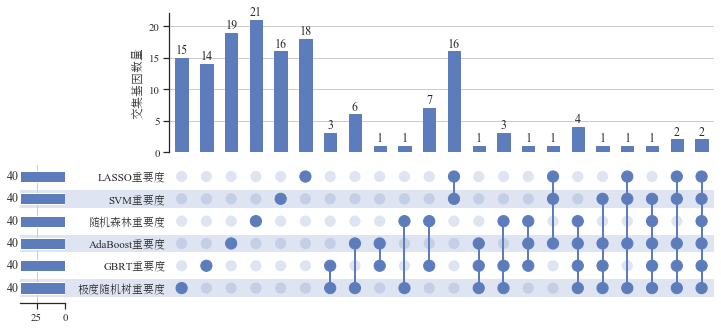

In [1601]:
from upsetplot import from_contents,UpSet
plt.figure(dpi=300,figsize=(10, 20))
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}

sub = UpSet(from_contents(gene_set), show_counts=True,min_subset_size=1, facecolor="#5c7cbc",other_dots_color=0.2,shading_color=0.2).plot()
sub['intersections'].set_ylabel("交集基因数量")
plt.savefig("./result/gene_select/upset_genes_40_subset1.svg", bbox_inches='tight')

<Figure size 2100x4200 with 0 Axes>

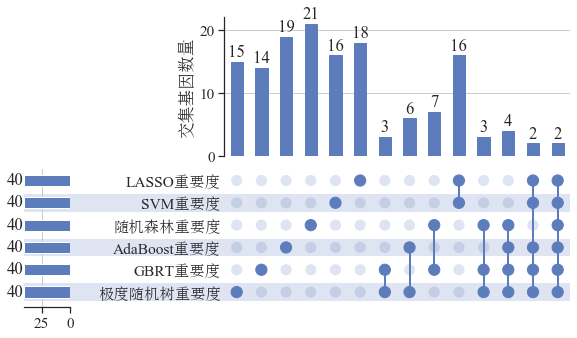

In [1661]:
plt.figure(dpi=300,figsize=(7, 14))
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(style='ticks', rc=rc, font_scale=1.4)

sub = UpSet(from_contents(gene_set), show_counts=True,min_subset_size=2, facecolor="#5c7cbc",other_dots_color=0.2,shading_color=0.2).plot()
sub['intersections'].set_ylabel("交集基因数量")
plt.savefig("./result/gene_select/upset_genes_40_subset2.svg", bbox_inches='tight')

In [849]:
# 选基因

In [1553]:
sort_table =pd.read_csv("./result/gene_sort/sort_table.csv",index_col=0)
selection = sort_table
geneDict = dict.fromkeys(selection.index,0)
for indicator in selection.columns:
    print(indicator)
    genes = list(selection.sort_values(by=indicator,ascending=False).index[:40])
    for gene in genes:
        geneDict[gene] += 1
gengImp = pd.DataFrame(geneDict,index=["importance"]).T
gengImp = gengImp.sort_values(by="importance",ascending=False)
gene_union = list(gengImp[gengImp.importance >= 1].index)

lasso_coef
svm_coef
RandomForest_importance
AdaBoost_importance
GradientBoost_importance
ExtraTrees_importance


In [975]:
selection.loc[["MSH6", "TCF7L1", "MSH2", "TCF7", "MLH1"],:]

,LASSO重要度,SVM重要度,随机森林重要度,AdaBoost重要度,GBRT重要度,极度随机树重要度
MSH6,0.088302,0.133550,1.578596e-03,0.000000,0.002604,0.000685
TCF7L1,0.000000,0.060928,3.965699e-04,0.000000,0.000000,0.000189
MSH2,0.000000,0.037621,7.490486e-11,0.000458,0.011627,0.002675
TCF7,0.596345,0.267723,2.678023e-04,0.000684,0.000060,0.000210
MLH1,4.092147,0.795361,6.354643e-01,0.150557,0.580944,0.320489


In [11]:
gengImp = pd.DataFrame(geneDict,index=["importance"]).T
gengImp = gengImp.sort_values(by="importance",ascending=False)

In [1555]:
gengImp

,importance
RPL22L1,6
MLH1,6
OXCT1,5
WDTC1,5
LYG1,5
...,...
MFSD5,0
MVD,0
NAALADL2,0
SLC7A4,0


In [1554]:
print(len(gengImp[gengImp.importance >= 1]))
for gene in gengImp[gengImp.importance >= 1].index:
    print(gene)

154
RPL22L1
MLH1
OXCT1
WDTC1
LYG1
SNAPC2
EPM2AIP1
MSH4
KCNRG
WDR76
GINS2
PRPS1
HSPH1
KIF13A
TRIM7
SFXN1
GLYR1
IFNG
HES6
MSH6
SLC35F5
GLOD4
CAB39L
INTS10
CDCA8
MRPL2
TCF7
ZADH2
GTF2A2
FECH
SRMS
DEFA3
MAPRE3
C1orf87
COL9A1
ASPH
MSH2
FNBP1
CXCL9
B3GNT5
TTC29
DDX27
TEKT1
SEC31A
COL18A1
SMAP1
NXPE4
SLC13A2
ELAC1
SEC63
TTC37
SHMT2
MAP3K8
POU6F1
PRRC1
MAGEA1
SRR
PIGZ
ARMCX2
TMEM150C
MBP
HUNK
JSRP1
FBXO39
PIWIL1
SNRNP48
TTC30A
TESC
HENMT1
FUT10
MTHFD1
MT4
NXF3
ENG
ANTXR1
SLC26A9
POLDIP3
SNAP25
PLEKHH2
DKK1
NT5C3B
NDUFAF1
MSX1
SPAG6
MKRN2
FMO2
SLC18A2
LRR1
TRIM36
NUDT16
POLR2A
JAK1
C19orf54
NOTUM
NXPE1
C2CD4B
VDAC3
HSPA2
GPHN
PLA2G3
ANKRD65
COX16
CCDC22
RGL3
ANXA13
MTNR1A
IGFBP5
PNP
FBXL16
ADNP2
GFRA3
C1orf174
VPS4A
FIBCD1
C6orf132
NPFFR1
TOP3A
DNM3
MYO10
MLEC
NDEL1
KRTAP5-9
NXNL2
LSM11
PRTFDC1
PRR11
TTC19
ASMTL
GLB1L2
DPH1
ZMYND8
GATM
DDAH1
GDA
LIAS
PLAGL2
HMGN4
PMEPA1
NECAP1
HPSE
TXNDC9
ZBBX
SLC7A2
VWA5A
TSR1
TMEM159
TPMT
PIAS2
RNLS
RBBP4
BEX4
NMU
CA2
ABCF1


In [13]:
for name in gengImp.head(20).index:
    print(name)

RPL22L1
MLH1
OXCT1
WDTC1
LYG1
SNAPC2
EPM2AIP1
MSH4
KCNRG
WDR76
GINS2
PRPS1
HSPH1
KIF13A
TRIM7
SFXN1
GLYR1
IFNG
HES6
MSH6


In [20]:
len(gene_union)

154

In [ ]:
# 第一次筛选得到gene_union

In [116]:
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))
# RANDOM_STATE = 42
RANDOM_STATE = 0
features = TCGA[genes].applymap(lambda x:np.log2(x+1))
# target = TCGA["msi"]
target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)

CPTAC = CPTAC.applymap(lambda x:np.log2(x+1)if type(x)==float else x)

ICGC = ICGC.applymap(lambda x:np.log2(x+1)if type(x)==float else x)

In [ ]:
genes = gene_union

In [117]:
_, _, _, y_true = train_test_split(features, pd.get_dummies(TCGA.msi)["MSI-H"], test_size=0.30, random_state=RANDOM_STATE)

In [934]:
from sklearn import ensemble
model_extraTrees_regressor = ensemble.ExtraTreesRegressor(random_state=6)

In [1016]:
gene_num_prediction = pd.DataFrame(index=["genes","var","err","auc","CPTACauc","ICGCauc"])
print(len(genes))
res = []


model = model_extraTrees_regressor
X_train_scale = zcoreScaler(X_train[genes])
model.fit(X_train_scale, y_train)

gene_dict = dict(zip(model.feature_names_in_,model.feature_importances_))
res.append(sorted(gene_dict.items(),key=lambda x : x[1])[0][0])

X_test_scale = zcoreScaler(X_test[genes])
y_pre = model.predict(X_test_scale)


res.append(explained_variance_score(y_test,y_pre))
res.append(mean_squared_error(y_test,y_pre))
res.append(roc_auc_score(y_true,y_pre))

CPTAC_scale = zcoreScaler(CPTAC[genes])
y_pre = model.predict(CPTAC_scale)
res.append(roc_auc_score(pd.get_dummies(CPTAC.iloc[:,0])["MSI-H"],y_pre))   

ICGC_scale = zcoreScaler(ICGC[genes])
y_pre = model.predict(ICGC_scale)
res.append(roc_auc_score(pd.get_dummies(ICGC.iloc[:,0])["MSI-H"],y_pre))



gene_num_prediction[len(genes)] = res
display(gene_num_prediction)

154


,154
genes,TEKT1
var,0.754135
err,16.6165
auc,0.987971
CPTACauc,0.997942
ICGCauc,0.999632


In [1017]:
gene_sort = []
while(len(genes) >1):
    
    gene_dict = dict(zip(model.feature_names_in_,model.feature_importances_))
    gene_sort.append(sorted(gene_dict.items(),key=lambda x : x[1])[0][0])
    print(gene_sort)
    genes = list(dict(sorted(gene_dict.items(),key=lambda x : x[1])[1:]).keys())
    
    model = model_extraTrees_regressor
    X_train_scale = zcoreScaler(X_train[genes])
    model.fit(X_train_scale, y_train)
    
    
    print(len(genes))
    res = []
#     res.append(list(genes))
    res.append(sorted(gene_dict.items(),key=lambda x : x[1])[0][0])

    X_test_scale = zcoreScaler(X_test[genes])
    y_pre = model.predict(X_test_scale)


    res.append(explained_variance_score(y_test,y_pre))
    res.append(mean_squared_error(y_test,y_pre))
    res.append(roc_auc_score(y_true,y_pre))

    CPTAC_scale = zcoreScaler(CPTAC[genes])
    y_pre = model.predict(CPTAC_scale)
    res.append(roc_auc_score(pd.get_dummies(CPTAC.iloc[:,0])["MSI-H"],y_pre))   

    ICGC_scale = zcoreScaler(ICGC[genes])
    y_pre = model.predict(ICGC_scale)
    res.append(roc_auc_score(pd.get_dummies(ICGC.iloc[:,0])["MSI-H"],y_pre))



    gene_num_prediction[len(genes)] = res
#     display(gene_num_prediction)

['TEKT1']
153
['TEKT1', 'NXPE4']
152
['TEKT1', 'NXPE4', 'TPMT']
151
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX']
150
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU']
149
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5']
148
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6']
147
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3']
146
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2']
145
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9']
144
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2']
143
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A']
142
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2']
141
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3']
1

112
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A']
111
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25']
110
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', '

94
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1']
93
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf1

80
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2']
79
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HE

68
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1']
67
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DE

58
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2']
57
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2',

49
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2']
48
['TEKT1', 'NXPE

40
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2', 'KIF13A', 'MBP', '

32
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2', 'KIF13A', 'MBP', '

24
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2', 'KIF13A', 'MBP', '

17
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2', 'KIF13A', 'MBP', '

10
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2', 'KIF13A', 'MBP', '

3
['TEKT1', 'NXPE4', 'TPMT', 'ZBBX', 'NMU', 'IGFBP5', 'SPAG6', 'GFRA3', 'NXNL2', 'KRTAP5-9', 'GLB1L2', 'VWA5A', 'SLC13A2', 'DNM3', 'PNP', 'HSPA2', 'TESC', 'HMGN4', 'ANXA13', 'TMEM159', 'LIAS', 'DEFA3', 'COX16', 'RBBP4', 'FIBCD1', 'MT4', 'C1orf174', 'GATM', 'RGL3', 'POLDIP3', 'COL9A1', 'LRR1', 'PRR11', 'HES6', 'NDUFAF1', 'NUDT16', 'VDAC3', 'POU6F1', 'CA2', 'PLEKHH2', 'NOTUM', 'MSX1', 'VPS4A', 'SNAP25', 'FNBP1', 'MLEC', 'BEX4', 'C6orf132', 'NPFFR1', 'PMEPA1', 'PIAS2', 'TSR1', 'FBXL16', 'TTC29', 'NXPE1', 'MTHFD1', 'NT5C3B', 'DPH1', 'PRPS1', 'LSM11', 'DKK1', 'MKRN2', 'NDEL1', 'PLA2G3', 'ASMTL', 'CDCA8', 'SLC35F5', 'ANTXR1', 'SLC26A9', 'DDAH1', 'TOP3A', 'FMO2', 'ASPH', 'MRPL2', 'SLC7A2', 'TCF7', 'KCNRG', 'SHMT2', 'SRR', 'NXF3', 'TMEM150C', 'MAP3K8', 'HUNK', 'MAGEA1', 'TRIM36', 'ARMCX2', 'ELAC1', 'MYO10', 'MTNR1A', 'TTC30A', 'GTF2A2', 'MSH6', 'SRMS', 'PIGZ', 'C19orf54', 'MAPRE3', 'ZADH2', 'SNAPC2', 'PRRC1', 'ANKRD65', 'C2CD4B', 'CCDC22', 'FUT10', 'FBXO39', 'IFNG', 'MSH2', 'KIF13A', 'MBP', 'G

In [1018]:
gene_sort.reverse()

In [1556]:
genes

['MLH1',
 'EPM2AIP1',
 'MSH4',
 'RPL22L1',
 'HSPH1',
 'TRIM7',
 'PRTFDC1',
 'SMAP1',
 'DDX27',
 'CXCL9',
 'WDTC1',
 'FECH',
 'SFXN1',
 'COL18A1']

In [1019]:
gene_num_prediction = gene_num_prediction.T

gene_num_prediction.insert(loc=0,column="num",value=gene_num_prediction.index)

gene_num_prediction = gene_num_prediction.reset_index().drop(columns="index")

gene_num_prediction.to_csv("./result/gene_select/gene_union_num.csv")

In [25]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)

In [1000]:
gene_num_prediction.sort_values(by="num").head(14)

,num,genes,var,err,auc,CPTACauc,ICGCauc
153,1,MLH1,0,67.364,0.5,0.5,0.5
152,2,EPM2AIP1,0.470129,35.803,0.859735,0.8125,0.856853
151,3,MSH4,0.274901,48.9134,0.890167,0.821502,0.887436
150,4,RPL22L1,0.485141,34.7164,0.910783,0.889918,0.91157
149,5,HSPH1,0.605875,26.6174,0.951524,0.956276,0.946205
148,6,TRIM7,0.656311,23.1827,0.968633,0.983539,0.960206
147,7,PRTFDC1,0.648799,23.6627,0.964635,0.98251,0.981209
146,8,SMAP1,0.693312,20.6597,0.97804,0.984053,0.993736
145,9,DDX27,0.690502,20.8443,0.98371,0.998971,0.998526
144,10,CXCL9,0.705548,19.8315,0.983874,0.998971,0.997052


In [1023]:
gene_num_prediction.sort_values(by="var",ascending=False)

,num,genes,var,err,auc,CPTACauc,ICGCauc
140,14,COL18A1,0.766358,15.7671,0.992625,0.996399,0.999632
136,18,SLC18A2,0.764873,15.8717,0.993346,0.993827,1
123,31,HPSE,0.764865,15.9111,0.991872,0.994342,0.999263
137,17,SNRNP48,0.763958,15.9213,0.991282,0.99537,1
62,92,MKRN2,0.762982,16.0362,0.991118,0.998457,1
...,...,...,...,...,...,...,...
149,5,HSPH1,0.605875,26.6174,0.951524,0.956276,0.946205
150,4,RPL22L1,0.485141,34.7164,0.910783,0.889918,0.91157
152,2,EPM2AIP1,0.470129,35.803,0.859735,0.8125,0.856853
151,3,MSH4,0.274901,48.9134,0.890167,0.821502,0.887436


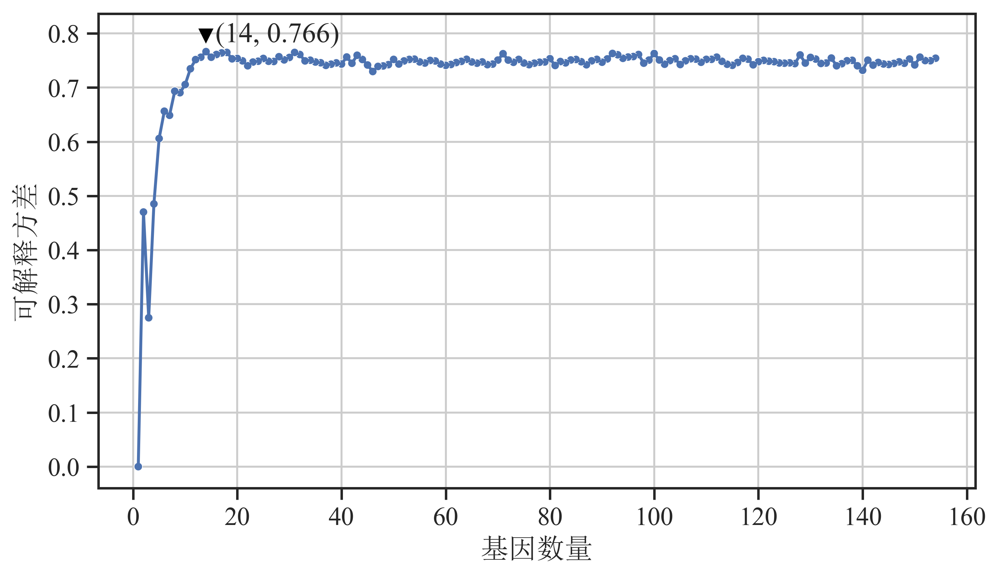

In [1659]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)

fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7, 4),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(style='ticks', rc=rc, font_scale=1.2)
# sns.set_theme(style="white")

sub = sns.lineplot(
    data=gene_num_prediction,
    x="num", y="var", markers=True,palette="muted"
)

sub = sns.scatterplot(data=gene_num_prediction, x="num", y="var",size=2,legend=False,palette="muted")

maxDf = gene_num_prediction[gene_num_prediction["num"] == 14]
sub.set_ylabel("可解释方差")
sub.set_xlabel("基因数量")

plt.grid()
plt.plot(maxDf["num"],maxDf["var"]+0.03, marker="v", label="points",c='black')
plt.annotate('(14, 0.766)',xy=(maxDf["num"]+1.8,maxDf["var"]+0.018))
fig.savefig("./result/gene_select/gene_num_sort.svg",bbox_inches='tight')

Text(0.5, 0, '基因数量')

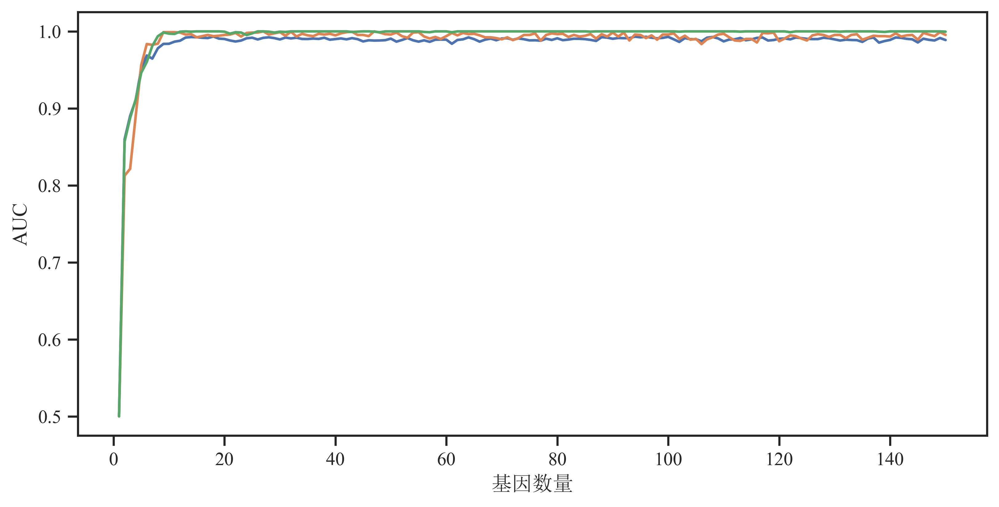

In [1025]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)

fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(8, 4),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(style='ticks', rc=rc)
# sns.set_theme(style="white")

sub = sns.lineplot(
    data=gene_num_prediction.iloc[-150:],
    x="num", y="auc", markers=True,palette="muted"
)
sub = sns.lineplot(
    data=gene_num_prediction.iloc[-150:],
    x="num", y="CPTACauc", markers=True,palette="muted"
)
sub = sns.lineplot(
    data=gene_num_prediction.iloc[-150:],
    x="num", y="ICGCauc", markers=True,palette="muted"
)

# sub = sns.scatterplot(data=gene_num_prediction.iloc[-150:], x="num", y="var",size=2,legend=False,palette="muted")

# maxDf = gene_num_prediction[gene_num_prediction["num"] == 14]
sub.set_ylabel("AUC")
sub.set_xlabel("基因数量")

# plt.grid()
# plt.plot(maxDf["num"],maxDf["var"]+0.03, marker="v", label="points",c='black')
# plt.annotate('(14, 0.766)',xy=(maxDf["num"]+1.8,maxDf["var"]+0.018))
# fig.savefig("./result/gene_select/gene_num_sort.svg",bbox_inches='tight')

In [ ]:
MSH6, TCF7L1, MSH2, TCF7, MLH1

In [1026]:
for name in gene_num_prediction.sort_values(by="num").genes:
    print(name)

MLH1
EPM2AIP1
MSH4
RPL22L1
HSPH1
TRIM7
PRTFDC1
SMAP1
DDX27
CXCL9
WDTC1
FECH
SFXN1
COL18A1
ZMYND8
GLOD4
SNRNP48
SLC18A2
HENMT1
RNLS
TXNDC9
ADNP2
WDR76
TTC37
GINS2
OXCT1
NECAP1
JAK1
CAB39L
POLR2A
HPSE
ENG
GLYR1
C1orf87
JSRP1
INTS10
B3GNT5
SEC63
GPHN
PLAGL2
ABCF1
TTC19
SEC31A
PIWIL1
GDA
MBP
KIF13A
MSH2
IFNG
FBXO39
FUT10
CCDC22
C2CD4B
ANKRD65
PRRC1
SNAPC2
ZADH2
MAPRE3
C19orf54
PIGZ
SRMS
MSH6
GTF2A2
TTC30A
MTNR1A
MYO10
ELAC1
ARMCX2
TRIM36
MAGEA1
HUNK
MAP3K8
TMEM150C
NXF3
SRR
SHMT2
KCNRG
TCF7
SLC7A2
MRPL2
ASPH
FMO2
TOP3A
DDAH1
SLC26A9
ANTXR1
SLC35F5
CDCA8
ASMTL
PLA2G3
NDEL1
MKRN2
DKK1
LSM11
PRPS1
DPH1
NT5C3B
MTHFD1
NXPE1
TTC29
FBXL16
TSR1
PIAS2
PMEPA1
NPFFR1
C6orf132
BEX4
MLEC
FNBP1
SNAP25
VPS4A
MSX1
NOTUM
PLEKHH2
CA2
POU6F1
VDAC3
NUDT16
NDUFAF1
HES6
PRR11
LRR1
COL9A1
POLDIP3
RGL3
GATM
C1orf174
MT4
FIBCD1
RBBP4
COX16
DEFA3
LIAS
TMEM159
ANXA13
HMGN4
TESC
HSPA2
PNP
DNM3
SLC13A2
VWA5A
GLB1L2
KRTAP5-9
NXNL2
GFRA3
SPAG6
IGFBP5
NMU
ZBBX
TPMT
NXPE4
TEKT1
TEKT1


In [26]:
set.intersection(set(["DDX27", "EPM2AIP1", "HENMT1", "LYG1", "MLH1", "MSH4","NHLRC1", "NOL4L", "RNLS", "RPL22L1", "RTF2", "SHROOM4", "SMAP1", "TTC30A", "ZSWIM3"]),set(gene_num_prediction.sort_values(by="num").head(14).genes))

{'DDX27', 'EPM2AIP1', 'MLH1', 'MSH4', 'RPL22L1', 'SMAP1'}

<Figure size 3000x6000 with 0 Axes>

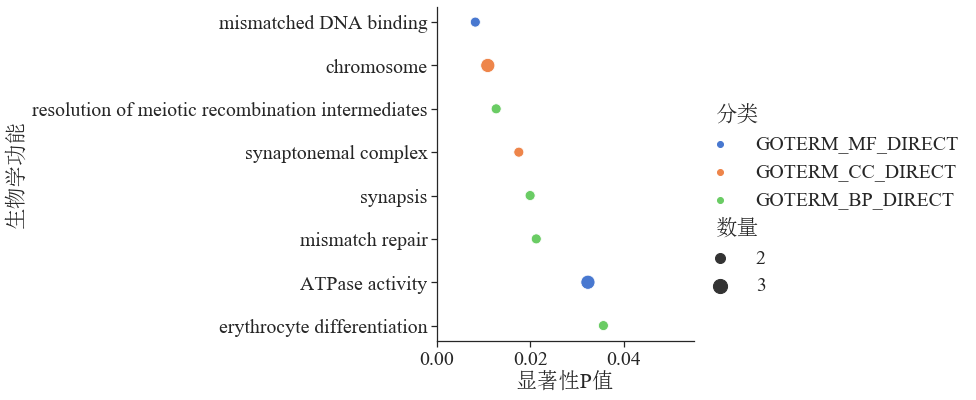

In [1644]:
GoAnalysis = pd.read_csv("./result/gene_select/GO_gene14.txt",sep="\t")

term = []
for item in GoAnalysis["Term"]:
    if "~" in item:
        term.append(item.split("~")[1])
    else:
        term.append(item.split(":")[1])

GoAnalysis["term_info"] = term

GoAnalysis = GoAnalysis.rename(columns={"Category":"分类","Count":"数量"})

# fig, ax =plt.subplots(figsize=(10, 20),dpi=100)

plt.figure(dpi=300,figsize=(10, 20))
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.8)

sub = sns.relplot(x="PValue", y="term_info", size="数量", data=GoAnalysis[GoAnalysis["PValue"]<= 0.05],hue="分类",height=6,aspect=2,sizes=(100, 200),palette="muted")
sub.set(ylabel="生物学功能",xlabel="显著性P值",xlim=(0,0.055))
plt.savefig("./result/gene_select/GO_gene14.svg", bbox_inches='tight')

<Figure size 3000x6000 with 0 Axes>

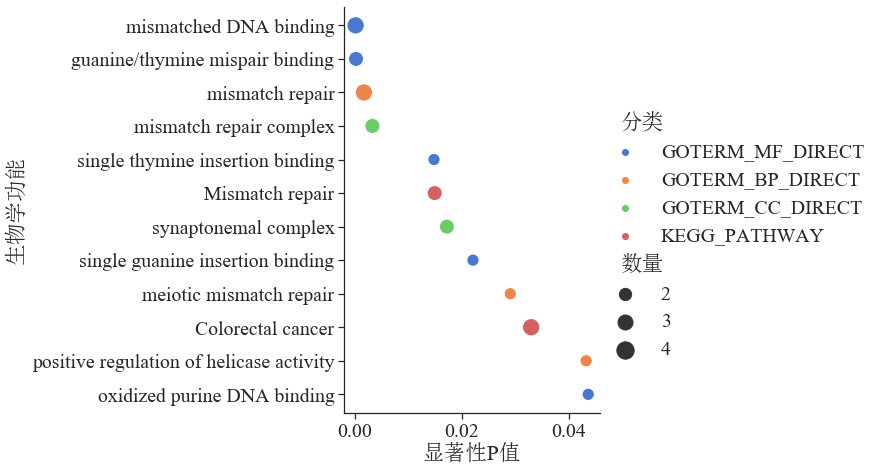

In [1649]:
GoAnalysis = pd.read_csv("./result/gene_select/GO_gene154.txt",sep="\t")

term = []
for item in GoAnalysis["Term"]:
    if "~" in item:
        term.append(item.split("~")[1])
    else:
        term.append(item.split(":")[1])

GoAnalysis["term_info"] = term

GoAnalysis = GoAnalysis.rename(columns={"Category":"分类","Count":"数量"})

# fig, ax =plt.subplots(figsize=(10, 20),dpi=100)

plt.figure(dpi=300,figsize=(10, 20))
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.8)
sub = sns.relplot(x="PValue", y="term_info", size="数量", data=GoAnalysis[GoAnalysis["PValue"]<= 0.05],hue="分类",height=7,aspect=1.5,sizes=(150, 300),palette="muted")
sub.set(ylabel="生物学功能",xlabel="显著性P值")
plt.savefig("./result/gene_select/GO_gene154.svg", bbox_inches='tight')

In [1684]:
# 基因交集

In [423]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
gene_sort = gene_sort[:-1]
genes = gene_sort[:14]

In [443]:
genes

['MLH1',
 'EPM2AIP1',
 'MSH4',
 'RPL22L1',
 'HSPH1',
 'TRIM7',
 'PRTFDC1',
 'SMAP1',
 'DDX27',
 'CXCL9',
 'WDTC1',
 'FECH',
 'SFXN1',
 'COL18A1']

In [441]:
pd.DataFrame(ICGC.iloc[0,:]).T.to_csv("./test_mss.csv")

In [442]:
pd.DataFrame(ICGC.iloc[-3,:]).T.to_csv("./test_msi.csv")

In [427]:
import joblib

In [428]:
joblib.dump(model, 'bulk.m')

['bulk.m']

In [1692]:
preMSIm = ["DDX27", "EPM2AIP1", "HENMT1", "LYG1", "MLH1","MSH4", "NHLRC1", "NOL4L", "RNLS", "RPL22L1", "RTF2", "SHROOM4", "SMAP1", "TTC30A", "ZSWIM3"]

In [1693]:
genes_Anna = ["TNNT1", "VNN2", "TRIM7", "TNFSF9", "AGR2",
              "RPL22L1", "GNG4", "KRT23", "ACSL6", "TNNC2",
              "SHROOM2", "EPDR1", "ARID3A", "KHDRBS3", "GGT7",
              "SHROOM4", "MLH1", "NKD1", "TFCP2L1", "VAV3",
              "RUBCNL", "ASCL2", "AXIN2", "PLAGL2", "PRR15"]

In [1694]:
genes_Patrick = ["MLH1", "MSH2", "MSH6", "PMS2",
                 "EPM2AIP1", "TTC30A", "SMAP1", "RNLS", "WNT11", "SFXN1", "SREBF1", "TYMS", "EIF5AL1", "WDR76"]

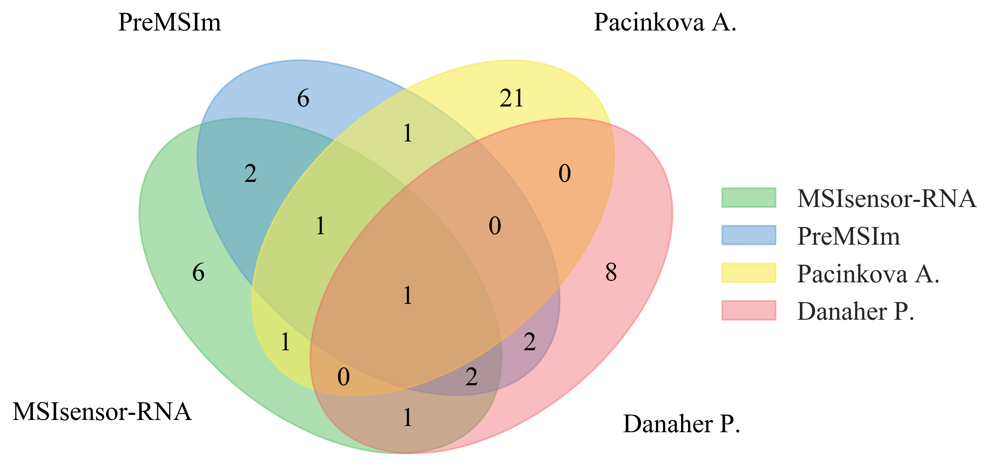

In [1709]:
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.6)
labels = get_labels([genes, preMSIm, genes_Anna, genes_Patrick], fill=['number'])
fig = venn4(labels=labels, names=['MSIsensor-RNA', 'PreMSIm', 'Pacinkova A.', 'Danaher P.'])
plt.savefig("./result/gene_select/intersection_compare.svg", bbox_inches='tight')

In [1708]:
from itertools import chain
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import colors
import math

default_colors = [
    # r, g, b, a
    [92, 192, 98, 0.5],
    [90, 155, 212, 0.5],
    [246, 236, 86, 0.6],
    [241, 90, 96, 0.4],
    [255, 117, 0, 0.3],
    [82, 82, 190, 0.2],
]
default_colors = [
    [i[0] / 255.0, i[1] / 255.0, i[2] / 255.0, i[3]]
    for i in default_colors
]

def draw_ellipse(fig, ax, x, y, w, h, a, fillcolor):
    e = patches.Ellipse(
        xy=(x, y),
        width=w,
        height=h,
        angle=a,
        color=fillcolor)
    ax.add_patch(e)

def draw_triangle(fig, ax, x1, y1, x2, y2, x3, y3, fillcolor):
    xy = [
        (x1, y1),
        (x2, y2),
        (x3, y3),
    ]
    polygon = patches.Polygon(
        xy=xy,
        closed=True,
        color=fillcolor)
    ax.add_patch(polygon)

def draw_text(fig, ax, x, y, text, color=[0, 0, 0, 1], fontsize=14, ha="center", va="center"):
    ax.text(
        x, y, text,
        horizontalalignment=ha,
        verticalalignment=va,
        fontsize=fontsize,
        color="black")

def draw_annotate(fig, ax, x, y, textx, texty, text, color=[0, 0, 0, 1], arrowcolor=[0, 0, 0, 0.3]):
    plt.annotate(
        text,
        xy=(x, y),
        xytext=(textx, texty),
        arrowprops=dict(color=arrowcolor, shrink=0, width=0.5, headwidth=8),
        fontsize=14,
        color=color,
        xycoords="data",
        textcoords="data",
        horizontalalignment='center',
        verticalalignment='center'
    )

def get_labels(data, fill=["number"]):
    """
    get a dict of labels for groups in data
    @type data: list[Iterable]
    @rtype: dict[str, str]
    input
      data: data to get label for
      fill: ["number"|"logic"|"percent"]
    return
      labels: a dict of labels for different sets
    example:
    In [12]: get_labels([range(10), range(5,15), range(3,8)], fill=["number"])
    Out[12]:
    {'001': '0',
     '010': '5',
     '011': '0',
     '100': '3',
     '101': '2',
     '110': '2',
     '111': '3'}
    """

    N = len(data)

    sets_data = [set(data[i]) for i in range(N)]  # sets for separate groups
    s_all = set(chain(*data))                     # union of all sets

    # bin(3) --> '0b11', so bin(3).split('0b')[-1] will remove "0b"
    set_collections = {}
    for n in range(1, 2**N):
        key = bin(n).split('0b')[-1].zfill(N)
        value = s_all
        sets_for_intersection = [sets_data[i] for i in range(N) if  key[i] == '1']
        sets_for_difference = [sets_data[i] for i in range(N) if  key[i] == '0']
        for s in sets_for_intersection:
            value = value & s
        for s in sets_for_difference:
            value = value - s
        set_collections[key] = value

    labels = {k: "" for k in set_collections}
    if "logic" in fill:
        for k in set_collections:
            labels[k] = k + ": "
    if "number" in fill:
        for k in set_collections:
            labels[k] += str(len(set_collections[k]))
    if "percent" in fill:
        data_size = len(s_all)
        for k in set_collections:
            labels[k] += "(%.1f%%)" % (100.0 * len(set_collections[k]) / data_size)

    return labels

def venn2(labels, names=['A', 'B'], **options):
    """
    plots a 2-set Venn diagram
    @type labels: dict[str, str]
    @type names: list[str]
    @rtype: (Figure, AxesSubplot)
    input
      labels: a label dict where keys are identified via binary codes ('01', '10', '11'),
              hence a valid set could look like: {'01': 'text 1', '10': 'text 2', '11': 'text 3'}.
              unmentioned codes are considered as ''.
      names:  group names
      more:   colors, figsize, dpi, fontsize
    return
      pyplot Figure and AxesSubplot object
    """
    colors = options.get('colors', [default_colors[i] for i in range(2)])
    figsize = options.get('figsize', (9, 7))
    dpi = options.get('dpi', 96)
    fontsize = options.get('fontsize', 14)

    fig = plt.figure(0, figsize=figsize, dpi=dpi)
    ax = fig.add_subplot(111, aspect='equal')
    ax.set_axis_off()
    ax.set_ylim(bottom=0.0, top=0.7)
    ax.set_xlim(left=0.0, right=1.0)

    # body
    draw_ellipse(fig, ax, 0.375, 0.3, 0.5, 0.5, 0.0, colors[0])
    draw_ellipse(fig, ax, 0.625, 0.3, 0.5, 0.5, 0.0, colors[1])
    draw_text(fig, ax, 0.74, 0.30, labels.get('01', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.26, 0.30, labels.get('10', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.50, 0.30, labels.get('11', ''), fontsize=fontsize)

    # legend
    draw_text(fig, ax, 0.20, 0.56, names[0], colors[0], fontsize=fontsize, ha="right", va="bottom")
    draw_text(fig, ax, 0.80, 0.56, names[1], colors[1], fontsize=fontsize, ha="left", va="bottom")
    leg = ax.legend(names, loc='center left', bbox_to_anchor=(1.0, 0.5), fancybox=True)
    leg.get_frame().set_alpha(0.5)

    return fig, ax

def venn3(labels, names=['A', 'B', 'C'], **options):
    """
    plots a 3-set Venn diagram
    @type labels: dict[str, str]
    @type names: list[str]
    @rtype: (Figure, AxesSubplot)
    input
      labels: a label dict where keys are identified via binary codes ('001', '010', '100', ...),
              hence a valid set could look like: {'001': 'text 1', '010': 'text 2', '100': 'text 3', ...}.
              unmentioned codes are considered as ''.
      names:  group names
      more:   colors, figsize, dpi, fontsize
    return
      pyplot Figure and AxesSubplot object
    """
    colors = options.get('colors', [default_colors[i] for i in range(3)])
    figsize = options.get('figsize', (9, 9))
    dpi = options.get('dpi', 96)
    fontsize = options.get('fontsize', 14)

    fig = plt.figure(0, figsize=figsize, dpi=dpi)
    ax = fig.add_subplot(111, aspect='equal')
    ax.set_axis_off()
    ax.set_ylim(bottom=0.0, top=1.0)
    ax.set_xlim(left=0.0, right=1.0)

    # body
    draw_ellipse(fig, ax, 0.333, 0.633, 0.5, 0.5, 0.0, colors[0])
    draw_ellipse(fig, ax, 0.666, 0.633, 0.5, 0.5, 0.0, colors[1])
    draw_ellipse(fig, ax, 0.500, 0.310, 0.5, 0.5, 0.0, colors[2])
    draw_text(fig, ax, 0.50, 0.27, labels.get('001', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.73, 0.65, labels.get('010', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.61, 0.46, labels.get('011', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.27, 0.65, labels.get('100', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.39, 0.46, labels.get('101', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.50, 0.65, labels.get('110', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.50, 0.51, labels.get('111', ''), fontsize=fontsize)

    # legend
    draw_text(fig, ax, 0.15, 0.87, names[0], colors[0], fontsize=fontsize, ha="right", va="bottom")
    draw_text(fig, ax, 0.85, 0.87, names[1], colors[1], fontsize=fontsize, ha="left", va="bottom")
    draw_text(fig, ax, 0.50, 0.02, names[2], colors[2], fontsize=fontsize, va="top")
    leg = ax.legend(names, loc='center left', bbox_to_anchor=(1.0, 0.5), fancybox=True)
    leg.get_frame().set_alpha(0.5)

    return fig, ax

def venn4(labels, names=['A', 'B', 'C', 'D'], **options):
    """
    plots a 4-set Venn diagram
    @type labels: dict[str, str]
    @type names: list[str]
    @rtype: (Figure, AxesSubplot)
    input
      labels: a label dict where keys are identified via binary codes ('0001', '0010', '0100', ...),
              hence a valid set could look like: {'0001': 'text 1', '0010': 'text 2', '0100': 'text 3', ...}.
              unmentioned codes are considered as ''.
      names:  group names
      more:   colors, figsize, dpi, fontsize
    return
      pyplot Figure and AxesSubplot object
    """
    colors = options.get('colors', [default_colors[i] for i in range(4)])
    figsize = options.get('figsize', (7, 4.5))
    dpi = options.get('dpi', 400)
    fontsize = options.get('fontsize', 16)

    fig = plt.figure(0, figsize=figsize, dpi=dpi)
    ax = fig.add_subplot(111, aspect='equal')
    ax.set_axis_off()
    ax.set_ylim(bottom=0.1, top=0.8)
    ax.set_xlim(left=0.0, right=1.0)

    # body
    draw_ellipse(fig, ax, 0.350, 0.400, 0.72, 0.45, 140.0, colors[0])
    draw_ellipse(fig, ax, 0.450, 0.500, 0.72, 0.45, 140.0, colors[1])
    draw_ellipse(fig, ax, 0.544, 0.500, 0.72, 0.45, 40.0, colors[2])
    draw_ellipse(fig, ax, 0.644, 0.400, 0.72, 0.45, 40.0, colors[3])
    draw_text(fig, ax, 0.85, 0.42, labels.get('0001', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.68, 0.72, labels.get('0010', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.77, 0.59, labels.get('0011', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.32, 0.72, labels.get('0100', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.71, 0.30, labels.get('0101', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.50, 0.66, labels.get('0110', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.65, 0.50, labels.get('0111', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.14, 0.42, labels.get('1000', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.50, 0.17, labels.get('1001', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.29, 0.30, labels.get('1010', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.39, 0.24, labels.get('1011', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.23, 0.59, labels.get('1100', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.61, 0.24, labels.get('1101', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.35, 0.50, labels.get('1110', ''), fontsize=fontsize)
    draw_text(fig, ax, 0.50, 0.38, labels.get('1111', ''), fontsize=fontsize)

    # legend
    draw_text(fig, ax, 0.13, 0.18, names[0], colors[0], fontsize=fontsize, ha="right")
    draw_text(fig, ax, 0.18, 0.83, names[1], colors[1], fontsize=fontsize, ha="right", va="bottom")
    draw_text(fig, ax, 0.82, 0.83, names[2], colors[2], fontsize=fontsize, ha="left", va="bottom")
    draw_text(fig, ax, 0.87, 0.18, names[3], colors[3], fontsize=fontsize, ha="left", va="top")
    leg = ax.legend(names, loc='center left', bbox_to_anchor=(1.0, 0.5), fancybox=True,frameon=False,fontsize=16)
    leg.get_frame().set_alpha(0.5)

    return fig, 

In [ ]:
# 网格化调参

In [28]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
gene_sort = gene_sort[:-1]
genes = gene_sort[:14]

In [1050]:
from sklearn.ensemble import ExtraTreesRegressor
grid_search = pd.DataFrame(index=["n","min_leaf","min_split","max_depth","max_features","var","err","auc","CPTACauc","ICGCauc"])
res = []

# parameters = {"n_estimators":[10,50,100,200],","min_samples_split":[1,2,3,4],"min_samples_leaf":[1,2,3]]}
n_estimators = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150,160,170,180,190,200]
min_samples_leaf = [1,2,3,4]
min_samples_split = [2,3,4]
max_depth = [15,20,25,30,None]
max_features = ["sqrt","log2", 1, 0.1,0.5,0.6,0.7,0.8,0.9]
r = [(a,b,c,d,e) for a in n_estimators for b in min_samples_leaf for c in min_samples_split for d in max_depth for e in max_features]
X_train_scale = zcoreScaler(X_train[genes])
X_test_scale = zcoreScaler(X_test[genes])
for i in range(len(r)):
    print(i)
    res = []
    paras = r[i]
    n = paras[0]
    min_leaf = paras[1]
    min_split = paras[2]
    max_d = paras[3]
    max_f = paras[4]
    res.append(n)
    res.append(min_leaf)
    res.append(min_split)
    res.append(max_d)
    res.append(max_f)
    model = ExtraTreesRegressor(n_estimators=n,min_samples_leaf=min_leaf,min_samples_split=min_split,max_depth=max_d,max_features=max_f,random_state=6)
    model.fit(X_train_scale,y_train)
    y_pre = model.predict(X_test_scale)


    res.append(explained_variance_score(y_test,y_pre))
    res.append(mean_squared_error(y_test,y_pre))
    res.append(roc_auc_score(y_true,y_pre))

    CPTAC_scale = zcoreScaler(CPTAC[genes])
    y_pre = model.predict(CPTAC_scale)
    res.append(roc_auc_score(pd.get_dummies(CPTAC.iloc[:,0])["MSI-H"],y_pre))   

    ICGC_scale = zcoreScaler(ICGC[genes])
    y_pre = model.predict(ICGC_scale)
    res.append(roc_auc_score(pd.get_dummies(ICGC.iloc[:,0])["MSI-H"],y_pre))
    grid_search["para"+str(i+1)] =  res
#     display(grid_search)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061


3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700


5140
5141
5142
5143
5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339


6779
6780
6781
6782
6783
6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978


8418
8419
8420
8421
8422
8423
8424
8425
8426
8427
8428
8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617


10048
10049
10050
10051
10052
10053
10054
10055
10056
10057
10058
10059
10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
1021

In [1615]:
grid_search[grid_search["var"] == max(grid_search["var"])]

,n,min_leaf,min_split,max_depth,max_features,var,err,auc,CPTACauc,ICGCauc
para3259,70,1,2,25,sqrt,0.772582,15.340345627412447,0.9879383808587349,0.9963991769547325,0.9992630803242447
para3260,70,1,2,25,log2,0.772582,15.340345627412447,0.9879383808587349,0.9963991769547325,0.9992630803242447


In [1608]:
grid_search  = grid_search.T

In [1614]:
grid_search["var"] =  np.float_(grid_search["var"])

In [240]:
grid_search = pd.read_csv("./result/grid_search/grid_search_reg.csv",index_col=0)

In [241]:
grid_search = grid_search[grid_search["min_leaf"] == 1]

In [242]:
grid_search = grid_search[grid_search["max_features"] == "sqrt"]

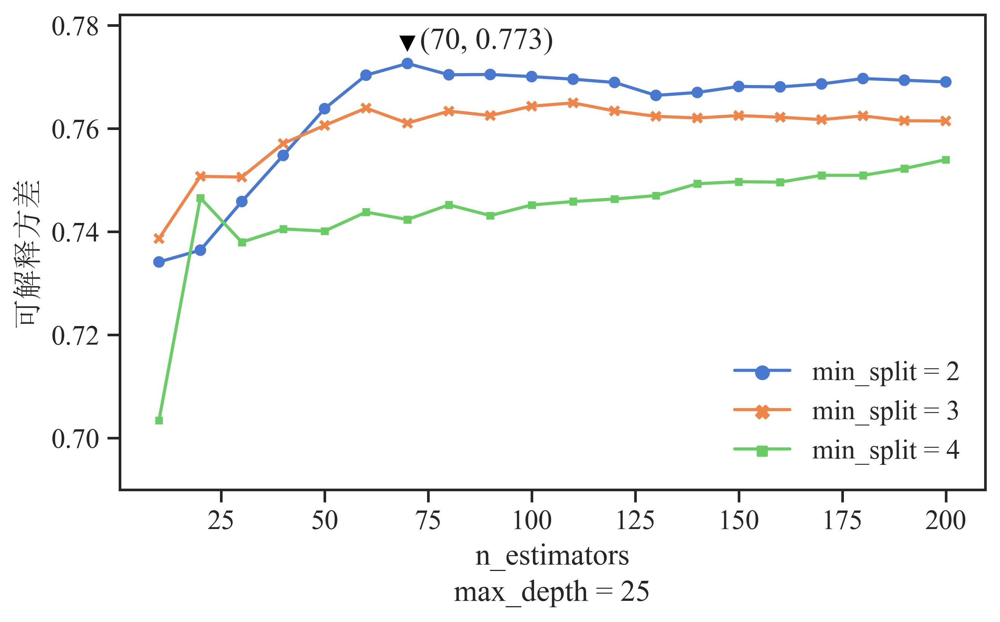

In [250]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(6.5,4),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
# plt.subplot(2,2,1)
# sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==15], x="n", y="var", hue="min_split",palette="muted")
# sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==15], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)
# sub1.set_title("(a) max_depth = 15",y=-0.25)
# sub1.set_ylabel("可解释方差")
# sub1.set_ylim(0.66,0.78)
# sub1.set_xlabel("n_estimators")
# # sub1.set_xticklabels(["TCGA测试集","ICGC","CPTAC"])
# handles,labels = sub1.get_legend_handles_labels()

# groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
# n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")


# sub1.legend_.remove()


# plt.subplot(2,2,2)
# sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==20], x="n", y="var", hue="min_split",palette="muted")
# sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==20], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)



# sub1.set_title("(b) max_depth = 20",y=-0.25)
# sub1.set_ylabel("")
# sub1.set_ylim(0.66,0.78)
# sub1.set_xlabel("n_estimators")
# # sub1.set_xticklabels(["TCGA测试集","ICGC","CPTAC"])
# groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
# n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")
# sub1.legend_.remove() 

plt.subplot(1,1,1)
sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==25], x="n", y="var", hue="min_split",palette="muted")
sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==25], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)
sub1.set_title("max_depth = 25",y=-0.26)
sub1.set_ylabel("可解释方差")
sub1.set_ylim(0.69,0.782)
sub1.set_xlabel("n_estimators")
# sub1.set_xticklabels(["TCGA测试集","ICGC","CPTAC"])
groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
plt.plot(70, 0.7765, marker="v", label="points",c='black')
plt.annotate('(70, 0.773)',xy=(73,0.7755))
n = len(groups)
sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
          frameon=False,loc="lower right")
sub1.legend_.remove()
 

# plt.subplot(2,2,4)
# sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==30], x="n", y="var", hue="min_split",palette="muted")
# sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==30], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)
# sub1.set_title("(d) max_depth = 30",y=-0.25)
# sub1.set_ylabel("")
# sub1.set_ylim(0.69,0.782)
# sub1.set_xlabel("n_estimators")
# groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
# n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")
# sub1.legend_.remove()
# lines, labels = sub1.get_legend_handles_labels()
# fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.5,1.05),ncol=3,frameon=False,fontsize=13) 
handles,labels = sub1.get_legend_handles_labels()

groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
n = len(groups)
plt.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
          frameon=False, loc = 'lower right')

fig.savefig("./result/grid_search_reg.PPT.svg",bbox_inches='tight')

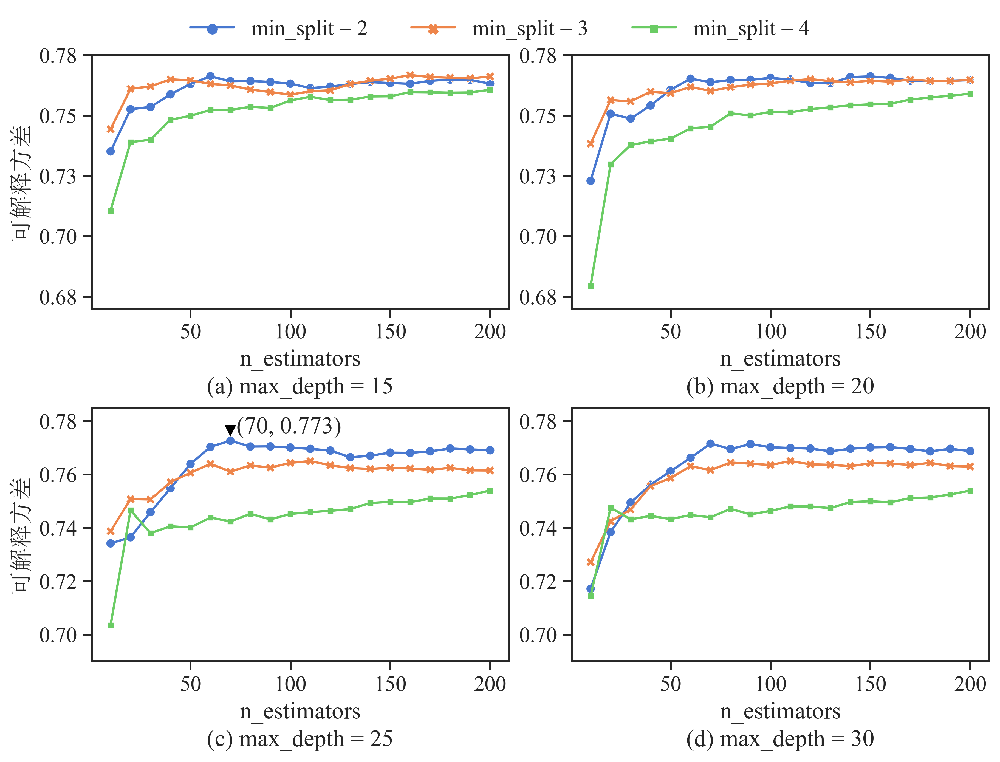

In [1731]:
import matplotlib.ticker as mtick
fig, ax =plt.subplots(2,2,constrained_layout=True,figsize=(9,6.5),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.3)
plt.subplot(2,2,1)
sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==15], x="n", y="var", hue="min_split",palette="muted")
sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==15], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)
sub1.set_title("(a) max_depth = 15",y=-0.37)
sub1.set_ylabel("可解释方差")
sub1.set_ylim(0.67,0.775)
sub1.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f'))
sub1.set_xlabel("n_estimators")
# sub1.set_xticklabels(["TCGA测试集","ICGC","CPTAC"])
handles,labels = sub1.get_legend_handles_labels()

groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")


sub1.legend_.remove()


plt.subplot(2,2,2)
sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==20], x="n", y="var", hue="min_split",palette="muted")
sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==20], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)



sub1.set_title("(b) max_depth = 20",y=-0.37)
sub1.set_ylabel("")
sub1.set_ylim(0.67,0.775)
sub1.set_xlabel("n_estimators")
sub1.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f'))
# sub1.set_xticklabels(["TCGA测试集","ICGC","CPTAC"])
groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")
sub1.legend_.remove() 

plt.subplot(2,2,3)
sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==25], x="n", y="var", hue="min_split",palette="muted")
sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==25], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)
sub1.set_title("(c) max_depth = 25",y=-0.37)
sub1.set_ylabel("可解释方差")
sub1.set_ylim(0.69,0.785)
sub1.set_xlabel("n_estimators")
# sub1.set_xticklabels(["TCGA测试集","ICGC","CPTAC"])
groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
plt.plot(70, 0.7765, marker="v", label="points",c='black')
plt.annotate('(70, 0.773)',xy=(73,0.7755))
n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")
sub1.legend_.remove()
 

plt.subplot(2,2,4)
sub1 = sns.lineplot(data=grid_search[grid_search["max_depth"]==30], x="n", y="var", hue="min_split",palette="muted")
sub1 = sns.scatterplot(data=grid_search[grid_search["max_depth"]==30], x="n", y="var", hue="min_split",palette="muted",style='min_split',markers=True)
sub1.set_title("(d) max_depth = 30",y=-0.37)
sub1.set_ylabel("")
sub1.set_ylim(0.69,0.785)
sub1.set_xlabel("n_estimators")
groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
n = len(groups)
# sub1.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
#           frameon=False,fontsize=12,loc="lower right")
sub1.legend_.remove()
# lines, labels = sub1.get_legend_handles_labels()
# fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.5,1.05),ncol=3,frameon=False,fontsize=13) 
handles,labels = sub1.get_legend_handles_labels()

groups = ["min_split = 2", "min_split = 3", "min_split = 4"]
n = len(groups)
fig.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["min_split = 2", "min_split = 3", "min_split = 4"],
           loc = 'upper center',bbox_to_anchor=(0.5,1.06),ncol=3,frameon=False)

fig.savefig("./result/grid_search/grid_search_reg.svg",bbox_inches='tight')

In [114]:
model = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)

In [1102]:
TCGAres = pd.DataFrame(index=X_test.index)

TCGAres["y_true"] = y_true
TCGAres["y_test"] = y_test

In [119]:
X_train_scale = zcoreScaler(X_train[genes])
X_test_scale = zcoreScaler(X_test[genes])
model.fit(X_train_scale,y_train)
y_pre = model.predict(X_test_scale)
# TCGAres["y_pre"] = y_pre

print(explained_variance_score(y_test,y_pre))
print(mean_squared_error(y_test,y_pre))
print(roc_auc_score(y_true,y_pre))

CPTAC_scale = zcoreScaler(CPTAC[genes])
y_pre = model.predict(CPTAC_scale)
print(roc_auc_score(pd.get_dummies(CPTAC.iloc[:,0])["MSI-H"],y_pre))   

ICGC_scale = zcoreScaler(ICGC[genes])
y_pre = model.predict(ICGC_scale)
print(roc_auc_score(pd.get_dummies(ICGC.iloc[:,0])["MSI-H"],y_pre))

0.7725821427796303
15.340345627412447
0.9879383808587349
0.9963991769547325
0.9992630803242447


In [ ]:
[0.9879383808587349,0.9963991769547325,0.9992630803242447]

In [ ]:
# 预测结果汇总

In [1135]:
def data_pre(data,genes):
    res = pd.DataFrame(index=data.index)
    res["y_true"] = pd.get_dummies(data.iloc[:,0])["MSI-H"]
    data_scale = zcoreScaler(data[genes])
    y_pre = model.predict(data_scale)
    res["y_pre"] = y_pre
    return res

In [1139]:
CPTACres = data_pre(CPTAC,genes)
ICGCres = data_pre(ICGC,genes)

In [1140]:
TCGAres.to_csv("./result/prediction/TCGA_test.res.csv")
CPTACres.to_csv("./result/prediction/CPTAC.res.csv")
ICGCres.to_csv("./result/prediction/ICGC.res.csv")

In [ ]:
# 回归效果可视化

In [1581]:
TCGAres = pd.read_csv("./result/prediction/TCGA_test.res.csv",index_col=0)
CPTACres= pd.read_csv("./result/prediction/CPTAC.res.csv",index_col=0)
ICGCres= pd.read_csv("./result/prediction/ICGC.res.csv",index_col=0)

In [1285]:
TCGA_above5 = TCGAres[TCGAres.y_test >= 5]

In [1286]:
pearsonr(TCGA_above5.y_test,TCGA_above5.y_pre)

PearsonRResult(statistic=0.4370666724668589, pvalue=2.0661422279373094e-05)

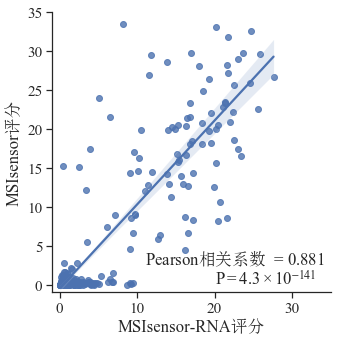

In [1759]:


# fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(5, ),dpi=200)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.4)
# g = sns.lmplot(x="age", y="survived", col="sex", hue="sex", data=df,
#                palette=pal, y_jitter=.02, logistic=True, truncate=False)
sub = sns.lmplot(data= TCGAres, x="y_pre", y="y_test", palette="muted")
sub.set(xlim=(-1, 35), ylim=(-1, 35))
# plt.legend(['GSE132465','GSE178341','GSE200997'], title = "项目",frameon=False)
fontdict = {'math_fontfamily':'custom'}
plt.text(11,2.5,r'$Pearson相关系数$  = 0.881',fontdict=fontdict)
plt.text(20,0.02,r'$\it{P} = 4.3\times10^{-141}$',fontdict=fontdict)
sub.set(ylabel="MSIsensor评分",xlabel="MSIsensor-RNA评分")
plt.savefig("./result/prediction/TCGAtest_score_above5.svg",bbox_inches='tight')


In [1288]:
TCGA_blow5 = TCGAres[TCGAres.y_test < 5]

In [1294]:
pearsonr(TCGA_blow5.y_test,TCGA_blow5.y_pre)

PearsonRResult(statistic=0.35220421298023885, pvalue=2.1457639961635225e-11)

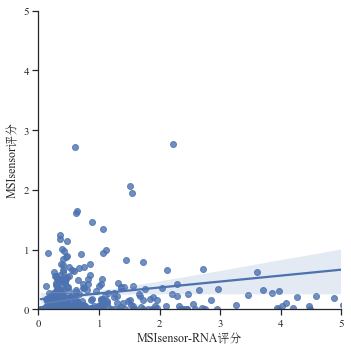

In [1298]:
# fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(4, 4),dpi=200)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)
# g = sns.lmplot(x="age", y="survived", col="sex", hue="sex", data=df,
#                palette=pal, y_jitter=.02, logistic=True, truncate=False)
sub = sns.lmplot(data=TCGA_blow5, x="y_pre", y="y_test", palette="muted")
sub.set(xlim=(0, 5), ylim=(0,5))
# plt.legend(['GSE132465','GSE178341','GSE200997'], title = "项目",frameon=False)
sub.set(ylabel="MSIsensor评分",xlabel="MSIsensor-RNA评分")
plt.savefig("./result/prediction/TCGAtest_score_blow5.svg")

In [1284]:
from scipy.stats import pearsonr,spearmanr
pearsonr(TCGAres.y_test,TCGAres.y_pre)

PearsonRResult(statistic=0.8812998667618693, pvalue=4.297129327525529e-141)

TCGA_test 429
ICGC 141
CPTAC 105
TCGA_test 429
ICGC 141
CPTAC 105
TCGA_test 434
ICGC 141
CPTAC 105


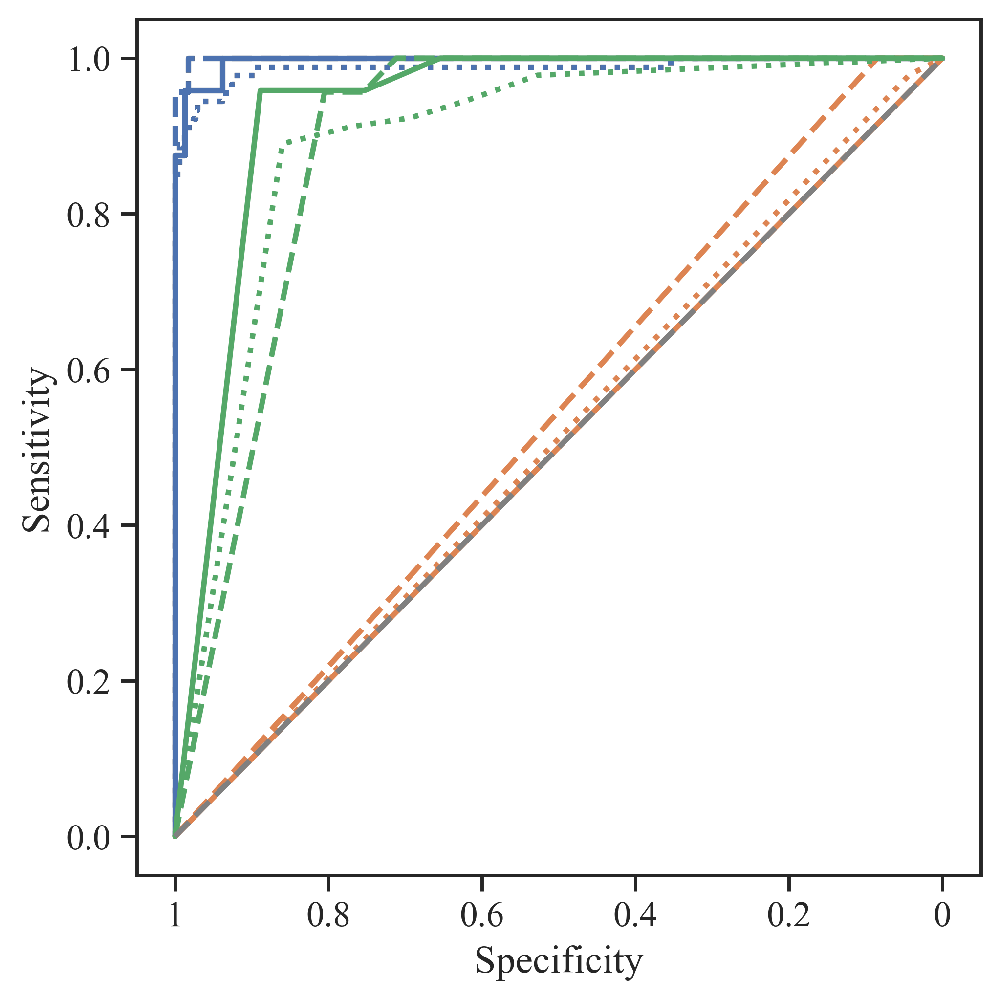

In [283]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(5, 5),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = plt.subplot(1,1,1)
colors =  [ "black", "black",  "black", u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    print(db,this_data.shape[0])
    this_data["dataset"] = db
    data = pd.concat([data, this_data])

db_name = ["TCGA测试集","ICGC","CPTAC"]
lines = [":","--","-"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])    
    
    
dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    print(db,this_data.shape[0])
    this_data["dataset"] = db
    data = pd.concat([data, this_data])

db_name = ["TCGA测试集","ICGC","CPTAC"]
lines = [":","--","-"]
colors =  [u'#4c72b0',u'#4c72b0',u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0


for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
    

dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./R/result/bulk/FPKM/" + f"{db}.res.csv", index_col=0)
    this_data["dataset"] = db
    print(db,this_data.shape[0])
    data = pd.concat([data, this_data])
data.index = list(data["sample"])

dbs = ["TCGA_test","ICGC","CPTAC"]
data1 = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    this_data["dataset"] = db
    data1 = pd.concat([data1, this_data])

data = pd.merge(data,data1,left_index=True,right_index=True)

data.rename(columns={"dataset_x":"dataset"},inplace=True)    
    
colors =  [u'#dd8452', u'#dd8452',u'#dd8452', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].single_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].single_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
colors =  [ u'#55a868',  u'#55a868',  u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].split_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].split_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])    
    
    
    
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
# plt.title("(b) ROC曲线",y=-0.2)  
handles,labels = ax.get_legend_handles_labels()

TCGA_test 429
ICGC 141
CPTAC 105
TCGA_test 434
ICGC 141
CPTAC 105


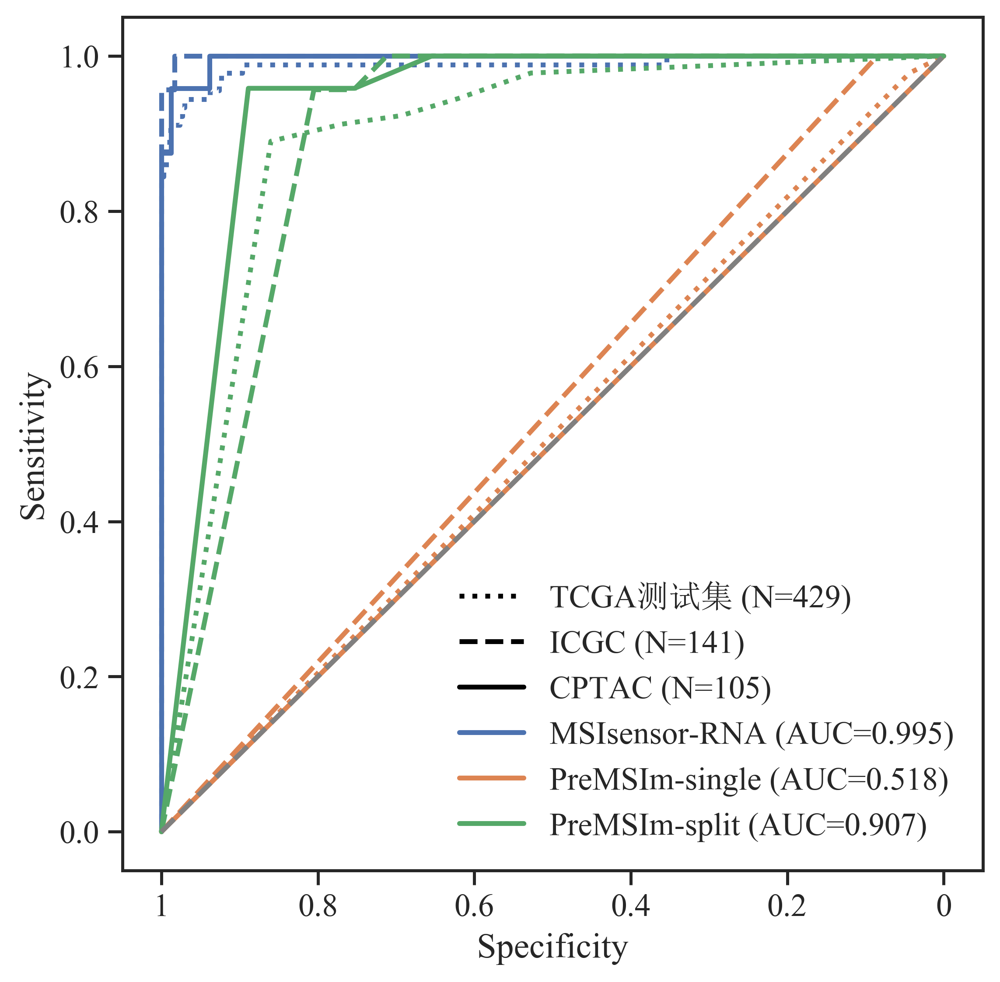

In [287]:
dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    print(db,this_data.shape[0])
    this_data["dataset"] = db
    data = pd.concat([data, this_data])

db_name = ["TCGA测试集","ICGC","CPTAC"]
lines = [":","--","-"]
colors =  [u'#4c72b0',u'#4c72b0',u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(5.6, 5.5),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = plt.subplot(1,1,1)
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
    

dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./R/result/bulk/FPKM/" + f"{db}.res.csv", index_col=0)
    this_data["dataset"] = db
    print(db,this_data.shape[0])
    data = pd.concat([data, this_data])
data.index = list(data["sample"])

dbs = ["TCGA_test","ICGC","CPTAC"]
data1 = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    this_data["dataset"] = db
    data1 = pd.concat([data1, this_data])

data = pd.merge(data,data1,left_index=True,right_index=True)

data.rename(columns={"dataset_x":"dataset"},inplace=True)    
    
colors =  [u'#dd8452', u'#dd8452',u'#dd8452', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].single_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].single_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
colors =  [ u'#55a868',  u'#55a868',  u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].split_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].split_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc),ls=lines[i])  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])    
    
    
    
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
# plt.title("(b) ROC曲线",y=-0.2)  
# handles,labels = ax.get_legend_handles_labels()
plt.legend(handles=[handles[0],handles[1],handles[2],handles[5],handles[8],handles[11]],labels=["TCGA测试集 (N=429)","ICGC (N=141)","CPTAC (N=105)",'MSIsensor-RNA (AUC=0.995)','PreMSIm-single (AUC=0.518)','PreMSIm-split (AUC=0.907)'],loc="lower right",frameon=False)
plt.savefig("./result/database_compare_PPT.svg")

In [229]:
from math import log10, floor
def find_exp(number) -> int:
    base10 = log10(abs(number))
    return number*10**abs(floor(base10)),abs(floor(base10))

TCGA_test 429
ICGC 141
CPTAC 105
0 2.6695737037429806e-46
1 1.9994865865070318e-14
2 8.92047675114998e-14


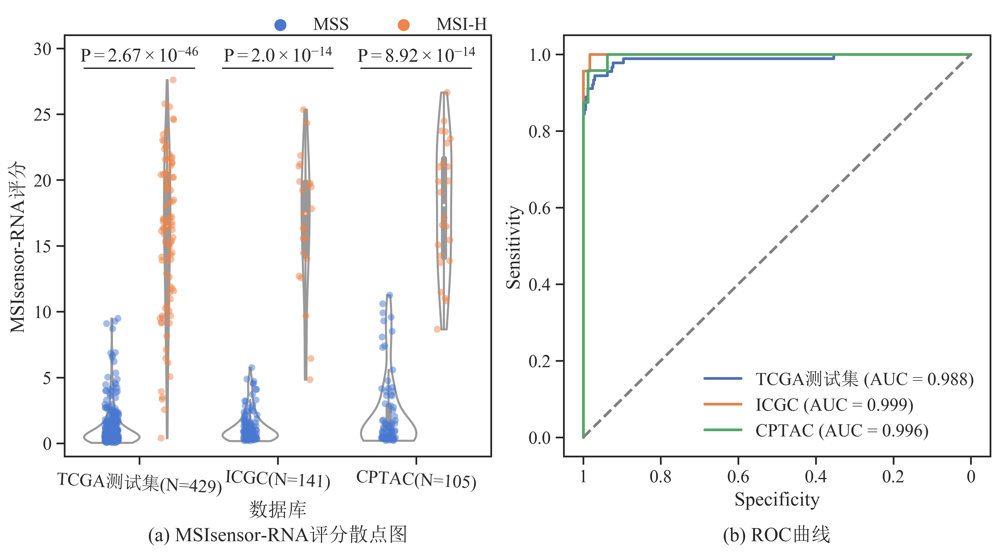

In [235]:
dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    print(db,this_data.shape[0])
    this_data["dataset"] = db
    data = pd.concat([data, this_data])

db_name = ["TCGA测试集","ICGC","CPTAC"]
from scipy.stats import ranksums
fig, ax =plt.subplots(1,2,constrained_layout=True,figsize=(10, 5.5),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = plt.subplot(1,2,1)
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
sub = sns.violinplot(x="dataset", y="y_pre",data=data, hue="y_true",
                   hue_order=[0, 1],  palette=["white", "white"],
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(x="dataset", y="y_pre",data=data, hue="y_true",hue_order=[0, 1],
                       palette="muted", dodge=True, jitter=True,alpha=0.5)
handles,labels = sub.get_legend_handles_labels()
pvalues=[]
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["dataset"] == db) & (data["y_true"] == 1)]["y_pre"],
        y=data[(data["dataset"] == db) & (data["y_true"] == 0)]["y_pre"],
        alternative="greater"
    )[1])
fontdict = {'math_fontfamily':'custom',"size":14}
for i in range(3):
    plt.plot([i-0.4,i+0.4],[28.5,28.5],color="black",linewidth=0.8)
    print(i,pvalues[i])
    plt.text(i, 29, r"P$={va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
sub.set_ylabel("MSIsensor-RNA评分")
sub.set_ylim(-1,31)
sub.set_xlabel("数据库")
sub.set_title("(a) MSIsensor-RNA评分散点图",y=-0.22)
sub.set_xticklabels(["TCGA测试集(N=429)","ICGC(N=141)","CPTAC(N=105)"],rotation=-3)



plt.legend(handles=handles[2:],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1.03,1.082),ncol=3)



sub = plt.subplot(1,2,2)
colors =  [u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].y_pre)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc))  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
plt.legend(loc="lower right",frameon=False)
plt.title("(b) ROC曲线",y=-0.22)
# sns.violoplot(data=res.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), x="y_type", y="y_score", hue="y_true")
plt.savefig("./result/prediction/database_compare.svg")

In [237]:
dbs = ["TCGA_test","ICGC","CPTAC"]
data = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./R/result/bulk/FPKM/" + f"{db}.res.csv", index_col=0)
    this_data["dataset"] = db
    print(db,this_data.shape[0])
    data = pd.concat([data, this_data])
data.index = list(data["sample"])

dbs = ["TCGA_test","ICGC","CPTAC"]
data1 = pd.DataFrame()
for db in dbs:
    this_data = pd.read_csv("./result/prediction/" + f"{db}.res.csv", index_col=0)
    this_data["dataset"] = db
    data1 = pd.concat([data1, this_data])

data = pd.merge(data,data1,left_index=True,right_index=True)

data.rename(columns={"dataset_x":"dataset"},inplace=True)

TCGA_test 434
ICGC 141
CPTAC 105


0 0.37479992986478416
1 0.2605304777099542
2 0.5


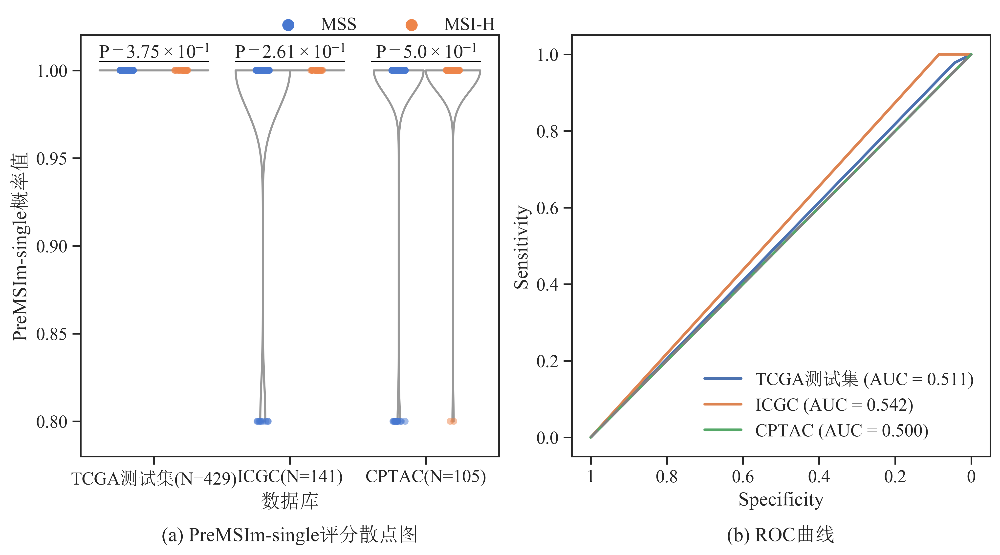

In [238]:
from scipy.stats import ranksums
fig, ax =plt.subplots(1,2,constrained_layout=True,figsize=(10, 5.5),dpi=400)

dbs = ["TCGA_test","ICGC","CPTAC"]

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = plt.subplot(1,2,1)
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
sub = sns.violinplot(x="dataset", y="single_score",data=data, hue="y_true",
                   hue_order=[0, 1],  palette=["white", "white"],
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(x="dataset", y="single_score",data=data, hue="y_true",hue_order=[0, 1],
                       palette="muted", dodge=True, jitter=True,alpha=0.5)
pvalues=[]
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["dataset"] == db) & (data["y_true"] == 1)]["single_score"],
        y=data[(data["dataset"] == db) & (data["y_true"] == 0)]["single_score"],
        alternative="greater"
    )[1])
fontdict = {'math_fontfamily':'custom', 'size':14}
for i in range(3):
    plt.plot([i-0.4,i+0.4],[1.005,1.005],color="black",linewidth=0.8)
    print(i,pvalues[i])
    plt.text(i, 1.007, r"P$={va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
sub.set_ylabel("PreMSIm-single概率值")
sub.set_ylim(0.78,1.02)
sub.set_xlabel("数据库")
sub.set_title("(a) PreMSIm-single评分散点图",y=-0.22)
sub.set_xticklabels(["TCGA测试集(N=429)","ICGC(N=141)","CPTAC(N=105)"])
# handles,labels = ax.get_legend_handles_labels()

plt.legend(handles=handles[2:],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1.03,1.082),ncol=3)



sub = plt.subplot(1,2,2)
colors =  [u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].single_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].single_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc))  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
plt.title("(b) ROC曲线",y=-0.22)
# plt.title("(b) ROC曲线",y=-0.2)  
plt.legend(loc="lower right",frameon=False)

# sns.violoplot(data=res.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), x="y_type", y="y_score", hue="y_true")
plt.savefig("./R/result/bulk/bulk_database_compare_single.svg")

0 4.608340303028787e-31
1 1.084271575885361e-09
2 5.799114679042404e-11


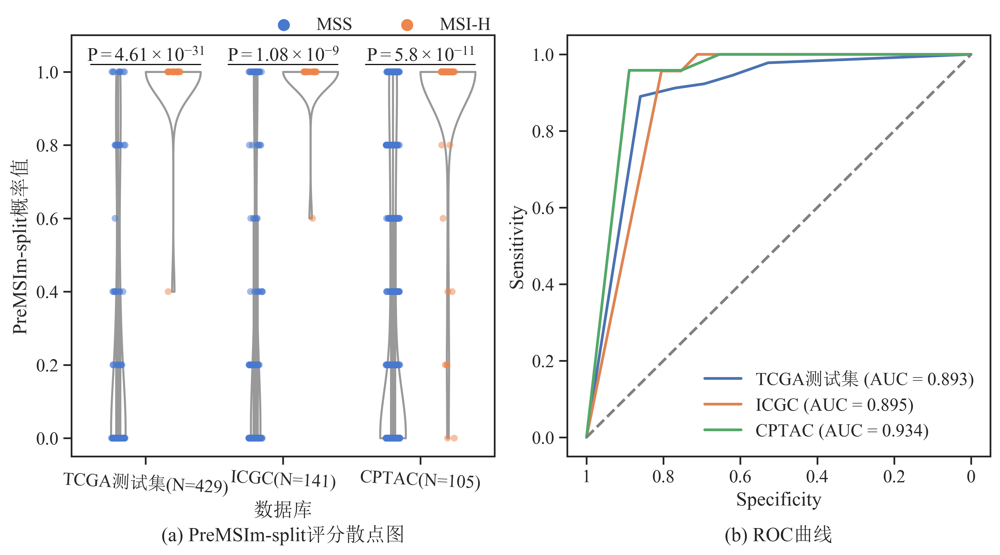

In [239]:
from scipy.stats import ranksums
fig, ax =plt.subplots(1,2,constrained_layout=True,figsize=(10, 5.5),dpi=400)

dbs = ["TCGA_test","ICGC","CPTAC"]

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = plt.subplot(1,2,1)
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)
sub = sns.violinplot(x="dataset", y="split_score",data=data, hue="y_true",
                   hue_order=[0, 1],  palette=["white", "white"],
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(x="dataset", y="split_score",data=data, hue="y_true",hue_order=[0, 1],
                       palette="muted", dodge=True, jitter=True,alpha=0.5)
pvalues=[]
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["dataset"] == db) & (data["y_true"] == 1)]["split_score"],
        y=data[(data["dataset"] == db) & (data["y_true"] == 0)]["split_score"],
        alternative="greater"
    )[1])
fontdict = {'math_fontfamily':'custom', 'size':14}
for i in range(3):
    plt.plot([i-0.4,i+0.4],[1.02,1.02],color="black",linewidth=0.8)
    print(i,pvalues[i])
    plt.text(i, 1.03, r"P$={va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
sub.set_ylabel("PreMSIm-split概率值")
sub.set_ylim(-0.05,1.1)
sub.set_xlabel("数据库")
sub.set_title("(a) PreMSIm-split评分散点图",y=-0.22)
sub.set_xticklabels(["TCGA测试集(N=429)","ICGC(N=141)","CPTAC(N=105)"],rotation=-3)
# handles,labels = ax.get_legend_handles_labels()

plt.legend(handles=handles[2:],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1.03,1.082),ncol=3)



sub = plt.subplot(1,2,2)
colors =  [u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0

db_name = ["TCGA测试集","ICGC","CPTAC"]
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["dataset"] == db].y_true,data[data["dataset"] == db].split_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["dataset"] == db].y_true,data[data["dataset"] == db].split_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s (AUC = %0.3f)' % (db_name[i],roc_auc))  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
# plt.title("(b) ROC曲线",y=-0.2) 
plt.title("(b) ROC曲线",y=-0.22)
plt.legend(loc="lower right",frameon=False)

# sns.violoplot(data=res.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), x="y_type", y="y_score", hue="y_true")
plt.savefig("./R/result/bulk/bulk_database_compare_split.svg")

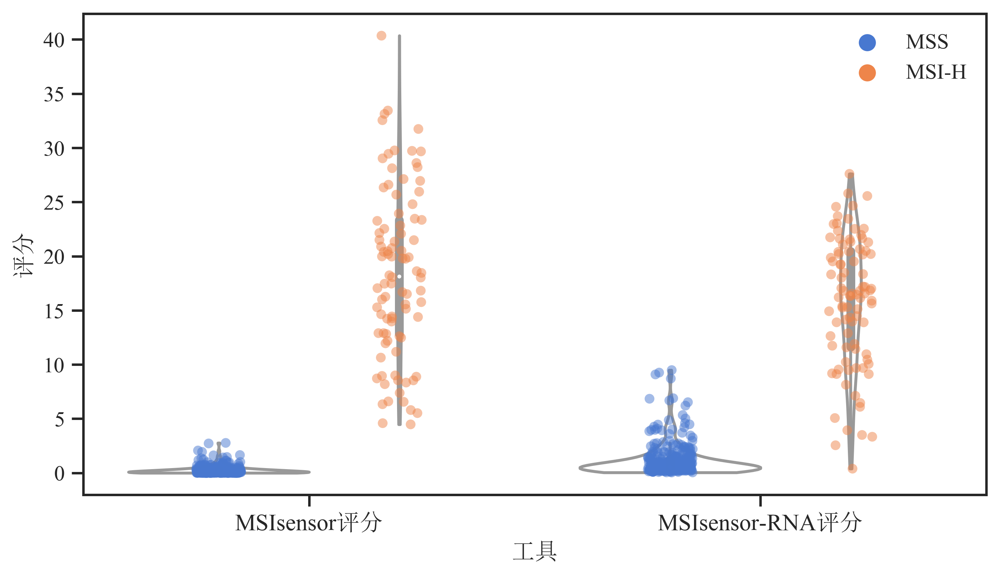

In [769]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7, 4),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = sns.set(context='notebook', style='ticks', rc=rc)
sub = sns.violinplot(x="y_type", y="y_score",data=TCGAres.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), hue="y_true",
                   hue_order=[0, 1],  palette=["white", "white"],
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(x="y_type", y="y_score",data=TCGAres.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), hue="y_true",hue_order=[0, 1],
                       palette="muted", dodge=True, jitter=True,alpha=0.5)


sub.set_ylabel("评分",fontsize=12)
sub.set_xlabel("工具",fontsize=12)
sub.set_xticklabels(["MSIsensor评分","MSIsensor-RNA评分"],fontsize=12)
handles,labels = ax.get_legend_handles_labels()
plt.legend(handles=handles[2:],labels=['MSS','MSI-H'],frameon=False)
# sns.violoplot(data=res.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), x="y_type", y="y_score", hue="y_true")
plt.savefig("./result/prediction/TCGAtest_stripplot.svg")

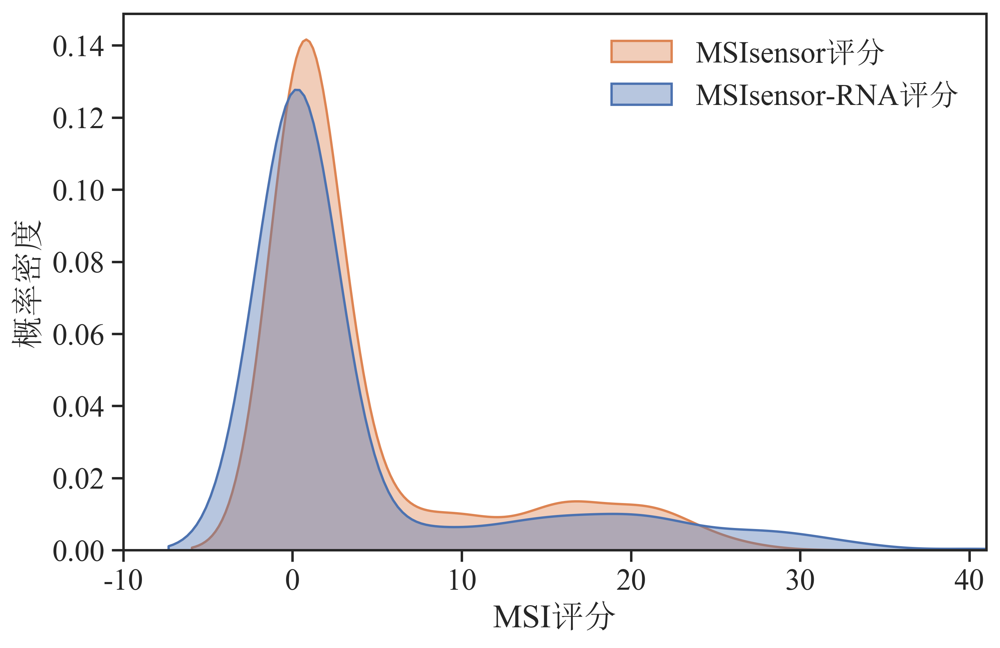

In [1761]:
import matplotlib
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7, 4.5),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.4)

sub = sns.kdeplot(data=TCGAres.melt(id_vars=["y_true"], var_name='y_type',value_name='y_score' ), x="y_score", hue="y_type",fill=True,common_norm=False,
   alpha=.4, linewidth=1.2)
sub.set_ylabel("概率密度")
sub.set_xlabel("MSI评分")
sub.set_xlim(-10,41)
handles,labels = ax.get_legend_handles_labels()
plt.legend(labels=['MSIsensor评分','MSIsensor-RNA评分'],frameon=False) 

# 0.8812998667618693, 4.2971293275255686e-141)
plt.savefig("./result/prediction/TCGAtest_kdeplot.svg",bbox_inches='tight')

In [168]:
# cutoff
def find_optimal_cutoff(tpr,fpr,threshold):
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = threshold[optimal_idx]
    return optimal_threshold

In [170]:
TCGAres

,y_true,y_test,y_pre
TCGA-AX-A3FZ-01A,0,1.01,0.393714
TCGA-CI-6623-01B,0,0.10,0.288266
TCGA-AX-A2HA-01A,1,28.60,13.900429
TCGA-D1-A176-01A,1,16.69,16.351286
TCGA-B5-A11W-01A,0,0.20,0.325286
...,...,...,...
TCGA-B5-A11V-01A,0,0.05,0.240924
TCGA-E6-A1M0-01A,0,0.14,1.485714
TCGA-G4-6297-01A,0,0.19,0.151899
TCGA-CD-A4MH-01A,0,0.00,0.145714


In [21]:
fpr, tpr, thresholds = roc_curve(TCGAres.y_true,TCGAres.y_pre)
cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
print(cutoff)

5.064571428571429


In [22]:
fpr, tpr, thresholds = roc_curve(ICGCres.y_true,ICGCres.y_pre)
cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
print(cutoff)

4.83742857142857


In [23]:
fpr, tpr, thresholds = roc_curve(CPTACres.y_true,CPTACres.y_pre)
cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
print(cutoff)

10.824142857142858


In [ ]:
# gene contribution

In [120]:
import eli5
samp = eli5.explain_prediction_df(model,X_test_scale.iloc[0,:].values,feature_names=genes).sort_values(by="feature")
weight = pd.DataFrame(index=list(samp.iloc[1:,:]["feature"]))
for i in range(X_test_scale.shape[0]):
    samp = eli5.explain_prediction_df(model,X_test_scale.iloc[i,:].values,feature_names=genes).sort_values(by="feature")   
    samp = samp.iloc[1:,:]
    samp["weight"] = samp["weight"].map(lambda x:abs(x))
    samp["weight"] = samp["weight"]/sum(samp["weight"])
    weight[X_test_scale.index[i]] = list(samp["weight"])

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\sklearn\base.py:420: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with

In [121]:
weight = weight.T
weight.to_csv("./result/prediction/TCGA_weight.csv")

In [107]:
weight = pd.read_csv("./result/prediction/TCGA_weight.csv",index_col=0)

In [122]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
gene_sort = gene_sort[:-1]
genes = gene_sort[:14]

weight = pd.read_csv("./result/prediction/TCGA_weight.csv",index_col=0)
weight = weight[genes]
y_pre = model.predict(X_test_scale)

weight.insert(loc=0,column="y_pre",value=y_pre)

weight.insert(loc=1,column="type",value=0)

weight.insert(loc=0,column="id",value=weight.index)

weight.loc[weight["y_pre"] <= 5,"type"] = "MSS"
weight.loc[(weight["y_pre"] <= 20.3) & (weight["y_pre"] >= 10.1),"type"] = "MSI-H II"
weight.loc[weight["y_pre"] >= 20.3,"type"] = "MSI-H III"
weight.loc[weight["type"] == 0,"type"] = "MSI-H I"

In [123]:
pairs = []
for gene in weight.columns[3:]:
    pair1 = (gene,"MSI-H I")
    pair2 = (gene,"MSI-H III")  
    group = (pair1,pair2)
    pairs.append(group)

In [124]:
weight.to_csv("./result/prediction/TCGA_weight.csv")

In [1261]:
weight.iloc[15,0:]

id          TCGA-AZ-5407-01A
y_pre                1.30414
type                     MSS
MLH1                0.183929
EPM2AIP1            0.101222
MSH4                0.117961
RPL22L1            0.0916754
HSPH1              0.0304734
TRIM7                0.15429
PRTFDC1            0.0306624
SMAP1              0.0310926
DDX27              0.0487131
CXCL9               0.047203
WDTC1              0.0432714
FECH               0.0512174
SFXN1             0.00033686
COL18A1            0.0679529
Name: TCGA-AZ-5407-01A, dtype: object

In [1268]:
weight.iloc[27,0:]

id          TCGA-AD-5900-01A
y_pre                 21.611
type               MSI-H III
MLH1                0.246751
EPM2AIP1             0.13834
MSH4               0.0768161
RPL22L1            0.0580651
HSPH1            0.000242539
TRIM7               0.135387
PRTFDC1            0.0012175
SMAP1              0.0700603
DDX27               0.015911
CXCL9              0.0280586
WDTC1              0.0449103
FECH               0.0875605
SFXN1              0.0816128
COL18A1            0.0150685
Name: TCGA-AD-5900-01A, dtype: object

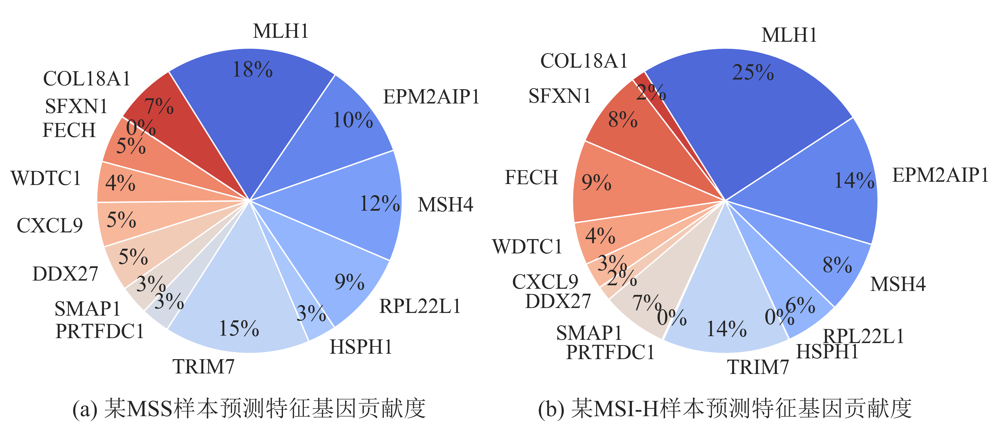

In [1780]:
import palettable
fig, ax =plt.subplots(1,2,constrained_layout=True,figsize=(10,5),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.4)
sub = plt.subplot(1,2,1)
sub = plt.pie(weight.iloc[15,3:],labels=weight.iloc[:,3:].columns,autopct='%1.0f%%',counterclock=False,labeldistance=1.1,startangle=122
                    ,radius=1,pctdistance=0.85,colors=sns.color_palette("coolwarm", 14))
plt.xlabel("(a) 某MSS样本预测特征基因贡献度",y=-2)

sub = plt.subplot(1,2,2)
sub = plt.pie(weight.iloc[27,3:],labels=weight.iloc[:,3:].columns,autopct='%1.0f%%',counterclock=False,labeldistance=1.1,startangle=122
                    ,radius=1,pctdistance=0.85,colors=sns.color_palette("coolwarm", 14))
plt.xlabel("(b) 某MSI-H样本预测特征基因贡献度",y=-2)
plt.savefig("./result/prediction/gene_contribution.svg",bbox_inches='tight')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

CXCL9_MSI-H III vs. CXCL9_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:1.518e-01 U_stat=2.180e+02
WDTC1_MSI-H III vs. WDTC1_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:3.456e-02 U_stat=1.850e+02
FECH_MSI-H III vs. FECH_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:9.694e-02 U_stat=2.070e+02
SFXN1_MSI-H III vs. SFXN1_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:1.245e-01 U_stat=3.630e+02
COL18A1_MSI-H III vs. COL18A1_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:5.028e-01 U_stat=2.550e+02
DDX27_MSI-H III vs. DDX27_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:1.578e-01 U_stat=2.190e+02
EPM2AIP1_MSI-H III vs. EPM2AIP1_MSI-H I: Mann-Whitney-Wilcoxon test two-sided, P_val:1.785e-03 U_stat=4.400e+02
MLH1_MSI-H III vs. MLH1_MSI-H I: Mann-Whitney-Wilcoxon test two-sided

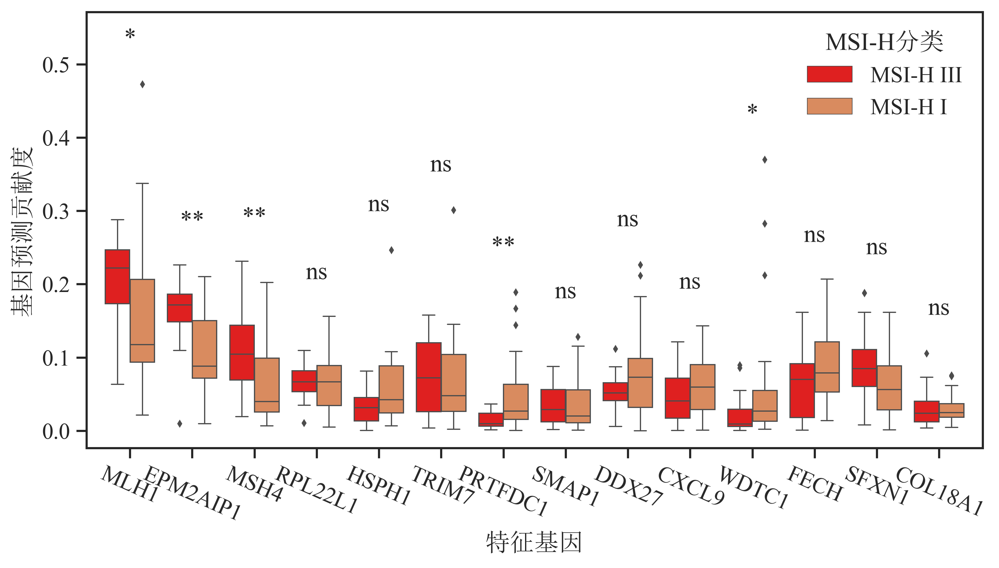

In [129]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(8,4.5),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)


weight_melt = weight.melt(id_vars=["type","y_pre","id"],var_name='gene',value_name='contribution')

sub = sns.boxplot(fliersize=2,palette=["red",u'#ee854a'],linewidth=0.7,data=weight_melt[(weight_melt.type == "MSI-H I") | (weight_melt.type == "MSI-H III")], x="gene", y="contribution", hue="type")
sub.set_xticklabels(labels=weight.columns[3:],rotation=-24)#,
sub.legend(title="MSI-H分类",frameon=False)
sub.set_ylabel("基因预测贡献度")
sub.set_xlabel("特征基因")
handles,labels = ax.get_legend_handles_labels()
annotator =  Annotator(ax,pairs, data=weight_melt[(weight_melt.type == "MSI-H I") | (weight_melt.type == "MSI-H III")], x="gene",y="contribution",hue="type",hide_non_significant=True)
annotator.configure(test='Mann-Whitney', text_format='star',line_width=0)
annotator.apply_and_annotate()

plt.savefig("./result/prediction/TCGA_weight_pbelow5.svg")
# plt.savefig("./Result/prediction/TCGA_weight_full.svg")

In [ ]:
path = "./Data/SingleCellFull/GSE178341_261/"
def countZeros(path,genes):
    res = []
    count = pd.DataFrame(index=["zero","cell_num"])
    for file in os.listdir(path):
        zero = []
        data = pd.read_csv(path+file,index_col=0)[genes]
        for i in range(data.shape[0]):
            zero.append(sum(np.isnan(data.iloc[i,:])))
        res.append(sum(zero))
        res.append(data.shape[0])
        count[file.split(".")[0]] = res
        res = []
        zero = []
    count = count.T
    count["ratio"] = count.zero / (count.cell_num * len(genes))
    return count

In [1148]:
heatmap = X_test_scale

In [1149]:
heatmap.insert(loc=0,value=y_pre,column="y_pre")

ValueError: cannot insert y_pre, already exists

In [1658]:
model_DT = ExtraTreesRegressor(max_depth=3, max_features='sqrt', n_estimators=70,
                    random_state=6)

In [1659]:
X_train_scale = zcoreScaler(X_train[genes])
model_DT.fit(X_train_scale,y_train)

ExtraTreesRegressor(max_depth=3, max_features='sqrt', n_estimators=70,
                    random_state=6)

In [1150]:
X_test_scale

,y_pre,MLH1,EPM2AIP1,MSH4,RPL22L1,HSPH1,TRIM7,PRTFDC1,SMAP1,DDX27,CXCL9,WDTC1,FECH,SFXN1,COL18A1
TCGA-AX-A3FZ-01A,0.393714,0.189033,0.411836,-1.566353,0.357378,1.537560,-1.549731,1.235859,-0.860667,0.588402,-1.464402,0.724390,-0.619405,0.144525,0.871575
TCGA-CI-6623-01B,0.288266,0.067504,-0.844385,-1.622404,0.343949,1.932593,-1.606939,0.079401,-0.280314,1.513428,-0.248156,0.845739,-0.891253,0.267043,0.443794
TCGA-AX-A2HA-01A,13.900429,-0.768590,-0.752850,-1.042581,1.564922,2.179918,-1.068862,-0.870941,-0.996408,-0.054005,0.402519,0.618564,-0.383233,0.211627,0.959919
TCGA-D1-A176-01A,16.351286,-1.022742,-1.014928,-1.102467,0.582671,0.573587,-1.143930,-0.878160,-0.562626,0.511608,0.098279,1.373797,0.134900,0.114713,2.335298
TCGA-B5-A11W-01A,0.325286,-0.166474,0.287731,-1.452295,1.218493,0.983221,-1.450746,-0.442321,-0.993494,0.348578,-1.003800,1.578375,-0.565228,0.225963,1.431997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-B5-A11V-01A,0.240924,-0.170300,-0.254692,-1.533251,1.357460,0.821550,-1.494911,0.342009,-0.789434,0.564141,-1.303201,1.072598,-0.278217,-0.012464,1.678714
TCGA-E6-A1M0-01A,1.485714,-0.223149,-0.321975,-1.711958,1.798045,0.842164,-1.675948,0.524245,-0.772216,0.658156,0.903955,-0.071027,-1.070395,0.195929,0.924174
TCGA-G4-6297-01A,0.151899,-0.419466,-0.482773,-1.658702,0.540314,1.670087,-1.499627,-0.659733,-0.602724,0.980418,1.091833,0.691413,-0.814818,-0.025838,1.189616
TCGA-CD-A4MH-01A,0.145714,-0.736822,-0.309513,-1.860518,0.842155,1.115982,-1.797738,-0.242365,0.591471,1.148638,0.575997,0.889305,-1.068163,0.002041,0.849531


In [1667]:
dot_data = tree.export_graphviz( model_DT.estimators_[3], out_file=None, 
                      feature_names=X_train_scale.columns,  
                      class_names="Score",  
                     filled=True, rounded=True)  
graph = graphviz.Source(dot_data)   

,MLH1,EPM2AIP1,MSH4,PRTFDC1,WDTC1
TCGA-BR-A4J7-01A,-0.505976,0.043103,-1.723482,-0.342913,0.881017
TCGA-BR-8365-01A,-0.411741,0.030438,-2.127815,-0.044366,1.351357
TCGA-BR-8384-01A,-0.338270,0.416749,-2.015392,-0.021032,1.343505
TCGA-CD-8529-01A,-0.574747,-0.308245,-1.857133,-0.399965,0.730448
TCGA-BR-A4J9-01A,-0.208079,0.275431,-1.964430,-0.508815,1.388033
...,...,...,...,...,...
TCGA-A6-6653-01A,-1.327836,-1.393611,-1.514516,-0.081446,0.843050
TCGA-AA-3663-01A,-0.944407,-1.094675,-0.843820,-0.897523,0.257159
TCGA-A6-2672-01A,-1.218207,-1.300575,-1.176374,0.117301,0.437147
TCGA-HF-A5NB-01A,-1.315516,-1.311650,-1.353437,-0.435255,0.796357


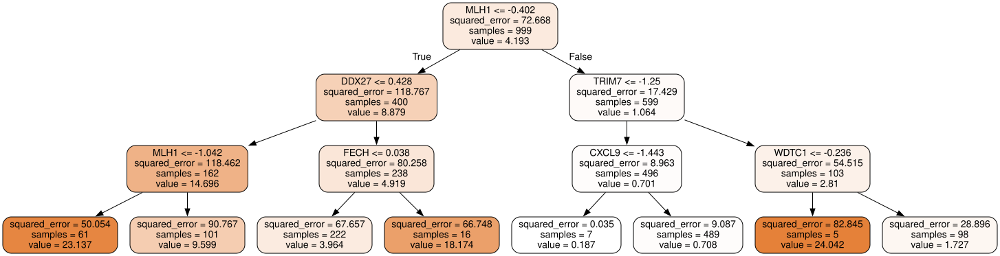

In [1668]:
graph

In [ ]:
# 分类效果比较

In [715]:
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))
# RANDOM_STATE = 42
RANDOM_STATE = 0
features = TCGA[genes].applymap(lambda x:np.log2(x+1))
# target = TCGA["msi"]
target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)

CPTAC = CPTAC.applymap(lambda x:np.log2(x+1)if type(x)==float else x)

ICGC = ICGC.applymap(lambda x:np.log2(x+1)if type(x)==float else x)

In [716]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
gene_sort = gene_sort[:-1]
genes = gene_sort[:14]

In [717]:
model = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
X_train_scale = zcoreScaler(X_train[genes])
model.fit(X_train_scale,y_train)

ExtraTreesRegressor(max_depth=25, max_features='sqrt', n_estimators=70,
                    random_state=6)

In [ ]:
# bulk

In [340]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support
def metricCalculate(y_true,y_score,y_pre):
    auc = roc_auc_score(y_true,y_score)
    tn, fp, fn, tp = confusion_matrix(y_true,y_pre).ravel()
    accuracy = (tp+tn)/(tn+fp+fn+tp)
#     precision = tp/(tp+fp)
#     recall = tp/(tp+fn)
    specificity = tn/(tn+fp)
#     f1 = 2*precision*recall/(precision+recall)
    precision,recall,f1,_ = precision_recall_fscore_support(y_true,y_pre,average="binary")
    return auc,f1,accuracy,precision,recall,specificity

In [347]:
def preMSI_cutoff(merge):
    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.single_score)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    y_pre = merge.single_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    
    merge["single_label"] = y_pre
    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.split_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    y_pre = merge.split_score.copy()
    
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    merge["split_label"] = y_pre
    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.all_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    y_pre = merge.all_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    merge["all_label"] = y_pre
    
    return merge

In [697]:
def getPredictionResult(database,X_test,genes):
    res = pd.DataFrame(index=X_test.index)
    res["sample_num"] = X_test.shape[0]
    res["database"] = database
    res["cancer"] = X_test.tumor
    y_true = pd.get_dummies(X_test["msi"])["MSI-H"]
    res["y_true"] = y_true
    
    X_test_scale = zcoreScaler(X_test[genes])
    y_score = model.predict(X_test_scale)
    res["y_score"] = y_score
    
    
    fpr, tpr, thresholds = roc_curve(y_true,y_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    cutoff = 5.06
    y_pre = y_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    res["y_pre"] = y_pre
    res.to_csv("./result/result/bulk/"+database+".res.csv")
#     roc_auc = auc(fpr, tpr)
#     acc = accuracy_score(y_true,y_pre)
#     plt.figure(figsize=(5, 5))
#     plt.plot(fpr, tpr, color='darkorange',
#             lw=2, label='AUC = %0.4f' % roc_auc)  ###假正率为横坐标，真正率为纵坐标做曲线
#     plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
#     plt.xlim([-0.05, 1.05])
#     plt.ylim([-0.05, 1.05])
#     plt.xlabel('False Positive Rate')
#     plt.ylabel('True Positive Rate')
#     plt.legend(loc="lower right")
#     precision,recall,f1,_ = metrics.precision_recall_fscore_support(y_true, y_pre, average='binary')    
    return res


In [718]:
TCGA_test = TCGA.loc[X_test.index,:]
TCGA_test = TCGA_test.applymap(lambda x:np.log2(x+1) if type(x)!=str else x)
getPredictionResult("TCGA_test",TCGA_test,genes)

,sample_num,database,cancer,y_true,y_score,y_pre
TCGA-AX-A3FZ-01A,434,TCGA_test,UCEC,0,0.393714,0.0
TCGA-CI-6623-01B,434,TCGA_test,CRC,0,0.288266,0.0
TCGA-AX-A2HA-01A,434,TCGA_test,UCEC,1,13.900429,1.0
TCGA-D1-A176-01A,434,TCGA_test,UCEC,1,16.351286,1.0
TCGA-B5-A11W-01A,434,TCGA_test,UCEC,0,0.325286,0.0
...,...,...,...,...,...,...
TCGA-B5-A11V-01A,434,TCGA_test,UCEC,0,0.240924,0.0
TCGA-E6-A1M0-01A,434,TCGA_test,UCEC,0,1.485714,0.0
TCGA-G4-6297-01A,434,TCGA_test,CRC,0,0.151899,0.0
TCGA-CD-A4MH-01A,434,TCGA_test,STAD,0,0.145714,0.0


In [719]:
getPredictionResult("ICGC",ICGC,genes)

,sample_num,database,cancer,y_true,y_score,y_pre
SA459537,141,ICGC,UCEC,0,1.157571,0.0
SA102595,141,ICGC,CRC,0,2.185571,0.0
SA476234,141,ICGC,UCEC,0,0.533286,0.0
SA440055,141,ICGC,STAD,0,0.964571,0.0
SA460539,141,ICGC,UCEC,0,2.889286,0.0
...,...,...,...,...,...,...
SA108645,141,ICGC,CRC,0,3.717314,0.0
SA443722,141,ICGC,STAD,0,2.444857,0.0
SA473886,141,ICGC,UCEC,1,12.555286,1.0
SA484312,141,ICGC,UCEC,0,0.741878,0.0


In [720]:
getPredictionResult("CPTAC",CPTAC,genes)

,sample_num,database,cancer,y_true,y_score,y_pre
01CO001,105,CPTAC,CRC,0,4.184143,0.0
01CO005,105,CPTAC,CRC,0,0.334486,0.0
01CO006,105,CPTAC,CRC,0,3.688000,0.0
01CO008,105,CPTAC,CRC,0,3.592571,0.0
01CO013,105,CPTAC,CRC,0,0.492762,0.0
...,...,...,...,...,...,...
21CO007,105,CPTAC,CRC,0,1.768143,0.0
22CO004,105,CPTAC,CRC,0,0.879286,0.0
22CO006,105,CPTAC,CRC,1,11.014714,1.0
24CO005,105,CPTAC,CRC,0,9.296286,1.0


In [704]:
# 生成preMSIm数据
path = "./data/bulk/FPKM/"
for name in os.listdir(path):
    print(name)
   
    if "TCGA" in name:
        continue
    else:
        data = pd.read_csv(path+name,index_col=0)
        data = data[genes].applymap(lambda x:np.log2(x+1))
    data.T.to_csv("./R/Data/bulk/FPKM/"+name,sep="\t")

CPTAC.csv
ICGC.csv
TCGA.csv


In [224]:
TCGA_test = TCGA.loc[X_test.index,:]
TCGA_test[genes].applymap(lambda x:np.log2(x+1)).T.to_csv("./R/Data/bulk/FPKM/TCGA_test.csv",sep="\t")

In [882]:
path = "./result/result/bulk/"
for name in os.listdir(path):
    res_MSIsensor = pd.read_csv(path+name,index_col=0)
    res_preMSIm = pd.read_csv("./R/result/bulk/FPKM/"+name,index_col=0)
    merge = pd.merge(res_MSIsensor,res_preMSIm,left_index=True,right_on="sample")
    merge.index = list(merge["sample"])
    merge.drop(columns="sample",inplace=True)
#     merge = preMSI_cutoff(merge)
    merge.to_csv("./result/result/merge/bulk/"+name.split(".res.csv")[0]+".res.merge.csv")
    print(name,merge.sample_num[0])
    print(roc_auc_score(merge.y_true,merge.y_score))
    print(roc_auc_score(merge.y_true,merge.single_score)
          ,roc_auc_score(merge.y_true,merge.split_score)
          ,roc_auc_score(merge.y_true,merge.all_score))

CPTAC.res.csv 105
0.9963991769547325
0.5 0.9344135802469136 0.9984567901234567
ICGC.res.csv 141
0.9992630803242447
0.5423728813559322 0.8951731761238024 0.9491525423728814
TCGA_test.res.csv 434
0.9884201819685691
0.5106148331954784 0.8915847195417088 0.8861471065772141


In [722]:
indicator = pd.DataFrame(index=["Database","Sample_num","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/result/merge/bulk/"
i = 0
for name in os.listdir(path):
    merge = pd.read_csv(path+name,index_col=0)
    print(name)
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("MSIsensor-RNA")
    res+=metricCalculate(merge.y_true,merge.y_score,merge.y_pre)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("PreMSIm-single")
    res+=metricCalculate(merge.y_true,merge.single_score,merge.single_label)
    indicator[str(i)] = res
    i+=1
    
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("PreMSIm-split")
    res+=metricCalculate(merge.y_true,merge.split_score,merge.split_label)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("PreMSIm-all")
    res+=metricCalculate(merge.y_true,merge.all_score,merge.all_label)
    indicator[str(i)] = res
    i+=1

indicator.T.to_csv("./result/result/compare/bulk.csv")

CPTAC.res.merge.csv
ICGC.res.merge.csv
TCGA_test.res.merge.csv


In [726]:
report = pd.read_csv("./result/result/compare/bulk.csv",index_col=0)
report = report[report["Method"] != "PreMSIm-all"]

In [724]:
for method in report.Method.unique():
    data = report[report["Method"]==method]
    display(data)
    print(data.AUC.mean(),2*data.AUC.std())

,Database,Sample_num,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
0,CPTAC,105,MSIsensor-RNA,0.996399,0.827586,0.904762,0.705882,1.000000,0.876543
4,ICGC,141,MSIsensor-RNA,0.999263,0.956522,0.985816,0.956522,0.956522,0.991525
8,TCGA_test,434,MSIsensor-RNA,0.988420,0.921466,0.966216,0.897959,0.946237,0.971510


0.9946941464158487 0.011237874895508062


,Database,Sample_num,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
1,CPTAC,105,PreMSIm-single,0.500000,0.372093,0.228571,0.228571,1.0,0.0
5,ICGC,141,PreMSIm-single,0.542373,0.280488,0.163121,0.163121,1.0,0.0
9,TCGA_test,434,PreMSIm-single,0.510615,0.346369,0.209459,0.209459,1.0,0.0


0.5176625715171368 0.044096178074246144


,Database,Sample_num,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
2,CPTAC,105,PreMSIm-split,0.934414,0.686567,0.800000,0.534884,0.958333,0.753086
6,ICGC,141,PreMSIm-split,0.895173,0.575000,0.758865,0.403509,1.000000,0.711864
10,TCGA_test,434,PreMSIm-split,0.891585,0.599303,0.740991,0.443299,0.924731,0.692308


0.907057158637475 0.04751840096701123


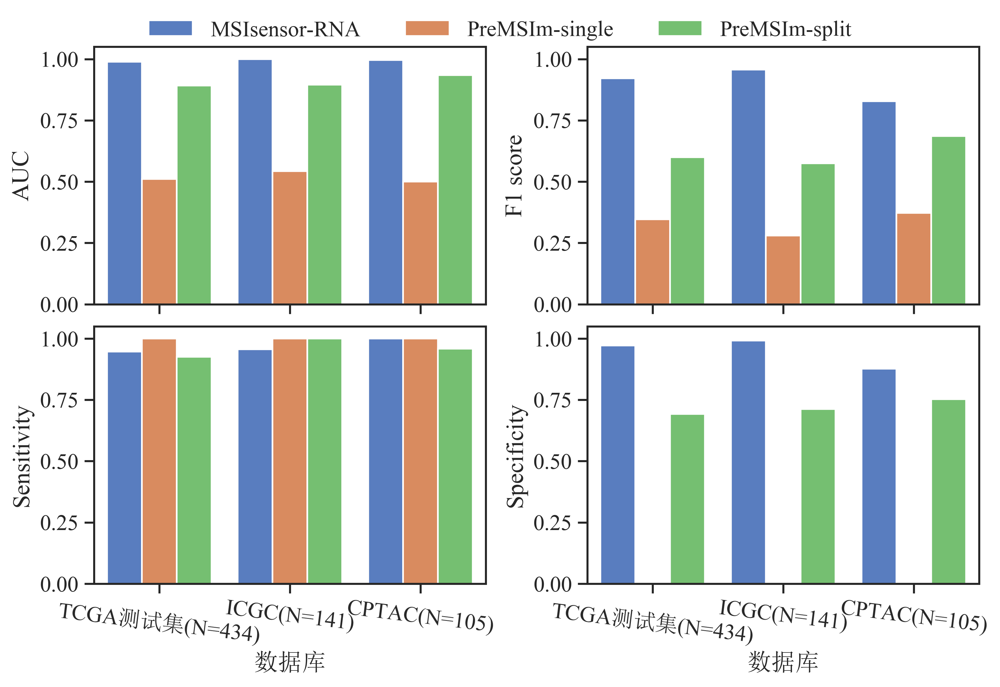

In [85]:
report = pd.read_csv("./result/result/compare/bulk.csv",index_col=0)
report = report[report["Method"] != "PreMSIm-all"]
fig, ax =plt.subplots(2,2,constrained_layout=True,figsize=(8.5,5.5),dpi=400)
# xlabels = []
# for name in database:
#     xlabels.append(name+"(N="+str(report[report["Database"] == "GSE13067"].Sample_num[0])+")")
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.25)
plt.subplot(2,2,1)
sub1 = sns.barplot(data=report, x="Database", y="AUC", hue="Method",palette="muted",order=["TCGA_test","ICGC","CPTAC"])
sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.legend_.remove()


plt.subplot(2,2,2)
sub1 = sns.barplot(data=report, x="Database", y="F1", hue="Method",palette="muted",order=["TCGA_test","ICGC","CPTAC"])
sub1.set_ylabel("F1 score")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.legend_.remove() 

plt.subplot(2,2,3)
sub1 = sns.barplot(data=report, x="Database", y="Recall", hue="Method",palette="muted",order=["TCGA_test","ICGC","CPTAC"])
sub1.set_ylabel("Sensitivity")
sub1.set_xlabel("数据库")
sub1.set_xticklabels(["TCGA测试集(N=434)","ICGC(N=141)","CPTAC(N=105)"],rotation=-7)
sub1.set_ylim(0,1.05)
sub1.legend_.remove()
 

plt.subplot(2,2,4)
sub1 = sns.barplot(data=report, x="Database", y="Specificity", hue="Method",palette="muted",order=["TCGA_test","ICGC","CPTAC"])
sub1.set_ylabel("Specificity")
sub1.set_xlabel("数据库")
sub1.set_xticklabels(["TCGA测试集(N=434)","ICGC(N=141)","CPTAC(N=105)"],rotation=-7)
sub1.set_ylim(0,1.05)
sub1.legend_.remove()

lines, labels = sub1.get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.5,1.065),ncol=4,frameon=False) 


fig.savefig("./result/result/compare/report_bulk.svg",bbox_inches='tight')

In [ ]:
# cancer report

In [913]:
indicator = pd.DataFrame(index=["Database","Sample_num","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/result/merge/bulk/"
i = 0
for name in os.listdir(path):
    merge = pd.read_csv(path+name,index_col=0)
    display(merge)
    break

,sample_num,database,cancer,y_true,y_score,y_pre,single_label,single_score,split_label,split_score,all_label,all_score
01CO001,105,CPTAC,CRC,0,4.184143,0.0,1,1,1,1.0,0,0.0
01CO005,105,CPTAC,CRC,0,0.334486,0.0,1,1,0,0.0,0,0.0
01CO006,105,CPTAC,CRC,0,3.688000,0.0,1,1,1,0.6,0,0.2
01CO008,105,CPTAC,CRC,0,3.592571,0.0,1,1,1,1.0,0,0.0
01CO013,105,CPTAC,CRC,0,0.492762,0.0,1,1,0,0.4,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
21CO007,105,CPTAC,CRC,0,1.768143,0.0,1,1,0,0.4,0,0.2
22CO004,105,CPTAC,CRC,0,0.879286,0.0,1,1,0,0.0,0,0.0
22CO006,105,CPTAC,CRC,1,11.014714,1.0,1,1,1,1.0,1,1.0
24CO005,105,CPTAC,CRC,0,9.296286,1.0,1,1,0,0.2,0,0.2


In [923]:
indicator = pd.DataFrame(index=["Database","cancer","Sample_num","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/result/merge/bulk/"
i = 0
for name in os.listdir(path):
    
    merge_all = pd.read_csv(path+name,index_col=0)
    print(name)
    
    for cancer in merge_all.cancer.unique():
        merge = merge_all[merge_all.cancer == cancer]
        res = []
        res.append(name.split(".")[0])
        res.append(cancer)
        res.append(merge.shape[0])
        res.append("MSIsensor-RNA")
        res+=metricCalculate(merge.y_true,merge.y_score,merge.y_pre)
        indicator[str(i)] = res
        i+=1

        res = []
        res.append(name.split(".")[0])
        res.append(cancer)
        res.append(merge.shape[0])
        res.append("PreMSIm-single")
        res+=metricCalculate(merge.y_true,merge.single_score,merge.single_label)
        indicator[str(i)] = res
        i+=1


        res = []
        res.append(name.split(".")[0])
        res.append(cancer)
        res.append(merge.shape[0])
        res.append("PreMSIm-split")
        res+=metricCalculate(merge.y_true,merge.split_score,merge.split_label)
        indicator[str(i)] = res
        i+=1

        res = []
        res.append(name.split(".")[0])
        res.append(cancer)
        res.append(merge.shape[0])
        res.append("PreMSIm-all")
        res+=metricCalculate(merge.y_true,merge.all_score,merge.all_label)
        indicator[str(i)] = res
        i+=1

indicator.T.to_csv("./result/result/compare/cancer_database_compare.csv")

CPTAC.res.merge.csv
ICGC.res.merge.csv
TCGA_test.res.merge.csv


In [927]:
indicator = pd.DataFrame(index=["Database","cancer","Sample_num","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/result/merge/bulk/"
i = 0
merge = pd.DataFrame()
for name in os.listdir(path):
    
    data = pd.read_csv(path+name,index_col=0)
    merge = merge.append(data)
merge_all = merge    
for cancer in merge_all.cancer.unique():
    merge = merge_all[merge_all.cancer == cancer]
    res = []
    res.append("All")
    res.append(cancer)
    res.append(merge.shape[0])
    res.append("MSIsensor-RNA")
    res+=metricCalculate(merge.y_true,merge.y_score,merge.y_pre)
    indicator[str(i)] = res
    i+=1

    res = []
    res.append("All")
    res.append(cancer)
    res.append(merge.shape[0])
    res.append("PreMSIm-single")
    res+=metricCalculate(merge.y_true,merge.single_score,merge.single_label)
    indicator[str(i)] = res
    i+=1


    res = []
    res.append("All")
    res.append(cancer)
    res.append(merge.shape[0])
    res.append("PreMSIm-split")
    res+=metricCalculate(merge.y_true,merge.split_score,merge.split_label)
    indicator[str(i)] = res
    i+=1

    res = []
    res.append("All")
    res.append(cancer)
    res.append(merge.shape[0])
    res.append("PreMSIm-all")
    res+=metricCalculate(merge.y_true,merge.all_score,merge.all_label)
    indicator[str(i)] = res
    i+=1

indicator.T.to_csv("./result/result/compare/cancer_compare.csv")

In [934]:
report

,Database,cancer,Sample_num,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
0,All,CRC,327,MSIsensor-RNA,0.995321,0.876923,0.951070,0.791667,0.982759,0.944238
1,All,CRC,327,PreMSIm-single,0.533457,0.301299,0.177370,0.177370,1.000000,0.000000
2,All,CRC,327,PreMSIm-split,0.937123,0.643275,0.813456,0.486726,0.948276,0.784387
4,All,UCEC,220,MSIsensor-RNA,0.978966,0.929134,0.959091,0.936508,0.921875,0.974359
5,All,UCEC,220,PreMSIm-single,0.490785,0.450704,0.290909,0.290909,1.000000,0.000000
6,All,UCEC,220,PreMSIm-split,0.860226,0.645833,0.690909,0.484375,0.968750,0.576923
8,All,STAD,143,MSIsensor-RNA,1.000000,0.947368,0.986014,0.900000,1.000000,0.984000
9,All,STAD,143,PreMSIm-single,0.520000,0.223602,0.125874,0.125874,1.000000,0.000000
10,All,STAD,143,PreMSIm-split,0.831556,0.422535,0.713287,0.283019,0.833333,0.696000


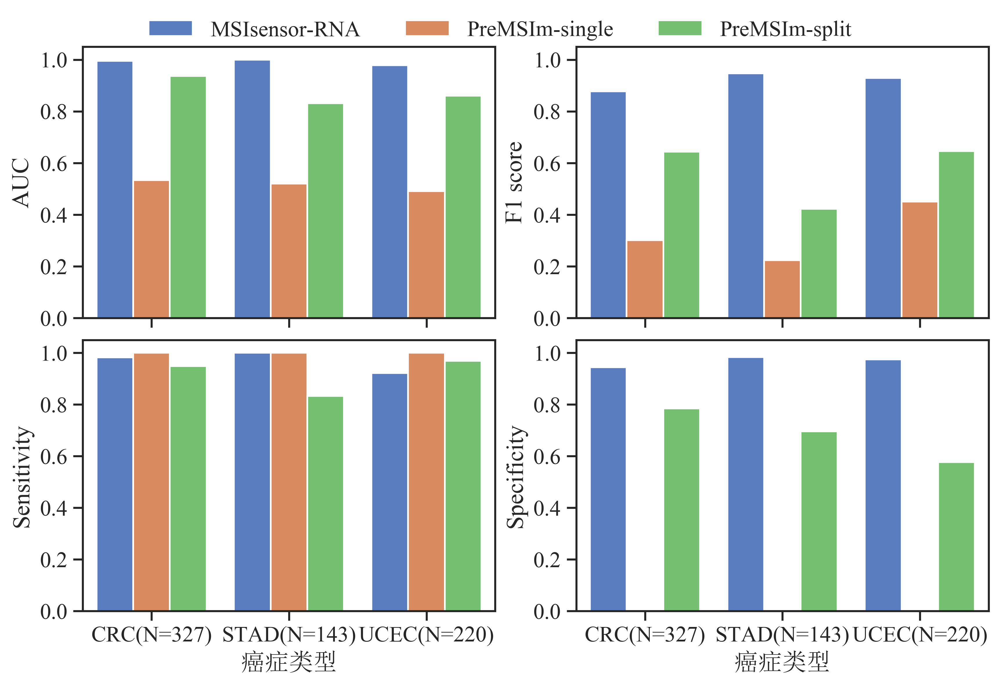

In [86]:
report = pd.read_csv("./result/result/compare/cancer_compare.csv",index_col=0)
report = report[report["Method"] != "PreMSIm-all"]
fig, ax =plt.subplots(2,2,constrained_layout=True,figsize=(8.5,5.5),dpi=400)
# xlabels = []
# for name in database:
#     xlabels.append(name+"(N="+str(report[report["Database"] == "GSE13067"].Sample_num[0])+")")
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.25)
plt.subplot(2,2,1)
sub1 = sns.barplot(data=report, x="cancer", y="AUC", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.legend_.remove()


plt.subplot(2,2,2)
sub1 = sns.barplot(data=report, x="cancer", y="F1", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
sub1.set_ylabel("F1 score")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.legend_.remove() 

plt.subplot(2,2,3)
sub1 = sns.barplot(data=report, x="cancer", y="Recall", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
sub1.set_ylabel("Sensitivity")
sub1.set_xlabel("癌症类型")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels(["CRC(N=327)","STAD(N=143)","UCEC(N=220)"])
sub1.legend_.remove()
 

plt.subplot(2,2,4)
sub1 = sns.barplot(data=report, x="cancer", y="Specificity", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
sub1.set_ylabel("Specificity")
sub1.set_xlabel("癌症类型")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels(["CRC(N=327)","STAD(N=143)","UCEC(N=220)"])
sub1.legend_.remove()

lines, labels = sub1.get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.5,1.065),ncol=4,frameon=False) 


fig.savefig("./result/result/compare/report_cancer.svg",bbox_inches='tight')

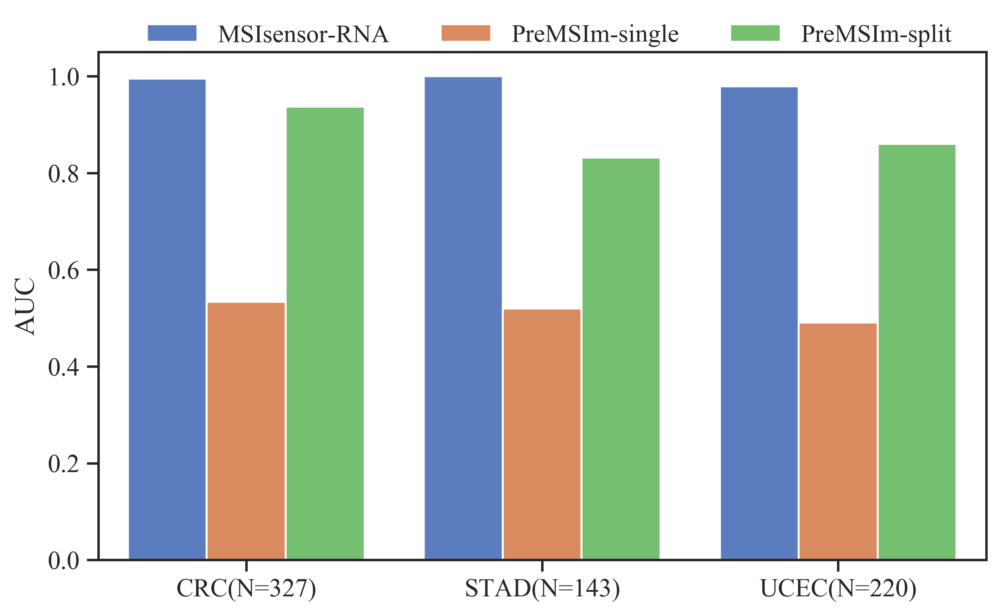

In [266]:
report = pd.read_csv("./result/result/compare/cancer_compare.csv",index_col=0)
report = report[report["Method"] != "PreMSIm-all"]
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7,4),dpi=400)
# xlabels = []
# for name in database:
#     xlabels.append(name+"(N="+str(report[report["Database"] == "GSE13067"].Sample_num[0])+")")
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc,font_scale=1.2)
plt.subplot(1,1,1)
sub1 = sns.barplot(data=report, x="cancer", y="AUC", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.set_xticklabels(["CRC(N=327)","STAD(N=143)","UCEC(N=220)"])
sub1.legend_.remove()


# plt.subplot(2,2,2)
# sub1 = sns.barplot(data=report, x="cancer", y="F1", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
# sub1.set_ylabel("F1 score")
# sub1.set_xlabel("")
# sub1.set_ylim(0,1.05)
# sub1.set_xticklabels("")
# sub1.legend_.remove() 

# plt.subplot(2,2,3)
# sub1 = sns.barplot(data=report, x="cancer", y="Recall", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
# sub1.set_ylabel("Sensitivity")
# sub1.set_xlabel("癌症类型")
# sub1.set_ylim(0,1.05)
# sub1.set_xticklabels(["CRC(N=327)","STAD(N=143)","UCEC(N=220)"])
# sub1.legend_.remove()
 

# plt.subplot(2,2,4)
# sub1 = sns.barplot(data=report, x="cancer", y="Specificity", hue="Method",palette="muted",order=["CRC","STAD","UCEC"])
# sub1.set_ylabel("Specificity")
# sub1.set_xlabel("癌症类型")
# sub1.set_ylim(0,1.05)
# sub1.set_xticklabels(["CRC(N=327)","STAD(N=143)","UCEC(N=220)"])
# sub1.legend_.remove()

lines, labels = sub1.get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.55,1.08),ncol=4,frameon=False,fontsize=13) 


fig.savefig("./result/report_cancer.PPT.svg",bbox_inches='tight')

In [ ]:
# microarray

In [730]:
def getPredictionResultMA(database,X_test,genes):
    res = pd.DataFrame(index=X_test.index)
    res["sample_num"] = X_test.shape[0]
    res["database"] = name.split(".")[0]
    res["cancer"] = X_test.TumorType
    y_true = pd.get_dummies(X_test["MSI"])["MSI-H"]
    res["y_true"] = y_true
    print(X_test.shape[0])
    
    miss_genes = set(genes) - set(X_test.columns)
    if miss_genes != set():
        print("missing genes:",miss_genes)
        for gene in miss_genes:
            X_test[gene] = 0
    
    X_test_scale = zcoreScaler(X_test[genes])
    y_score = model.predict(X_test_scale)
    res["y_score"] = y_score
    
    
    fpr, tpr, thresholds = roc_curve(y_true,y_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    cutoff = 5.06
#     print(cutoff)
    y_pre = y_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    res["y_pre"] = y_pre
    res.to_csv("./result/result/microarray/"+name.split(".csv")[0]+".res.csv")
    return res

In [731]:
path = "./data/microarray/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    res = getPredictionResultMA(name.split(".")[0],data,genes)
    print(name,roc_auc_score(res.y_true,res.y_score))

74
GSE13067.GPL570.csv 0.9985569985569986
155
GSE13294.GPL570.csv 0.9592074592074592
69
GSE13911.GPL570.csv 0.8705263157894738
53
GSE18088.GPL570.csv 0.9535603715170278
65
missing genes: {'RPL22L1'}
GSE24550.GPL5175.csv 0.9915966386554622
22
GSE27544.GPL13158.csv 0.9732142857142858
61
GSE35896.GPL570.csv 0.8678571428571428
19
GSE39084.GPL570.csv 1.0
536
GSE39582.GPL570.csv 0.94762753586283
297
GSE62254.GPL570.csv 0.8603809012875537
59
GSE75316.GPL570.csv 0.9943181818181818
58
GSE92921.GPL570.csv 0.9962264150943396


In [732]:
path = "./result/result/microarray/"
for name in os.listdir(path):
    res_MSIsensor = pd.read_csv(path+name,index_col=0)
    res_preMSIm = pd.read_csv("./R/result/microarray/"+name,index_col=0)
    merge = pd.merge(res_MSIsensor,res_preMSIm,left_index=True,right_on="sample")
    merge.index = list(merge["sample"])
    merge.drop(columns="sample",inplace=True)
#     merge = preMSI_cutoff(merge)
    merge.to_csv("./result/result/merge/ma/"+name.split(".res.csv")[0]+".res.merge.csv")
    print(name,merge.sample_num[0])
    print(roc_auc_score(merge.y_true,merge.y_score))
    print(roc_auc_score(merge.y_true,merge.single_score)
          ,roc_auc_score(merge.y_true,merge.split_score)
          ,roc_auc_score(merge.y_true,merge.all_score))

GSE13067.GPL570.res.csv 74
0.9985569985569986
0.8015873015873016 0.8888888888888888 0.9603174603174603
GSE13294.GPL570.res.csv 155
0.9592074592074592
0.8294205794205795 0.7736430236430236 0.9464701964701964
GSE13911.GPL570.res.csv 69
0.8705263157894738
0.8899999999999999 0.8973684210526315 0.9042105263157896
GSE18088.GPL570.res.csv 53
0.9535603715170278
0.5 0.9458204334365324 0.9651702786377708
GSE24550.GPL5175.res.csv 65
0.9915966386554622
0.7941176470588236 0.8431372549019608 0.9117647058823529
GSE27544.GPL13158.res.csv 22
0.9732142857142858
0.75 0.6696428571428572 0.9375
GSE35896.GPL570.res.csv 61
0.8678571428571428
0.9357142857142857 0.7446428571428572 0.9750000000000001
GSE39084.GPL570.res.csv 19
1.0
1.0 0.96875 1.0
GSE39582.GPL570.res.csv 536
0.94762753586283
0.9139292080468551 0.7224202812438106 0.9414877061935885
GSE62254.GPL570.res.csv 297
0.8603809012875537
0.5 0.818535407725322 0.887976126609442
GSE75316.GPL570.res.csv 59
0.9943181818181818
0.9053030303030303 0.9270833333333

In [943]:
path = "./result/result/merge/ma/"
i = 0
for name in os.listdir(path):
    merge = pd.read_csv(path+name,index_col=0)
    display(merge)
    break

,sample_num,database,cancer,y_true,y_score,y_pre,single_label,single_score,split_label,split_score,all_label,all_score
GSM327282,74,GSE13067,CRC,1,14.014857,1.0,1,1.0,1,1.0,1,1.0
GSM327283,74,GSE13067,CRC,0,4.904714,0.0,1,1.0,1,1.0,1,0.6
GSM327284,74,GSE13067,CRC,0,4.610571,0.0,1,1.0,0,0.2,0,0.0
GSM327285,74,GSE13067,CRC,0,0.343286,0.0,1,0.8,0,0.0,0,0.0
GSM327286,74,GSE13067,CRC,0,3.343000,0.0,1,1.0,0,0.4,0,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...
GSM327351,74,GSE13067,CRC,0,2.507500,0.0,1,1.0,1,1.0,1,0.6
GSM327352,74,GSE13067,CRC,1,13.913714,1.0,1,1.0,1,1.0,1,1.0
GSM327353,74,GSE13067,CRC,1,15.580857,1.0,1,1.0,1,1.0,1,1.0
GSM327354,74,GSE13067,CRC,0,1.214143,0.0,1,1.0,0,0.0,0,0.2


In [944]:
indicator = pd.DataFrame(index=["Database","Sample_num","Cancer","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/result/merge/ma/"
i = 0
for name in os.listdir(path):
    merge = pd.read_csv(path+name,index_col=0)
    print(name)
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append(merge.cancer[0])
    res.append("MSIsensor-RNA")
    res+=metricCalculate(merge.y_true,merge.y_score,merge.y_pre)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append(merge.cancer[0])
    res.append("PreMSIm-single")
    res+=metricCalculate(merge.y_true,merge.single_score,merge.single_label)
    indicator[str(i)] = res
    i+=1
    
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append(merge.cancer[0])
    res.append("PreMSIm-split")
    res+=metricCalculate(merge.y_true,merge.split_score,merge.split_label)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append(merge.cancer[0])
    res.append("PreMSIm-all")
    res+=metricCalculate(merge.y_true,merge.all_score,merge.all_label)
    indicator[str(i)] = res
    i+=1

indicator.T.to_csv("./result/result/compare/microarray.csv")

GSE13067.GPL570.res.merge.csv
GSE13294.GPL570.res.merge.csv
GSE13911.GPL570.res.merge.csv
GSE18088.GPL570.res.merge.csv
GSE24550.GPL5175.res.merge.csv
GSE27544.GPL13158.res.merge.csv
GSE35896.GPL570.res.merge.csv
GSE39084.GPL570.res.merge.csv
GSE39582.GPL570.res.merge.csv
GSE62254.GPL570.res.merge.csv
GSE75316.GPL570.res.merge.csv
GSE92921.GPL570.res.merge.csv


In [206]:
report = pd.read_csv("./result/result/compare/microarray.csv",index_col=0)

report = report[report["Method"] != "PreMSIm-all"]

In [207]:
for method in report.Method.unique():
    data = report[report["Method"]==method]
    display(data)
    print(data.AUC.mean(),2*data.AUC.std())

,Database,Sample_num,Cancer,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
0,GSE13067,74,CRC,MSIsensor-RNA,0.998557,0.846154,0.945946,0.733333,1.000000,0.936508
4,GSE13294,155,CRC,MSIsensor-RNA,0.959207,0.922078,0.922581,0.934211,0.910256,0.935065
8,GSE13911,69,STAD,MSIsensor-RNA,0.870526,0.742857,0.869565,0.812500,0.684211,0.940000
12,GSE18088,53,CRC,MSIsensor-RNA,0.953560,0.923077,0.943396,0.900000,0.947368,0.941176
16,GSE24550,65,CRC,MSIsensor-RNA,0.991597,0.857143,0.938462,0.857143,0.857143,0.960784
20,GSE27544,22,CRC,MSIsensor-RNA,0.973214,0.888889,0.909091,0.800000,1.000000,0.857143
24,GSE35896,61,CRC,MSIsensor-RNA,0.867857,0.400000,0.852459,0.300000,0.600000,0.875000
28,GSE39084,19,CRC,MSIsensor-RNA,1.000000,0.857143,0.789474,1.000000,0.750000,1.000000
32,GSE39582,536,CRC,MSIsensor-RNA,0.947628,0.728571,0.929104,0.809524,0.662338,0.973856
36,GSE62254,297,STAD,MSIsensor-RNA,0.860381,0.732824,0.882155,0.716418,0.750000,0.918455


0.9510893538633963 0.1085639959733598


,Database,Sample_num,Cancer,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
1,GSE13067,74,CRC,PreMSIm-single,0.801587,0.261905,0.162162,0.150685,1.000000,0.015873
5,GSE13294,155,CRC,PreMSIm-single,0.829421,0.675676,0.535484,0.520833,0.961538,0.103896
9,GSE13911,69,STAD,PreMSIm-single,0.890000,0.666667,0.753623,0.531250,0.894737,0.700000
13,GSE18088,53,CRC,PreMSIm-single,0.500000,0.527778,0.358491,0.358491,1.000000,0.000000
17,GSE24550,65,CRC,PreMSIm-single,0.794118,0.368421,0.261538,0.225806,1.000000,0.058824
21,GSE27544,22,CRC,PreMSIm-single,0.750000,0.533333,0.363636,0.363636,1.000000,0.000000
25,GSE35896,61,CRC,PreMSIm-single,0.935714,0.232558,0.459016,0.131579,1.000000,0.410714
29,GSE39084,19,CRC,PreMSIm-single,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
33,GSE39582,536,CRC,PreMSIm-single,0.913929,0.298450,0.324627,0.175399,1.000000,0.211329
37,GSE62254,297,STAD,PreMSIm-single,0.500000,0.354571,0.215488,0.215488,1.000000,0.000000


0.8134651238410949 0.3257655918320677


,Database,Sample_num,Cancer,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
2,GSE13067,74,CRC,PreMSIm-split,0.888889,0.468085,0.662162,0.305556,1.000000,0.603175
6,GSE13294,155,CRC,PreMSIm-split,0.773643,0.745342,0.735484,0.722892,0.769231,0.701299
10,GSE13911,69,STAD,PreMSIm-split,0.897368,0.708333,0.797101,0.586207,0.894737,0.760000
14,GSE18088,53,CRC,PreMSIm-split,0.945820,0.878049,0.905660,0.818182,0.947368,0.882353
18,GSE24550,65,CRC,PreMSIm-split,0.843137,0.622222,0.738462,0.451613,1.000000,0.666667
22,GSE27544,22,CRC,PreMSIm-split,0.669643,0.588235,0.681818,0.555556,0.625000,0.714286
26,GSE35896,61,CRC,PreMSIm-split,0.744643,0.303030,0.622951,0.178571,1.000000,0.589286
30,GSE39084,19,CRC,PreMSIm-split,0.968750,0.857143,0.789474,1.000000,0.750000,1.000000
34,GSE39582,536,CRC,PreMSIm-split,0.722420,0.345404,0.561567,0.219858,0.805195,0.520697
38,GSE62254,297,STAD,PreMSIm-split,0.818535,0.560386,0.693603,0.405594,0.906250,0.635193


0.8331704971715324 0.18978211557043229


In [208]:
report = report.sort_values(by=["Cancer","Database"])

In [209]:
report

,Database,Sample_num,Cancer,Method,AUC,F1,Accuracy,Precision,Recall,Specificity
0,GSE13067,74,CRC,MSIsensor-RNA,0.998557,0.846154,0.945946,0.733333,1.000000,0.936508
1,GSE13067,74,CRC,PreMSIm-single,0.801587,0.261905,0.162162,0.150685,1.000000,0.015873
2,GSE13067,74,CRC,PreMSIm-split,0.888889,0.468085,0.662162,0.305556,1.000000,0.603175
4,GSE13294,155,CRC,MSIsensor-RNA,0.959207,0.922078,0.922581,0.934211,0.910256,0.935065
5,GSE13294,155,CRC,PreMSIm-single,0.829421,0.675676,0.535484,0.520833,0.961538,0.103896
6,GSE13294,155,CRC,PreMSIm-split,0.773643,0.745342,0.735484,0.722892,0.769231,0.701299
12,GSE18088,53,CRC,MSIsensor-RNA,0.953560,0.923077,0.943396,0.900000,0.947368,0.941176
13,GSE18088,53,CRC,PreMSIm-single,0.500000,0.527778,0.358491,0.358491,1.000000,0.000000
14,GSE18088,53,CRC,PreMSIm-split,0.945820,0.878049,0.905660,0.818182,0.947368,0.882353
16,GSE24550,65,CRC,MSIsensor-RNA,0.991597,0.857143,0.938462,0.857143,0.857143,0.960784


In [210]:
for method in report.Method.unique():
    data = report[report["Method"]==method]
#     display(data)
    print(method)
    for cancer in data.Cancer.unique():
        data_can = data[data["Cancer"] == cancer]
        print(cancer,data_can.AUC.mean(),2*data_can.AUC.std())

MSIsensor-RNA
CRC 0.9682165029283727 0.08099401771143819
STAD 0.8654536085385138 0.014347782784512056
PreMSIm-single
CRC 0.837158148609314 0.2844935397818542
STAD 0.695 0.5515432893255069
PreMSIm-split
CRC 0.8282142137280433 0.2049023990902395
STAD 0.8579519143889767 0.11148671661022008


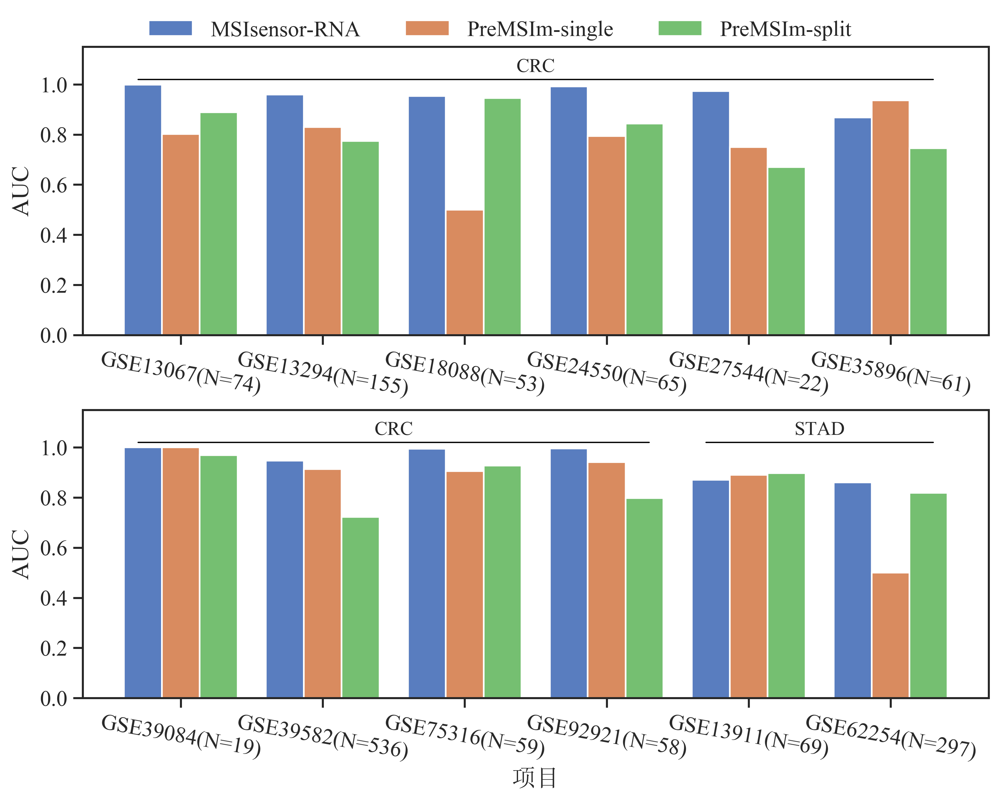

In [212]:
fig, ax =plt.subplots(2,1,constrained_layout=True,figsize=(8.5,6.5),dpi=400)

database = list(report.Database.unique())
xlabels = []
for name in database:
    xlabels.append(name+"(N="+str(list(report[report["Database"] == name].Sample_num)[0])+")")
    

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc,font_scale=1.25)
plt.subplot(2,1,1)
sub1 = sns.barplot(data=report, x="Database", y="AUC", hue="Method",palette="muted",order=list(report.Database.unique())[:6])
sub1.set_ylim(0,1.15)
plt.plot([-0.3,5.3],[1.02,1.02],color="black",linewidth=0.8)
plt.text(2.5,1.05, r"CRC", ha="center",fontdict=fontdict)


sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_xticklabels(xlabels[:6],rotation=-10)
sub1.legend_.remove()


plt.subplot(2,1,2)
sub1 = sns.barplot(data=report, x="Database", y="AUC", hue="Method",palette="muted",order=list(report.Database.unique())[6:])
sub1.set_ylabel("AUC")
sub1.set_xlabel("项目")
sub1.set_xticklabels(xlabels[6:],rotation=-10)

sub1.legend_.remove() 
sub1.set_ylim(0,1.15)
plt.plot([-0.3,3.3],[1.02,1.02],color="black",linewidth=0.8)
plt.text(1.5,1.05, r"CRC", ha="center",fontdict=fontdict)

plt.plot([3.7,5.3],[1.02,1.02],color="black",linewidth=0.8)
plt.text(4.5,1.05, r"STAD", ha="center",fontdict=fontdict)


lines, labels = sub1.get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.5,1.055),ncol=4,frameon=False) 


fig.savefig("./result/result/compare/report_ma.svg",bbox_inches='tight')

In [ ]:
# 不同标准化格式

In [187]:
# 单细胞
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))
TCGA = TCGA[genes].applymap(lambda x:np.log2(x+1))
ICGC = ICGC[genes].applymap(lambda x:np.log2(x+1))
CPTAC = CPTAC[genes].applymap(lambda x:np.log2(x+1))

In [188]:
path = "./data/bulk/counts/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    data[genes].T.applymap(lambda x:np.log2(x+1)).to_csv("./R/Data/bulk/counts/"+name,sep="\t")
    

In [189]:
path = "./data/bulk/FPKM/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    data[genes].T.applymap(lambda x:np.log2(x+1)).to_csv("./R/Data/bulk/FPKM/"+name,sep="\t")

In [190]:
path = "./data/bulk/FPKM_UQ/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    data[genes].T.applymap(lambda x:np.log2(x+1)).to_csv("./R/Data/bulk/FPKM_UQ/"+name,sep="\t")

In [191]:
path = "./data/bulk/TPM/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    data[genes].T.applymap(lambda x:np.log2(x+1)).to_csv("./R/Data/bulk/TPM/"+name,sep="\t")

In [753]:
def getPredictionResult(database,X_test,genes):
    res = pd.DataFrame(index=X_test.index)
    res["sample_num"] = X_test.shape[0]
    res["database"] = database
    res["cancer"] = X_test.tumor
    y_true = pd.get_dummies(X_test["msi"])["MSI-H"]
    res["y_true"] = y_true
    
    X_test_scale = zcoreScaler(X_test[genes])
    y_score = model.predict(X_test_scale)
    res["y_score"] = y_score
    
    
    fpr, tpr, thresholds = roc_curve(y_true,y_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    cutoff = 5.06
    y_pre = y_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    res["y_pre"] = y_pre
    res.to_csv("./result/result/norm/"+database+".res.csv")
    return res

In [154]:
def preMSI_cutoff(merge):
    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.single_score)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    y_pre = merge.single_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    
    merge["single_label"] = y_pre
    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.split_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    y_pre = merge.split_score.copy()
    
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    merge["split_label"] = y_pre
    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.all_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    y_pre = merge.all_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    merge["all_label"] = y_pre
    
    return merge

In [158]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support
def metricCalculate(y_true,y_score,y_pre):
    auc = roc_auc_score(y_true,y_score)
    tn, fp, fn, tp = confusion_matrix(y_true,y_pre).ravel()
    accuracy = (tp+tn)/(tn+fp+fn+tp)
#     precision = tp/(tp+fp)
#     recall = tp/(tp+fn)
    specificity = tn/(tn+fp)
#     f1 = 2*precision*recall/(precision+recall)
    precision,recall,f1,_ = precision_recall_fscore_support(y_true,y_pre,average="binary")
    return auc,f1,accuracy,precision,recall,specificity

In [148]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
gene_sort = gene_sort[:-1]
genes = gene_sort[:14]

In [ ]:
FPKM = pd.read_csv("./data/bulk/FPKM/TCGA.csv",index_col=0).applymap(lambda x:np.log2(x+1) if type(x)!=str else x)

In [754]:
res_FPKM = getPredictionResult("TCGA_FPKM",FPKM,genes)

In [ ]:
TCGA_FPKM_UQ = pd.read_csv("./data/bulk/FPKM_UQ/TCGA.csv",index_col=0).applymap(lambda x:np.log2(x+1) if type(x)!=str else x)

In [755]:
res_FPKM_UQ = getPredictionResult("TCGA_FPKM_UQ",TCGA_FPKM_UQ,genes)

In [ ]:
TCGA_counts = pd.read_csv("./data/bulk/counts/TCGA.csv",index_col=0).applymap(lambda x:np.log2(x+1) if type(x)!=str else x)

In [756]:
res_counts = getPredictionResult("TCGA_counts",TCGA_counts,genes)

In [ ]:
TCGA_TPM = pd.read_csv("./data/bulk/TPM/TCGA.csv",index_col=0).applymap(lambda x:np.log2(x+1) if type(x)!=str else x)

In [757]:
res_TPM = getPredictionResult("TCGA_TPM",TCGA_TPM,genes)

In [758]:
path = "./result/result/norm/"
for name in os.listdir(path):
    if name == "merge":
        continue
    res_MSIsensor = pd.read_csv(path+name,index_col=0)
    res_preMSIm = pd.read_csv("./R/result/bulk/norm/"+name,index_col=0)
    merge = pd.merge(res_MSIsensor,res_preMSIm,left_index=True,right_on="sample")
    merge.index = list(merge["sample"])
    merge.drop(columns="sample",inplace=True)
#     merge = preMSI_cutoff(merge)
    merge.to_csv("./result/result/norm/merge/"+name.split(".res.csv")[0]+".res.merge.csv")
    print(name,merge.sample_num[0])
    print(roc_auc_score(merge.y_true,merge.y_score))
    print(roc_auc_score(merge.y_true,merge.single_score)
          ,roc_auc_score(merge.y_true,merge.split_score)
          ,roc_auc_score(merge.y_true,merge.all_score))

TCGA_counts.res.csv 1428
0.9539651803371315
0.9291276250117713 0.8523931161126284 0.9217528722101893
TCGA_FPKM.res.csv 1428
0.9978193568132593
0.5171449759864395 0.8733873246068368 0.8774925840474621
TCGA_FPKM_UQ.res.csv 1428
0.9978723279028158
0.5158383557773802 0.8893742937188058 0.9199856978058198
TCGA_TPM.res.csv 1428
0.9960036255767963
0.5022306714379885 0.8532715533477728 0.921917671155476


In [760]:
indicator = pd.DataFrame(index=["Database","Sample_num","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/result/norm/merge/"
i = 0
for name in os.listdir(path):
    if name == "论文.xlsx":
        continue
    merge = pd.read_csv(path+name,index_col=0)
    print(name)
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("MSIsensor-RNA")
    res+=metricCalculate(merge.y_true,merge.y_score,merge.y_pre)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("PreMSIm-single")
    res+=metricCalculate(merge.y_true,merge.single_score,merge.single_label)
    indicator[str(i)] = res
    i+=1
    
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("PreMSIm-split")
    res+=metricCalculate(merge.y_true,merge.split_score,merge.split_label)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.sample_num[0])
    res.append("PreMSIm-all")
    res+=metricCalculate(merge.y_true,merge.all_score,merge.all_label)
    indicator[str(i)] = res
    i+=1

indicator.T.to_csv("./result/result/norm/merge/norm_compare.csv")

TCGA_counts.res.merge.csv
TCGA_FPKM.res.merge.csv
TCGA_FPKM_UQ.res.merge.csv
TCGA_TPM.res.merge.csv


In [761]:
report = pd.read_csv("./result/result/norm/merge/norm_compare.csv",index_col=0)

report = report[report["Method"] != "PreMSIm-all"]

In [764]:
for method in report.Method.unique():
    data = report[report["Method"]==method]
#     display(data)
    print(method)
    print("AUC",data.AUC.mean(),2*data.AUC.std())
    print("f1",data.F1.mean(),2*data.F1.std())
    print("Accuracy",data.Accuracy.mean(),2*data.Accuracy.std())
    print("Precision",data.Precision.mean(),2*data.Precision.std())
    print("Recall",data.Recall.mean(),2*data.Recall.std())
    print("Specificity",data.Specificity.mean(),2*data.Specificity.std())

MSIsensor-RNA
AUC 0.9864151226575008 0.043301458844420264
f1 0.9279296103991614 0.13440222020045633
Accuracy 0.9716066481994459 0.05088967609660334
Precision 0.9464270036303934 0.08275761601490939
Recall 0.9113175675675675 0.1806616596206249
Specificity 0.9871515679442509 0.017844745136828714
PreMSIm-single
AUC 0.6160854070533949 0.4176074891340025
f1 0.44829410691479654 0.43225688742930124
Accuracy 0.38140581717451527 0.7056786703601109
Precision 0.3557691324835686 0.6031319315963243
Recall 0.9349662162162162 0.26013513513513514
Specificity 0.2386759581881533 0.9547038327526133
PreMSIm-split
AUC 0.867106571946511 0.03546252123226377
f1 0.5826857751833877 0.02232727030085691
Accuracy 0.7214335180055402 0.0193038225273772
Precision 0.4205232130029402 0.01904585417764208
Recall 0.9484797297297298 0.021632176477813507
Specificity 0.6628919860627178 0.018817481702694164


In [ ]:
# singlecell

In [215]:
data = pd.read_csv("../2023GraduationProject/Data/SingleCell/GSE132465_GEO_processed_CRC_10X_natural_log_TPM_matrix.txt",index_col=0,sep="\t",usecols=[0,1,2])
# 微阵列
ma = pd.read_csv("../2023GraduationProject/Data/Microarray/GSE13067.GPL570.csv",index_col=0)
# bulk
TCGA = pd.read_csv("../2023GraduationProject/Data/new/FPKM/TCGA.csv",index_col=0)
CPTAC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/CPTAC.csv",index_col=0)
ICGC = pd.read_csv("../2023GraduationProject/Data/new/FPKM/ICGC.csv",index_col=0)
# bulk、微阵列、单细胞基因交集
genes = set.intersection(set(ICGC.columns[2:]),set(list(data.index)),set(ma.columns))
# RANDOM_STATE = 42
RANDOM_STATE = 0
features = TCGA[genes].applymap(lambda x:np.log2(x+1))
# target = TCGA["msi"]
target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
_, _, _, y_true = train_test_split(features, pd.get_dummies(TCGA.msi)["MSI-H"], test_size=0.30, random_state=RANDOM_STATE)

In [258]:
genes = genes - set(['KLHDC7B', 'DOHH', 'REC114', 'TRIM49C', 'TENM4', 'ABHD17C', 'COLGALT1', 'C16orf82', 'LRRC29', 'PARPBP', 'GPX1', 'MCEMP1', 'C2orf83', 'HYKK', 'LINC00672', 'PINX1', 'COA4', 'CNEP1R1', 'LMNTD1', 'HCAR1', 'MTERF2', 'ADM5', 'N4BP3', 'OGFOD3', 'FAM214A', 'GDPGP1', 'HCAR3', 'CCAR2', 'FAM222B', 'EMC6', 'SCUBE3', 'SRGAP2B', 'TOX2', 'PET100', 'SLIRP', 'KNOP1', 'COA3', 'CEP128', 'TTI2', 'IFT43', 'C5AR2', 'CT45A5', 'ISM1', 'CDHR2', 'TFAP2D', 'ERVH48-1', 'CEP83', 'SRGAP2C', 'TEN1-CDK3'])

In [336]:
sc = pd.read_csv("D:/MSI2023/singlecellCRC/GSE178341/data_matrix/C103_T.matrix.csv",index_col=0,nrows=1)

In [341]:
en2gene = pd.read_csv("D:/MSI2023/singlecellCRC/GSE178341/cell_info/ENSEMBL2SYMBOL.txt",sep="\t",index_col=0)

In [344]:
path = "D:/MSI2023/singlecellCRC/GSE178341/data_matrix/"
for name in os.listdir("../2023GraduationProject/Data/SingleCellFull/GSE178341_261/"):
    print(name)
    name = name.split(".symbol")[0] + name.split(".symbol")[1]
    data = pd.read_csv(path+name,index_col=0)
    data.columns = list(en2gene.gene)
    data = data.drop_duplicates()[genes]
    
    data.to_csv("./data/singlecell/"+name)

C103_T.matrix.symbol.csv
C104_T.matrix.symbol.csv
C105_T.matrix.symbol.csv
C106_N.matrix.symbol.csv
C106_T.matrix.symbol.csv
C107_N.matrix.symbol.csv
C107_T.matrix.symbol.csv
C109_N.matrix.symbol.csv
C109_T.matrix.symbol.csv
C110_N.matrix.symbol.csv
C110_T.matrix.symbol.csv
C111_N.matrix.symbol.csv
C111_T.matrix.symbol.csv
C112_N.matrix.symbol.csv
C112_T.matrix.symbol.csv
C113_N.matrix.symbol.csv
C113_T.matrix.symbol.csv
C114_N.matrix.symbol.csv
C114_T.matrix.symbol.csv
C115_N.matrix.symbol.csv
C115_T.matrix.symbol.csv
C116_N.matrix.symbol.csv
C116_T.matrix.symbol.csv
C118_T.matrix.symbol.csv
C119_N.matrix.symbol.csv
C119_T.matrix.symbol.csv
C122_N.matrix.symbol.csv
C122_T.matrix.symbol.csv
C123_N.matrix.symbol.csv
C123_T.matrix.symbol.csv
C124_N.matrix.symbol.csv
C124_T.matrix.symbol.csv
C125_N.matrix.symbol.csv
C125_T.matrix.symbol.csv
C126_N.matrix.symbol.csv
C126_T.matrix.symbol.csv
C129_N.matrix.symbol.csv
C129_T.matrix.symbol.csv
C130_N.matrix.symbol.csv
C130_TA.matrix.symbol.csv

In [210]:
# 缺省值统计
drop_out = pd.DataFrame(columns=["ratio"])
path = "./data/singlecell/GSE178341/"
for name in os.listdir(path):
    print(name)
    data = pd.read_csv(path+name,index_col=0)
    data.fillna(0,inplace=True)
    ratios = []
    for index, row in data.iterrows():
        ratios.append(sum(row==0)/data.shape[1])
    count = pd.DataFrame(index=data.index)
    count["ratio"] = ratios
    drop_out = drop_out.append(count)

C103_T.matrix.csv
C104_T.matrix.csv
C105_T.matrix.csv
C106_N.matrix.csv
C106_T.matrix.csv
C107_N.matrix.csv
C107_T.matrix.csv
C109_N.matrix.csv
C109_T.matrix.csv
C110_N.matrix.csv
C110_T.matrix.csv
C111_N.matrix.csv
C111_T.matrix.csv
C112_N.matrix.csv
C112_T.matrix.csv
C113_N.matrix.csv
C113_T.matrix.csv
C114_N.matrix.csv
C114_T.matrix.csv
C115_N.matrix.csv
C115_T.matrix.csv
C116_N.matrix.csv
C116_T.matrix.csv
C118_T.matrix.csv
C119_N.matrix.csv
C119_T.matrix.csv
C122_N.matrix.csv
C122_T.matrix.csv
C123_N.matrix.csv
C123_T.matrix.csv
C124_N.matrix.csv
C124_T.matrix.csv
C125_N.matrix.csv
C125_T.matrix.csv
C126_N.matrix.csv
C126_T.matrix.csv
C129_N.matrix.csv
C129_T.matrix.csv
C130_N.matrix.csv
C130_TA.matrix.csv
C130_TB.matrix.csv
C132_N.matrix.csv
C132_T.matrix.csv
C133_N.matrix.csv
C133_T.matrix.csv
C134_N.matrix.csv
C134_T.matrix.csv
C135_N.matrix.csv
C135_T.matrix.csv
C136_N.matrix.csv
C136_T.matrix.csv
C137_N.matrix.csv
C137_T.matrix.csv
C138_N.matrix.csv
C138_T.matrix.csv
C139_N.m

In [211]:
drop_out.to_csv("./data/singlecell/GSE178341_droupout_cout.csv")

In [91]:
GSE178341_drop = pd.read_csv("./data/singlecell/GSE178341_droupout_cout.csv",index_col=0)

GSE178341_drop["database"] = "GSE178341"

GSE132465_drop = pd.read_csv("./data/singlecell/GSE132465_droupout_cout.csv",index_col=0)

GSE132465_drop["database"] = "GSE132465"

GSE200997_drop = pd.read_csv("./data/singlecell/GSE200997_droupout_cout.csv",index_col=0)

GSE200997_drop["database"] = "GSE200997"

In [92]:
GSE178341_drop.index.str.contains("C103_T")

array([ True,  True,  True, ..., False, False, False])

In [94]:
info_GSE178341 = pd.read_csv("./data/singlecell/GSE178341_sample_info.csv",index_col=0)
info_GSE200997 = pd.read_csv("./data/singlecell/GSE200997_sample_info.csv",index_col=0)
info_GSE132465 = pd.read_csv("./data/singlecell/GSE132465_sample_info.csv",index_col=0)

In [95]:
res = []
for name in info_GSE178341.index:
    res.append(GSE178341_drop.loc[GSE178341_drop.index.str.contains(name),:].mean()[0])

GSE178341_mean = pd.DataFrame(index=info_GSE178341.index)
GSE178341_mean["ratio"] = res 
GSE178341_mean["database"] = "GSE178341"

In [96]:
res = []
for name in info_GSE132465.index:
    res.append(GSE132465_drop.loc[GSE132465_drop.index.str.contains(name),:].mean()[0])

GSE132465_mean = pd.DataFrame(index=info_GSE132465.index)
GSE132465_mean["ratio"] = res 
GSE132465_mean["database"] = "GSE132465"

In [97]:
res = []
for name in info_GSE200997.index:
    res.append(GSE200997_drop.loc[GSE200997_drop.index.str.contains(name),:].mean()[0])

GSE200997_mean = pd.DataFrame(index=info_GSE200997.index)
GSE200997_mean["ratio"] = res 
GSE200997_mean["database"] = "GSE200997"

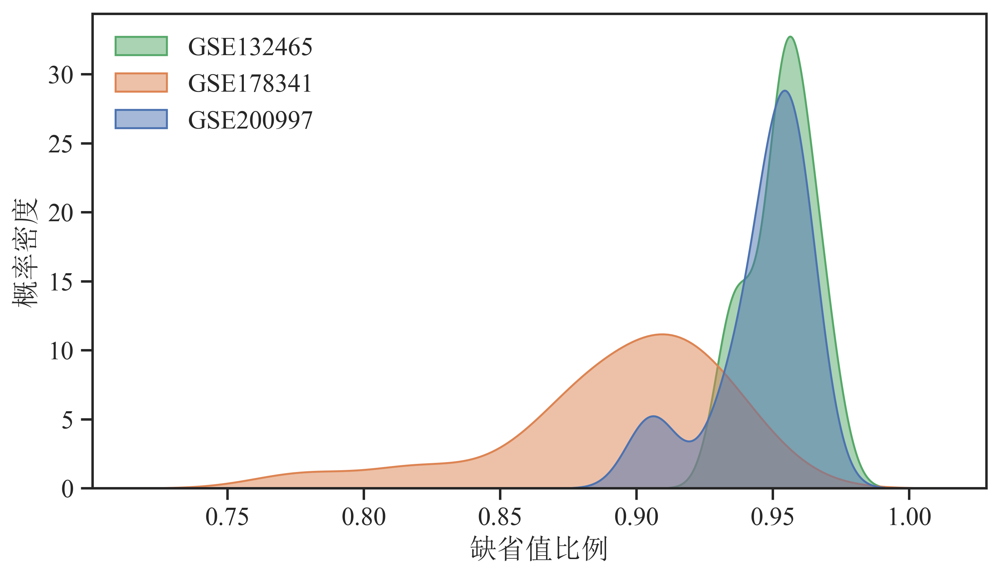

In [104]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7,4),dpi=400)

data = GSE178341_mean.append(GSE132465_mean).append(GSE200997_mean)   

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc,font_scale=1.2)

sub = sns.kdeplot(data=data, x="ratio",fill=True,common_norm=False,hue="database",hue_order=["GSE132465","GSE178341","GSE200997"]
   ,alpha=0.5, linewidth=1)

plt.legend(["GSE132465","GSE178341","GSE200997"],frameon=False,loc = 'upper left',ncol=1)

sub.set_ylabel("概率密度")
sub.set_xlabel("缺省值比例")
plt.savefig("./result/single_cell/drop_out_ratio.svg",bbox_inches='tight')

In [ ]:
# 直接用原来的模型

In [ ]:
# 缺省值填充方法对比

In [282]:
from sklearn.impute import SimpleImputer,KNNImputer
imputers = [SimpleImputer( strategy='constant',missing_values=0,fill_value=0,keep_empty_features=True),
            SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True), 
            SimpleImputer(strategy='median',missing_values=0,keep_empty_features=True),
            SimpleImputer(strategy='most_frequent',missing_values=0,keep_empty_features=True),
            KNNImputer(n_neighbors=5,missing_values=0,keep_empty_features=True)
           ]
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
genes = gene_sort[:14]

target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
model = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
X_train_scale = zcoreScaler(X_train[genes])
model.fit(X_train_scale,y_train)

data = setDropout(X_test,genes,0.8)

impute_compare = pd.DataFrame(index=["explained_variance","pearson","AUC"])

method = ["zero","mean","median","most_frequent","knn"]



for i in range(len(imputers)):
    res = []
    imputer = imputers[i]
    data_impute = imputer.fit_transform(data)
    data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
    X_test_scale = zcoreScaler(data_impute)
    y_pre = model.predict(X_test_scale)
    res.append(explained_variance_score(y_test,y_pre))
    res.append(pearsonr(y_test,y_pre)[0])   
    res.append(roc_auc_score(y_true,y_pre))
    impute_compare[method[i]] =  res
display(impute_compare)

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,zero,mean,median,most_frequent,knn
explained_variance,-0.135572,0.409003,0.378453,-0.021325,0.455958
pearson,0.113539,0.717718,0.706576,0.250230,0.714426
AUC,0.575254,0.934939,0.907473,0.652606,0.920387


In [284]:
impute_compare.to_csv("./result/single_cell/impute_compare.csv")

In [261]:
from scipy.stats import pearsonr,spearmanr
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
genes = gene_sort[:14]
num = len(genes)
ratios = [0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8]
indicator = pd.DataFrame(index=["explained_variance","pearson","AUC","cutoff"])

target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
model_reg = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
X_train_scale = zcoreScaler(X_train[genes])
model_reg.fit(X_train_scale,y_train)

imputer = SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True)
for ratio in ratios:  
    print(ratio)
    res = []
    data = setDropout(X_test,genes,ratio)
    data_impute = imputer.fit_transform(data)
    data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
    data_scale = zcoreScaler(data_impute)
#     print(model_reg.predict(data_scale))
    fpr, tpr, thresholds = roc_curve(y_true,model_reg.predict(data_scale),drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    display(model_reg.predict(data_scale))
    res.append(explained_variance_score(y_test,model_reg.predict(data_scale)))
    res.append(pearsonr(y_test,model_reg.predict(data_scale))[0])    
    auc = roc_auc_score(y_true,model_reg.predict(data_scale))
    res.append(auc)    
    res.append(cutoff)
    indicator["ratio"+str(ratio)] = res
display(indicator)   

0


array([ 0.39371429,  0.28826593, 13.90042857, 16.35128571,  0.32528571,
        1.41985714,  0.66714286,  0.33782381,  0.893     ,  0.59634286,
        0.86471429, 19.21628571,  1.76028571,  0.40195238,  4.719     ,
        1.58021429, 15.89628571, 18.31714286, 22.97114286,  0.19733333,
        3.33828571,  0.30042857, 27.59942857,  0.28595918,  0.82654808,
        9.488     ,  0.99151786, 21.611     , 13.96857143,  0.36814286,
        0.61785714,  0.53242857,  1.87714286,  0.20604847, 13.89471429,
        2.11171429,  0.40845238,  1.42957143,  0.34314286,  0.26014286,
        0.20657143,  0.69157143,  0.12414286,  0.55585714,  1.70114286,
        1.03842857,  0.78857143, 15.25128571,  0.42475   ,  0.62285714,
        0.54828571,  0.29628571,  0.43257143,  1.54442857,  1.06021429,
        2.86785714,  0.26180714,  0.35013469,  1.09985714,  0.80585714,
        0.20887755, 11.43914286,  0.37951429,  0.58863095,  0.24791429,
        0.33401429,  0.3361119 ,  0.745     ,  0.30896429,  1.68

0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.78071429,  0.38687631, 11.36271429, 16.16414286,  0.40042857,
        1.17771429,  2.47871429,  0.38540714,  0.61435714,  0.21250714,
        0.86471429, 12.736     ,  1.04385714,  0.43396429,  3.93914286,
        1.246     , 14.60928571,  8.01457143, 22.27857143,  0.23107143,
        1.73885714,  0.32057143, 16.25642857,  0.25307143,  1.03220879,
        2.65628571,  1.07028878, 20.16228571, 15.23842857,  0.39114286,
        0.63242857,  0.34885714,  0.90773333,  0.15933078, 13.736     ,
        2.48785714,  0.44559524,  1.34085714,  0.254     ,  0.184     ,
        0.2065    ,  0.691     ,  0.11628571,  0.29585714,  0.623     ,
        1.83071429,  0.20721429, 10.71028571,  0.51716327,  0.36002976,
        0.55557143,  0.39560902,  0.51042857,  2.42371429,  0.725     ,
        2.96985714,  0.29603571,  0.39384898,  0.98385714,  0.808     ,
        0.26258163, 11.481     ,  0.27271429,  0.12385714,  0.58371429,
        0.36332597,  0.57047959,  1.18857143,  0.85902381,  1.17

0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.43871429,  0.73685653, 11.00471429, 15.73814286,  0.24009864,
        0.39514286,  1.30335714,  0.39323878,  0.41052597,  0.25789286,
        0.88042857,  9.20514286,  0.66207143,  0.50728571,  2.56528571,
        0.33245238,  5.13457143, 16.42114286, 20.838     ,  0.18619048,
        2.73828571,  0.24857143, 21.719     ,  0.28756633,  0.28016735,
        6.64071429,  0.20101531, 14.85585714, 15.38614286,  0.47757143,
        0.85085714,  0.26254762,  0.46173333,  0.10280102, 16.58628571,
        2.33385714,  0.41471429,  0.63004048,  1.49028571,  0.27628571,
        0.166     ,  0.12342857,  0.35242857,  2.76985714,  1.49985714,
        2.65514286,  0.29555952, 11.67942857,  0.46410714,  0.67828571,
        0.58785714,  0.33628571,  0.345     ,  1.95214286,  0.48375714,
        1.44819048,  0.25355714,  0.85528571,  0.78357143,  0.37985714,
        0.34761951,  9.16385714,  0.36464286,  0.29867857,  0.67514286,
        0.22835714,  0.39604388,  1.06542857,  0.50467857,  1.19

0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.32385714,  0.3075619 , 11.52585714,  9.85771429,  0.27885714,
        1.113     ,  1.49514286,  0.41216117,  1.75385714,  0.38162857,
        0.47928571,  9.19614286,  0.413     ,  0.94252381,  1.93542857,
        0.94414286,  4.937     , 17.46142857, 21.70785714,  0.15935989,
        1.95614286,  0.36528571, 10.70814286,  0.48047619,  0.59243651,
        3.42457143,  1.36655357, 17.16842857, 13.93514286,  0.2565    ,
        0.65507937,  1.33814286,  0.95053571,  0.44413316, 15.63914286,
        2.274     ,  0.35225216,  1.18385714,  0.17842857,  0.24347619,
        0.19728571,  0.14528571,  0.17683333,  3.51814286,  1.31807143,
        3.41628571,  0.30516667, 11.021     ,  0.33413231,  0.74514286,
        0.91114286,  0.31266327,  0.94757143,  0.74271429,  1.64996429,
        0.92885714,  0.25872286,  0.34702143,  1.48492857,  0.84828571,
        1.637     ,  5.43785714,  0.30614286,  0.13437381,  0.31728571,
        0.30271305,  0.19699762,  0.21592857,  0.47889286,  0.49

0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.53357143,  0.47885714, 10.38285714,  7.77071429,  0.79285714,
        1.21085714,  1.26357143,  0.3957381 ,  1.48228571,  0.64734286,
        0.46801719, 13.87014286,  1.79342857,  1.39380952,  2.84778571,
        0.55054762, 12.49228571,  7.148     ,  7.74614286,  0.22219048,
        0.79914286,  0.34814286, 22.67857143,  0.36095238,  0.31179762,
        1.74328571,  0.23826905, 11.44214286, 14.105     ,  0.30290714,
        0.37432143,  0.7402619 ,  1.00745238,  0.2065    ,  5.56021429,
        1.42342857,  0.65061905,  0.92964286,  1.30807143,  0.25306667,
        0.20557143,  1.27371429,  0.14285714,  0.46857143,  3.75568571,
        0.34399451,  0.342     ,  7.40685714,  0.42309524,  0.44321429,
        0.31257143,  0.54771429,  1.79257143,  3.29214286,  2.26142143,
        2.91171429,  0.68804286,  0.746     ,  0.77157143,  0.63071429,
        1.20171429, 11.03014286,  0.22082143,  0.28929082,  0.26      ,
        0.26158163,  0.62542857,  0.97142857,  0.45385714,  0.15

0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.4225    ,  0.50471429,  7.34471429, 10.53071429,  2.02642857,
        1.65064286,  2.31142857,  0.29529042,  0.36185714,  0.26445238,
        0.71946617,  4.21      ,  0.76159048,  0.43714286,  3.33471429,
        0.18725397,  4.74314286,  8.97842857,  7.55057143,  0.20057143,
        1.47271429,  0.28592857, 12.16771429,  0.28738571,  1.04430952,
        5.437     ,  0.55301786,  7.30785714,  1.64928571,  0.27807143,
        0.7749    ,  0.2767619 ,  0.22522619,  0.23014626, 15.66371429,
        1.973     ,  0.56779365,  1.41454762,  0.20646429,  0.37742857,
        0.22033333,  0.73285714,  0.22385714,  3.55742857,  1.69971429,
        5.363     ,  0.28764286, 13.003     ,  0.39678571,  0.97828571,
        2.1552    ,  0.49457143,  0.648     ,  2.216     ,  1.281     ,
        1.62807143,  0.23084322,  0.4404254 ,  0.34717143,  0.27957143,
        0.62471429,  4.796     ,  0.36771429,  0.61925   ,  0.50678571,
        0.35665909,  0.36649236,  0.45185714,  0.24164984,  1.59

0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.49957143,  0.21129592,  6.34442857,  5.89242857,  0.21310714,
        1.01214286,  0.75214286,  0.36471655,  1.03242857,  0.24985714,
        0.52450816,  6.90242857,  1.23428571,  0.40242857,  1.18410714,
        0.7517381 , 13.66757143,  3.05185714, 15.27271429,  0.11496939,
        1.52628571,  0.08314286, 11.58414286,  0.41917143,  1.10504762,
        5.01757143,  0.33358924, 13.48457143,  3.19703571,  0.5891381 ,
        0.94628571,  0.17937093,  0.42318707,  0.11710989,  3.27628571,
        0.25427857,  0.28692063,  1.45364286,  0.799     ,  0.28899451,
        0.414     ,  0.20492857,  0.142     ,  3.37142857,  0.39585714,
        1.31528571,  0.64453571,  7.83485714,  0.56628571,  0.63889474,
        0.46928571,  0.78392063,  3.91842857,  1.69385714,  0.59777381,
        0.1706456 ,  0.25713846,  0.39198856,  0.94757143,  0.37885714,
        0.25513265,  1.92842857,  0.25544152,  0.96511224,  0.48771429,
        1.366     ,  0.2937619 ,  0.30885714,  0.95825714,  0.20

0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.22114286,  0.63266685,  9.98785714,  3.05671429,  0.40085714,
        0.36057143,  2.2152619 ,  0.32037564,  0.38914286,  0.20091667,
        0.52254422,  4.16128571,  1.50728571,  0.53390816,  5.75985714,
        0.48657143,  2.94757143,  3.96196429, 17.89471429,  0.4308956 ,
        2.63828312,  0.31442857, 19.35071429,  0.24492496,  0.9367381 ,
        0.26585714,  0.45894281, 13.16642857, 13.01128571,  0.20992143,
        1.24389286,  0.13171429,  0.519     ,  0.2012449 , 11.25085714,
        0.58983312,  0.31694444,  1.82071429,  0.50114286,  0.18590476,
        0.16311111,  0.39985714,  0.18428571,  0.24596735,  0.74357143,
        1.41388312,  0.25415476,  0.51922418,  0.24266071,  0.27893782,
        0.29037619,  0.20074762,  1.00142857,  0.63861905,  0.38502597,
        0.47159184,  0.42518571,  0.24542857,  0.37822619,  0.32853846,
        0.31324762,  6.65657143,  0.31585714,  0.65121429,  0.483     ,
        0.27931407,  0.25088968,  0.27414286,  0.28416667,  0.15

0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 0.15414286,  0.37460562,  4.72114286,  2.463     ,  0.351     ,
        1.21142857,  0.26480455,  0.24934048,  0.37832143,  0.87242857,
        0.63671429, 15.97914286,  0.81585714,  1.08914286,  1.32542857,
        0.32988095,  6.12285714,  3.76778571,  7.04685714,  0.2150873 ,
        0.49757143,  0.10957143, 13.48785714,  0.34459162,  0.27042857,
        2.64128571,  1.1464    , 12.333     , 10.47228571,  0.55538571,
        0.46235034,  0.12683333,  0.55626208,  0.30233333,  6.341     ,
        1.42328571,  0.32721429,  0.72442857,  0.21308709,  0.21203846,
        0.26857143,  0.23900188,  0.35535902,  3.00342857,  0.56657143,
        1.99985714,  0.39047619,  1.59896429,  0.25593878,  0.4453803 ,
        0.26804762,  0.19532418,  1.12      ,  0.29859048,  0.25392619,
        1.13123469,  0.2109    ,  0.37114286,  0.31614286,  0.36141327,
        0.34452823,  6.36571429,  0.22714286,  0.98457143,  0.2955    ,
        0.58802041,  0.19737381,  0.55014286,  1.25225   ,  0.83

,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
explained_variance,0.772096,0.728695,0.666568,0.611241,0.567720,0.484394,0.453044,0.431019,0.409003
pearson,0.880973,0.863778,0.829486,0.798989,0.784921,0.727686,0.702446,0.710122,0.717718
AUC,0.988266,0.991478,0.986431,0.970600,0.976860,0.950180,0.942216,0.923763,0.934939
cutoff,5.064571,2.671857,3.110000,3.936000,2.706429,2.350429,1.526286,1.546488,1.732000


In [218]:
from scipy.stats import pearsonr,spearmanr
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
genes = gene_sort[:100]
num = len(genes)
ratios = [0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8]
indicator = pd.DataFrame(index=["explained_variance","pearson","AUC","cutoff"])

target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
model_reg = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
X_train_scale = zcoreScaler(X_train[genes])
model_reg.fit(X_train_scale,y_train)

imputer = SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True)
for ratio in ratios:  
    print(ratio)
    res = []
    data = setDropout(X_test,genes,ratio)
    data_impute = imputer.fit_transform(data)
    data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
    data_scale = zcoreScaler(data_impute)
#     print(model_reg.predict(data_scale))
    fpr, tpr, thresholds = roc_curve(y_true,model_reg.predict(data_scale),drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    display(model_reg.predict(data_scale))
    res.append(explained_variance_score(y_test,model_reg.predict(data_scale)))
    res.append(pearsonr(y_test,model_reg.predict(data_scale))[0])    
    auc = roc_auc_score(y_true,model_reg.predict(data_scale))
    res.append(auc)    
    res.append(cutoff)
    indicator["ratio"+str(ratio)] = res
display(indicator)   

0


array([ 2.94814286,  0.41465476, 12.25071429, 14.927     ,  3.00547619,
        1.187     ,  1.64775714,  1.93680714,  1.47971429,  1.77557143,
        0.33971429, 17.39114286,  2.42085714,  0.86495578,  5.34485714,
        1.57752857, 13.00757143, 13.64471429, 17.34114286,  1.0955    ,
        6.77571429,  3.08078571, 21.498     ,  0.30071602,  1.12300752,
        6.13742857,  0.25042857, 18.899     ,  9.45014286,  0.9775119 ,
        1.75510204,  2.25      ,  2.70057143,  0.3419902 , 14.51428571,
        1.56785714,  0.61278571,  4.08071429,  2.16885714,  0.36019231,
        0.75850794,  0.69307937,  1.79634286,  3.271     ,  3.15078571,
        3.27557143,  2.02128571, 10.423     ,  0.56426037,  1.66728571,
        0.49492857,  0.43580799,  1.32085714,  5.79285714,  0.6641257 ,
        3.78814286,  0.78663507,  0.92447109,  1.08450794,  1.44462857,
        1.36761429, 14.416     ,  0.94569184,  0.16508929,  1.30057395,
        0.39897143,  0.41988488,  0.818     ,  1.69785714,  0.98

0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 2.26942857,  0.35916667, 11.54514286, 14.20471429,  2.28433333,
        1.518     ,  2.52057143,  0.81597619,  0.97361905,  1.42021429,
        0.34253571, 16.509     ,  1.38895238,  0.79958912,  5.95228571,
        1.49511786, 10.90114286, 12.36314286, 17.81242857,  0.4985    ,
        5.68942857,  3.31685714, 19.82414286,  0.30096463,  0.81012657,
        5.01157143,  0.23846939, 14.71371429,  5.83371429,  0.55447619,
        2.02067857,  2.73457143,  2.59042857,  0.26120191, 13.25585714,
        1.30285714,  0.62678571,  3.32085714,  2.61842857,  0.64519231,
        0.59907937,  0.69929365,  0.80234286,  4.857     ,  2.37469048,
        2.47014286,  2.30385714, 10.45814286,  0.73587942,  1.681     ,
        0.37092857,  0.58837942,  1.9915    ,  6.54628571,  1.03041808,
        4.40685714,  0.58637912,  1.00142037,  0.80822222,  1.4772    ,
        1.0298022 , 13.56071429,  0.89667143,  0.14630357,  1.2818994 ,
        0.40815873,  0.59732751,  1.0405873 ,  1.47564286,  1.77

0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 3.04328571,  0.8502619 ,  8.96      ,  6.93742857,  2.8355    ,
        1.55946429,  1.28971701,  2.04469643,  0.93420168,  1.15421429,
        0.5847    , 17.19714286,  2.46017007,  1.23138435,  2.97895238,
        0.70671429,  7.40142857, 13.03114286, 12.876     ,  1.51564286,
        4.53085714,  3.89442857, 18.64185714,  0.26615325,  0.52981024,
        4.9325    ,  0.28532653, 13.28114286, 10.44571429,  0.77711819,
        1.519     ,  0.95214286,  2.27257143,  0.32267347, 12.57528571,
        1.35342857,  0.59052721,  2.12585714,  2.92140476,  0.52090659,
        1.85336508,  0.65665079,  1.26877143,  2.35328571,  3.13328571,
        1.9168961 ,  1.634     ,  9.12741071,  0.48798981,  1.93919048,
        0.63342857,  0.57047942,  1.22392857,  4.06778571,  0.58119712,
        3.46314286,  0.36372719,  0.39471939,  0.75071429,  1.61660659,
        0.71641786,  9.334     ,  0.76847078,  0.18876786,  1.47692395,
        0.69107143,  0.85573356,  0.67314286,  0.85357143,  0.80

0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 3.1155    ,  0.9357619 ,  6.73742857,  9.12571429,  2.38357143,
        1.00944048,  0.60670238,  0.8359218 ,  1.18189216,  1.3915    ,
        0.77953571, 10.71      ,  1.2290112 ,  0.69617007,  3.17166667,
        0.76506548,  2.65171429,  7.86114286, 14.50014286,  0.493     ,
        3.42228571,  3.50364286, 15.19938095,  0.28730476,  0.86386905,
        4.58357143,  0.77155669, 12.50119048,  9.18907143,  0.5217218 ,
        1.62305952,  0.96714286,  4.39457143,  0.24731602,  8.94857143,
        1.53685714,  0.36561354,  3.51480952,  1.68014286,  0.3465    ,
        0.18228571,  0.68022222,  1.67965079,  2.46328571,  1.83814286,
        3.10542857,  1.25335714,  8.30857143,  0.72276037,  1.05978571,
        0.57318182,  0.72435714,  0.7728    ,  6.14157143,  1.46699134,
        5.20442857,  0.52040293,  0.43212755,  1.22980556,  0.75887755,
        2.06404286,  8.32018182,  1.03727041,  0.11957143,  1.61721429,
        0.88177734,  0.37810702,  0.59304762,  1.77142857,  1.60

0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 1.73657143,  1.13611905,  7.03742857,  7.23542857,  4.44028571,
        0.96742857,  1.47047619,  0.89722549,  1.09671429,  1.22196429,
        1.47847619, 11.55284354,  2.13333333,  0.7552415 ,  2.20767857,
        1.10097619,  8.22057143, 13.95328571, 14.85628571,  0.55357143,
        3.76371429,  2.73314286, 14.11085714,  0.59925714,  0.68214286,
        3.95935714,  0.32844785, 12.91257143,  7.17335714,  0.77530102,
        1.8438869 ,  0.50904762,  2.75214286,  0.26727732,  8.55931429,
        1.4227551 ,  0.36995578,  1.39307143,  1.68392857,  0.42012088,
        0.64665079,  0.16792857,  1.71077143,  2.68519048,  2.32047024,
        3.0191746 ,  0.5653961 ,  9.872     ,  0.3103961 ,  2.41057143,
        0.53446753,  0.9783318 ,  1.32492857,  4.53385714,  0.63991094,
        3.06357143,  0.67530087,  0.93885858,  0.83756617,  0.58496272,
        2.63738571, 10.17142857,  0.40146485,  0.4685    ,  0.67270952,
        0.74453571,  0.90400873,  0.45071429,  1.39002381,  0.41

0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 1.75753571,  0.5482381 ,  7.55028571,  7.34885714,  2.98142857,
        2.26519048,  0.36773016,  1.06171429,  0.76397959,  0.92501429,
        0.62309524, 12.62125306,  2.0215    ,  0.6691034 ,  5.47742857,
        0.79957143,  2.31142857,  7.06657143, 11.63828571,  0.59883333,
        1.82794444,  2.80471429, 12.14714286,  0.46278744,  0.56011905,
        1.86511905,  0.77646753, 10.51014286, 10.15257143,  1.02875173,
        2.53657143,  0.68557143,  2.22442857,  0.52889216,  3.89414286,
        0.9067619 ,  0.66848526,  2.27633333,  1.48635714,  0.80240476,
        0.402     ,  0.73422222,  1.37722222,  3.228     ,  2.22178571,
        0.31373333,  1.217     ,  2.95414286,  0.41194372,  1.49022857,
        0.2977381 ,  0.54810714,  1.00482143,  3.73766667,  0.70367007,
        5.247     ,  0.92297704,  0.38373469,  0.54685714,  2.43166667,
        1.95953373,  6.93261751,  0.60107895,  0.834     ,  0.98147465,
        0.61966037,  0.79203333,  0.88354762,  1.62271429,  1.07

0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 2.34460714,  0.29955952,  7.28061905, 10.604     ,  3.41647619,
        0.95439286,  1.58785714,  0.53897143,  2.23561905,  2.01328571,
        0.93632143, 10.88257143,  1.36619048,  1.44453673,  3.13489286,
        0.5952619 ,  4.67284286, 11.89678571, 11.067     ,  1.18171429,
        2.59957143,  2.29      , 11.97228571,  0.53008612,  0.91164031,
        2.14747619,  0.25858163, 10.40621429,  5.71242857,  0.50576942,
        1.81267619,  1.137     ,  2.75319048,  0.23931259,  5.16888571,
        0.8409881 ,  0.40803571,  1.5721342 ,  2.01188095,  0.68039286,
        0.16579365,  0.46124603,  1.20429524,  1.37671429,  2.908     ,
        1.60614286,  0.89889286,  3.88257143,  0.60357937,  0.42928571,
        0.88896753,  0.25845238,  0.87258333,  3.78145238,  0.59356787,
        1.90302579,  0.77032143,  0.59157143,  0.85438095,  1.16803316,
        0.35316513,  5.69271429,  0.31113501,  0.64260714,  0.76396905,
        0.90609524,  0.28308466,  0.64313333,  1.55841497,  2.04

0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 1.99325   ,  0.58873095,  6.02957143,  4.60528571,  2.63583333,
        1.33357143,  1.61119048,  2.13182857,  0.86328571,  0.44307483,
        0.80511905,  5.85652381,  1.26090476,  0.64210595,  6.42657143,
        0.69382564,  6.42942857, 12.64321429, 10.21514286,  0.29822944,
        2.01685714,  1.9345    , 15.27242857,  0.53532666,  0.29835714,
        2.1851369 ,  0.26933333, 12.82419048,  1.53182143,  0.93303896,
        2.00861565,  0.55303571,  3.80928571,  0.26193112,  8.22957143,
        0.65192857,  0.35964286,  1.59165801,  0.48557937,  0.22735714,
        0.7575    ,  0.13746032,  1.28128571,  2.39571429,  2.20133333,
        1.49571429,  0.93171429,  3.98053571,  0.66671429,  0.41871429,
        0.19351515,  0.26099134,  1.09717857,  3.53546939,  0.7146342 ,
        1.45184524,  0.56664286,  0.41015404,  1.21828571,  0.28365476,
        0.908375  ,  6.88128571,  0.56004945,  0.25310714,  1.33107143,
        1.26871905,  0.2236    ,  0.61794372,  1.33357143,  1.27

0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-217-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


array([ 1.50082143,  0.89330087,  5.59414286,  4.12928571,  3.01592857,
        1.25469048,  1.94557143,  0.67742054,  0.22765476,  0.40878571,
        0.81530357,  5.64179592,  1.77197619,  0.67280952,  2.68878571,
        0.53925   ,  5.35571429,  8.726     , 11.12614286,  0.46910714,
        2.66378571,  2.89795238, 10.85694286,  0.24025801,  0.7195879 ,
        3.64746753,  0.18294643,  4.59454762, 11.913     ,  1.14895493,
        2.15638095,  1.99219048,  1.33095238,  1.03939286,  8.23631429,
        0.53161905,  1.58242857,  2.14230087,  0.75011905,  0.26314626,
        0.55207143,  0.88436508,  0.49993651,  3.21442857,  2.41638095,
        1.0678375 ,  0.65963571,  4.30504762,  0.35227619,  1.7438    ,
        0.20108658,  0.91407143,  0.32499134,  3.76190476,  0.75169882,
        1.40469048,  0.81      ,  0.75547619,  0.7242619 ,  1.42339048,
        1.26799894,  2.72175325,  0.44434524,  0.70732143,  2.21655291,
        0.69255882,  0.28031429,  0.39333333,  1.34285714,  0.18

,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
explained_variance,0.742234,0.716336,0.649406,0.604879,0.568415,0.503250,0.476402,0.434924,0.392342
pearson,0.882000,0.881174,0.856697,0.846351,0.833096,0.810513,0.797636,0.772368,0.789466
AUC,0.995313,0.994231,0.993281,0.986300,0.989053,0.972927,0.981088,0.970010,0.974435
cutoff,6.170143,4.679393,6.051143,3.841000,4.114167,2.954143,2.689500,2.917571,2.516000


<ipython-input-227-c0a0afd24064>:12: UserWarning: FixedFormatter should only be used together with FixedLocator


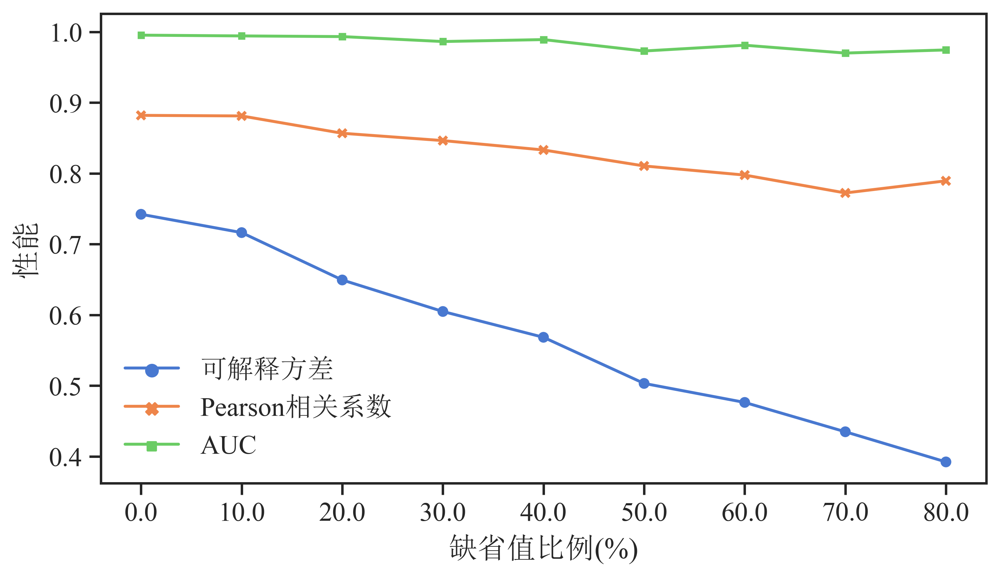

In [227]:
from matplotlib import rcParams
indicator = indicator.iloc[:3,:]
fig, ax =plt.subplots(constrained_layout=True,figsize=(7,4),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.25)
sub1 = sns.lineplot(data=indicator.T.reset_index().melt(id_vars=["index"]), x="index", y="value", hue="variable",palette="muted")
sub1 = sns.scatterplot(data=indicator.T.reset_index().melt(id_vars=["index"]), x="index", y="value", hue="variable",palette="muted",style='variable',markers=True)
# sub1.set_ylim(0.9,1)
sub1.set_ylabel("性能")
sub1.set_xlabel("缺省值比例(%)")
sub1.set_xticklabels(np.linspace(0,80,9))
# sub1.legend(prop = {'size':10})
config = {
            "mathtext.fontset": 'cm',
         }
# ['dejavusans', 'dejavuserif', 'cm', 'stix', 'stixsans', 'custom']
rcParams.update(config)
handles,labels = ax.get_legend_handles_labels()
groups = ["explained_variance","pearson","AUC"]
n = 3
plt.legend(frameon=False,handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["可解释方差","Pearson相关系数","AUC"])
plt.savefig("./result/single_cell/msisensor_rna_ratio.svg")
plt.show()

In [ ]:
# 缺省值模拟

In [217]:
def setDropout(data,genes,ratio):
    data = data[genes]
    np.random.seed(0)
    gene_num = len(genes)
    sample_num = data.shape[0]
    random_list = np.random.randint(0,gene_num,size=[sample_num,math.ceil(ratio*gene_num)])
    for i in range(len(random_list)):
        for j in random_list[i]:
            data.iloc[i,j] = 0
    return data

from sklearn import linear_model
model_logistic_regression = linear_model.LogisticRegression(random_state=6,max_iter=500)

from sklearn import svm
model_svm = svm.SVC(probability=True,random_state=6)

from sklearn.tree import DecisionTreeClassifier
model_decision_tree = DecisionTreeClassifier(random_state=6)


from sklearn import ensemble
model_random_forest = ensemble.RandomForestClassifier(random_state=6)

from sklearn import ensemble
model_adaboost = ensemble.AdaBoostClassifier(random_state=6)  
 
from sklearn import ensemble
model_gradient_boosting = ensemble.GradientBoostingClassifier(random_state=6) 

from sklearn import ensemble
model_bagging = ensemble.BaggingClassifier(random_state=6)

from sklearn import ensemble
model_extra_trees = ensemble.ExtraTreesClassifier(random_state=6)

In [245]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=3)

In [480]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
genes = gene_sort

In [481]:
genes = gene_sort[:14]

In [305]:
ratios = [0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8]
auc_table = pd.DataFrame(index=["logistic_regression","svm","decision_tree","random_forest","adaboost","gradient_boosting","extra_trees",
                               "regression"
                               ])

target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
model_reg = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
X_train_scale = zcoreScaler(X_train[genes])
model_reg.fit(X_train_scale,y_train)

models = [model_logistic_regression,model_svm,model_decision_tree,model_random_forest,model_adaboost,model_gradient_boosting,model_extra_trees]
target = pd.get_dummies(TCGA.msi)["MSI-H"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
X_train_smote,y_train_smote = smote.fit_sample(X_train[genes],y_train)   
X_train_smote_scale = zcoreScaler(X_train_smote)
imputer = SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True)
for ratio in ratios:  
    print(ratio)
    res = []
    data = setDropout(X_test,genes,ratio)
    data_impute = imputer.fit_transform(data)
    data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
    data_scale = zcoreScaler(data_impute)
    for model in models:
        print(model)
        model.fit(X_train_smote_scale,y_train_smote)
        auc = roc_auc_score(y_test,model.predict_proba(data_scale)[:,1])
        res.append(auc)
    auc = roc_auc_score(y_test,model_reg.predict(data_scale))
    res.append(auc)    

    auc_table["ratio"+str(ratio)] = res
    res = []
display(auc_table)   

0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)

c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-243-a8d342334498>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.988692,0.984694,0.981252,0.971288,0.972501,0.948869,0.955588,0.941396,0.933661
svm,0.992855,0.988496,0.983415,0.974992,0.980859,0.956047,0.956899,0.944805,0.936971
decision_tree,0.894543,0.840462,0.819027,0.812684,0.786382,0.736726,0.696018,0.684907,0.658161
random_forest,0.992756,0.986382,0.981318,0.965847,0.975156,0.953818,0.933071,0.909898,0.922304
adaboost,0.972992,0.969158,0.944510,0.956113,0.938414,0.889315,0.901409,0.907588,0.896919
gradient_boosting,0.990888,0.980302,0.976631,0.962275,0.971321,0.935365,0.922714,0.904458,0.901754
extra_trees,0.995264,0.989266,0.983694,0.979236,0.984562,0.956735,0.945297,0.938889,0.923042
regression,0.988266,0.991478,0.986431,0.970600,0.976860,0.950180,0.942216,0.923763,0.934939


In [308]:
auc_table.to_csv("./result/single_cell/dropout_table/bulk_drop_out_top14.csv")

<ipython-input-256-2980f135dc4f>:10: UserWarning: FixedFormatter should only be used together with FixedLocator


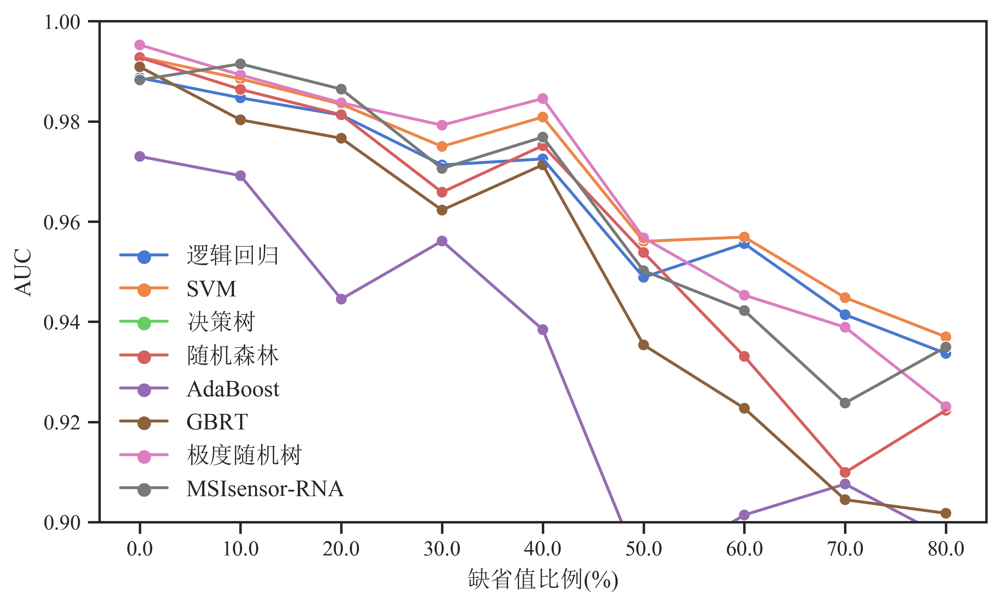

In [256]:

fig, ax =plt.subplots(constrained_layout=True,figsize=(7,4.2),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)
sub1 = sns.lineplot(data=auc_table.T.reset_index().melt(id_vars=["index"]), x="index", y="value", hue="variable",palette="muted")
sub1 = sns.scatterplot(data=auc_table.T.reset_index().melt(id_vars=["index"]), x="index", y="value", hue="variable",palette="muted")
sub1.set_ylim(0.9,1)
sub1.set_ylabel("AUC",fontsize=12)
sub1.set_xlabel("缺省值比例(%)",fontsize=12)
sub1.set_xticklabels(np.linspace(0,80,9))
# sub1.legend(prop = {'size':10})

handles,labels = ax.get_legend_handles_labels()
groups = ["logistic_regression","svm","decision_tree","random_forest","adaboost","gradient_boosting","extra_trees","regression"]
n = 8
plt.legend(frameon=False,handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["逻辑回归","SVM","决策树","随机森林","AdaBoost","GBRT","极度随机树","MSIsensor-RNA"],fontsize=12)
plt.savefig("./result/single_cell/bulk_dropout_compare_14.svg")
plt.show()

In [248]:
auc_table.T.mean()

logistic_regression    0.964216
svm                    0.968371
decision_tree          0.769879
random_forest          0.957839
adaboost               0.930713
gradient_boosting      0.949523
extra_trees            0.966221
regression             0.962748
dtype: float64

In [533]:
def get_topNgenes_union(n):
    sort_table =pd.read_csv("./result/gene_sort/sort_table.csv",index_col=0)
    selection = sort_table
    geneDict = dict.fromkeys(selection.index,0)
    for indicator in selection.columns:
        genes = list(selection.sort_values(by=indicator,ascending=False).index[:n])
        for gene in genes:
            geneDict[gene] += 1
    gengImp = pd.DataFrame(geneDict,index=["importance"]).T
    gengImp = gengImp.sort_values(by="importance",ascending=False)
    gene_union = list(gengImp[gengImp.importance >= 1].index)
    genes = gene_union
    print(len(genes))
    return genes

In [628]:
for n in [10,20,30,40,50,60,70,80,90,100,110,120]:
    genes = get_topNgenes_union(n)
    num = len(genes)
    ratios = [0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8]
    auc_table = pd.DataFrame(index=["logistic_regression","svm","decision_tree","random_forest","adaboost","gradient_boosting","extra_trees",
                                   "regression"
                                   ])

    target = TCGA["MSIsensor_score"]
    X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
    model_reg = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
    X_train_scale = zcoreScaler(X_train[genes])
    model_reg.fit(X_train_scale,y_train)

    models = [model_logistic_regression,model_svm,model_decision_tree,model_random_forest,model_adaboost,model_gradient_boosting,model_extra_trees]
    target = pd.get_dummies(TCGA.msi)["MSI-H"]
    X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
    X_train_smote,y_train_smote = smote.fit_sample(X_train[genes],y_train)   
    X_train_smote_scale = zcoreScaler(X_train_smote)
    imputer = SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True)
    for ratio in ratios:  
        print(ratio)
        res = []
        data = setDropout(X_test,genes,ratio)
        data_impute = imputer.fit_transform(data)
        data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
        data_scale = zcoreScaler(data_impute)
        for model in models:
            print(model)
            model.fit(X_train_smote_scale,y_train_smote)
            auc = roc_auc_score(y_test,model.predict_proba(data_scale)[:,1])
            res.append(auc)
        auc = roc_auc_score(y_test,model_reg.predict(data_scale))
        res.append(auc)    

        auc_table["ratio"+str(ratio)] = res
        res = []
    display(auc_table)   
    auc_table.to_csv("./result/single_cell/dropout_table/bulk_drop_out_top{n}_{num}.csv".format(n=n,num=num))

31
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.989086,0.987021,0.975090,0.981252,0.976794,0.969092,0.949361,0.951032,0.955719
svm,0.990298,0.986201,0.979056,0.981285,0.980039,0.968863,0.948148,0.951196,0.961095
decision_tree,0.877876,0.864159,0.808948,0.824140,0.747493,0.719715,0.702606,0.639331,0.694100
random_forest,0.992986,0.989184,0.976483,0.980777,0.976073,0.970026,0.948918,0.938954,0.947329
adaboost,0.986037,0.984169,0.973648,0.968535,0.965454,0.948607,0.911111,0.904851,0.923206
gradient_boosting,0.991577,0.986168,0.974467,0.966142,0.967683,0.950639,0.925664,0.922550,0.922779
extra_trees,0.992543,0.990954,0.984890,0.988922,0.984710,0.971091,0.964094,0.954834,0.953245
regression,0.991839,0.985841,0.980531,0.980728,0.970370,0.965356,0.955195,0.935136,0.940020


71
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.994428,0.989413,0.988692,0.986595,0.984562,0.987217,0.969453,0.974631,0.956408
svm,0.994199,0.988922,0.990036,0.988037,0.986627,0.987611,0.977417,0.979056,0.965782
decision_tree,0.884907,0.833432,0.799754,0.816421,0.757129,0.776401,0.745674,0.750098,0.712684
random_forest,0.994231,0.990331,0.989807,0.981498,0.978712,0.974304,0.962865,0.970551,0.953048
adaboost,0.998492,0.992035,0.987185,0.984759,0.976663,0.963946,0.960472,0.948640,0.917797
gradient_boosting,0.992396,0.981711,0.972534,0.968633,0.959980,0.961357,0.957817,0.943297,0.914553
extra_trees,0.996591,0.995395,0.993035,0.994100,0.989807,0.986873,0.979285,0.980810,0.970764
regression,0.990954,0.977909,0.989020,0.981055,0.975713,0.985316,0.973714,0.975287,0.970862


113
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.997247,0.997575,0.992822,0.991216,0.992298,0.982989,0.981416,0.971976,0.958735
svm,0.997181,0.997935,0.992560,0.993215,0.994395,0.988168,0.987709,0.977581,0.965978
decision_tree,0.882399,0.873107,0.843854,0.817207,0.760521,0.716863,0.740118,0.666077,0.712340
random_forest,0.994526,0.994494,0.992888,0.988922,0.986513,0.986447,0.977237,0.970846,0.968142
adaboost,0.996198,0.995739,0.989086,0.982891,0.981744,0.977089,0.958899,0.933006,0.927565
gradient_boosting,0.994330,0.991904,0.984497,0.979908,0.967716,0.957915,0.953622,0.924746,0.906359
extra_trees,0.996280,0.997329,0.996788,0.993543,0.993936,0.992740,0.988315,0.983792,0.975188
regression,0.997345,0.995903,0.994494,0.994297,0.992888,0.989282,0.981645,0.979810,0.974140


154
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993707,0.991347,0.989512,0.993904,0.983612,0.977155,0.967912,0.959685,0.949197
svm,0.994461,0.992658,0.990790,0.995051,0.984792,0.981383,0.973189,0.972042,0.964831
decision_tree,0.905310,0.880138,0.862340,0.817896,0.766765,0.765290,0.769027,0.709735,0.713471
random_forest,0.995297,0.994559,0.994018,0.994985,0.985660,0.985120,0.970518,0.989495,0.972370
adaboost,0.995116,0.987217,0.989643,0.989577,0.956899,0.953720,0.967158,0.954671,0.924222
gradient_boosting,0.992396,0.988266,0.980433,0.976303,0.948312,0.955031,0.942543,0.965487,0.918945
extra_trees,0.997263,0.995379,0.995985,0.995247,0.989413,0.991232,0.975778,0.993641,0.986595
regression,0.991904,0.989839,0.988889,0.988102,0.983677,0.980138,0.970206,0.981908,0.964405


189
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993150,0.989413,0.983448,0.985382,0.993740,0.963848,0.965847,0.974697,0.983448
svm,0.993871,0.991577,0.985775,0.988659,0.994133,0.977024,0.978401,0.979744,0.986431
decision_tree,0.898279,0.852360,0.810865,0.779794,0.767552,0.751229,0.709390,0.703835,0.652360
random_forest,0.996296,0.996001,0.993494,0.992543,0.987938,0.988578,0.975451,0.961521,0.978007
adaboost,0.995379,0.992429,0.987152,0.983546,0.965126,0.966404,0.935562,0.947657,0.927073
gradient_boosting,0.992855,0.990593,0.976762,0.972566,0.964602,0.952901,0.922911,0.930744,0.909636
extra_trees,0.995542,0.995936,0.992986,0.993412,0.993494,0.988791,0.982973,0.978515,0.982825
regression,0.994297,0.994133,0.988168,0.990429,0.987053,0.984956,0.963520,0.966503,0.952442


229
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.994756,0.991740,0.989413,0.989282,0.990298,0.986201,0.981645,0.965126,0.976434
svm,0.994821,0.993117,0.989512,0.989708,0.991970,0.989217,0.986136,0.974402,0.981776
decision_tree,0.849066,0.829794,0.802016,0.810865,0.766077,0.762684,0.706785,0.707129,0.671976
random_forest,0.997657,0.996575,0.993953,0.986005,0.989512,0.989364,0.981252,0.975057,0.976237
adaboost,0.990855,0.986070,0.986595,0.980138,0.972632,0.968699,0.940347,0.946313,0.943002
gradient_boosting,0.994002,0.987152,0.982334,0.963717,0.968830,0.962078,0.923468,0.934120,0.935234
extra_trees,0.996526,0.996493,0.996362,0.985185,0.992806,0.990265,0.990954,0.983481,0.984726
regression,0.992527,0.988168,0.991413,0.981285,0.979384,0.988856,0.977286,0.975516,0.976073


273
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.994657,0.991675,0.991019,0.991445,0.983317,0.986398,0.971452,0.964897,0.977057
svm,0.993379,0.989938,0.990331,0.990855,0.986267,0.986693,0.979482,0.972370,0.979285
decision_tree,0.872763,0.866421,0.823451,0.739774,0.749754,0.747148,0.769715,0.696362,0.700098
random_forest,0.996722,0.996362,0.991839,0.990282,0.992904,0.992478,0.988856,0.987119,0.979384
adaboost,0.992134,0.989643,0.982039,0.975090,0.965323,0.982268,0.946182,0.930154,0.929433
gradient_boosting,0.993609,0.986234,0.966634,0.954671,0.954212,0.966142,0.946739,0.926975,0.918224
extra_trees,0.996083,0.995084,0.989381,0.994199,0.990479,0.990855,0.987955,0.984989,0.979957
regression,0.992494,0.990265,0.986726,0.985644,0.989053,0.982891,0.979023,0.979351,0.967945


316
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993478,0.992429,0.993707,0.991544,0.989643,0.982891,0.977450,0.978401,0.961127
svm,0.991150,0.989872,0.992494,0.991642,0.988954,0.983874,0.980662,0.981645,0.961947
decision_tree,0.857571,0.821288,0.785693,0.724238,0.706441,0.736037,0.712340,0.672321,0.640118
random_forest,0.996067,0.992576,0.997099,0.995723,0.992248,0.990184,0.987185,0.970747,0.977057
adaboost,0.990462,0.987775,0.981416,0.966732,0.976139,0.963291,0.950541,0.931760,0.918584
gradient_boosting,0.993904,0.983972,0.977352,0.959620,0.964536,0.968240,0.947362,0.934972,0.934087
extra_trees,0.996559,0.992248,0.993674,0.991069,0.993346,0.994723,0.993494,0.982416,0.983956
regression,0.994297,0.991347,0.987348,0.987971,0.984890,0.983055,0.972370,0.963651,0.948443


362
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993412,0.991282,0.986988,0.991904,0.988823,0.973484,0.977155,0.971518,0.960505
svm,0.990888,0.988758,0.985775,0.991511,0.989053,0.974435,0.975615,0.972386,0.965126
decision_tree,0.856096,0.865733,0.792035,0.800541,0.821976,0.784562,0.723107,0.693068,0.676057
random_forest,0.996116,0.992707,0.993265,0.987348,0.994051,0.981613,0.980908,0.983333,0.977204
adaboost,0.995313,0.993051,0.988069,0.976532,0.972697,0.951360,0.945198,0.945526,0.925696
gradient_boosting,0.994592,0.987938,0.979285,0.962012,0.974009,0.948836,0.941036,0.945198,0.927598
extra_trees,0.993232,0.992183,0.993002,0.993854,0.994854,0.978466,0.984317,0.983596,0.982399
regression,0.991085,0.986136,0.986824,0.988561,0.988758,0.970928,0.966109,0.969125,0.966962


397
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993543,0.995477,0.987676,0.989676,0.985513,0.990003,0.978597,0.966273,0.966109
svm,0.990757,0.993314,0.986037,0.987873,0.983579,0.989577,0.979449,0.968371,0.968371
decision_tree,0.875369,0.836824,0.794985,0.762783,0.770157,0.707915,0.755654,0.715634,0.670846
random_forest,0.993986,0.994084,0.992150,0.990462,0.990642,0.992150,0.986103,0.986480,0.972271
adaboost,0.989807,0.987545,0.980039,0.972173,0.968109,0.951098,0.949656,0.930088,0.919731
gradient_boosting,0.993707,0.988463,0.977712,0.971386,0.976139,0.956441,0.965356,0.955097,0.913569
extra_trees,0.994510,0.992970,0.991445,0.991282,0.989561,0.991298,0.989626,0.986955,0.985824
regression,0.994985,0.994854,0.989184,0.985546,0.979974,0.985087,0.977909,0.972468,0.959226


441
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.991609,0.986955,0.988430,0.983448,0.977909,0.980203,0.980400,0.966011,0.958899
svm,0.988954,0.985775,0.988758,0.981023,0.977876,0.979580,0.979908,0.967552,0.963291
decision_tree,0.891593,0.871976,0.837168,0.836037,0.771976,0.794199,0.741593,0.719371,0.706441
random_forest,0.995493,0.994641,0.992642,0.987873,0.990675,0.988954,0.986513,0.988823,0.976483
adaboost,0.987480,0.986070,0.967617,0.969059,0.963094,0.961980,0.948705,0.943068,0.903736
gradient_boosting,0.993510,0.990823,0.982465,0.956670,0.966175,0.963618,0.943986,0.952147,0.934382
extra_trees,0.993789,0.993691,0.991429,0.985480,0.985415,0.985923,0.986136,0.986103,0.977663
regression,0.993248,0.988299,0.986824,0.983776,0.985284,0.978401,0.981613,0.973517,0.963618


485
0
LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.1


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.2


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.3


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.4


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.5


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.6


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.7


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)
0.8


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


LogisticRegression(max_iter=500, random_state=6)
SVC(probability=True, random_state=6)
DecisionTreeClassifier(random_state=6)
RandomForestClassifier(random_state=6)
AdaBoostClassifier(random_state=6)
GradientBoostingClassifier(random_state=6)
ExtraTreesClassifier(random_state=6)


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.992003,0.993576,0.988233,0.986463,0.989020,0.979777,0.980170,0.974992,0.973845
svm,0.989643,0.990102,0.987250,0.986791,0.990888,0.983153,0.979187,0.978892,0.978007
decision_tree,0.891593,0.871976,0.850885,0.805310,0.793068,0.789774,0.729007,0.741249,0.713029
random_forest,0.993232,0.994510,0.993527,0.991183,0.995182,0.985447,0.985005,0.982645,0.976991
adaboost,0.991773,0.988791,0.981055,0.955457,0.977286,0.966536,0.946477,0.948083,0.921763
gradient_boosting,0.993609,0.991773,0.983284,0.961095,0.976958,0.956801,0.955490,0.946149,0.919535
extra_trees,0.994444,0.993445,0.992642,0.992363,0.992707,0.983841,0.986726,0.978810,0.980810
regression,0.993478,0.994756,0.994035,0.989839,0.989381,0.977221,0.975713,0.971813,0.971944


In [636]:
path = "./result/single_cell/dropout_table/"
compare = pd.DataFrame(index = data.index)
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    name = name.split("bulk_drop_out_")[1].split(".")[0]
    compare[name+"_mean"] = list(data.T.mean())
    compare[name+"_std"] = list(data.T.std())
    display(data)

,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993543,0.995477,0.987676,0.989676,0.985513,0.990003,0.978597,0.966273,0.966109
svm,0.990757,0.993314,0.986037,0.987873,0.983579,0.989577,0.979449,0.968371,0.968371
decision_tree,0.875369,0.836824,0.794985,0.762783,0.770157,0.707915,0.755654,0.715634,0.670846
random_forest,0.993986,0.994084,0.992150,0.990462,0.990642,0.992150,0.986103,0.986480,0.972271
adaboost,0.989807,0.987545,0.980039,0.972173,0.968109,0.951098,0.949656,0.930088,0.919731
gradient_boosting,0.993707,0.988463,0.977712,0.971386,0.976139,0.956441,0.965356,0.955097,0.913569
extra_trees,0.994510,0.992970,0.991445,0.991282,0.989561,0.991298,0.989626,0.986955,0.985824
regression,0.994985,0.994854,0.989184,0.985546,0.979974,0.985087,0.977909,0.972468,0.959226


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.989086,0.987021,0.975090,0.981252,0.976794,0.969092,0.949361,0.951032,0.955719
svm,0.990298,0.986201,0.979056,0.981285,0.980039,0.968863,0.948148,0.951196,0.961095
decision_tree,0.877876,0.864159,0.808948,0.824140,0.747493,0.719715,0.702606,0.639331,0.694100
random_forest,0.992986,0.989184,0.976483,0.980777,0.976073,0.970026,0.948918,0.938954,0.947329
adaboost,0.986037,0.984169,0.973648,0.968535,0.965454,0.948607,0.911111,0.904851,0.923206
gradient_boosting,0.991577,0.986168,0.974467,0.966142,0.967683,0.950639,0.925664,0.922550,0.922779
extra_trees,0.992543,0.990954,0.984890,0.988922,0.984710,0.971091,0.964094,0.954834,0.953245
regression,0.991839,0.985841,0.980531,0.980728,0.970370,0.965356,0.955195,0.935136,0.940020


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.991609,0.986955,0.988430,0.983448,0.977909,0.980203,0.980400,0.966011,0.958899
svm,0.988954,0.985775,0.988758,0.981023,0.977876,0.979580,0.979908,0.967552,0.963291
decision_tree,0.891593,0.871976,0.837168,0.836037,0.771976,0.794199,0.741593,0.719371,0.706441
random_forest,0.995493,0.994641,0.992642,0.987873,0.990675,0.988954,0.986513,0.988823,0.976483
adaboost,0.987480,0.986070,0.967617,0.969059,0.963094,0.961980,0.948705,0.943068,0.903736
gradient_boosting,0.993510,0.990823,0.982465,0.956670,0.966175,0.963618,0.943986,0.952147,0.934382
extra_trees,0.993789,0.993691,0.991429,0.985480,0.985415,0.985923,0.986136,0.986103,0.977663
regression,0.993248,0.988299,0.986824,0.983776,0.985284,0.978401,0.981613,0.973517,0.963618


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.992003,0.993576,0.988233,0.986463,0.989020,0.979777,0.980170,0.974992,0.973845
svm,0.989643,0.990102,0.987250,0.986791,0.990888,0.983153,0.979187,0.978892,0.978007
decision_tree,0.891593,0.871976,0.850885,0.805310,0.793068,0.789774,0.729007,0.741249,0.713029
random_forest,0.993232,0.994510,0.993527,0.991183,0.995182,0.985447,0.985005,0.982645,0.976991
adaboost,0.991773,0.988791,0.981055,0.955457,0.977286,0.966536,0.946477,0.948083,0.921763
gradient_boosting,0.993609,0.991773,0.983284,0.961095,0.976958,0.956801,0.955490,0.946149,0.919535
extra_trees,0.994444,0.993445,0.992642,0.992363,0.992707,0.983841,0.986726,0.978810,0.980810
regression,0.993478,0.994756,0.994035,0.989839,0.989381,0.977221,0.975713,0.971813,0.971944


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.994428,0.989413,0.988692,0.986595,0.984562,0.987217,0.969453,0.974631,0.956408
svm,0.994199,0.988922,0.990036,0.988037,0.986627,0.987611,0.977417,0.979056,0.965782
decision_tree,0.884907,0.833432,0.799754,0.816421,0.757129,0.776401,0.745674,0.750098,0.712684
random_forest,0.994231,0.990331,0.989807,0.981498,0.978712,0.974304,0.962865,0.970551,0.953048
adaboost,0.998492,0.992035,0.987185,0.984759,0.976663,0.963946,0.960472,0.948640,0.917797
gradient_boosting,0.992396,0.981711,0.972534,0.968633,0.959980,0.961357,0.957817,0.943297,0.914553
extra_trees,0.996591,0.995395,0.993035,0.994100,0.989807,0.986873,0.979285,0.980810,0.970764
regression,0.990954,0.977909,0.989020,0.981055,0.975713,0.985316,0.973714,0.975287,0.970862


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.997247,0.997575,0.992822,0.991216,0.992298,0.982989,0.981416,0.971976,0.958735
svm,0.997181,0.997935,0.992560,0.993215,0.994395,0.988168,0.987709,0.977581,0.965978
decision_tree,0.882399,0.873107,0.843854,0.817207,0.760521,0.716863,0.740118,0.666077,0.712340
random_forest,0.994526,0.994494,0.992888,0.988922,0.986513,0.986447,0.977237,0.970846,0.968142
adaboost,0.996198,0.995739,0.989086,0.982891,0.981744,0.977089,0.958899,0.933006,0.927565
gradient_boosting,0.994330,0.991904,0.984497,0.979908,0.967716,0.957915,0.953622,0.924746,0.906359
extra_trees,0.996280,0.997329,0.996788,0.993543,0.993936,0.992740,0.988315,0.983792,0.975188
regression,0.997345,0.995903,0.994494,0.994297,0.992888,0.989282,0.981645,0.979810,0.974140


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993707,0.991347,0.989512,0.993904,0.983612,0.977155,0.967912,0.959685,0.949197
svm,0.994461,0.992658,0.990790,0.995051,0.984792,0.981383,0.973189,0.972042,0.964831
decision_tree,0.905310,0.880138,0.862340,0.817896,0.766765,0.765290,0.769027,0.709735,0.713471
random_forest,0.995297,0.994559,0.994018,0.994985,0.985660,0.985120,0.970518,0.989495,0.972370
adaboost,0.995116,0.987217,0.989643,0.989577,0.956899,0.953720,0.967158,0.954671,0.924222
gradient_boosting,0.992396,0.988266,0.980433,0.976303,0.948312,0.955031,0.942543,0.965487,0.918945
extra_trees,0.997263,0.995379,0.995985,0.995247,0.989413,0.991232,0.975778,0.993641,0.986595
regression,0.991904,0.989839,0.988889,0.988102,0.983677,0.980138,0.970206,0.981908,0.964405


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993150,0.989413,0.983448,0.985382,0.993740,0.963848,0.965847,0.974697,0.983448
svm,0.993871,0.991577,0.985775,0.988659,0.994133,0.977024,0.978401,0.979744,0.986431
decision_tree,0.898279,0.852360,0.810865,0.779794,0.767552,0.751229,0.709390,0.703835,0.652360
random_forest,0.996296,0.996001,0.993494,0.992543,0.987938,0.988578,0.975451,0.961521,0.978007
adaboost,0.995379,0.992429,0.987152,0.983546,0.965126,0.966404,0.935562,0.947657,0.927073
gradient_boosting,0.992855,0.990593,0.976762,0.972566,0.964602,0.952901,0.922911,0.930744,0.909636
extra_trees,0.995542,0.995936,0.992986,0.993412,0.993494,0.988791,0.982973,0.978515,0.982825
regression,0.994297,0.994133,0.988168,0.990429,0.987053,0.984956,0.963520,0.966503,0.952442


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.994756,0.991740,0.989413,0.989282,0.990298,0.986201,0.981645,0.965126,0.976434
svm,0.994821,0.993117,0.989512,0.989708,0.991970,0.989217,0.986136,0.974402,0.981776
decision_tree,0.849066,0.829794,0.802016,0.810865,0.766077,0.762684,0.706785,0.707129,0.671976
random_forest,0.997657,0.996575,0.993953,0.986005,0.989512,0.989364,0.981252,0.975057,0.976237
adaboost,0.990855,0.986070,0.986595,0.980138,0.972632,0.968699,0.940347,0.946313,0.943002
gradient_boosting,0.994002,0.987152,0.982334,0.963717,0.968830,0.962078,0.923468,0.934120,0.935234
extra_trees,0.996526,0.996493,0.996362,0.985185,0.992806,0.990265,0.990954,0.983481,0.984726
regression,0.992527,0.988168,0.991413,0.981285,0.979384,0.988856,0.977286,0.975516,0.976073


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.994657,0.991675,0.991019,0.991445,0.983317,0.986398,0.971452,0.964897,0.977057
svm,0.993379,0.989938,0.990331,0.990855,0.986267,0.986693,0.979482,0.972370,0.979285
decision_tree,0.872763,0.866421,0.823451,0.739774,0.749754,0.747148,0.769715,0.696362,0.700098
random_forest,0.996722,0.996362,0.991839,0.990282,0.992904,0.992478,0.988856,0.987119,0.979384
adaboost,0.992134,0.989643,0.982039,0.975090,0.965323,0.982268,0.946182,0.930154,0.929433
gradient_boosting,0.993609,0.986234,0.966634,0.954671,0.954212,0.966142,0.946739,0.926975,0.918224
extra_trees,0.996083,0.995084,0.989381,0.994199,0.990479,0.990855,0.987955,0.984989,0.979957
regression,0.992494,0.990265,0.986726,0.985644,0.989053,0.982891,0.979023,0.979351,0.967945


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993478,0.992429,0.993707,0.991544,0.989643,0.982891,0.977450,0.978401,0.961127
svm,0.991150,0.989872,0.992494,0.991642,0.988954,0.983874,0.980662,0.981645,0.961947
decision_tree,0.857571,0.821288,0.785693,0.724238,0.706441,0.736037,0.712340,0.672321,0.640118
random_forest,0.996067,0.992576,0.997099,0.995723,0.992248,0.990184,0.987185,0.970747,0.977057
adaboost,0.990462,0.987775,0.981416,0.966732,0.976139,0.963291,0.950541,0.931760,0.918584
gradient_boosting,0.993904,0.983972,0.977352,0.959620,0.964536,0.968240,0.947362,0.934972,0.934087
extra_trees,0.996559,0.992248,0.993674,0.991069,0.993346,0.994723,0.993494,0.982416,0.983956
regression,0.994297,0.991347,0.987348,0.987971,0.984890,0.983055,0.972370,0.963651,0.948443


,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993412,0.991282,0.986988,0.991904,0.988823,0.973484,0.977155,0.971518,0.960505
svm,0.990888,0.988758,0.985775,0.991511,0.989053,0.974435,0.975615,0.972386,0.965126
decision_tree,0.856096,0.865733,0.792035,0.800541,0.821976,0.784562,0.723107,0.693068,0.676057
random_forest,0.996116,0.992707,0.993265,0.987348,0.994051,0.981613,0.980908,0.983333,0.977204
adaboost,0.995313,0.993051,0.988069,0.976532,0.972697,0.951360,0.945198,0.945526,0.925696
gradient_boosting,0.994592,0.987938,0.979285,0.962012,0.974009,0.948836,0.941036,0.945198,0.927598
extra_trees,0.993232,0.992183,0.993002,0.993854,0.994854,0.978466,0.984317,0.983596,0.982399
regression,0.991085,0.986136,0.986824,0.988561,0.988758,0.970928,0.966109,0.969125,0.966962


In [638]:
compare.to_csv("./result/single_cell/dropout_table/merge_compare.csv")

In [790]:
compare = pd.read_csv("./result/single_cell/dropout_table/merge_compare.csv",index_col=0)

In [639]:
auc_table = pd.read_csv("./result/single_cell/dropout_table/bulk_drop_out_top40_154.csv",index_col=0)

In [640]:
auc_table

,ratio0,ratio0.1,ratio0.2,ratio0.3,ratio0.4,ratio0.5,ratio0.6,ratio0.7,ratio0.8
logistic_regression,0.993707,0.991347,0.989512,0.993904,0.983612,0.977155,0.967912,0.959685,0.949197
svm,0.994461,0.992658,0.990790,0.995051,0.984792,0.981383,0.973189,0.972042,0.964831
decision_tree,0.905310,0.880138,0.862340,0.817896,0.766765,0.765290,0.769027,0.709735,0.713471
random_forest,0.995297,0.994559,0.994018,0.994985,0.985660,0.985120,0.970518,0.989495,0.972370
adaboost,0.995116,0.987217,0.989643,0.989577,0.956899,0.953720,0.967158,0.954671,0.924222
gradient_boosting,0.992396,0.988266,0.980433,0.976303,0.948312,0.955031,0.942543,0.965487,0.918945
extra_trees,0.997263,0.995379,0.995985,0.995247,0.989413,0.991232,0.975778,0.993641,0.986595
regression,0.991904,0.989839,0.988889,0.988102,0.983677,0.980138,0.970206,0.981908,0.964405


<ipython-input-590-d2a9548041c8>:10: UserWarning: FixedFormatter should only be used together with FixedLocator


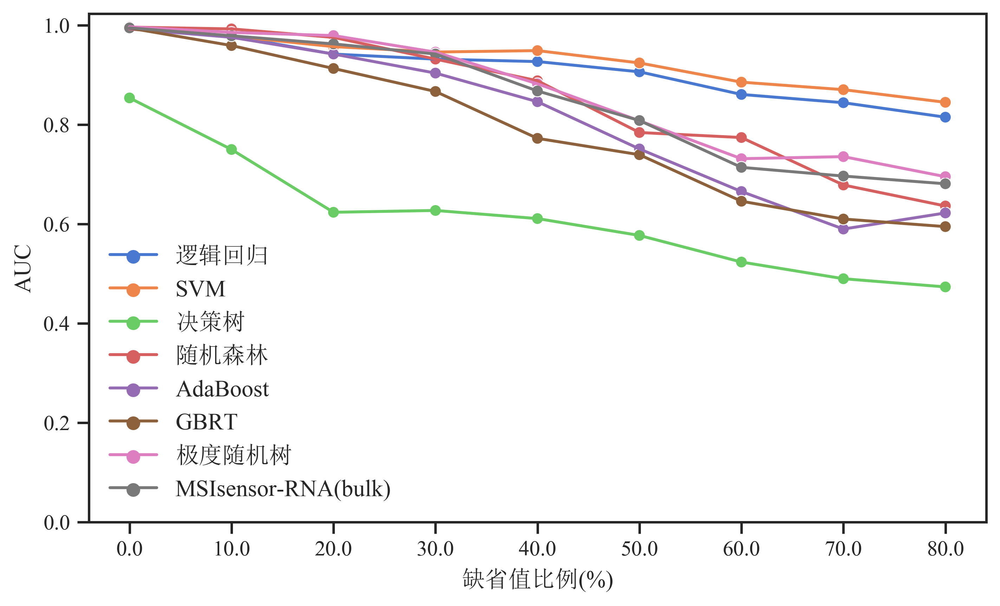

In [590]:

fig, ax =plt.subplots(constrained_layout=True,figsize=(7,4.2),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)
sub1 = sns.lineplot(data=auc_table.T.reset_index().melt(id_vars=["index"]), x="index", y="value", hue="variable",palette="muted")
sub1 = sns.scatterplot(data=auc_table.T.reset_index().melt(id_vars=["index"]), x="index", y="value", hue="variable",palette="muted")
sub1.set_ylim(0)
sub1.set_ylabel("AUC",fontsize=12)
sub1.set_xlabel("缺省值比例(%)",fontsize=12)
sub1.set_xticklabels(np.linspace(0,80,9))
# sub1.legend(prop = {'size':10})

handles,labels = ax.get_legend_handles_labels()
groups = ["logistic_regression","svm","decision_tree","random_forest","adaboost","gradient_boosting","extra_trees","regression"]
n = 8
plt.legend(frameon=False,handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["逻辑回归","SVM","决策树","随机森林","AdaBoost","GBRT","极度随机树","MSIsensor-RNA(bulk)"],fontsize=12)
plt.savefig("./result/single_cell/bulk_dropout_compare_top80.svg")
plt.show()

In [ ]:
# 缺省比例统计

In [ ]:
# GSE200997

data = pd.read_csv("./data/singlecell/GSE200997_GEO_processed_CRC_10X_raw_UMI_count_matrix.csv",usecols=[0,1,2],index_col=0)
ratios = []
for index, row in data.iteritems():
    ratios.append(sum(row==0)/data.shape[0])
count = pd.DataFrame(columns=data.columns).T

count["ratio"] = ratios
count.to_csv("")

info = pd.read_csv("./data/singlecell/GSE200997_sample_info.csv",index_col=0)
genes = list(pd.read_csv("./data/singlecell/GSE178341/C103_T.matrix.csv",nrows=3,index_col=0).columns)
genes = set.intersection(set(data.index),set(genes))
for name in info.index:
    sample = data.loc[:,data.columns.str.contains(name)].T[genes]
    sample = sample.applymap(lambda x: np.nan if x == 0 else x)
#     display(sample)
    break

In [ ]:
# 网格调参

In [593]:
genes = get_topNgenes_union(80)
smote = SMOTE(random_state=3)
X_train_smote,y_train_smote = smote.fit_sample(X_train[genes],y_train)   
X_train_smote_scale = zcoreScaler(X_train_smote)
data = setDropout(X_test,genes,0.8)
X_test_scale = zcoreScaler(data)

316


c:\users\yangxuanhao\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-457-60bee6696df4>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [595]:
grid_search = pd.DataFrame(index=["kernel","C","auc","CPTACauc","ICGCauc"])
res = []
kernel = ["linear", "poly", "rbf", "sigmoid"]
C = [0.01,0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1,2,3,4,5,10]
# min_samples_split = [2,3,4]
# max_depth = [15,20,25,30,None]
r = [(a,b) for a in kernel for b in C]
for i in range(len(r)):
    res = []
    paras = r[i]
    kernel = paras[0]
    C = paras[1]
    res.append(kernel)
    res.append(C)
#     res.append(min_split)
#     res.append(max_d)
    model = svm.SVC(probability=True,random_state=6,kernel=kernel,C=C)
    model.fit(X_train_smote_scale,y_train_smote)
    y_pre = model.predict_proba(X_test_scale)[:,1]
    res.append(roc_auc_score(y_test,y_pre))

    CPTAC_scale = zcoreScaler(CPTAC[genes])
    y_pre = model.predict_proba(CPTAC_scale)[:,1]
    res.append(roc_auc_score(pd.get_dummies(CPTAC.iloc[:,0])["MSI-H"],y_pre))   

    ICGC_scale = zcoreScaler(ICGC[genes])
    y_pre = model.predict_proba(ICGC_scale)[:,1]
    res.append(roc_auc_score(pd.get_dummies(ICGC.iloc[:,0])["MSI-H"],y_pre))
    grid_search["para"+str(i+1)] =  res

In [596]:
grid_search.T[grid_search.T["auc"] == max(grid_search.T["auc"])]

,kernel,C,auc,CPTACauc,ICGCauc
para36,rbf,0.05,0.873255,0.986626,0.92594


In [598]:
grid_search.to_csv("./result/grid_search/grid_search_SVM.csv")

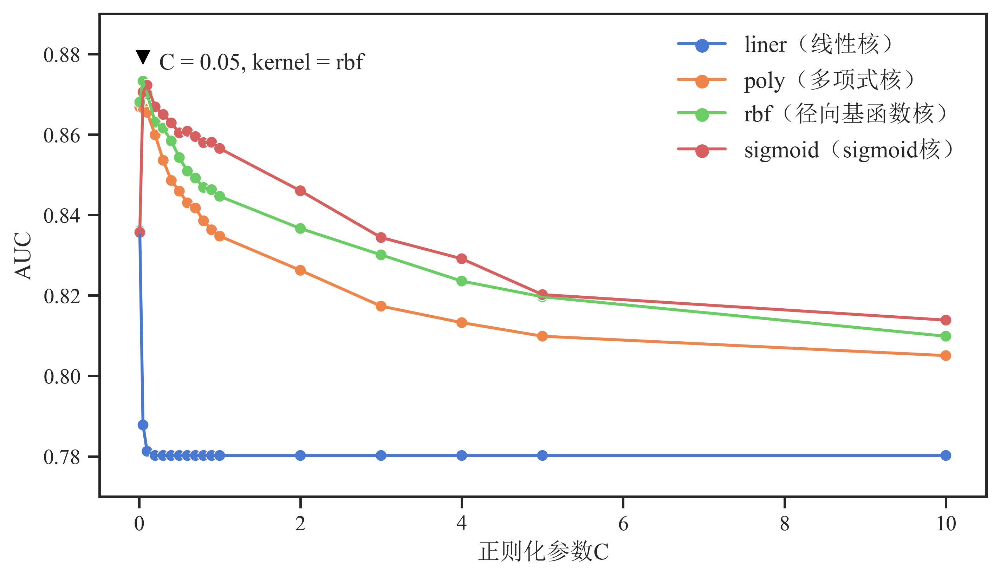

In [610]:
fig, ax =plt.subplots(constrained_layout=True,figsize=(7,4),dpi=400)

rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)

sub1 = sns.lineplot(data=grid_search.T, x="C", y="auc", hue="kernel",palette="muted")
sub1 = sns.scatterplot(data=grid_search.T, x="C", y="auc", hue="kernel",palette="muted")

maxDf = grid_search.T[grid_search.T["auc"] == max(grid_search.T["auc"])]

plt.plot(maxDf["C"],maxDf["auc"]+0.006, marker="v", label="points",c='black')
plt.annotate('C = 0.05, kernel = rbf',xy=(maxDf["C"]+0.2,maxDf["auc"]+0.003))

sub1.set_ylabel("AUC",fontsize=12)
# sub1.legend(prop = {'size':10})
sub1.set_ylim(0.77,0.89)
sub1.set_xlabel("正则化参数C",fontsize=12)



handles,labels = ax.get_legend_handles_labels()
groups = ["linear", "poly", "rbf", "sigmoid"]
n = len(groups)
plt.legend(handles=[(h1,h2) for h1,h2 in zip(handles[:n],handles[n:])],labels=["liner（线性核）","poly（多项式核）","rbf（径向基函数核）","sigmoid（sigmoid核）"],fontsize=12,frameon=False)


plt.savefig("./result/grid_search/grid_search_SVM.svg")

In [ ]:
# 插值策略比较

In [613]:
from sklearn.impute import SimpleImputer,KNNImputer
imputers = [SimpleImputer( strategy='constant',missing_values=0,fill_value=0,keep_empty_features=True),
            SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True), 
            SimpleImputer(strategy='median',missing_values=0,keep_empty_features=True),
            SimpleImputer(strategy='most_frequent',missing_values=0,keep_empty_features=True),
            KNNImputer(n_neighbors=5,missing_values=0,keep_empty_features=True)
           ]

model = svm.SVC(probability=True,random_state=6,kernel="rbf",C=0.05)
model.fit(X_train_smote_scale,y_train_smote)
data = setDropout(X_test,genes,0.8)
impute_compare = pd.DataFrame(index=["zero","mean","median","most_frequent","knn"])
res = []
for imputer in imputers:
    data_impute = imputer.fit_transform(data)
    data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
    X_test_scale = zcoreScaler(data_impute)
    y_pre = model.predict_proba(X_test_scale)[:,1]
    res.append(roc_auc_score(y_test,y_pre))

    CPTAC_scale = zcoreScaler(CPTAC[genes])
    y_pre = model.predict_proba(CPTAC_scale)[:,1]
    print(roc_auc_score(pd.get_dummies(CPTAC.iloc[:,0])["MSI-H"],y_pre))   

    ICGC_scale = zcoreScaler(ICGC[genes])
    y_pre = model.predict_proba(ICGC_scale)[:,1]
    print(roc_auc_score(pd.get_dummies(ICGC.iloc[:,0])["MSI-H"],y_pre))
    
    
impute_compare["method"] =  res

In [626]:
impute_compare

,method
zero,0.873255
mean,0.962602
median,0.958931
most_frequent,0.896198
knn,0.959751


In [ ]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
genes = gene_sort[:14]
num = len(genes)
ratios = [0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8]
auc_table = pd.DataFrame(index=["regression"])


model_reg.fit(X_train_scale,y_train)

imputer = SimpleImputer(strategy='mean',missing_values=0,keep_empty_features=True)
for ratio in ratios:  
    print(ratio)
    res = []
    data = setDropout(X_test,genes,ratio)
    data_impute = imputer.fit_transform(data)
    data_impute = pd.DataFrame(data_impute,index=data.index,columns=data.columns)
    data_scale = zcoreScaler(data_impute)
    print(model_reg.predict(data_scale))
    auc = roc_auc_score(y_true,model_reg.predict(data_scale))
    res.append(auc)    

    auc_table["ratio"+str(ratio)] = res
display(auc_table)   

In [482]:
target = TCGA["MSIsensor_score"]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.30, random_state=RANDOM_STATE)
model = ExtraTreesRegressor(n_estimators=70,min_samples_leaf=1,min_samples_split=2,max_depth=25,max_features="sqrt",random_state=6)
X_train_scale = zcoreScaler(X_train[genes])
model.fit(X_train_scale,y_train)

ExtraTreesRegressor(max_depth=25, max_features='sqrt', n_estimators=70,
                    random_state=6)

In [ ]:
# classification report

In [220]:
def dropLowQuality(data,genes):
    num = len(genes)
    names = []
    quality = []
    for i in range(data.shape[0]):
        quality.append(sum(~np.isnan(data.iloc[i,:]))/num)
    data.insert(loc=0,column="quality",value=quality)


    threshold = sum(data.quality >=0.4)
    if threshold <100:
        threshold = sum(data.quality >=0.3)
    if threshold <100:
        threshold = sum(data.quality >=0.2)
    
    if threshold <100:
        threshold = np.min([20,data.shape[0]])
    
        
    data = data.sort_values(by="quality",ascending=False).iloc[:threshold,:] 
    print(data.shape[0])
    return data.iloc[:,1:]

In [170]:
def get_singlecell_pre(database,samp_score,info):
    
    res = pd.DataFrame(index=samp_score.index)
    res["database"] = database
    res["y_true"] =  pd.get_dummies(info.MSI_Label)["MSI-H"] 
    res["y_score"] =  samp_score.score
    fpr, tpr, thresholds = roc_curve(res.y_true,res.y_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    cutoff = 12.35
    y_pre = res.y_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    res["y_pre"] = y_pre
    res.to_csv("./result/single_cell/"+database+".res.csv")
    return res

In [171]:
def singlecellPredict(path,info,genes):
    cell_score = pd.DataFrame(columns=["score","sample"])
    samp_score = pd.DataFrame(columns=["score","num"])
    res = []
    for file in os.listdir(path):    
        data = pd.read_csv(path+file,index_col=0)[genes]

        data_hq = dropLowQuality(data,genes)
        imputer = SimpleImputer( strategy='mean',keep_empty_features=True)
        
        data_impute = imputer.fit_transform(data_hq)
        data_impute = pd.DataFrame(data_impute,index=data_hq.index,columns=data_hq.columns)
        
        data_impute = data_impute.applymap(lambda x:np.log2(x+1))
        
        data_scale = zcoreScaler(data_impute) 
        
        cell_prob = pd.DataFrame(model.predict(data_scale),index=data_scale.index,columns=["score"])
        cell_prob["sample"] = file.split(".")[0]
        cell_score = cell_score.append(cell_prob)
        
        samp_prob = pd.DataFrame(np.mean(model.predict(data_scale)),index=[file.split(".")[0]],columns=["score"])
        samp_prob["num"] = data_scale.shape[0]
#         display(samp_prob)
        samp_score = samp_score.append(samp_prob)
        res.append(np.mean(model.predict(data_scale)))
    auc = roc_auc_score(pd.get_dummies(info.MSI_Label)["MSI-H"],res)
    print(auc)
    return auc,cell_score,samp_score

In [892]:
gene_num_prediction = pd.read_csv("./result/gene_select/gene_union_num.csv",index_col=0)
gene_sort = list(gene_num_prediction.genes)
gene_sort.reverse()
genes = gene_sort[:14]

In [893]:
path_GSE178341 = "./data/singlecell/GSE178341_14/"
# path_GSE178341 = "./data/singlecell/FPKM/GSE178341/"
info_GSE178341 = pd.read_csv("./data/singlecell/GSE178341_sample_info.csv",index_col=0)
auc,cell_score,samp_score = singlecellPredict(path=path_GSE178341,info=info_GSE178341,genes=genes)
res_GSE178341 = get_singlecell_pre("GSE178341",samp_score,info_GSE178341)
res_GSE178341.to_csv("./result/single_cell/samp_score/res_GSE178341.csv")

857
152
122
114
352
367
1012
144
247
220
169
157
219
135
328
20
583
119
435
154
148
145
153
258
20
127
110
283
120
808
552
237
210
630
257
285
443
593
206
265
453
20
392
20
196
146
146
201
131
111
387
306
134
115
317
108
174
20
499
109
128
398
143
140
396
193
284
187
503
113
122
104
104
297
651
283
675
500
115
1274
499
644
1372
1423
103
2818
300
567
298
980
2350
163
551
384
349
1565
957
1025
313
180
0.9789010989010989


In [894]:
path_GSE200997 = "./data/singlecell/GSE200997_14/"
# path_GSE200997 = "./data/singlecell/FPKM/GSE200997/"
info_GSE200997 = pd.read_csv("./data/singlecell/GSE200997_sample_info.csv",index_col=0)
auc,cell_score,samp_score = singlecellPredict(path=path_GSE200997,info=info_GSE200997,genes=genes)
res_GSE200997 = get_singlecell_pre("GSE200997",samp_score,info_GSE200997)

res_GSE200997.to_csv("./result/single_cell/samp_score/res_GSE200997.csv")

294
1050
1051
161
481
142
168
130
20
809
339
20
1004
988
106
316
446
380
20
353
149
310
121
0.9761904761904762


In [895]:
path_GSE132465 = "./data/singlecell/GSE132465_14/"
# path_GSE132465 = "./data/singlecell/FPKM/GSE132465/"
info_GSE132465 = pd.read_csv("./data/singlecell/GSE132465_sample_info.csv",index_col=0)
auc,cell_score,samp_score = singlecellPredict(path=path_GSE132465,info=info_GSE132465,genes=genes)
res_GSE132465 = get_singlecell_pre("GSE132465",samp_score,info_GSE132465)

res_GSE132465.to_csv("./result/single_cell/samp_score/res_GSE132465.csv")

471
269
422
176
455
228
361
176
293
156
238
141
458
153
342
116
185
161
382
127
167
140
195
432
127
208
336
106
172
455
100
135
180
0.9396551724137931


In [ ]:
# 和preMSIm对比

In [896]:
path = "./R/result/singlecell/GSE200997/"
merge = pd.DataFrame(index = ["all_mean"])
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    merge[name.split(".")[0]] = [np.mean(data.all_score)]

merge.T.to_csv("./R/result/singlecell/GSE200997_sample_score_preMSIm.csv")

In [897]:
path = "./R/result/singlecell/GSE132465/"
merge = pd.DataFrame(index = ["all_mean"])
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    merge[name.split(".")[0]] = [np.mean(data.all_score)]

merge.T.to_csv("./R/result/singlecell/GSE132465_sample_score_preMSIm.csv")

In [898]:
path = "./R/result/singlecell/GSE178341/"
merge = pd.DataFrame(index = ["all_mean"])
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    merge[name.split(".")[0]] = [np.mean(data.all_score)]

merge.T.to_csv("./R/result/singlecell/GSE178341_sample_score_preMSIm.csv")

In [899]:
preMSIm_GSE200997 = pd.read_csv("./R/result/singlecell/GSE200997_sample_score_preMSIm.csv",index_col=0)
merge = pd.merge(res_GSE200997,preMSIm_GSE200997,left_index=True,right_index=True)
merge.to_csv("./result/single_cell/samp_score/merge_GSE200997.csv")

In [900]:
preMSIm_GSE132465 = pd.read_csv("./R/result/singlecell/GSE132465_sample_score_preMSIm.csv",index_col=0)
merge = pd.merge(res_GSE132465,preMSIm_GSE132465,left_index=True,right_index=True)
merge.to_csv("./result/single_cell/samp_score/merge_GSE132465.csv")

In [901]:
preMSIm_GSE178341 = pd.read_csv("./R/result/singlecell/GSE178341_sample_score_preMSIm.csv",index_col=0)
merge = pd.merge(res_GSE178341,preMSIm_GSE178341,left_index=True,right_index=True)
merge.to_csv("./result/single_cell/samp_score/merge_GSE178341.csv")

In [902]:
merge = pd.DataFrame(index=["MSIsensor-RNA","PreMSIm"])
path = "./result/single_cell/samp_score/merge/"
for name in os.listdir(path):
    if "merge" not in name:
        continue
    res = []
    data = pd.read_csv(path+name,index_col=0)
    res.append(roc_auc_score(data.y_true,data.y_score))
    res.append(roc_auc_score(data.y_true,data.all_mean))
    merge[name.split(".")[0]] = res

In [903]:
merge = merge.reset_index().melt(id_vars="index")

merge.columns = ["method","GEO","AUC"]

merge.to_csv("./result/single_cell/samp_score/GEO_compare_AUC.csv")

In [904]:
merge

,method,GEO,AUC
0,MSIsensor-RNA,merge_GSE132465,0.939655
1,PreMSIm,merge_GSE132465,0.534483
2,MSIsensor-RNA,merge_GSE178341,0.978901
3,PreMSIm,merge_GSE178341,0.502857
4,MSIsensor-RNA,merge_GSE200997,0.976190
5,PreMSIm,merge_GSE200997,0.440476


In [664]:
np.mean(merge[merge["method"]=="PreMSIm"].AUC)

0.49260536398467436

In [663]:
2*np.std(merge[merge["method"]=="PreMSIm"].AUC)

0.07811330131911527

In [905]:
def preMSI_cutoff(merge):

    
    fpr, tpr, thresholds = roc_curve(merge.y_true,merge.all_mean,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    cutoff = 0.5
    y_pre = merge.all_mean.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    merge["all_pre"] = y_pre
    
    return merge

In [906]:
path = "./result/single_cell/samp_score/merge/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0)
    data = preMSI_cutoff(data)
    data.to_csv(path+name)

In [907]:
indicator = pd.DataFrame(index=["Database","Sample_num","Method","AUC","F1","Accuracy","Precision","Recall","Specificity"])
path = "./result/single_cell/samp_score/merge/"
i = 0
for name in os.listdir(path):
    merge = pd.read_csv(path+name,index_col=0)
    print(name)
    res = []
    res.append(name.split(".")[0])
    res.append(merge.shape[0])
    res.append("MSIsensor-RNA")
    res+=metricCalculate(merge.y_true,merge.y_score,merge.y_pre)
    indicator[str(i)] = res
    i+=1
    
    res = []
    res.append(name.split(".")[0])
    res.append(merge.shape[0])
    res.append("PreMSIm")
    res+=metricCalculate(merge.y_true,merge.all_mean,merge.all_pre)
    indicator[str(i)] = res
    i+=1
    
indicator.T.to_csv("./result/single_cell/samp_score/GEO_compare.csv")

merge_GSE132465.csv
merge_GSE178341.csv
merge_GSE200997.csv


In [159]:
report = pd.read_csv("./result/single_cell/samp_score/GEO_compare.csv",index_col=0)

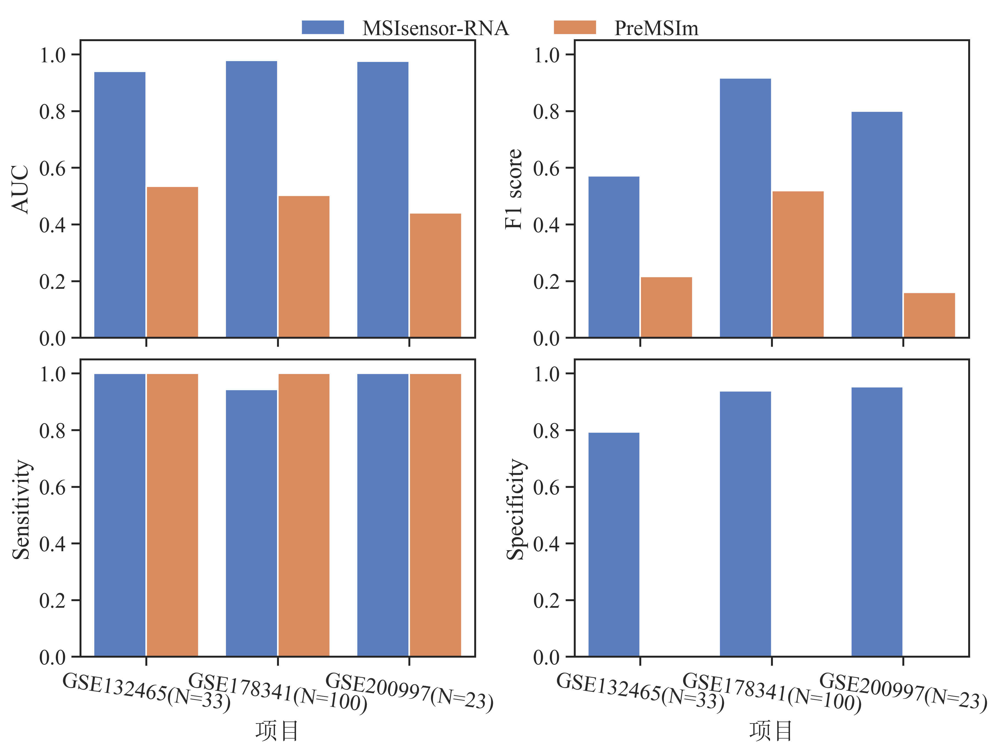

In [189]:
fig, ax =plt.subplots(2,2,constrained_layout=True,figsize=(9,6.5),dpi=400)
# xlabels = []
# for name in database:
#     xlabels.append(name+"(N="+str(report[report["Database"] == "GSE13067"].Sample_num[0])+")")
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc,font_scale=1.3)
plt.subplot(2,2,1)
sub1 = sns.barplot(data=report, x="Database", y="AUC", hue="Method",palette="muted",order=["merge_GSE132465","merge_GSE178341","merge_GSE200997"])
sub1.set_ylabel("AUC")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.legend_.remove()


plt.subplot(2,2,2)
sub1 = sns.barplot(data=report, x="Database", y="F1", hue="Method",palette="muted",order=["merge_GSE132465","merge_GSE178341","merge_GSE200997"])
sub1.set_ylabel("F1 score")
sub1.set_xlabel("")
sub1.set_ylim(0,1.05)
sub1.set_xticklabels("")
sub1.legend_.remove() 

plt.subplot(2,2,3)
sub1 = sns.barplot(data=report, x="Database", y="Recall", hue="Method",palette="muted",order=["merge_GSE132465","merge_GSE178341","merge_GSE200997"])
sub1.set_ylabel("Sensitivity")
sub1.set_xlabel("项目")
sub1.set_xticklabels([ 'GSE132465(N=33)','GSE178341(N=100)', 'GSE200997(N=23)'],rotation=-8)
sub1.set_ylim(0,1.05)
sub1.legend_.remove()
 

plt.subplot(2,2,4)
sub1 = sns.barplot(data=report, x="Database", y="Specificity", hue="Method",palette="muted",order=["merge_GSE132465","merge_GSE178341","merge_GSE200997"])
sub1.set_ylabel("Specificity")
sub1.set_xlabel("项目")
sub1.set_xticklabels([ 'GSE132465(N=33)','GSE178341(N=100)', 'GSE200997(N=23)'],rotation=-8)
sub1.set_ylim(0,1.05)
sub1.legend_.remove()

lines, labels = sub1.get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center',bbox_to_anchor=(0.5,1.05),ncol=4,frameon=False) 


fig.savefig("./result/single_cell/samp_score/GEO_compare.svg",bbox_inches='tight')

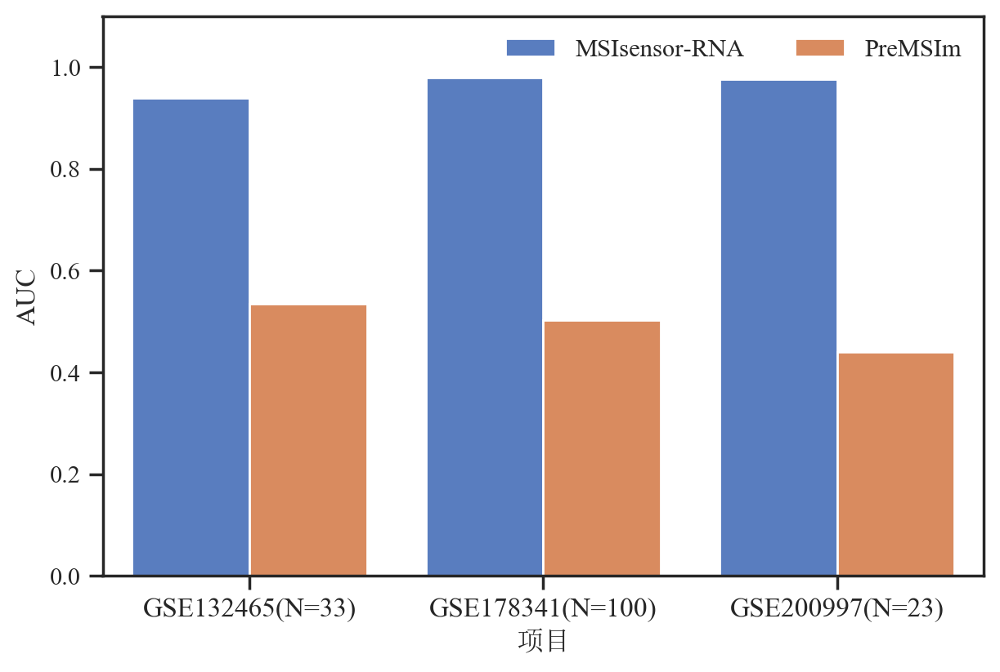

In [693]:
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(6, 4),dpi=200)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)
sub = sns.barplot(data=merge, x="GEO", y="AUC",hue="method", palette="muted",order=["merge_GSE132465","merge_GSE178341","merge_GSE200997"],
linewidth=1)
sub.set_xticklabels([ 'GSE132465(N=33)','GSE178341(N=100)', 'GSE200997(N=23)'],fontsize=12)
plt.legend(frameon=False,ncol=2)
sub.set_ylim(0,1.1)
sub.set_ylabel("AUC",fontsize=12)
sub.set_xlabel("项目",fontsize=12)
fig.savefig("./result/single_cell/samp_score/GEO_compare_AUC.svg")

In [559]:
merge_GSE200997 = pd.read_csv("./result/single_cell/samp_score/merge_GSE200997.csv",index_col=0)
merge_GSE132465 = pd.read_csv("./result/single_cell/samp_score/merge_GSE132465.csv",index_col=0)
merge_GSE178341 = pd.read_csv("./result/single_cell/samp_score/merge_GSE178341.csv",index_col=0)

In [566]:
merge_all = merge_GSE200997.append(merge_GSE132465).append(merge_GSE178341)

In [567]:
merge_all.to_csv("./result/single_cell/samp_score/merge_all.csv")

In [573]:
msisensor = merge_all[["y_true","y_score"]]

In [575]:
msisensor["method"] = "MSIsensor-RNA"

<ipython-input-575-4398dd4165a3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [574]:
preMSIm = merge_all[["y_true","all_mean"]]

In [584]:
preMSIm = preMSIm.rename(columns={"all_mean":"y_score"})

In [588]:
preMSIm["method"] = "PreMSIm"

In [590]:
msisensor.append(preMSIm).to_csv("./result/single_cell/samp_score/merge_method.csv")

In [268]:
merge_all = pd.read_csv("./result/single_cell/samp_score/merge_all.csv",index_col=0)

[0.5344827586206897, 0.5028571428571428, 0.4404761904761905]


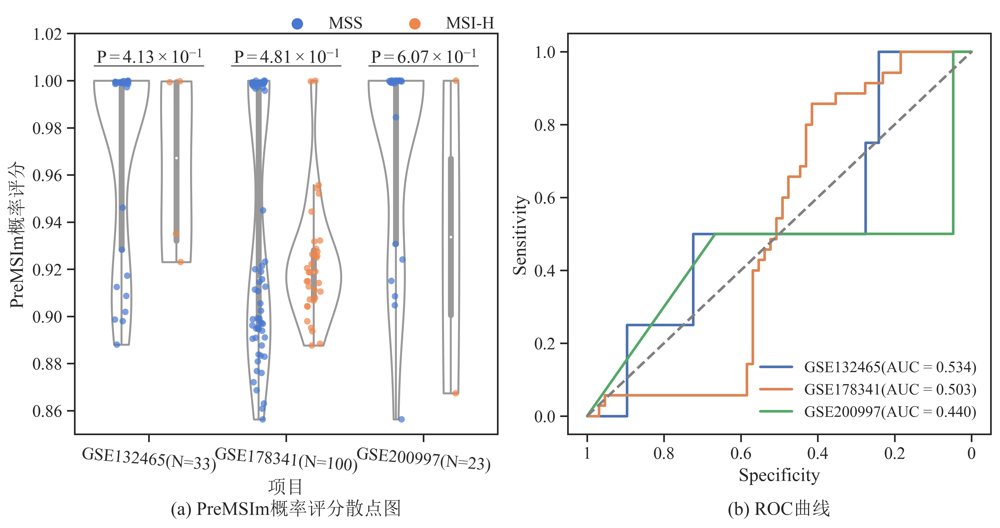

In [278]:
data = merge_all
# data["database"] = "all"
# dbs = list(res_merge.database.unique())
dbs = ["GSE132465","GSE178341","GSE200997"]
from scipy.stats import ranksums
fig, ax =plt.subplots(1,2,constrained_layout=True,figsize=(10.5, 5.5),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}



sub =plt.subplot(1,2,1)
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)

# sub = sns.violinplot(data=data, x="database", y="y_score",hue="y_true"
#                    ,  palette="muted",
#                    dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.violinplot(data=data, x="database", y="all_mean",hue="y_true"
                   ,  palette=["white", "white"],order=dbs,
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(data=data, x="database", y="all_mean",hue="y_true"
                   ,palette="muted", dodge=True, jitter=True,alpha=0.7,order=dbs)
handles,labels = sub.get_legend_handles_labels()

pvalues=[]
aucs = []
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["database"] == db) & (data["y_true"] == 1)]["all_mean"],
        y=data[(data["database"] == db) & (data["y_true"] == 0)]["all_mean"],
        alternative="greater"
    )[1])
    aucs.append(roc_auc_score(data[data["database"] == db].y_true,data[data["database"] == db].all_mean))
fontdict = {'math_fontfamily':'custom', 'size':14}
for i in range(len(dbs)):
    plt.plot([i-0.4,i+0.4],[1.0063,1.0063],color="black",linewidth=0.6)
#     print(i,pvalues[i])
#     plt.text(i, 19.7, r"$ P = {va}\times10^{exp},AUC={auc}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}",auc=round(aucs[i],3)), ha="center",fontdict=fontdict)
    plt.text(i, 1.0075, r"$ P = {va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
sub.set_ylabel("PreMSIm概率评分")
sub.set_ylim(0.85,1.02)
sub.set_xlabel("项目")
sub.set_title("(a) PreMSIm概率评分散点图",y=-0.22)
sub.set_xticklabels([ 'GSE132465(N=33)','GSE178341(N=100)', 'GSE200997(N=23)'],rotation=-5)
# plt.title("(a) MSIsensor-RNA评分散点图",y=-0.2)  
plt.legend(handles=handles[2:],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1.03,1.082),ncol=2)
sub = plt.subplot(1,2,2)
colors =  [u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["database"] == db].y_true,data[data["database"] == db].all_mean,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["database"] == db].y_true,data[data["database"] == db].all_mean)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s(AUC = %0.3f)' % (db,roc_auc))  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
print(aucs)
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
# plt.title("(b) ROC曲线",y=-0.2)  
plt.title("(b) ROC曲线",y=-0.22)
plt.legend(loc="lower right",frameon=False,fontsize=12)

plt.savefig("./result/single_cell/PreMSIm_compare.svg",bbox_inches='tight')

In [226]:
def get_singlecell_pre(database,samp_score,info):
    
    res = pd.DataFrame(index=samp_score.index)
    res["database"] = database
    res["y_true"] =  pd.get_dummies(info.MSI_Label)["MSI-H"] 
    res["y_score"] =  samp_score.score
    fpr, tpr, thresholds = roc_curve(res.y_true,res.y_score,drop_intermediate=False)
    cutoff = find_optimal_cutoff(tpr,fpr,thresholds)
    print(cutoff)
    y_pre = res.y_score.copy()
    y_pre[y_pre < cutoff] =0
    y_pre[y_pre >= cutoff] =1
    res["y_pre"] = y_pre
    res.to_csv("./result/single_cell/"+database+".res.csv")
    return res

In [687]:
def metricCalculate(y_true,y_score,y_pre):
    auc = roc_auc_score(y_true,y_score)
    tn, fp, fn, tp = confusion_matrix(y_true,y_pre).ravel()
    accuracy = (tp+tn)/(tn+fp+fn+tp)
#     precision = tp/(tp+fp)
#     recall = tp/(tp+fn)
    specificity = tn/(tn+fp)
#     f1 = 2*precision*recall/(precision+recall)
    precision,recall,f1,_ = precision_recall_fscore_support(y_true,y_pre,average="binary")
    return auc,f1,accuracy,precision,recall,specificity

In [1115]:
metricCalculate(res_merge.y_true,res_merge.y_score,res_merge.y_pre)

(0.9730646871686108,
 0.8571428571428571,
 0.9166666666666666,
 0.78,
 0.9512195121951219,
 0.9043478260869565)

In [1551]:
res_merge = res_GSE178341.append(res_GSE1200997).append(res_GSE132465)

In [1553]:
res_merge.to_csv("./result/single_cell/database_compare.res.csv")

In [280]:
res_merge = pd.read_csv("./result/single_cell/database_compare.res.csv",index_col=0)

[0.9396551724137931, 0.9789010989010989, 0.9761904761904762]


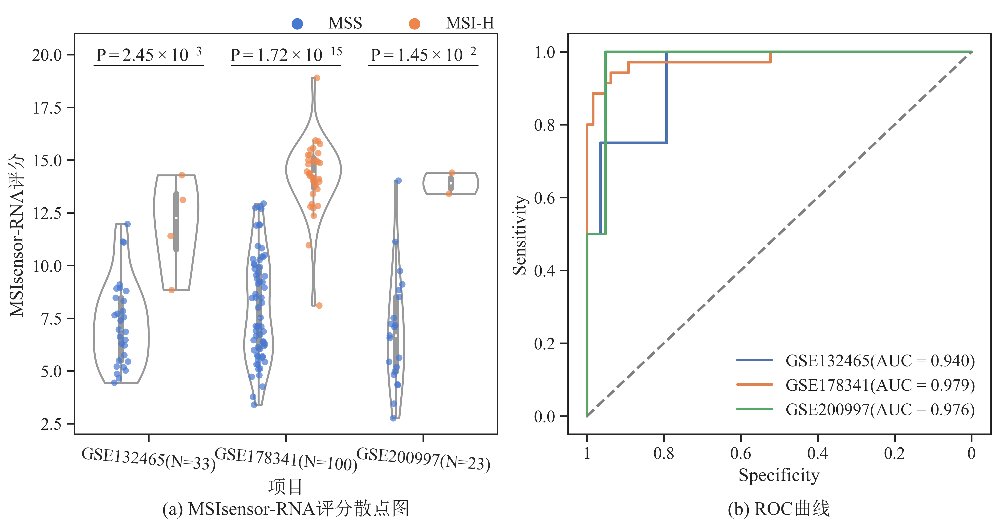

In [281]:
data = res_merge
# data["database"] = "all"
# dbs = list(res_merge.database.unique())
dbs = ["GSE132465","GSE178341","GSE200997"]
from scipy.stats import ranksums
fig, ax =plt.subplots(1,2,constrained_layout=True,figsize=(10.5, 5.5),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}

sub =plt.subplot(1,2,1)
sub = sns.set(context='notebook', style='ticks', rc=rc, font_scale=1.2)

# sub = sns.violinplot(data=data, x="database", y="y_score",hue="y_true"
#                    ,  palette="muted",
#                    dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.violinplot(data=data, x="database", y="y_score",hue="y_true"
                   ,  palette=["white", "white"],order=dbs,
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(data=data, x="database", y="y_score",hue="y_true"
                   ,palette="muted", dodge=True, jitter=True,alpha=0.7,order=dbs)
pvalues=[]
aucs = []
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["database"] == db) & (data["y_true"] == 1)]["y_score"],
        y=data[(data["database"] == db) & (data["y_true"] == 0)]["y_score"],
        alternative="greater"
    )[1])
    aucs.append(roc_auc_score(data[data["database"] == db].y_true,data[data["database"] == db].y_score))
fontdict = {'math_fontfamily':'custom', 'size':14}
for i in range(len(dbs)):
    plt.plot([i-0.4,i+0.4],[19.5,19.5],color="black",linewidth=0.6)
#     print(i,pvalues[i])
#     plt.text(i, 19.7, r"$ P = {va}\times10^{exp},AUC={auc}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}",auc=round(aucs[i],3)), ha="center",fontdict=fontdict)
    plt.text(i, 19.7, r"$ P = {va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
sub.set_ylim(2,21)
sub.set_ylabel("MSIsensor-RNA评分")
sub.set_xlabel("项目")
sub.set_xticklabels([ 'GSE132465(N=33)','GSE178341(N=100)', 'GSE200997(N=23)'],rotation=-5)
sub.set_title("(a) MSIsensor-RNA评分散点图",y=-0.22)
# plt.title("(a) MSIsensor-RNA评分散点图",y=-0.2)  
handles,labels = sub.get_legend_handles_labels()
plt.legend(handles=handles[2:],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1.03,1.082),ncol=2)

sub = plt.subplot(1,2,2)
colors =  [u'#4c72b0', u'#dd8452', u'#55a868', u'#c44e52', u'#8172b3', u'#937860', u'#da8bc3', u'#8c8c8c', u'#ccb974', u'#64b5cd']
i = 0
for db in dbs:
    
    fpr, tpr, thresholds = roc_curve(data[data["database"] == db].y_true,data[data["database"] == db].y_score,drop_intermediate=False)
    roc_auc = roc_auc_score(data[data["database"] == db].y_true,data[data["database"] == db].y_score)
    sub = plt.plot(fpr, tpr, color=colors[i],
            lw=2, label='%s(AUC = %0.3f)' % (db,roc_auc))  ###假正率为横坐标，真正率为纵坐标做曲线
    i+=1
    plt.xticks(ticks=[0,0.2,0.4,0.6,0.8,1],labels=[1,0.8,0.6,0.4,0.2,0])
    
print(aucs)
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('Specificity')
plt.ylabel('Sensitivity')
# plt.title("(b) ROC曲线",y=-0.2)  
plt.title("(b) ROC曲线",y=-0.22)
plt.legend(loc="lower right",frameon=False)


plt.savefig("./result/single_cell/database_compare.svg",bbox_inches='tight')

In [449]:
np.mean(aucs)

0.9649155825017894

In [450]:
np.std(aucs)*2

0.035792107406713486

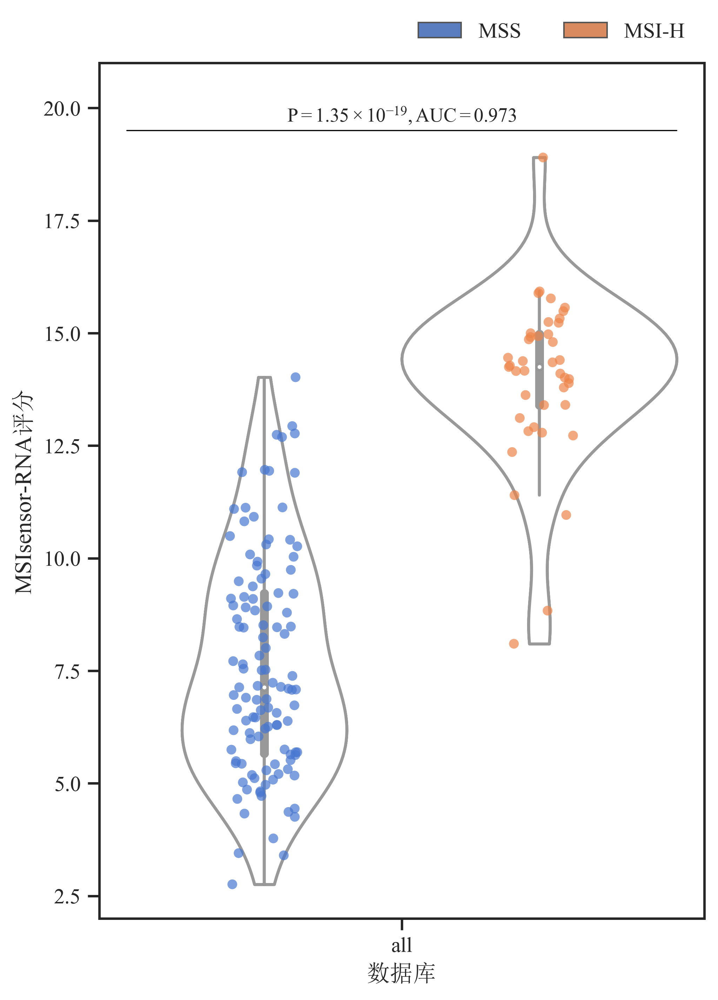

In [459]:
data = res_merge
data["database"] = "all"
dbs = list(res_merge.database.unique())
from scipy.stats import ranksums
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(5, 7),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sub = sns.set(context='notebook', style='ticks', rc=rc)

sub = sns.violinplot(data=data, x="database", y="y_score",hue="y_true"
                   ,  palette="muted",
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.violinplot(data=data, x="database", y="y_score",hue="y_true"
                   ,  palette=["white", "white"],
                   dodge=True, cut=0, split=False, bw_method="scott")
sub = sns.stripplot(data=data, x="database", y="y_score",hue="y_true"
                   ,palette="muted", dodge=True, jitter=True,alpha=0.7)
pvalues=[]
aucs = []
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["database"] == db) & (data["y_true"] == 1)]["y_score"],
        y=data[(data["database"] == db) & (data["y_true"] == 0)]["y_score"],
        alternative="greater"
    )[1])
    aucs.append(roc_auc_score(data[data["database"] == db].y_true,data[data["database"] == db].y_score))
fontdict = {'math_fontfamily':'custom', 'size':10}
for i in range(len(dbs)):
    plt.plot([i-0.4,i+0.4],[19.5,19.5],color="black",linewidth=0.6)
#     print(i,pvalues[i])
    plt.text(i, 19.7, r"$ P = {va}\times10^{exp},AUC={auc}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}",auc=round(aucs[i],3)), ha="center",fontdict=fontdict)
sub.set_ylim(2,21)
sub.set_ylabel("MSIsensor-RNA评分",fontsize=12)
sub.set_xlabel("数据库",fontsize=12)
# sub.set_xticklabels(['GSE178341(N=100)', 'GSE200997(N=23)', 'GSE132465(N=33)'],fontsize=12)
handles,labels = ax.get_legend_handles_labels()

plt.legend(handles=handles[0:2],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1,1.07),ncol=2)

plt.savefig("./result/single_cell/database_compare.svg",bbox_inches='tight')

In [441]:
# 和PreMSIm比较
preMSIm = ["DDX27", "EPM2AIP1", "HENMT1", "LYG1", "MLH1","MSH4", "NHLRC1", "NOL4L", "RNLS", "RPL22L1", "RTF2", "SHROOM4", "SMAP1", "TTC30A", "ZSWIM3"]
preMSIm = set(preMSIm) - set(['NHLRC1', 'RTF2'])
path = "./data/singlecell/GSE178341/"
for name in os.listdir(path):
    data = pd.read_csv(path+name,index_col=0,nrows=2)[preMSIm]
    data = data.fillna(0)
    data = data.applymap(lambda x:np.log2(x+1))
    data.T.to_csv("./R/Data/singlecell/GSE178341/"+name,sep="\t")

KeyError: "['NHLRC1', 'RTF2'] not in index"

In [1189]:
# cell_info

In [505]:
cell_info = pd.read_csv("./data/singlecell/GSE178341_celltype.csv",index_col=0)

In [506]:
score_celltype = pd.merge(cell_score,cell_info,left_index=True,right_index=True)

In [507]:
score_celltype = pd.merge(score_celltype,info_GSE178341,left_on="sample",right_index=True)

In [508]:
score_celltype.to_csv("./result/single_cell/cell_type/score_celltype.csv")

ValueError: Could not interpret input 'MSI_Label'

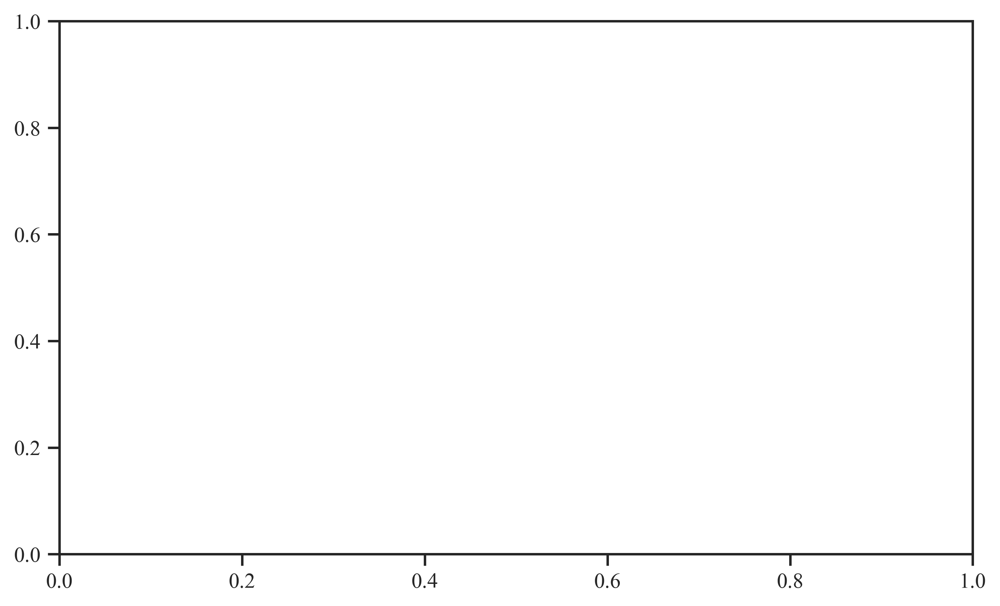

In [457]:
data = score_celltype
dbs = list(score_celltype.threeLevel.unique())
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(7, 4.2),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)
sub = sns.violinplot(data= score_celltype, x="threeLevel", y="score",hue="MSI_Label", palette="muted",order=dbs,linewidth=1)
# plt.legend(['GSE132465','GSE178341','GSE200997'], title = "项目",frameon=False)
sub.set_ylabel("近似概率",fontsize=12)
sub.set_xlabel("细胞类型",fontsize=12)

pvalues=[]
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["threeLevel"] == db) & (data["MSI_Label"] == "MSI-H")]["score"],
        y=data[(data["threeLevel"] == db) & (data["MSI_Label"] == "MSS")]["score"],
        alternative="greater"
    )[1])
fontdict = {'math_fontfamily':'custom', 'size':12}
for i in range(len(dbs)):
    plt.plot([i-0.3,i+0.3],[26,26],color="black",linewidth=0.8)
    print(i,pvalues[i])
    if pvalues[i] == 0:
        plt.text(i, 26.2, "0", ha="center",fontdict=fontdict)
    else:
        plt.text(i, 26.2, r"$ P = {va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
handles,labels = ax.get_legend_handles_labels()

plt.legend(handles=handles[0:2],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1,1.1),ncol=2)
# fig.savefig("./Result/singlecell/cell_type_pvalue.svg")

0 0.0
1 1.8417978006795626e-69
2 7.58029712883818e-28
3 1.0400883451492166e-70
4 0.022758762102707695
5 7.126714096954335e-50
6 3.111106397382983e-40


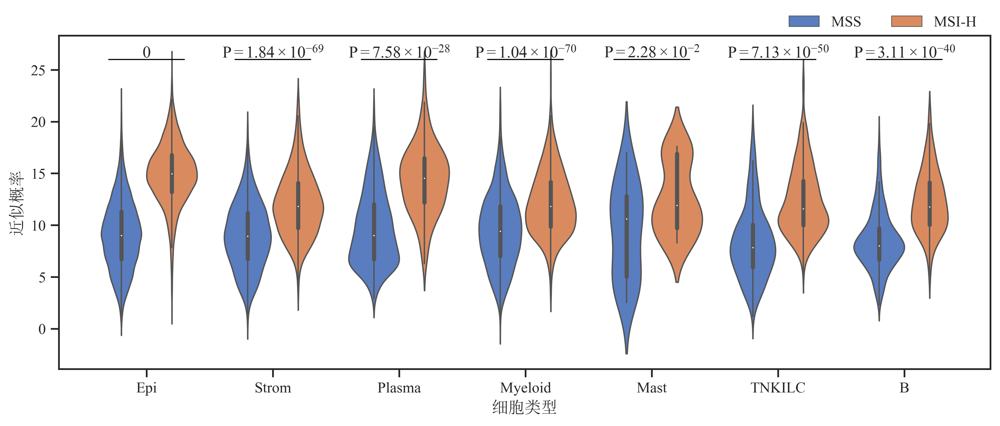

In [1502]:
data = score_celltype
dbs = list(score_celltype.clTopLevel.unique())
fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(10, 4.2),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)
sub = sns.violinplot(data= score_celltype, x="clTopLevel", y="score",hue="MSI_Label", palette="muted",order=dbs,linewidth=1)
sub.set_ylabel("近似概率",fontsize=12)
sub.set_xlabel("细胞类型",fontsize=12)

pvalues=[]
for db in dbs:
    pvalues.append(ranksums(
        x=data[(data["clTopLevel"] == db) & (data["MSI_Label"] == "MSI-H")]["score"],
        y=data[(data["clTopLevel"] == db) & (data["MSI_Label"] == "MSS")]["score"],
        alternative="greater"
    )[1])
fontdict = {'math_fontfamily':'custom', 'size':12}
for i in range(len(dbs)):
    plt.plot([i-0.3,i+0.3],[26,26],color="black",linewidth=0.8)
    print(i,pvalues[i])
    if pvalues[i] == 0:
        plt.text(i, 26.2, "0", ha="center",fontdict=fontdict)
    else:
        plt.text(i, 26.2, r"$ P = {va}\times10^{exp}$".format(va=round(find_exp(pvalues[i])[0],2),exp="{-"+str(find_exp(pvalues[i])[1])+"}"), ha="center",fontdict=fontdict)
handles,labels = ax.get_legend_handles_labels()

plt.legend(handles=handles[0:2],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1,1.1),ncol=2)
# fig.savefig("./Result/singlecell/cell_type_pvalue.svg")

In [1192]:
score_celltype

,score,sample,batchID,threeLevel,clTopLevel,clMidwayPr,cl295v11SubShort,cl295v11SubFull,MSI_Label,TumorNormal,CancerType,Database,SeqTechique,TrainTest
C103_T_1_1_0_c1_v2_id-TAAGTGCCAACACCCG,12.625571,C103_T,C103_T_1_1_0_c1_v2,Epithelial,Epi,Epi,cE01,cE01 (Stem/TA-like),MSS,Tumor,CRC,GEO,scRNA-seq,Test
C103_T_1_1_0_c1_v2_id-GGACATTTCGTTTAGG,8.714143,C103_T,C103_T_1_1_0_c1_v2,Epithelial,Epi,Epi,cE03,cE03 (Stem/TA-like prolif),MSS,Tumor,CRC,GEO,scRNA-seq,Test
C103_T_1_1_0_c1_v2_id-GACGTGCTCCAAACAC,10.210143,C103_T,C103_T_1_1_0_c1_v2,Epithelial,Epi,Epi,cE01,cE01 (Stem/TA-like),MSS,Tumor,CRC,GEO,scRNA-seq,Test
C103_T_1_1_0_c1_v2_id-AACTCTTCATCACGTA,2.812571,C103_T,C103_T_1_1_0_c1_v2,Epithelial,Epi,Epi,cE03,cE03 (Stem/TA-like prolif),MSS,Tumor,CRC,GEO,scRNA-seq,Test
C103_T_1_1_0_c1_v2_id-ACGTCAATCAAGATCC,5.567286,C103_T,C103_T_1_1_0_c1_v2,Epithelial,Epi,Epi,cE03,cE03 (Stem/TA-like prolif),MSS,Tumor,CRC,GEO,scRNA-seq,Test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C173_T_0_0_0_c1_v3_id-GCATCGGAGTTAGTAG,16.872571,C173_T,C173_T_0_0_0_c1_v3,Epithelial,Epi,Epi,cE02,cE02 (Stem/TA-like/Immature Goblet),MSI-H,Tumor,CRC,GEO,scRNA-seq,Test
C173_T_0_0_0_c1_v3_id-CATGCAATCCGCCTAT,9.773286,C173_T,C173_T_0_0_0_c1_v3,Immune,Myeloid,Macro,cM02,cM02 (Macrophage-like),MSI-H,Tumor,CRC,GEO,scRNA-seq,Test
C173_T_0_0_0_c1_v3_id-CCCATTGTCGAACCTA,14.796857,C173_T,C173_T_0_0_0_c1_v3,Epithelial,Epi,Epi,cE03,cE03 (Stem/TA-like prolif),MSI-H,Tumor,CRC,GEO,scRNA-seq,Test
C173_T_0_0_0_c1_v3_id-GGGCTACAGTACCCTA,9.218286,C173_T,C173_T_0_0_0_c1_v3,Immune,Myeloid,Macro,cM02,cM02 (Macrophage-like),MSI-H,Tumor,CRC,GEO,scRNA-seq,Test


In [497]:
fpr, tpr, thresholds = roc_curve(res_GSE178341.y_true,res_GSE178341.y_score,drop_intermediate=False)
cutoff = find_optimal_cutoff(tpr,fpr,thresholds)

In [509]:
cutoff

12.35841630148992

In [510]:
y_pre = score_celltype.score.copy()
y_pre[y_pre < cutoff] =0
y_pre[y_pre >= cutoff] =1

In [511]:
score_celltype.insert(loc=1,column="MSI_pre",value=y_pre)

In [522]:
score_celltype = pd.read_csv("./result/single_cell/cell_type/score_celltype.csv",index_col=0)

In [513]:
def ratioCaculate(celltype):
    type_ratio = pd.DataFrame(index=["cell_MSI","MSI-H","MSS","cell_MSS","MSI-H","MSS"])
    res = []
    for name in score_celltype[celltype].unique():
        sub = score_celltype[score_celltype[celltype] == name]
        sub_MSI = sub[sub["MSI_Label"] == "MSI-H"]
        
        res.append(sub_MSI.shape[0])
        if(sub_MSI.shape[0] == 0):
            res.append(np.NAN)
            res.append(np.NAN)
        else:
            res.append(sum(sub_MSI.MSI_pre)/sub_MSI.shape[0])
            res.append(1-sum(sub_MSI.MSI_pre)/sub_MSI.shape[0])
        
        sub_MSS = sub[sub["MSI_Label"] == "MSS"]
        
        res.append(sub_MSS.shape[0])
        if(sub_MSS.shape[0] == 0):
            res.append(np.NAN)
            res.append(np.NAN)
        else:
            res.append(sum(sub_MSS.MSI_pre)/sub_MSS.shape[0])
            res.append(1-sum(sub_MSS.MSI_pre)/sub_MSS.shape[0])
        type_ratio[name] = res
        res = []
    return type_ratio

In [1399]:
threeLevel = ratioCaculate("threeLevel")

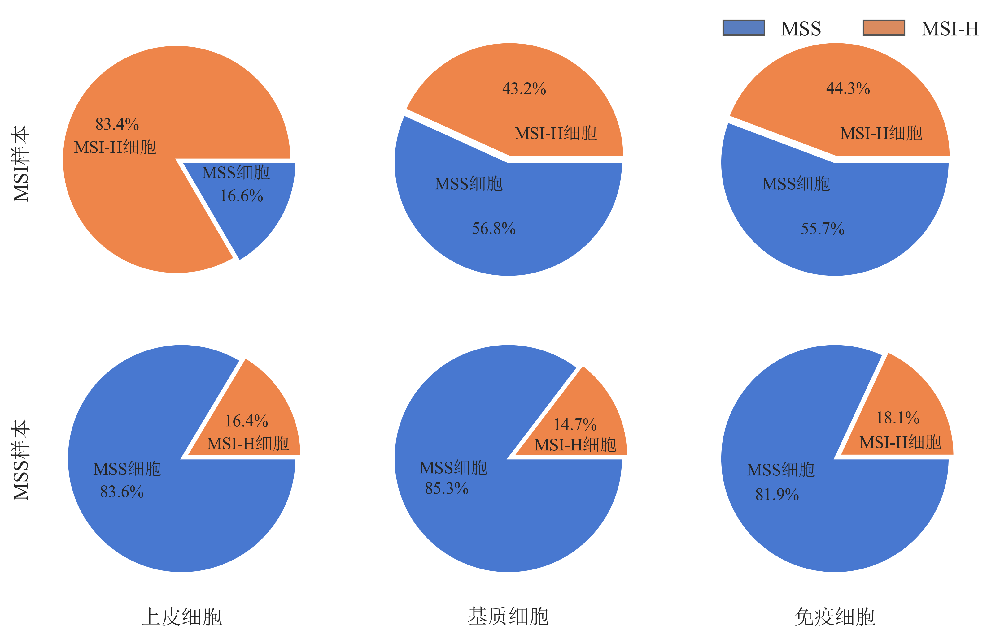

In [516]:
fig, ax =plt.subplots(2,3,constrained_layout=True,figsize=(8,5),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)

data = threeLevel
for i in range(len(data.columns)):
    plt.subplot(2,3,i+1)
    cell_type = data.columns[i]
    
    sub1 = plt.pie(data.iloc[[1,2],:][cell_type],labels=["MSI-H细胞","MSS细胞"],autopct='%1.1f%%'
                    ,labeldistance=0.2,explode =(0.05,0),radius=1,
                   textprops={'fontsize':10 },colors=[u'#ee854a',u'#4878d0'],)
    if i == 0:
        plt.ylabel("MSI样本")


for i in range(len(data.columns)):
    plt.subplot(2,3,i+4)
    cell_type = data.columns[i]
    sub1 = plt.pie(data[cell_type][4:],labels=["MSI-H细胞","MSS细胞"],autopct='%1.1f%%',labeldistance=0.2,explode =(0.05,0)
                  ,textprops={'fontsize':10 },colors=[u'#ee854a',u'#4878d0'])
    if i == 0:
        plt.ylabel("MSS样本")
#     plt.title(["上皮细胞","基质细胞","免疫细胞"][i])
    plt.xlabel(["上皮细胞","基质细胞","免疫细胞"][i])
#     plt.title(cell_type)
# plt.legend(loc="upper right",fontsize=10,bbox_to_anchor=(1.1,1.05),borderaxespad=0.3,frameon=False)


fig.legend(handles=handles[0:2],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1,1.02),ncol=2,fontsize=12)


fig.savefig("./result/single_cell/cell_type/threeLevel_msi_compare.svg",bbox_inches='tight')

In [526]:
topLevel = ratioCaculate("clTopLevel")

In [528]:
topLevel.to_csv("./result/single_cell/cell_type/clTopLevel.csv")

In [173]:
topLevel = pd.read_csv("./result/single_cell/cell_type/clTopLevel.csv",index_col=0)

In [529]:
topLevel = topLevel.iloc[:,2:]

In [531]:
data.columns

Index(['Plasma', 'Myeloid', 'Mast', 'TNKILC', 'B'], dtype='object')

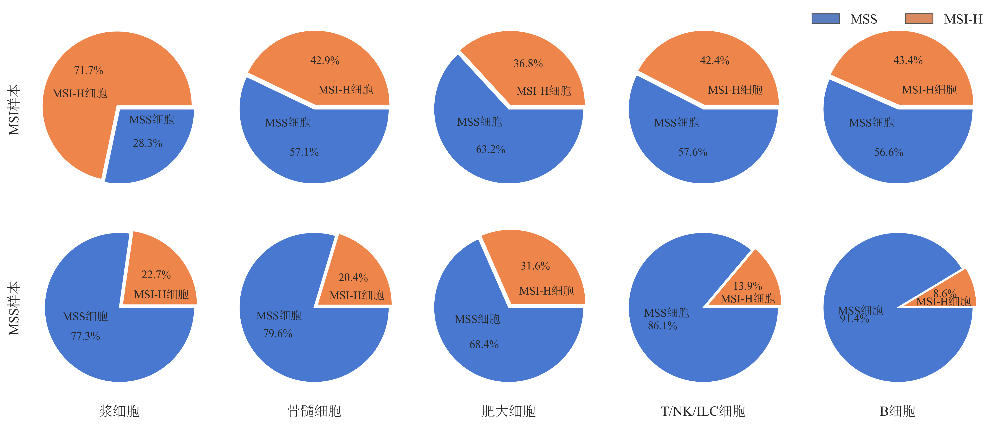

In [532]:
fig, ax =plt.subplots(2,5,constrained_layout=True,figsize=(12,5),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
sns.set(context='notebook', style='ticks', rc=rc)

data = topLevel
for i in range(len(data.columns)):
    plt.subplot(2,5,i+1)
    cell_type = data.columns[i]
    
    sub1 = plt.pie(data.iloc[[1,2],:][cell_type],labels=["MSI-H细胞","MSS细胞"],autopct='%1.1f%%'
                    ,labeldistance=0.2,explode =(0.05,0),radius=1,
                   textprops={'fontsize':10 },colors=[u'#ee854a',u'#4878d0'],)
    if i == 0:
        plt.ylabel("MSI样本")


for i in range(len(data.columns)):
    plt.subplot(2,5,i+6)
    cell_type = data.columns[i]
    sub1 = plt.pie(data[cell_type][4:],labels=["MSI-H细胞","MSS细胞"],autopct='%1.1f%%',labeldistance=0.2,explode =(0.05,0)
                  ,textprops={'fontsize':10 },colors=[u'#ee854a',u'#4878d0'])
    if i == 0:
        plt.ylabel("MSS样本")
#     plt.title(["上皮细胞","基质细胞","免疫细胞"][i])
    plt.xlabel(["浆细胞","骨髓细胞","肥大细胞","T/NK/ILC细胞","B细胞"][i])

fig.legend(handles=handles[0:2],labels=['MSS','MSI-H'],frameon=False,loc = 'upper right',bbox_to_anchor=(1,1.02),ncol=2,fontsize=12)



fig.savefig("./result/single_cell/cell_type/topLevel_msi_compare.svg",bbox_inches='tight')

In [1350]:
ratioCaculate("threeLevel").to_csv("./result/single_cell/cell_type/threeLevel.csv")

ratioCaculate("clTopLevel").to_csv("./result/single_cell/cell_type/clTopLevel.csv")

ratioCaculate("clMidwayPr").to_csv("./result/single_cell/cell_type/clMidwayPr.csv")

ratioCaculate("cl295v11SubShort").to_csv("./result/single_cell/cell_type/cl295v11SubShort.csv")

In [196]:
threeLevel = pd.read_csv("./result/single_cell/cell_type/threeLevel.csv",index_col=0)
topLevel = pd.read_csv("./result/single_cell/cell_type/clTopLevel.csv",index_col=0)

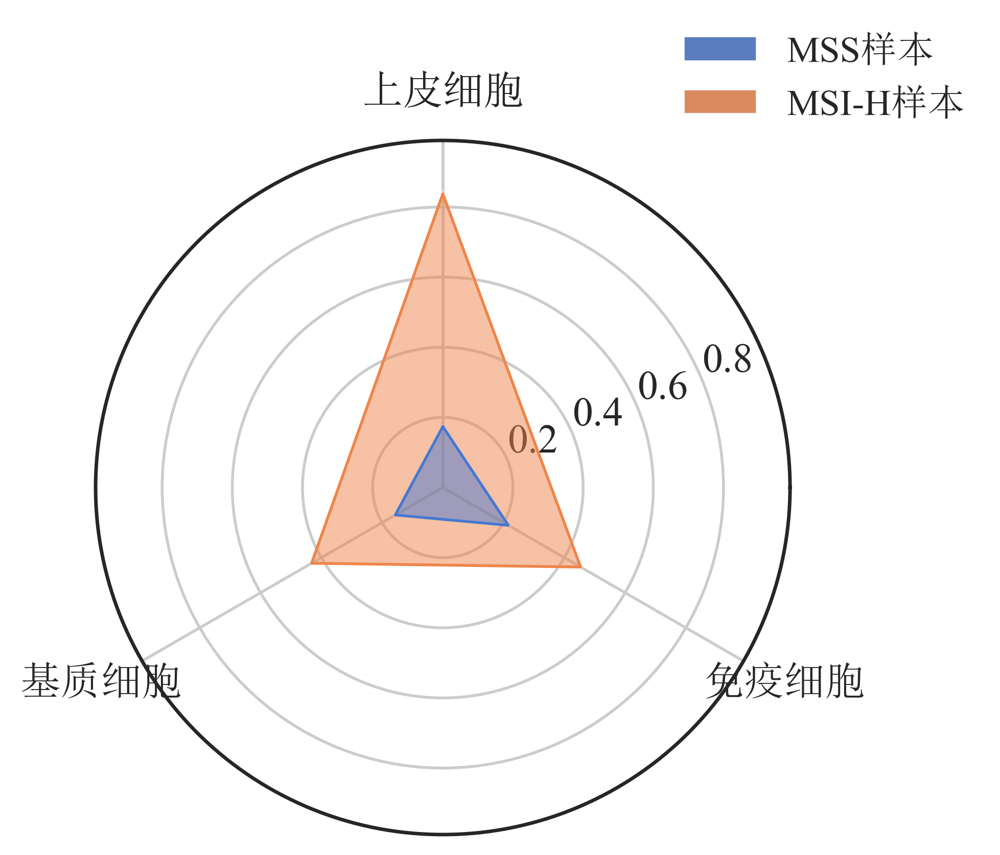

In [251]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
# fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(8,8),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
# sns.set(context='notebook', style='ticks', rc=rc)
data = threeLevel

labels = np.array(["上皮细胞","基质细胞","免疫细胞"])
dataLenth  = 3       # 数据长度
data = np.array(list(data.iloc[1,:]))
angles = np.linspace(0.5*np.pi,2.5*np.pi,dataLenth,endpoint=False)   #根据数据长度平均分割圆周长
 
#闭合
data = np.concatenate((data,[data[0]])) 
angles = np.concatenate((angles,[angles[0]]))
labels=np.concatenate((labels,[labels[0]]))  #对labels进行封闭
 
sub = plt.figure(facecolor="white",figsize=(4.5,4.5),dpi=400,frameon =False)       #facecolor 设置框体的颜色
sub =  plt.subplot(1,1,1,polar=True)
     #将图分成1行1列，画出位置1的图；设置图形为极坐标图
sub = plt.plot(angles,data,color =u'#ee854a',linewidth=1)

sub = plt.plot(angles,[0.95,0.95,0.95,0.95],color ='white',linewidth=0)

sub = plt.fill(angles,data,facecolor=u'#ee854a',alpha=0.5)    #填充两条线之间的色彩，alpha为透明度
sub = plt.thetagrids(angles*180/np.pi,labels,text={"rotation":20})          #做标签
# handles,labels = sub.get_legend_handles_labels()

# plt.figtext(0.52,0.95,'雷达图',ha='center')   #添加雷达图标题
data = threeLevel
data = np.array(list(data.iloc[4,:]))
angles = np.linspace(0.5*np.pi,2.5*np.pi,dataLenth,endpoint=False)   #根据数据长度平均分割圆周长
 
#闭合
data = np.concatenate((data,[data[0]])) 
angles = np.concatenate((angles,[angles[0]]))
labels=np.concatenate((labels,[labels[0]]))  #对labels进行封闭


# sub = plt.figure(facecolor="white",figsize=(5,5),dpi=400)       #facecolor 设置框体的颜色
sub =  plt.subplot(1,1,1,polar=True)
     #将图分成1行1列，画出位置1的图；设置图形为极坐标图
sub = plt.plot(angles,data,color =u'#4878d0',linewidth=1)
sub = plt.fill(angles,data,facecolor=u'#4878d0',alpha=0.5)
plt.legend(handles=lines,labels=['MSS样本','MSI-H样本'],frameon=False,loc = 'best',bbox_to_anchor=(1.3,1.2),fontsize=13)
plt.grid(True)
plt.savefig("./result/threeLevel_msi_compare.PPT.svg",bbox_inches='tight')

In [226]:
data = topLevel
data = np.array(list(data.iloc[2,:]))

In [240]:
topLevel

,Epi,Strom,Plasma,Myeloid,Mast,TNKILC,B
cell_MSI,9875.000000,595.000000,99.000000,1257.000000,19.000000,384.000000,159.000000
MSI-H,0.834025,0.431933,0.717172,0.428799,0.368421,0.424479,0.433962
MSS,0.165975,0.568067,0.282828,0.571201,0.631579,0.575521,0.566038
cell_MSS,22534.000000,1262.000000,910.000000,1130.000000,19.000000,368.000000,581.000000
MSI-H,0.164285,0.146593,0.227473,0.203540,0.315789,0.138587,0.086059
MSS,0.835715,0.853407,0.772527,0.796460,0.684211,0.861413,0.913941


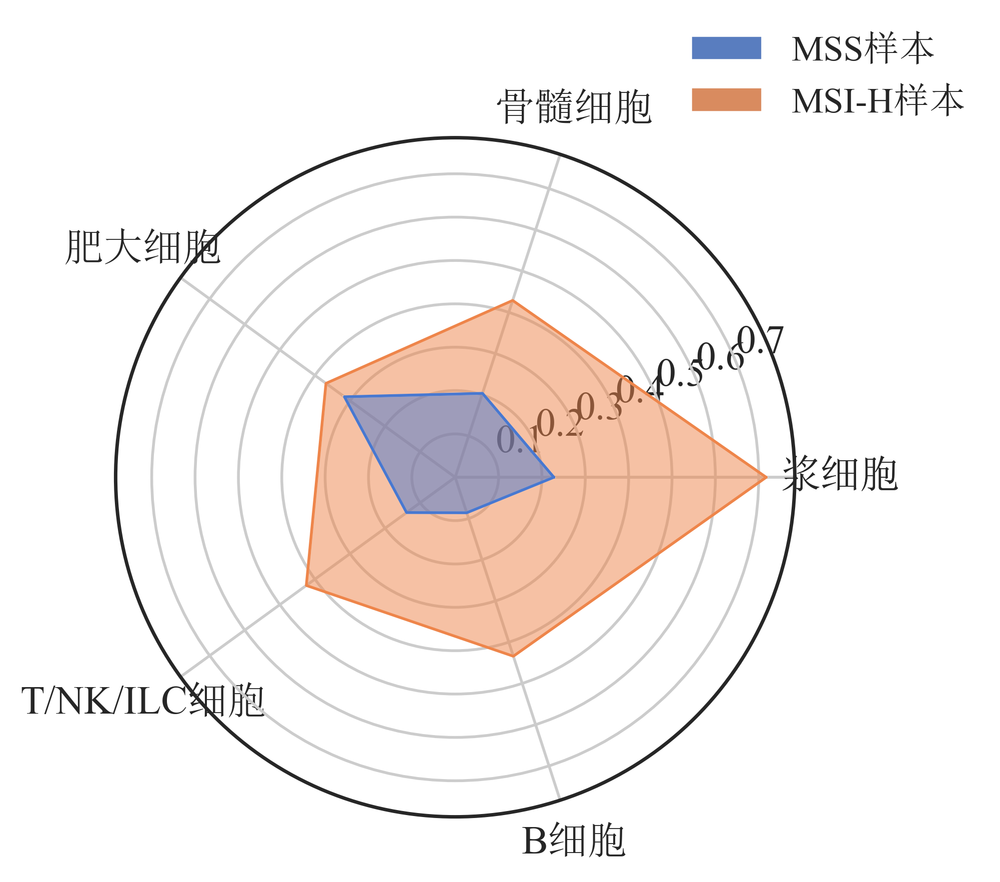

In [250]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
# fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(8,8),dpi=400)
rc = {'font.sans-serif': ['SongTimes'],
      'axes.unicode_minus': False}
# sns.set(context='notebook', style='ticks', rc=rc)
data = topLevel.iloc[:,2:]

labels = np.array(["浆细胞","骨髓细胞","肥大细胞","T/NK/ILC细胞","B细胞"])
dataLenth  = 5       # 数据长度
data = np.array(list(data.iloc[1,:]))
angles = np.linspace(0,2*np.pi,dataLenth,endpoint=False)   #根据数据长度平均分割圆周长
 
#闭合
data = np.concatenate((data,[data[0]])) 
angles = np.concatenate((angles,[angles[0]]))
labels=np.concatenate((labels,[labels[0]]))  #对labels进行封闭
 
sub = plt.figure(facecolor="white",figsize=(4.5,4.5),dpi=400,frameon =False)       #facecolor 设置框体的颜色
sub =  plt.subplot(1,1,1,polar=True)
     #将图分成1行1列，画出位置1的图；设置图形为极坐标图
sub = plt.plot(angles,data,color =u'#ee854a',linewidth=1)

sub = plt.plot(angles,[0.75,0.75,0.75,0.75,0.75,0.75],color ='white',linewidth=0)

sub = plt.fill(angles,data,facecolor=u'#ee854a',alpha=0.5)    #填充两条线之间的色彩，alpha为透明度
sub = plt.thetagrids(angles*180/np.pi,labels,text={"rotation":20})          #做标签
# plt.figtext(0.52,0.95,'雷达图',ha='center')   #添加雷达图标题
data = topLevel.iloc[:,2:]

data = np.array(list(data.iloc[4,:]))
angles = np.linspace(0,2*np.pi,dataLenth,endpoint=False) #根据数据长度平均分割圆周长
 
#闭合
data = np.concatenate((data,[data[0]])) 
angles = np.concatenate((angles,[angles[0]]))
labels=np.concatenate((labels,[labels[0]]))  #对labels进行封闭
 
# sub = plt.figure(facecolor="white",figsize=(5,5),dpi=400)       #facecolor 设置框体的颜色
sub =  plt.subplot(1,1,1,polar=True)
     #将图分成1行1列，画出位置1的图；设置图形为极坐标图
sub = plt.plot(angles,data,color =u'#4878d0',linewidth=1)
sub = plt.fill(angles,data,facecolor=u'#4878d0',alpha=0.5)
plt.legend(handles=lines,labels=['MSS样本','MSI-H样本'],frameon=False,loc = 'upper right',bbox_to_anchor=(1.3,1.2),fontsize=13)
plt.grid(True)
plt.savefig("./result/topLevel_msi_compare.PPT.svg",bbox_inches='tight')

In [1218]:
df['LoanStatus'].value_counts().values

array([3, 2], dtype=int64)

In [1205]:
def ratioMSIplot(name,size_x,size_y):
    path = "./result/single_cell/cell_type/"
    ratio = pd.read_csv(path+name,index_col=0)

    ratio_melt = ratio[["MSI-H","MSS"]].reset_index().melt(id_vars=["index"],var_name="MSI_label",value_name="MSIratio")

    fig, ax =plt.subplots(1,1,constrained_layout=True,figsize=(size_x, size_y),dpi=400)
    rc = {'font.sans-serif': ['SongTimes'],
          'axes.unicode_minus': False}
    sub = sns.barplot(data= ratio_melt, x="index", y="MSIratio",hue="MSI_label", palette="muted")
    # plt.legend(['GSE132465','GSE178341','GSE200997'], title = "项目",frameon=False)
    sub.set_ylabel("MSI-H细胞比例",fontsize=12)
    sub.set_xlabel("细胞类型",fontsize=12)
    # plt.savefig("./Result/singlecell/cell_type_score_GSE178341.svg")
    plt.legend(title="样本MSI状态",fontsize=12,frameon=False)
    plt.savefig(path+name.split(".")[0]+".svg")

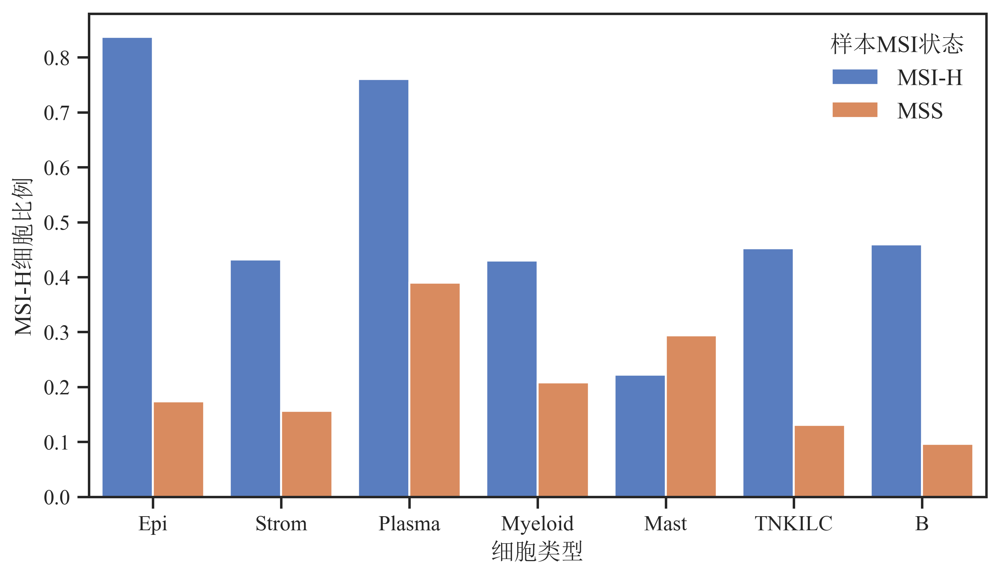

In [1206]:
ratioMSIplot("clTopLevel.csv",7,4)

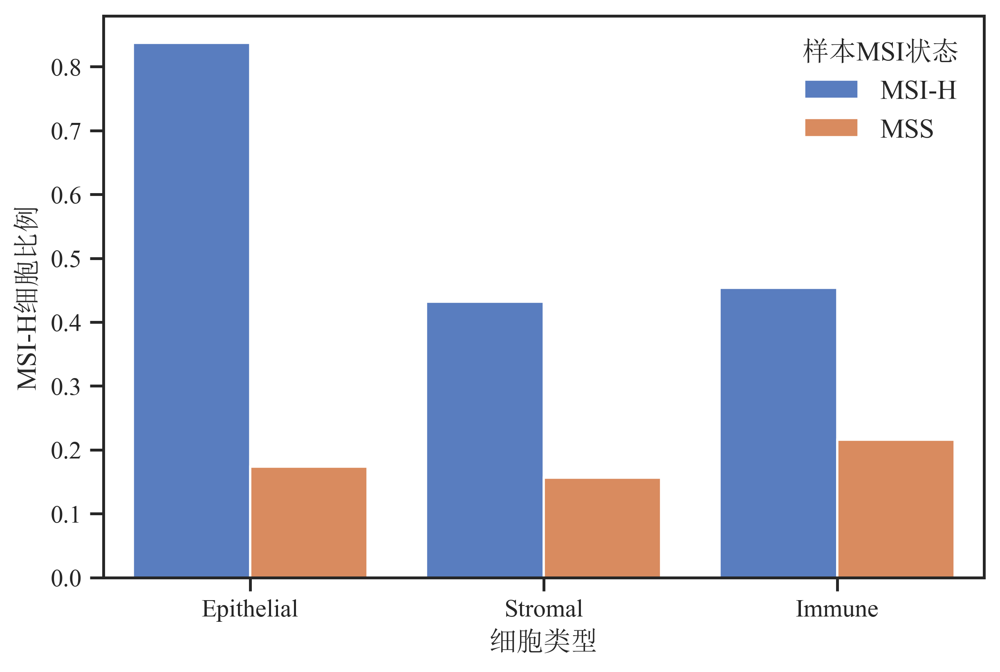

In [1207]:
ratioMSIplot("threeLevel.csv",6,4)